In [2]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import pandas as pd
import uncertainties as unc
from scipy import stats
from scipy.stats import norm 
from scipy.stats import zscore
import scipy.constants as const
from tabulate import tabulate
import math
from matplotlib import cm
import matplotlib.cm as cm
import seaborn as sns
from scipy.optimize import minimize
import numpy as np
from pyuvdata import UVData
%matplotlib inline

In [3]:
path_to_data_file = './Hera/'
uv = UVData()
uv.read('./zen.2459122.34011.mini.sum (2).uvh5')
data = uv.data_array
freqs = uv.freq_array[0]*1e-6
print('This data array has shape:')
print('(# baselines*times, # spectral windows, # frequencies, # polarizations)')
print(np.shape(data))
print(data.ndim)


This data array has shape:
(# baselines*times, # spectral windows, # frequencies, # polarizations)
(13320, 1, 1536, 1)
4


### Define function to find amplitude differences between adjacent time slices for all pairs

In [5]:
# # Amplitude diff between adjacent slices
# def amplitude_diff(uvdata):
#     # Get unique baselines with visibilities
#     baseline_pairs = uvdata.get_baseline_nums()
#     # Initialize place to store amplitude diffs
#     amp_diffs = {} 
#     # Iterate over pairs to get amplitude diffs
#     for baseline in baseline_pairs:
#         data_apair = uvdata.get_data(baseline)
#         amplitudes = np.abs(data_apair)
#         difference = np.abs(np.diff(amplitudes, axis=0))
#         amp_diffs[baseline] = difference
#     return amp_diffs
        
        

### DEfine threshold function that includes different methods with default as percentile

### Define Function to filter through each pairing and plot freq. vs. avg amp before and after

In [8]:
# Amplitude diff between adjacent slices
def amplitude_diff(uvdata):
    # Get unique baselines with visibilities
    baseline_pairs = uvdata.get_baseline_nums()
    # Initialize place to store amplitude diffs
    amp_diffs = {} 
    # Iterate over pairs to get amplitude diffs
    for baseline in baseline_pairs:
        data_apair = uvdata.get_data(baseline)
        amplitudes = np.abs(data_apair)
        difference = np.abs(np.diff(amplitudes, axis=0))
        amp_diffs[baseline] = difference
    return amp_diffs

def filter(data):
    baseline_pairs = data.get_baseline_nums()
    # Call amplitude difference function to get aarray with amplitude differences
    amplitude_differences = amplitude_diff(data)
    # Initialize storing of filtered data for each pair
    filtered_data = {}
    # Threshold function
    # def find_threshold(d, method='quantile', q=0.05):
    #         if method == 'quantile':
    #             threshold = np.quantile(d, axis=0, q=q)
    #         else:
    #             raise ValueError("Unsupported threshold method.")
    #         return threshold
    # Iterate through each baseline pair to determine threshold then filter data
    for baseline in baseline_pairs:
        # Get antenna numbers
        antenna1, antenna2 = data.baseline_to_antnums(baseline)
        
        
       
        ### Filter
        data_pair = data.get_data(baseline)
        avg_diff_before = np.mean(amplitude_differences[baseline], axis=0)
        # Define threshold as z score
        threshold = zscore(avg_diff_before)
        # Filter by z score
        rejected_indices = np.where(threshold > 2)[0] # Location of frequencies to remove 
        amplitudes_filtered = np.delete(np.abs(data_pair), rejected_indices, axis=1) # Delete data corresponding to indices to reject
        freqs = data.freq_array[0]*1e-6 # Original frequencies
        freqs_filtered = np.delete(freqs, rejected_indices) # Delete frequencies correspondinf to indices to reject
        # print(amplitude_differences[baseline])
        # Store filtered data for each pair
        filtered_data[baseline] = amplitudes_filtered
        
        avg_diff_after = np.mean(np.abs(np.diff(np.abs(amplitudes_filtered), axis=0)), axis=0)
        
        print("freqs shape:", freqs.shape)
        print("freqs_filtered shape:", freqs_filtered.shape)
        print("amplitudes_filtered shape:", amplitudes_filtered.shape)
        if len(freqs_filtered) == 0 or amplitudes_filtered.size == 0:
            print(f"No data left after filtering for baseline ({antenna1}, {antenna2}).")
            continue
        print("Threshold for baseline:", threshold)
        
        
        # plotting diff
        plt.figure(figsize=(10, 4))
        plt.plot(freqs, avg_diff_before, alpha=0.4, color='k', label=f"Baseline Pair ({antenna1}, {antenna2}) Before Filtering")
        plt.plot(freqs_filtered, avg_diff_after, alpha=0.2, color='r', label=f"Baseline Pair ({antenna1}, {antenna2}) After Filtering")
        plt.xlabel("Frequency")
        plt.ylabel("Average Amplitude")
        plt.legend()
        plt.title(f"Frequency vs Avg. Amplitude for Baseline Pair ({antenna1}, {antenna2})")
        plt.show()
    return filtered_data
    
    
    

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.2299584  -0.20869609 -0.23311884 ... -0.28044174 -0.2903692
 -0.2649989 ]


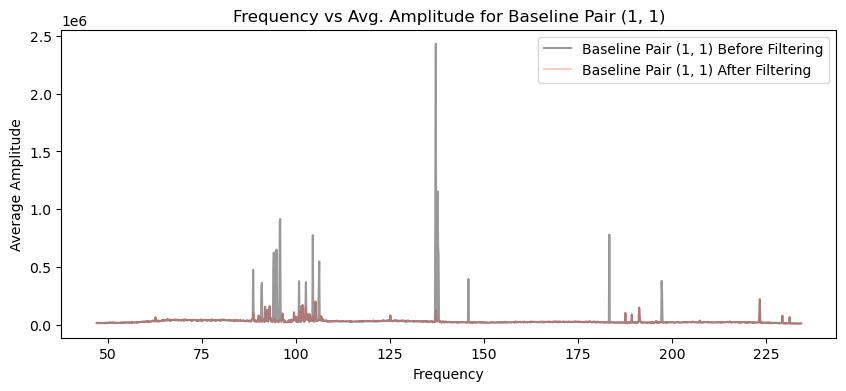

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.15193939 -0.15099953 -0.15169165 ... -0.13546032 -0.14437799
 -0.15224582]


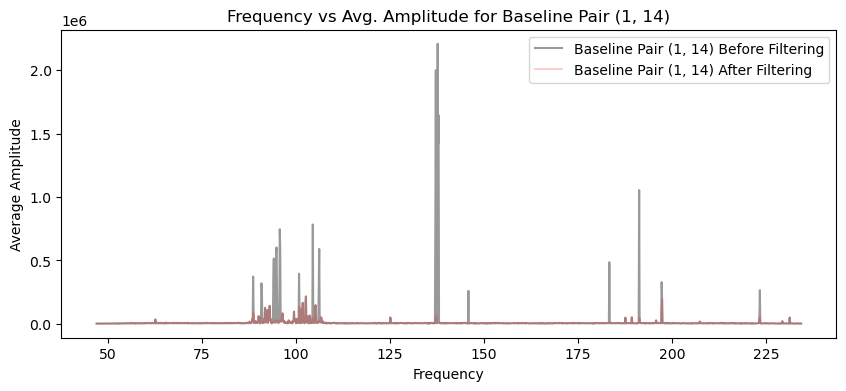

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.09211527 -0.09012662 -0.08869554 ... -0.08802986 -0.08821586
 -0.08847206]


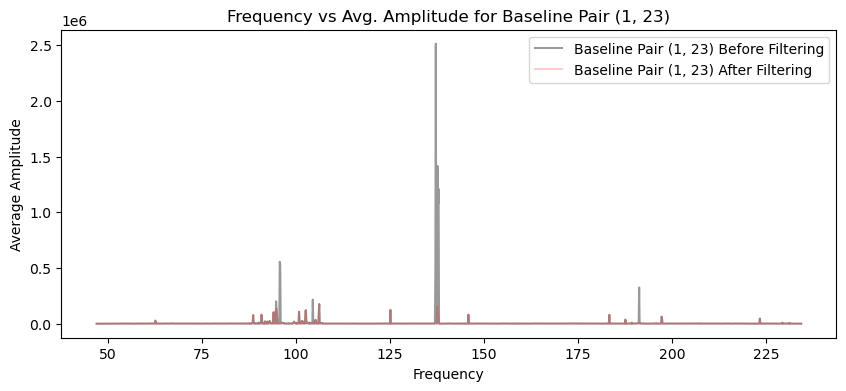

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.16426439 -0.17233051 -0.16105615 ... -0.1428568  -0.16525724
 -0.15574603]


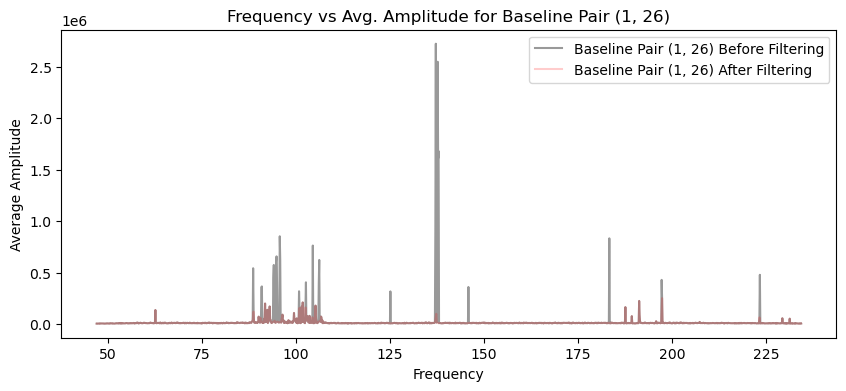

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16072598 -0.17020849 -0.17287577 ... -0.14570516 -0.14272232
 -0.1570831 ]


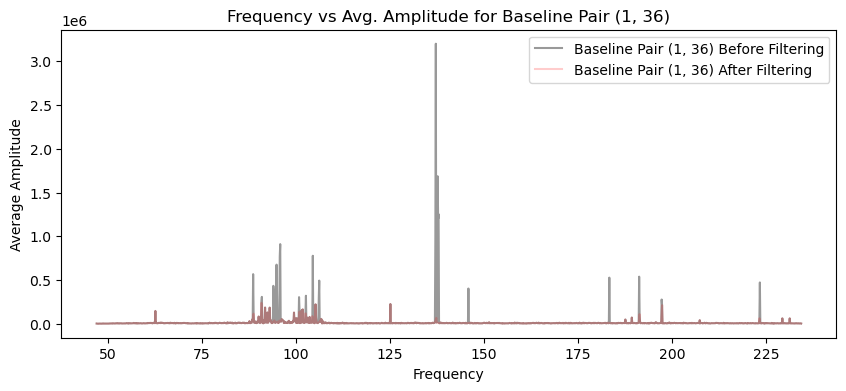

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19788983 -0.19513888 -0.19697325 ... -0.17349396 -0.14951533
 -0.16046055]


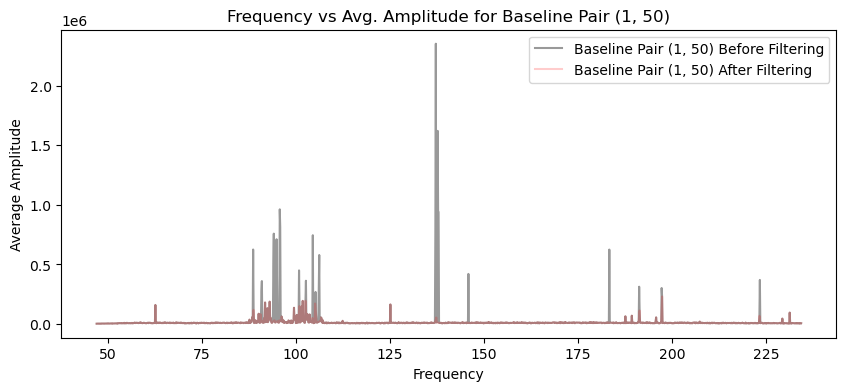

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14444942 -0.14219259 -0.14332084 ... -0.13367468 -0.13936796
 -0.13530268]


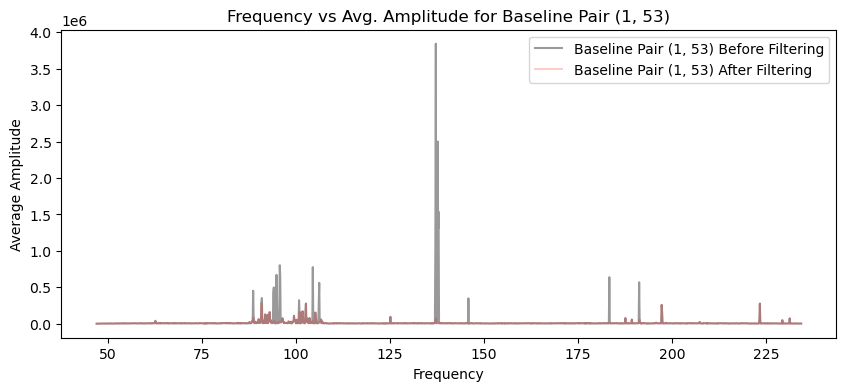

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.16299227 -0.16555867 -0.16710117 ... -0.15331671 -0.15344194
 -0.14841594]


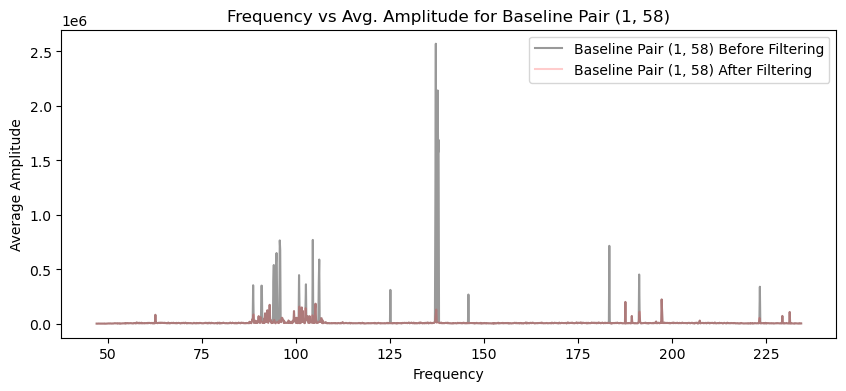

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15785248 -0.16039788 -0.1637368  ... -0.15222992 -0.13769437
 -0.13039481]


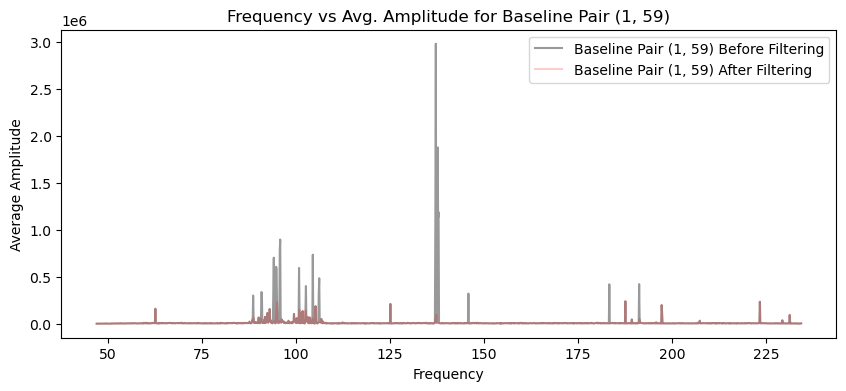

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.32222416 -0.32344403 -0.30353193 ... -0.21714911 -0.13008695
 -0.04741056]


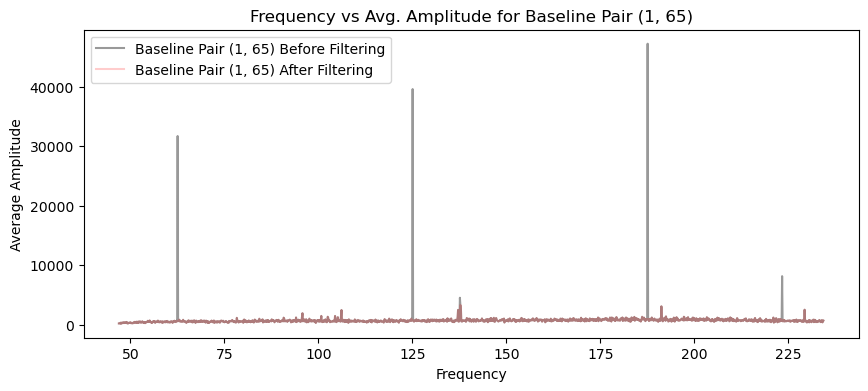

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16064695 -0.15831793 -0.16031237 ... -0.14044069 -0.14253118
 -0.14379016]


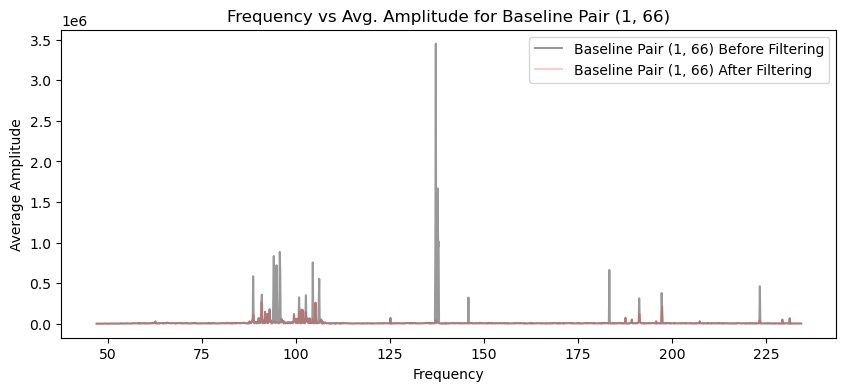

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.13996215 -0.13688258 -0.13976785 ... -0.12209624 -0.12939305
 -0.12228188]


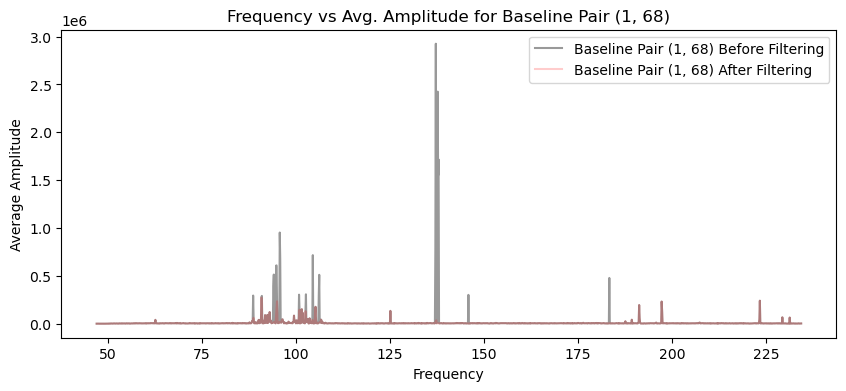

freqs shape: (1536,)
freqs_filtered shape: (1521,)
amplitudes_filtered shape: (20, 1521)
Threshold for baseline: [-0.10431831 -0.10561425 -0.10574494 ... -0.0959951  -0.09170483
 -0.10041572]


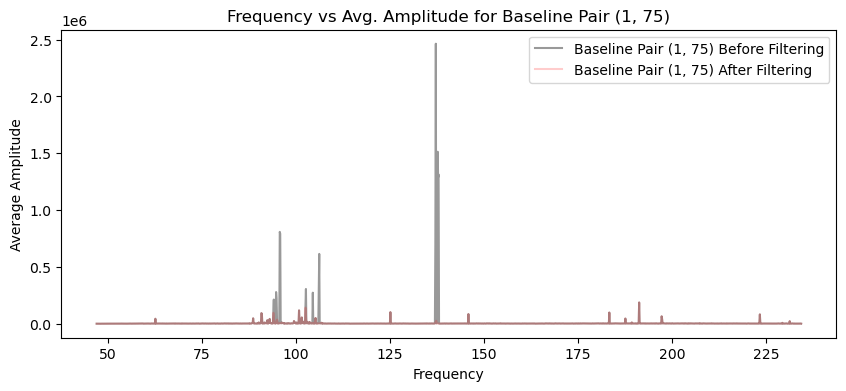

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.14021015 -0.14311281 -0.14626361 ... -0.13227851 -0.13928013
 -0.13223217]


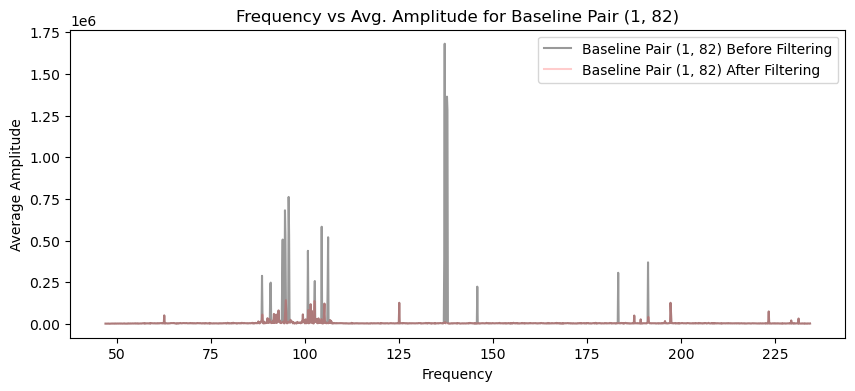

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.18537616 -0.19235616 -0.19113027 ... -0.15983736 -0.16406881
 -0.17788007]


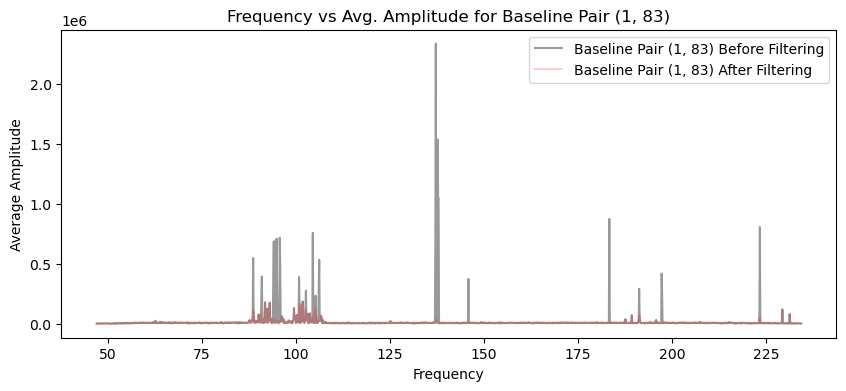

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.26577807 -0.2886962  -0.35754478 ...  0.03380262 -0.26722763
 -0.23181057]


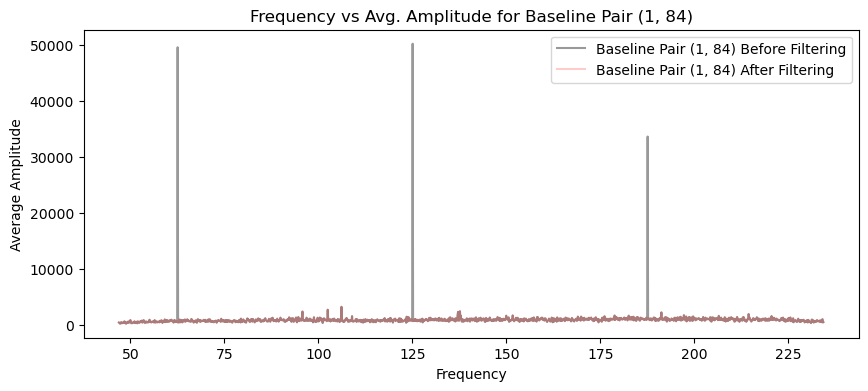

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15424394 -0.14964887 -0.14761631 ... -0.1499272  -0.13669451
 -0.13723393]


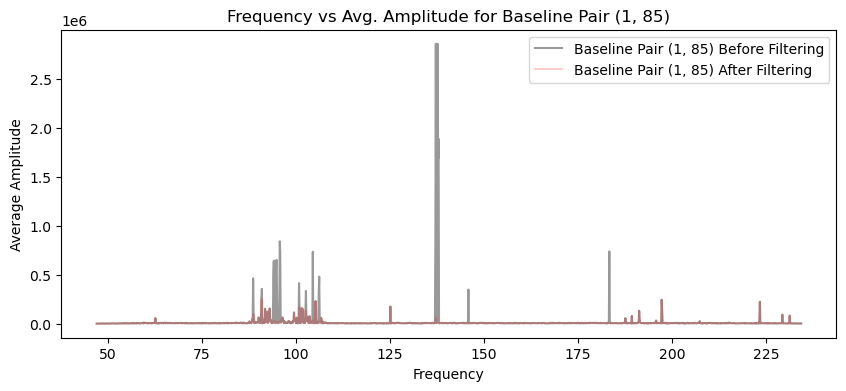

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.14745277 -0.14289379 -0.14657427 ... -0.12889047 -0.13241922
 -0.13729342]


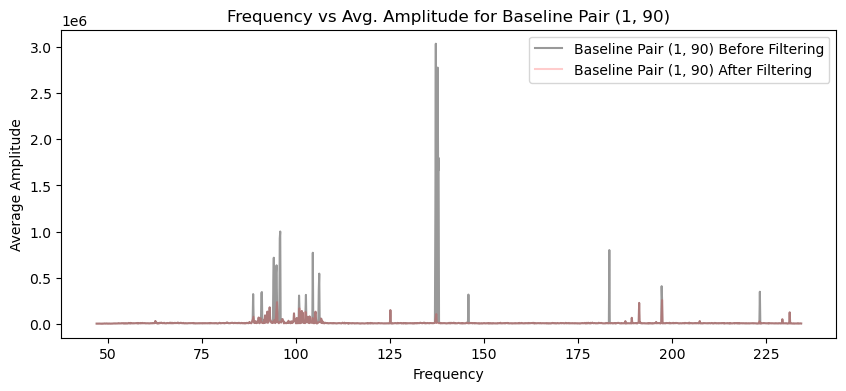

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16227536 -0.16250185 -0.15893177 ... -0.15402103 -0.1436409
 -0.13899225]


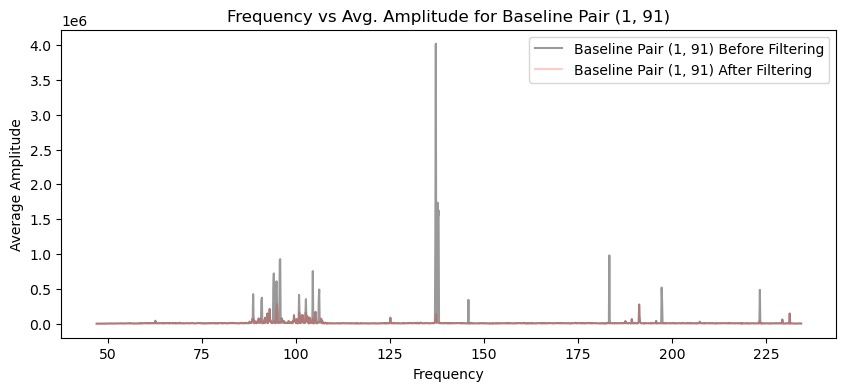

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.1320312  -0.13949231 -0.14446095 ... -0.01282436 -0.0689952
 -0.05367662]


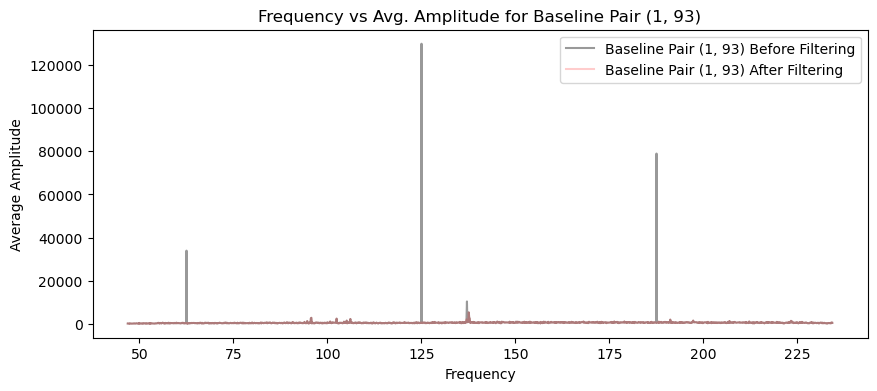

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.17879044 -0.18011477 -0.17621433 ... -0.16899424 -0.16099405
 -0.16521123]


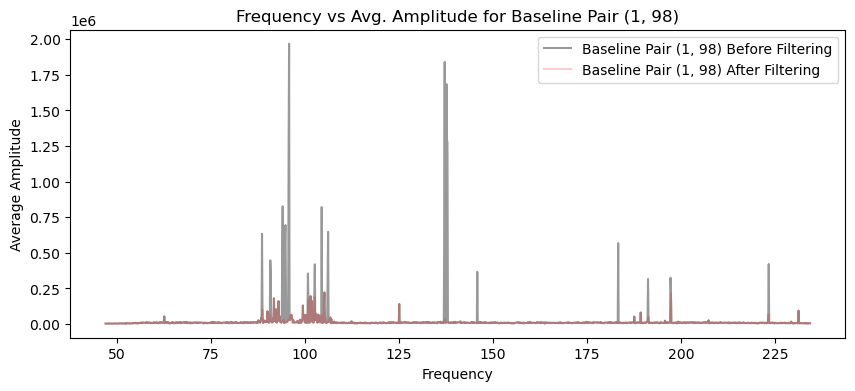

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.1804557  -0.16979567 -0.17201687 ... -0.16233127 -0.16040003
 -0.16617023]


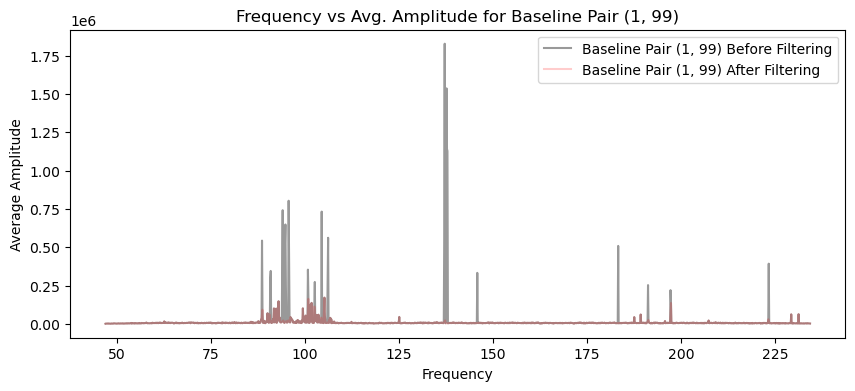

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17949163 -0.17413143 -0.17708037 ... -0.15166308 -0.16093736
 -0.16735876]


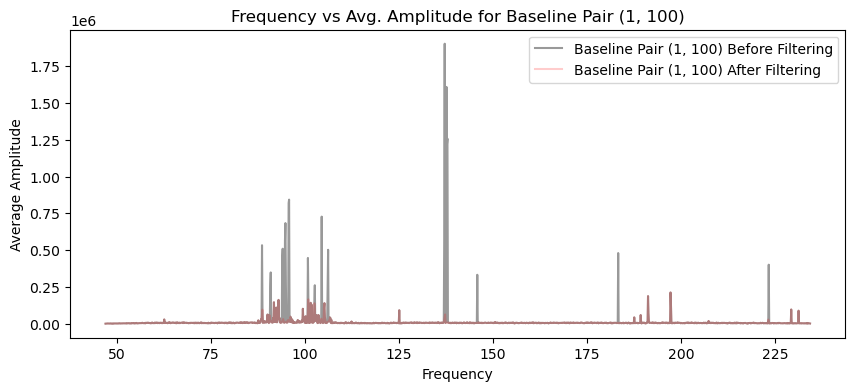

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17769716 -0.16090089 -0.17806827 ... -0.1689882  -0.16702683
 -0.15969478]


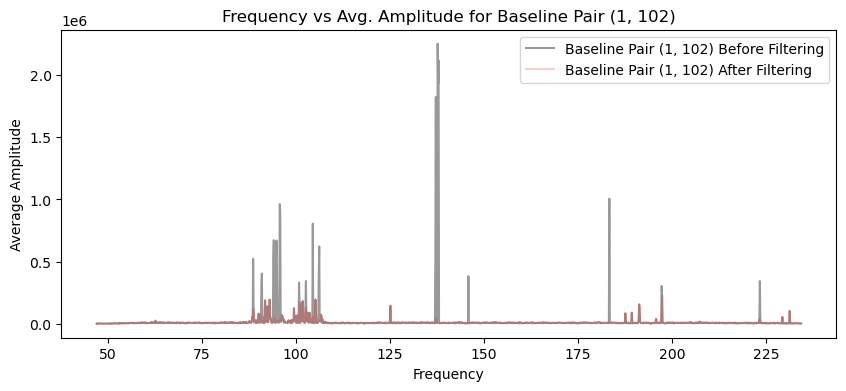

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14305192 -0.13927651 -0.14214292 ... -0.13139438 -0.11146442
 -0.1203757 ]


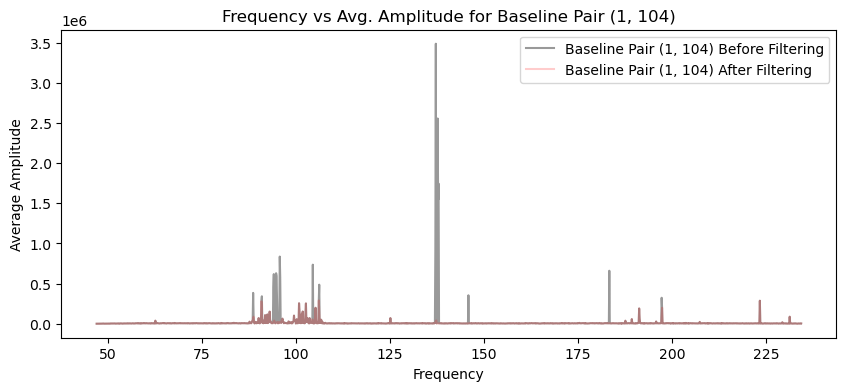

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.20280718 -0.20816578 -0.20338005 ... -0.17686476 -0.17525657
 -0.17013892]


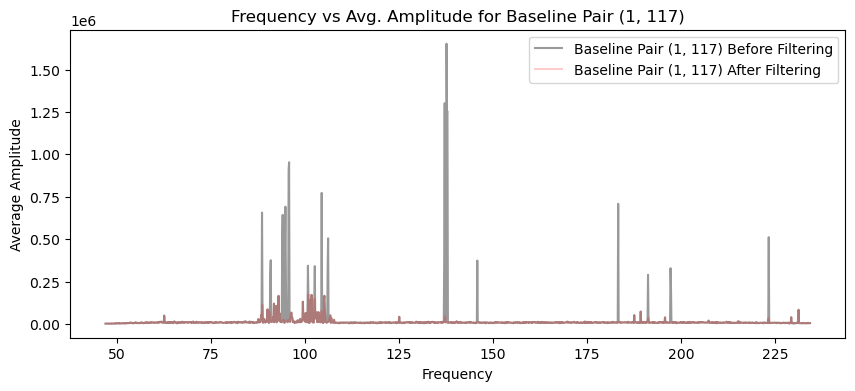

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19724246 -0.19647571 -0.18098146 ... -0.16890333 -0.17683127
 -0.16677376]


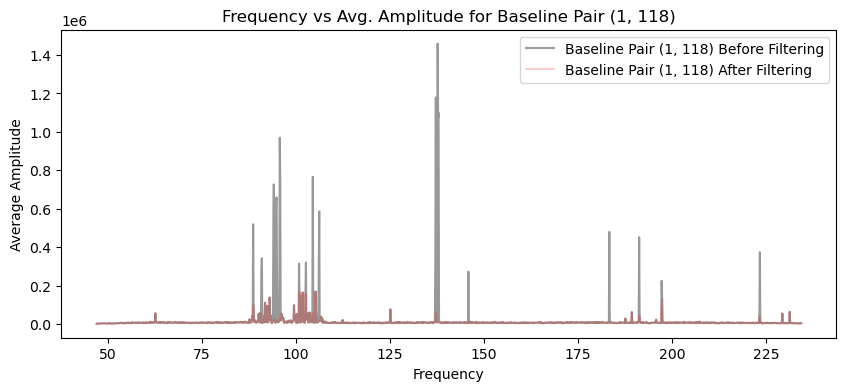

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18739669 -0.19209118 -0.18638192 ... -0.17040358 -0.17248418
 -0.17083955]


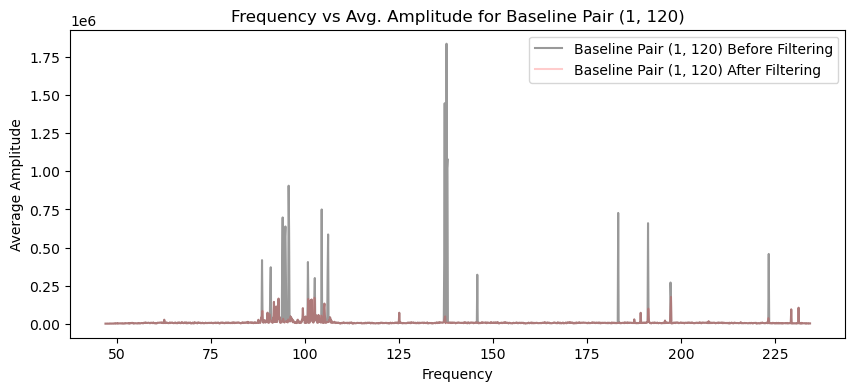

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15817805 -0.15799579 -0.15548091 ... -0.14961604 -0.14378252
 -0.14166634]


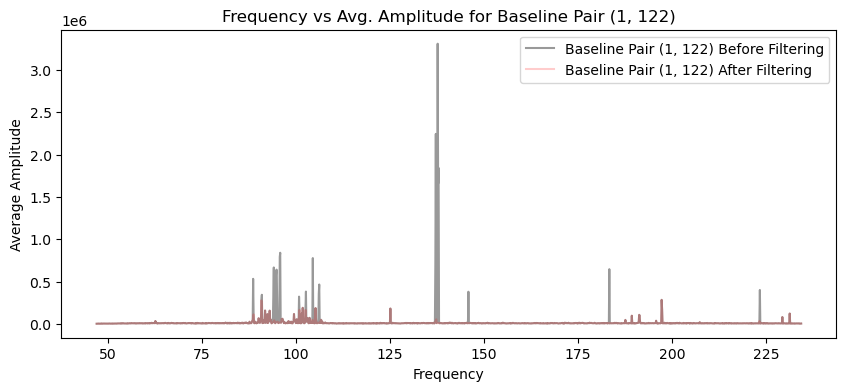

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1654793  -0.16755649 -0.15794326 ... -0.13629391 -0.13344712
 -0.14156981]


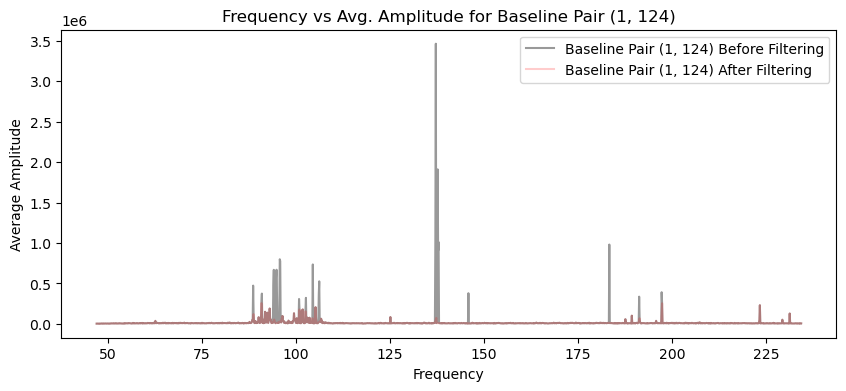

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.1828674  -0.18225196 -0.17897046 ... -0.16039034 -0.15115196
 -0.17189202]


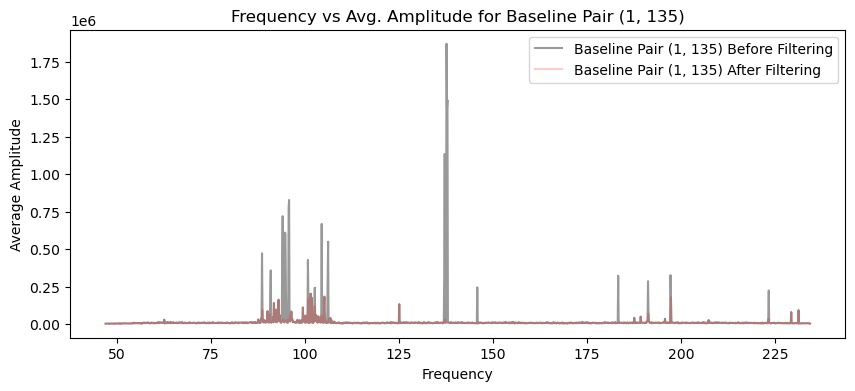

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17814114 -0.17568261 -0.17511009 ... -0.14782176 -0.16440517
 -0.16550701]


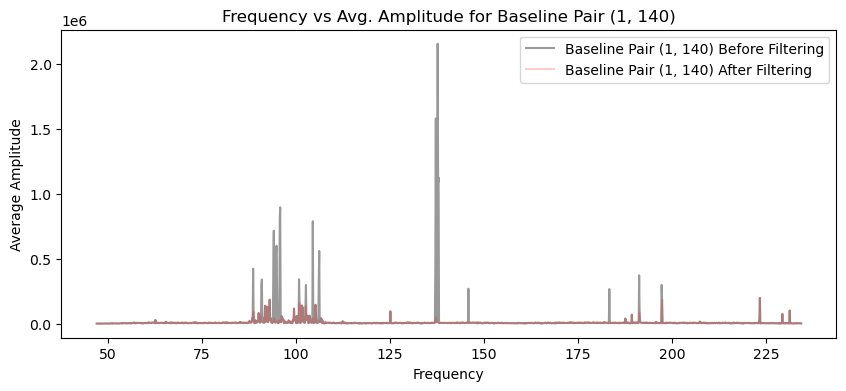

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.18101566 -0.18126356 -0.17845312 ... -0.1537365  -0.15007661
 -0.15599681]


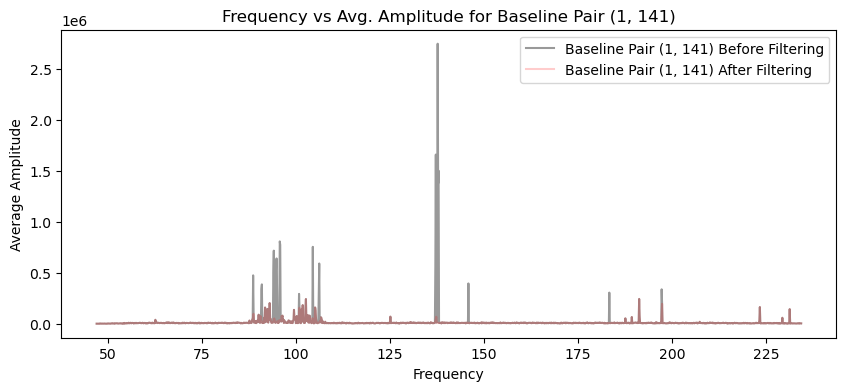

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.14826163 -0.15642393 -0.15156087 ... -0.09479667 -0.06532635
 -0.04557156]


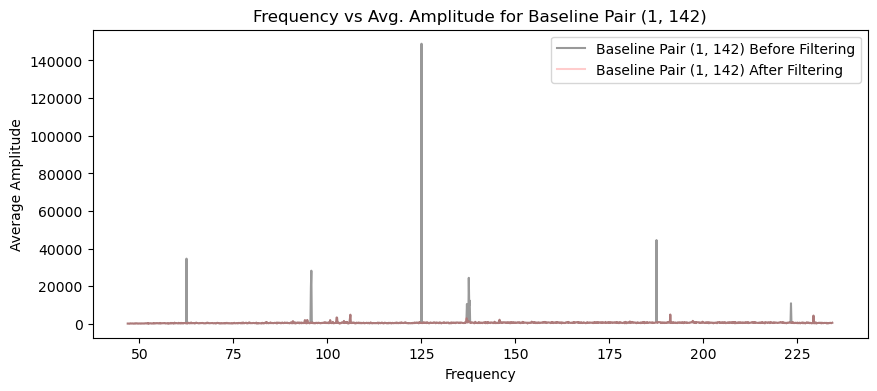

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.20800898 -0.22120273 -0.2129535  ... -0.17838984 -0.20182285
 -0.17823973]


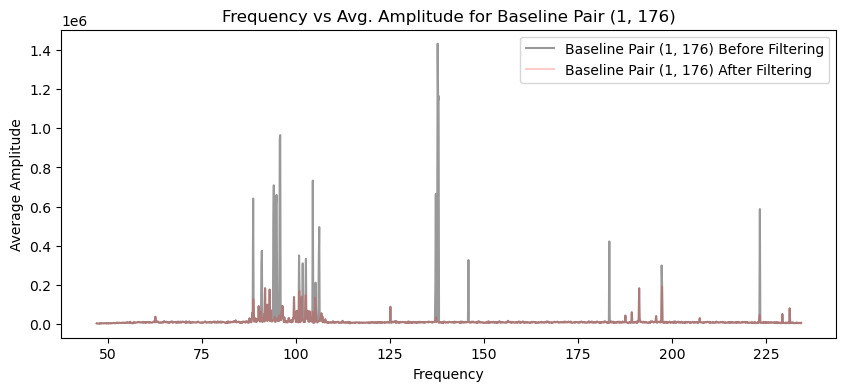

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.1386841  -0.13792191 -0.13547589 ... -0.13085649 -0.12875994
 -0.13941048]


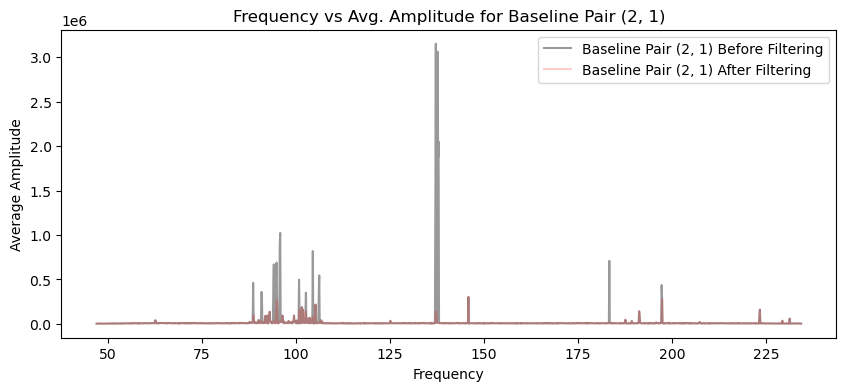

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.20235609 -0.18666587 -0.1964254  ... -0.19361749 -0.18121893
 -0.19129689]


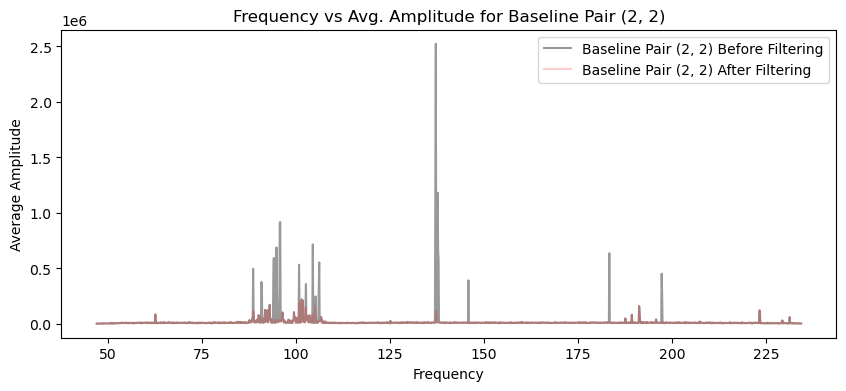

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.14296692 -0.15162467 -0.1468702  ... -0.14427766 -0.14834216
 -0.15251509]


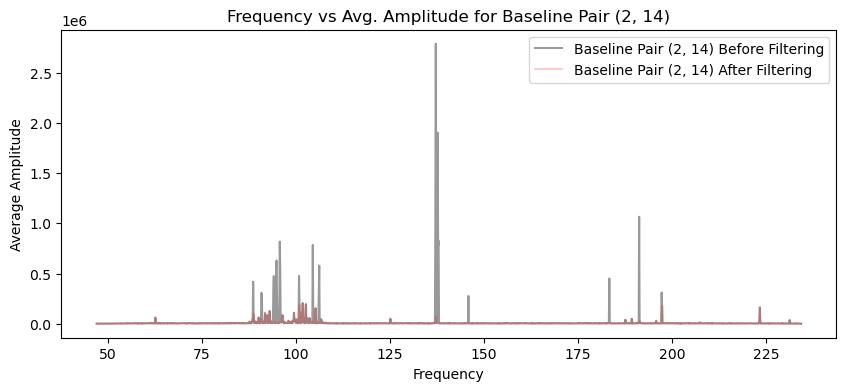

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.10103496 -0.09511319 -0.09982304 ... -0.09486594 -0.09178774
 -0.09231783]


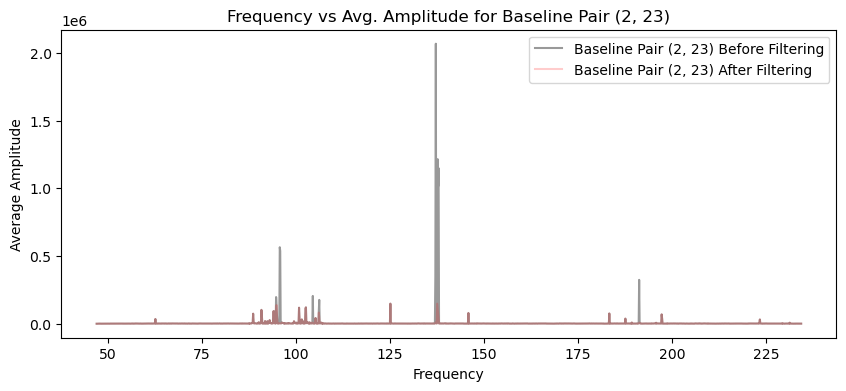

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.15377182 -0.14665155 -0.15539172 ... -0.13501372 -0.15163483
 -0.14072706]


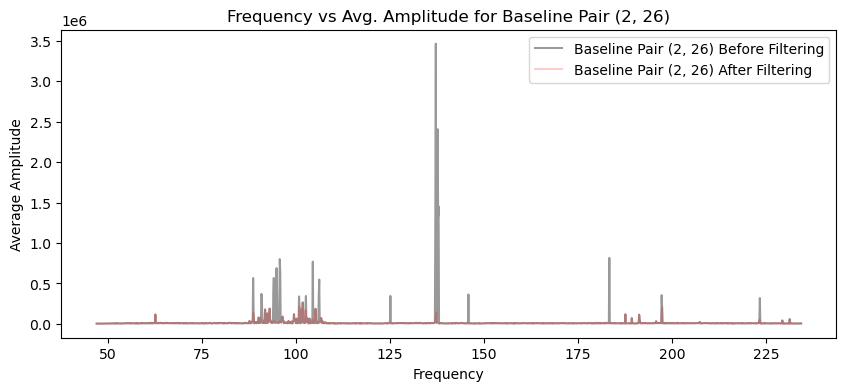

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.1717225  -0.15761597 -0.1673776  ... -0.13254042 -0.13055136
 -0.1663308 ]


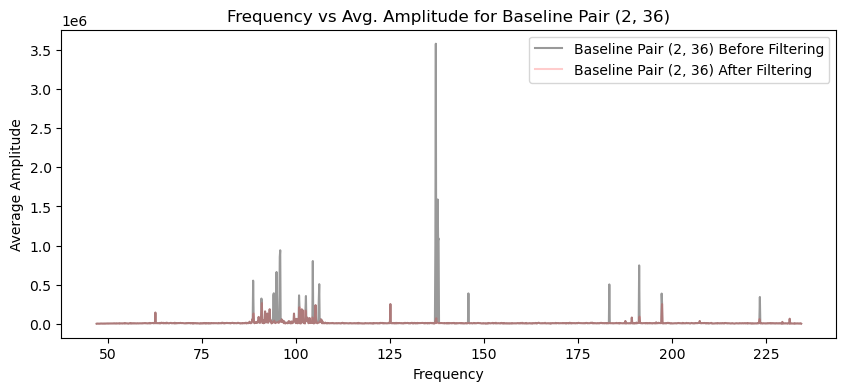

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.20828248 -0.19427544 -0.19886848 ... -0.19168581 -0.19030944
 -0.18884127]


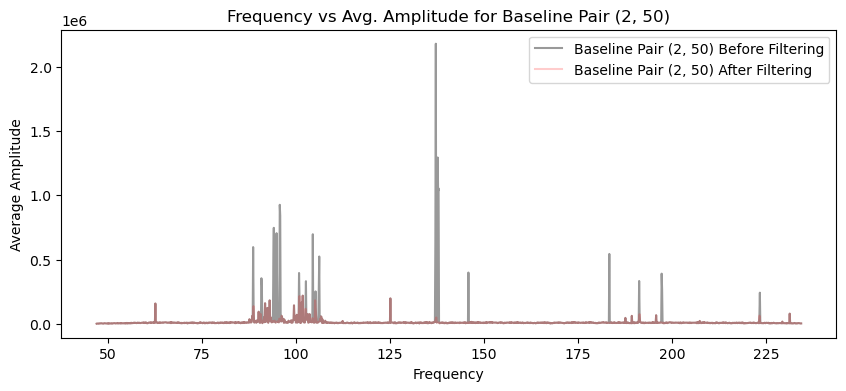

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.12734818 -0.12340858 -0.12927997 ... -0.12263692 -0.12165791
 -0.11774599]


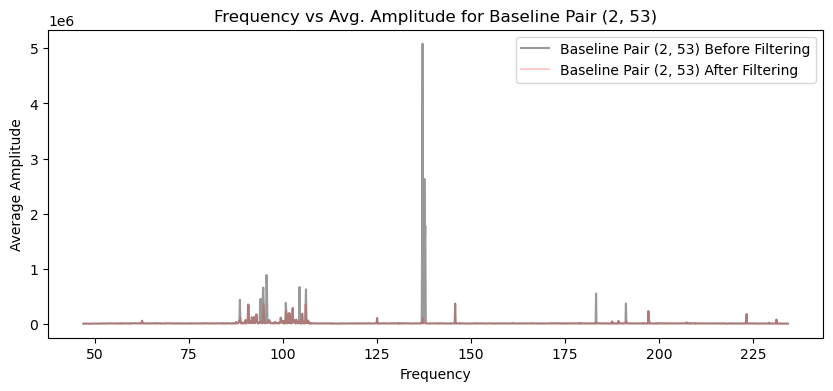

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.14836619 -0.15365897 -0.15399496 ... -0.13356075 -0.14339399
 -0.14351179]


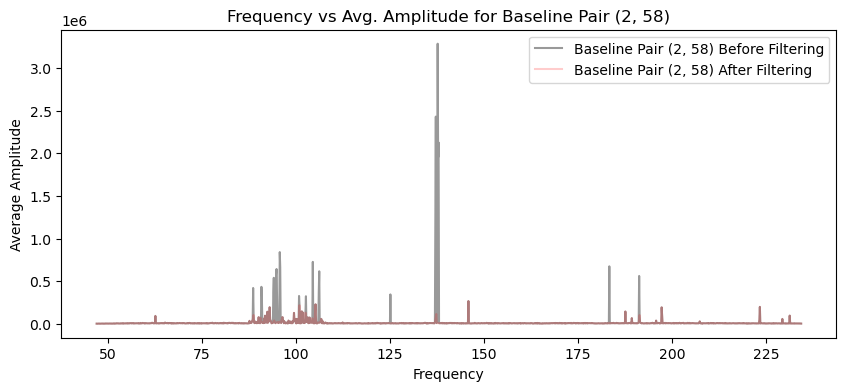

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15703222 -0.15706873 -0.1581122  ... -0.14655122 -0.14368057
 -0.14634254]


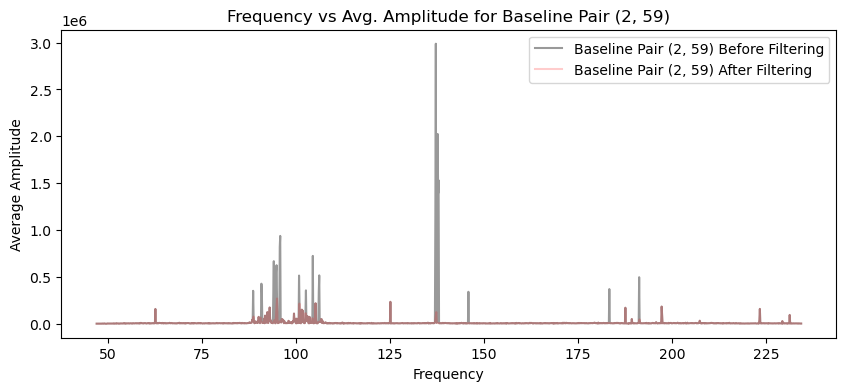

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.3538174  -0.3103549  -0.33183062 ... -0.10756053  0.00374967
 -0.19333641]


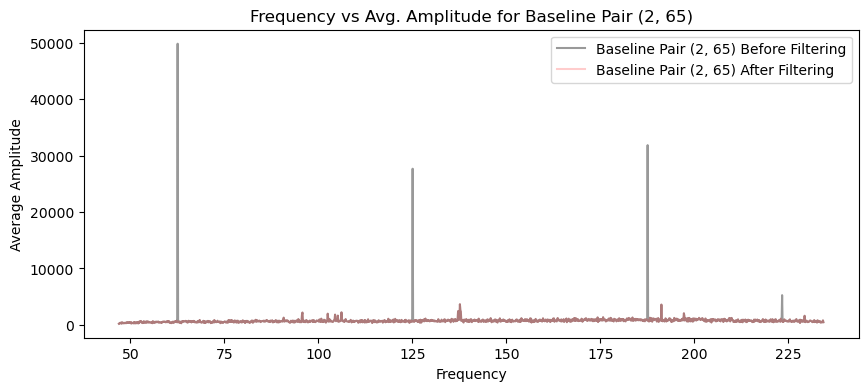

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.1847956  -0.1812924  -0.18078823 ... -0.16522845 -0.16931107
 -0.15420089]


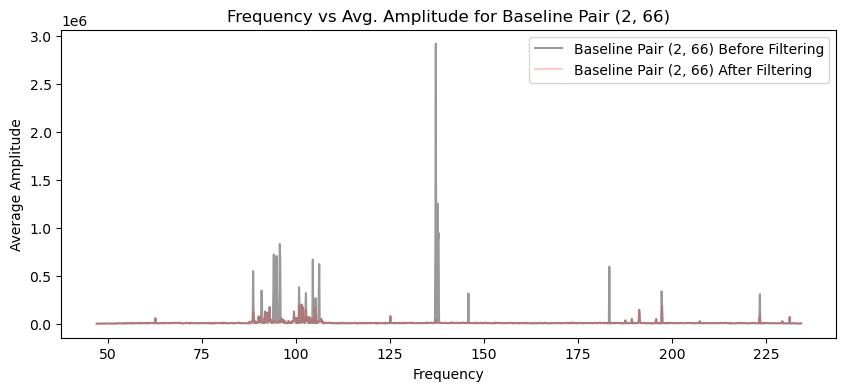

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.13749783 -0.13086352 -0.13868274 ... -0.12121776 -0.13014627
 -0.12811824]


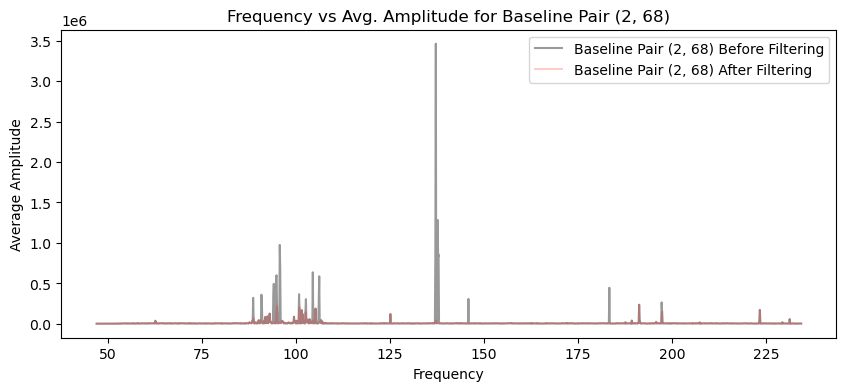

freqs shape: (1536,)
freqs_filtered shape: (1522,)
amplitudes_filtered shape: (20, 1522)
Threshold for baseline: [-0.09889566 -0.09991012 -0.09987003 ... -0.0923665  -0.08967919
 -0.09220437]


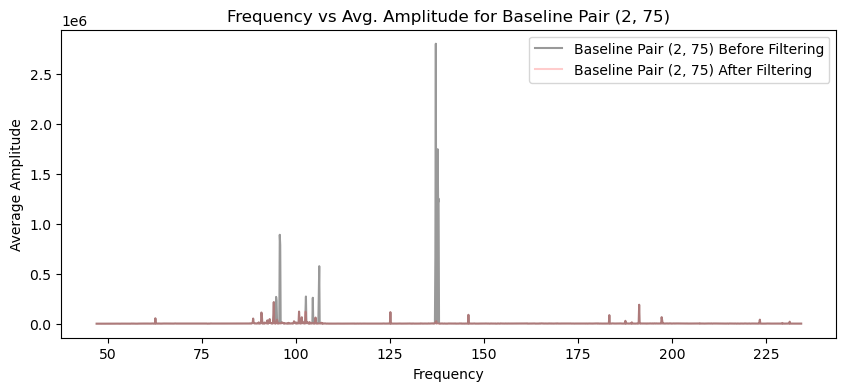

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15108508 -0.15167545 -0.15415846 ... -0.13690356 -0.13997057
 -0.14184189]


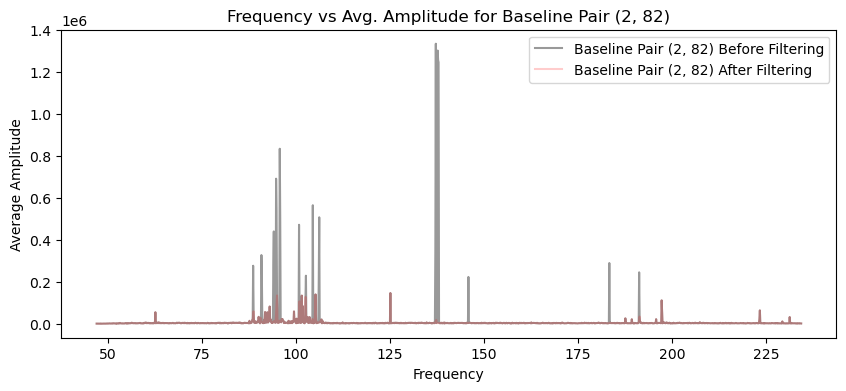

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.18883837 -0.19093479 -0.1893685  ... -0.16548856 -0.16871339
 -0.16382585]


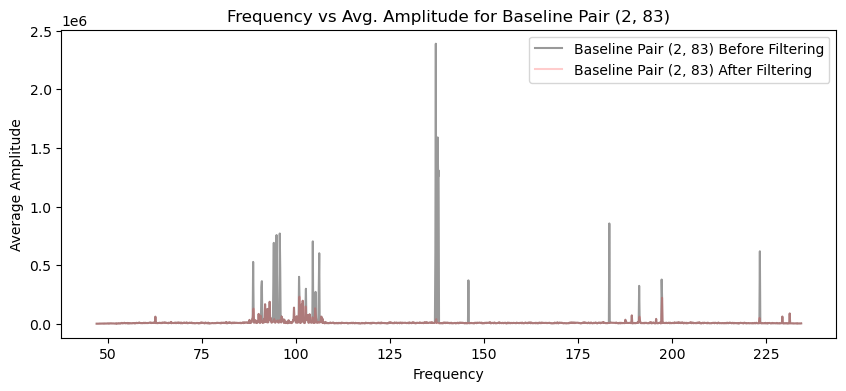

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.30329435 -0.32932627 -0.28953164 ... -0.06912813 -0.18721651
 -0.06153775]


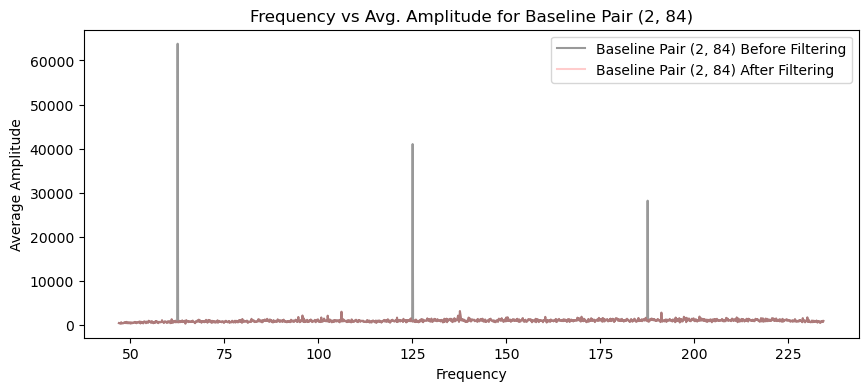

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.16522189 -0.15786737 -0.16991681 ... -0.14754372 -0.1595469
 -0.15308372]


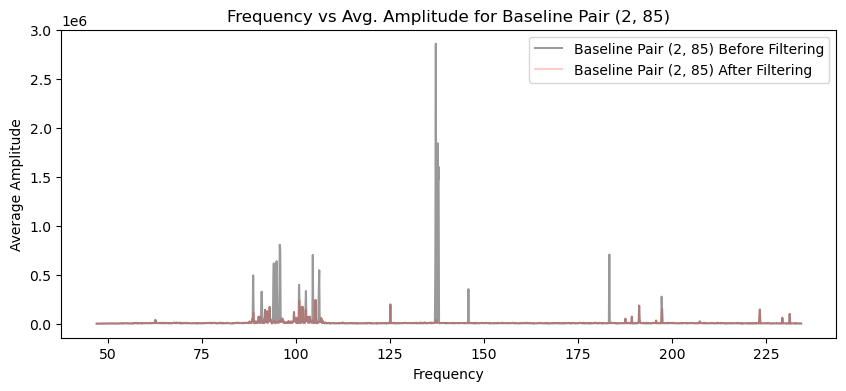

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.1362289  -0.13941968 -0.13741986 ... -0.12396572 -0.12673408
 -0.12241464]


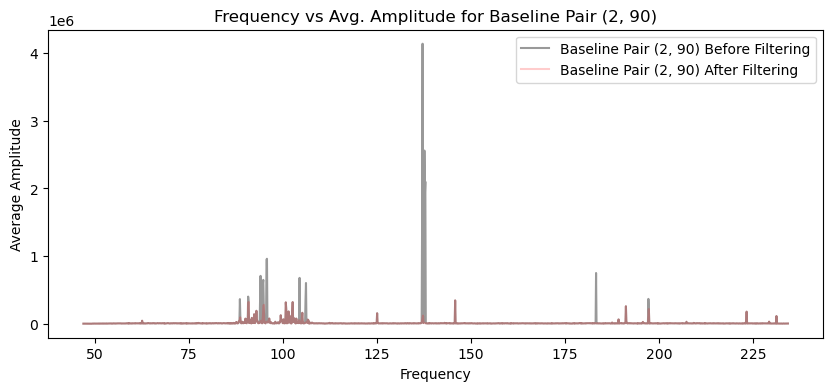

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14969384 -0.14416071 -0.13831225 ... -0.13778255 -0.13986585
 -0.14275194]


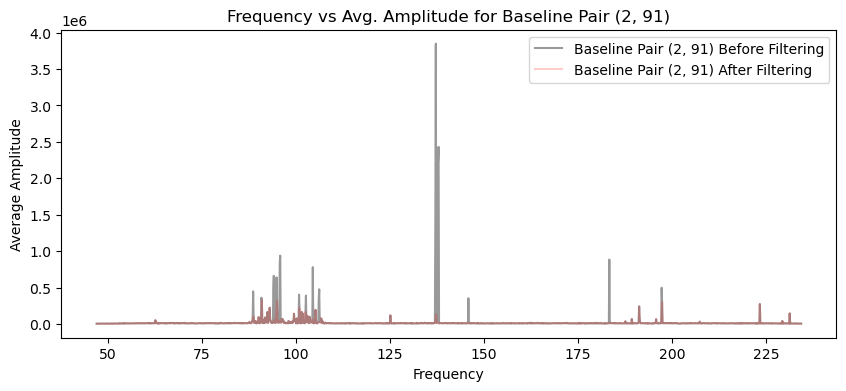

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.15953696 -0.11275141 -0.15297629 ... -0.03046267 -0.05166881
 -0.05913714]


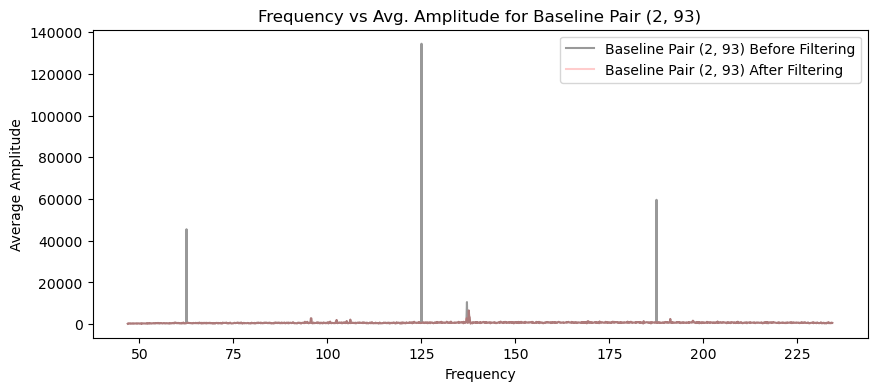

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19117697 -0.18810796 -0.17734653 ... -0.14360473 -0.17610069
 -0.16413768]


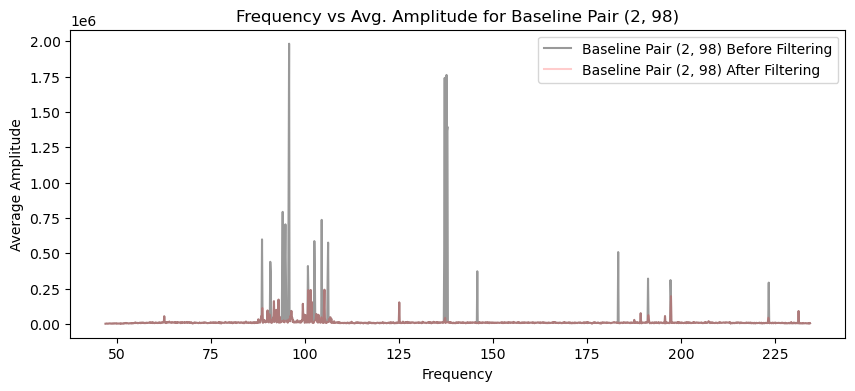

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.1823951  -0.19022774 -0.18575836 ... -0.15650092 -0.15737619
 -0.15787221]


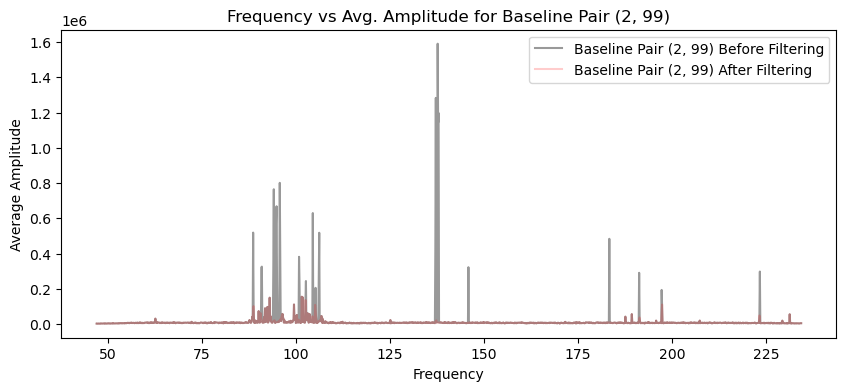

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16978445 -0.18886292 -0.17460583 ... -0.17782397 -0.15863934
 -0.16290575]


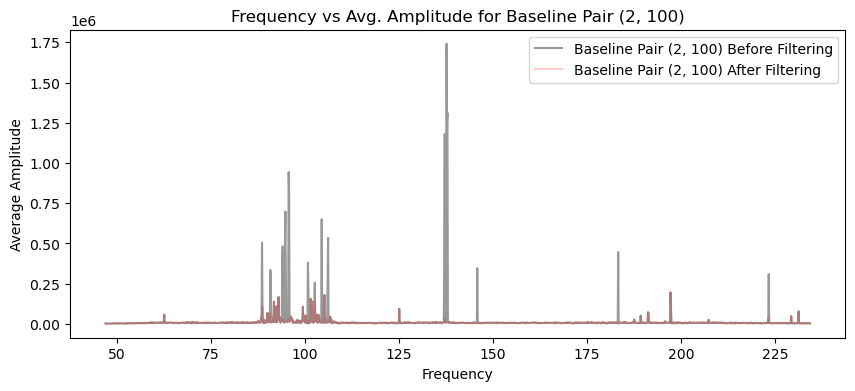

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.20776437 -0.21769337 -0.21419965 ... -0.16798085 -0.18896293
 -0.16684979]


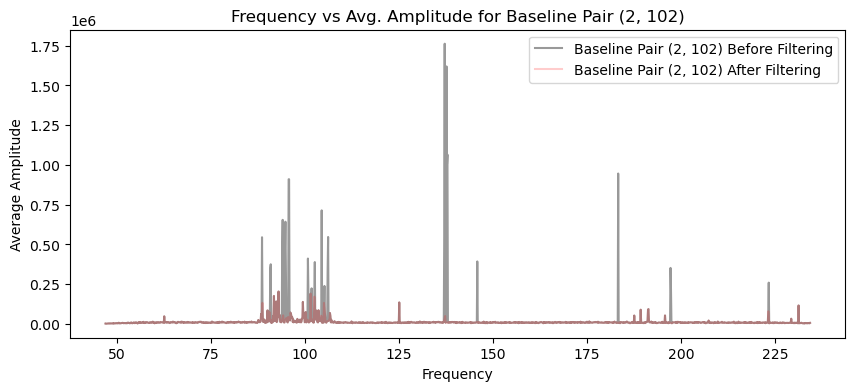

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15803943 -0.15454635 -0.15256036 ... -0.14230139 -0.14062313
 -0.13974771]


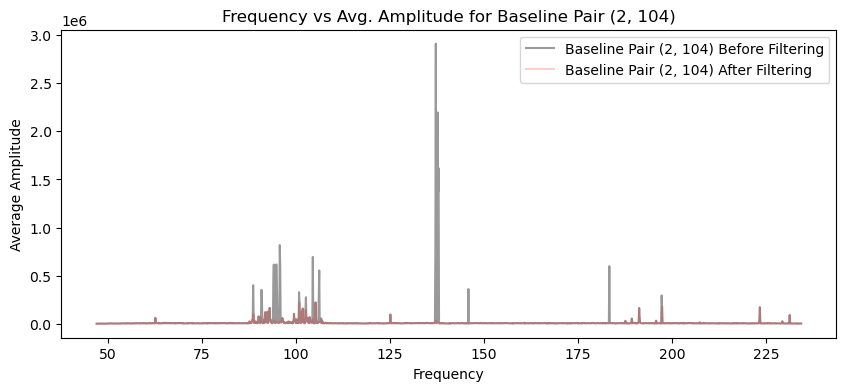

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.18946488 -0.20663302 -0.19198069 ... -0.17346745 -0.191026
 -0.18655698]


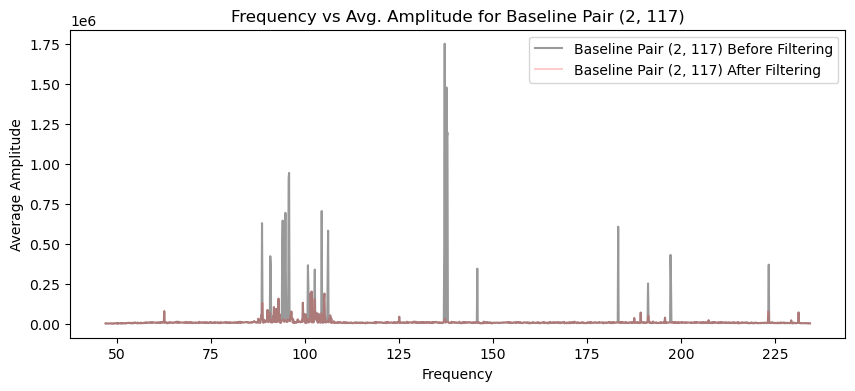

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19924961 -0.20162635 -0.19234179 ... -0.18138848 -0.16978118
 -0.16095938]


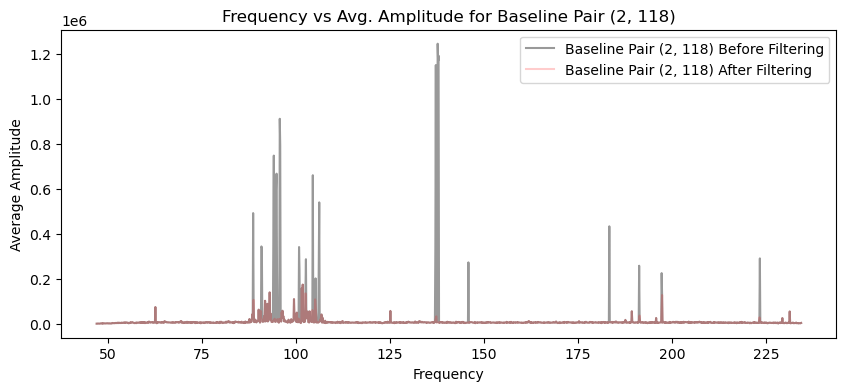

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.20547917 -0.19420461 -0.19828765 ... -0.17130321 -0.17403709
 -0.17698061]


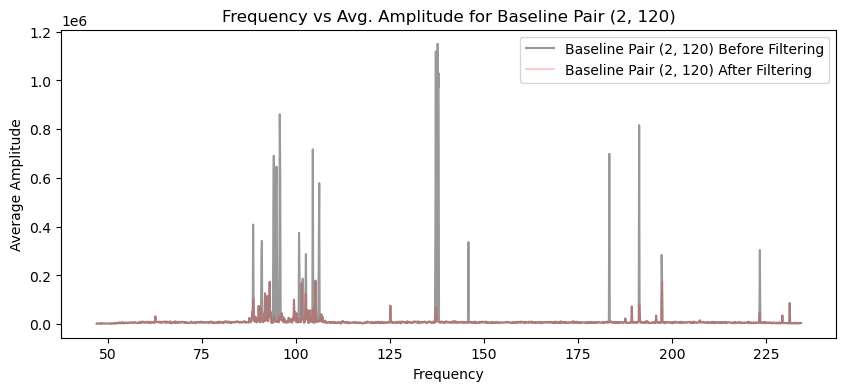

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16696606 -0.17940735 -0.18422254 ... -0.1738006  -0.16668439
 -0.15965734]


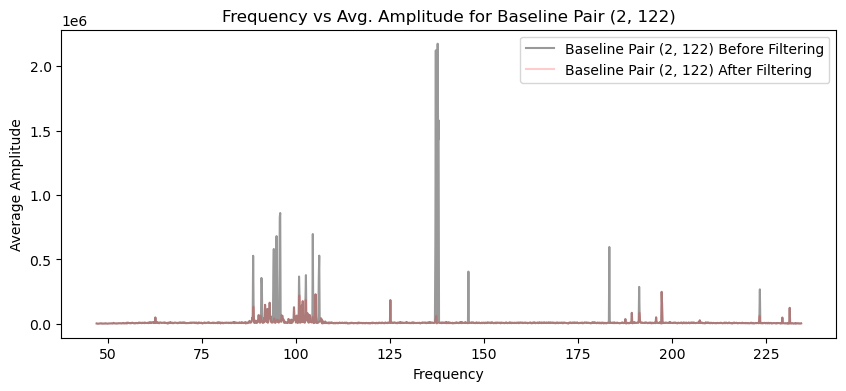

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15845604 -0.16165142 -0.15099689 ... -0.12781962 -0.15224783
 -0.14813738]


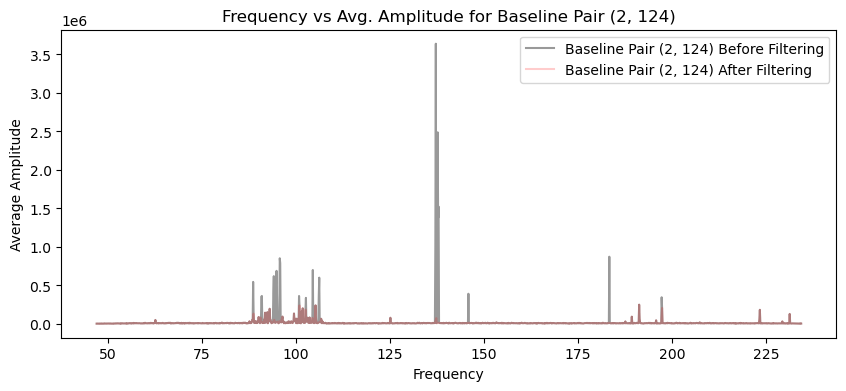

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19968871 -0.18947666 -0.19565564 ... -0.18635531 -0.19184698
 -0.19743113]


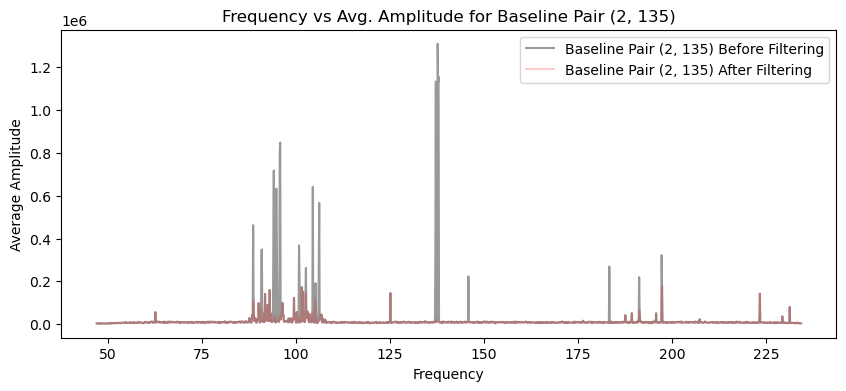

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19992139 -0.20743768 -0.2139532  ... -0.17725414 -0.1923226
 -0.19695703]


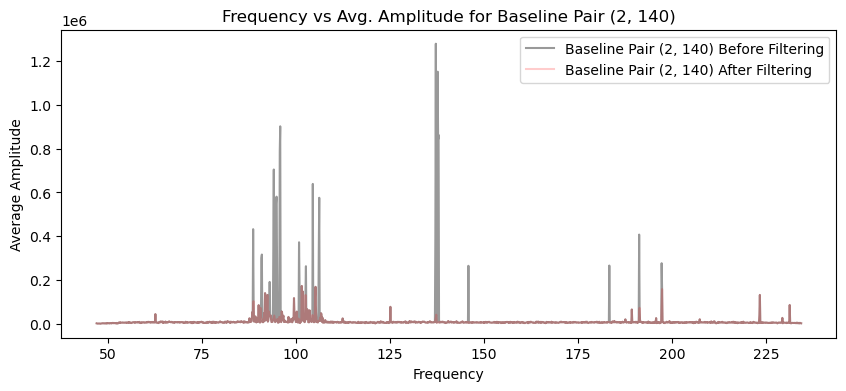

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.20401321 -0.19977549 -0.19034046 ... -0.18778677 -0.18107118
 -0.14970549]


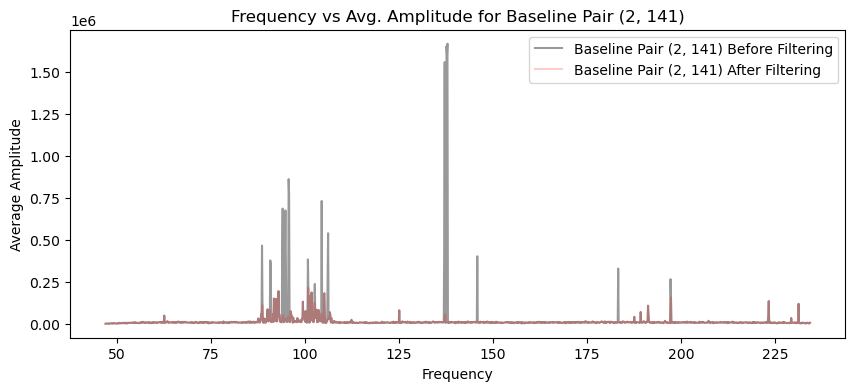

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.12847933 -0.13716347 -0.12231407 ... -0.03280067 -0.04037168
 -0.1101206 ]


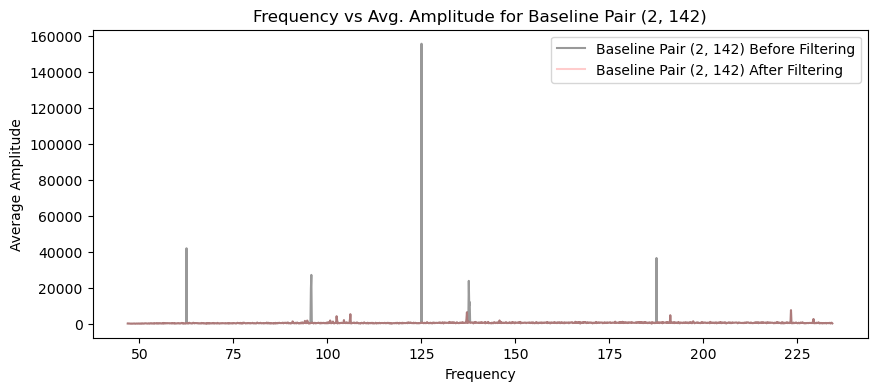

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.22221921 -0.22515312 -0.21437782 ... -0.17113592 -0.20351655
 -0.21053037]


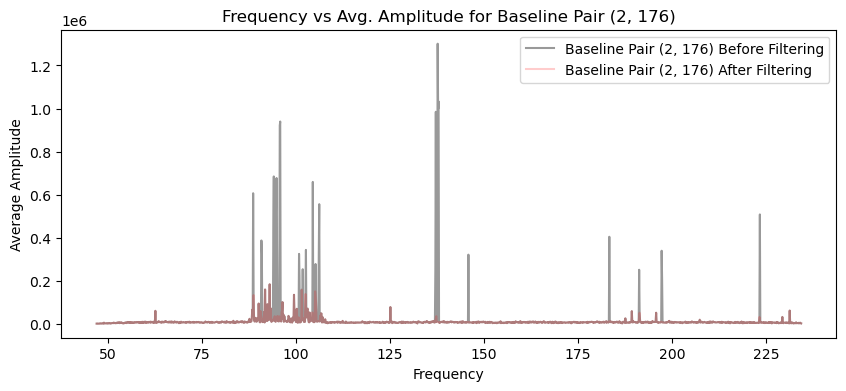

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.17869354 -0.17037927 -0.17929138 ... -0.17779575 -0.20339805
 -0.18530315]


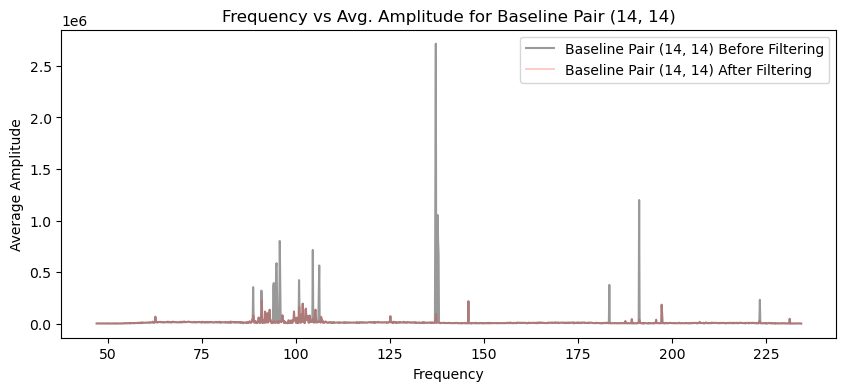

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.09390934 -0.09362954 -0.09417807 ... -0.08713823 -0.08497489
 -0.08096386]


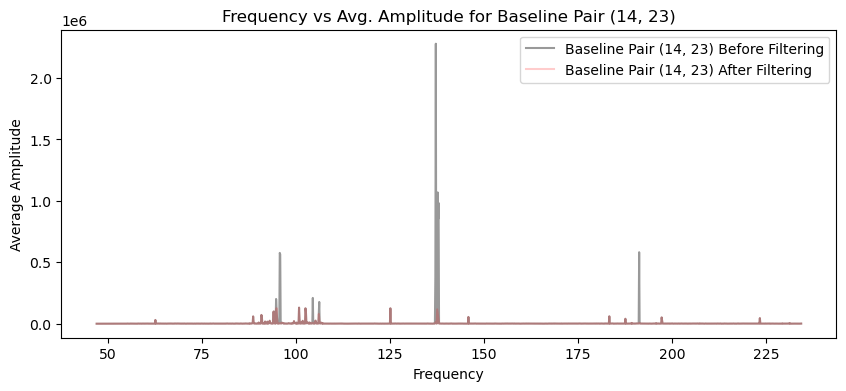

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.15342866 -0.15459186 -0.14967514 ... -0.15152593 -0.13205543
 -0.14189273]


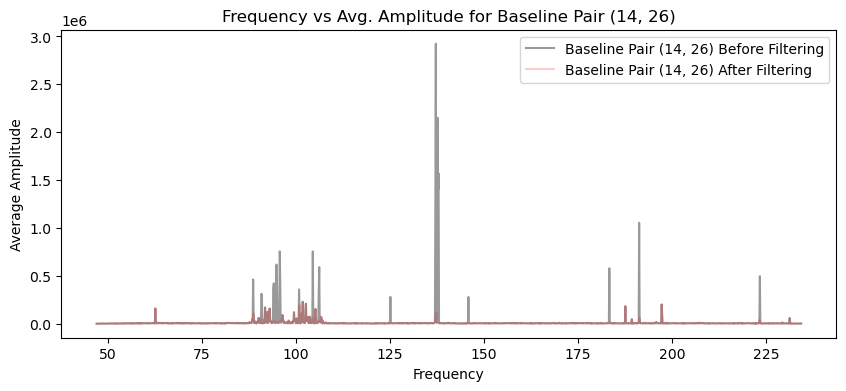

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15648878 -0.15980987 -0.16124652 ... -0.14829289 -0.14441854
 -0.14989999]


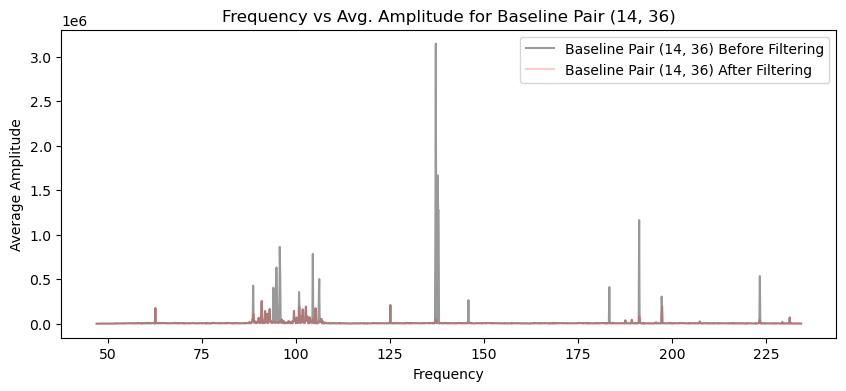

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.16568994 -0.1714021  -0.17278781 ... -0.14655326 -0.15503507
 -0.15552648]


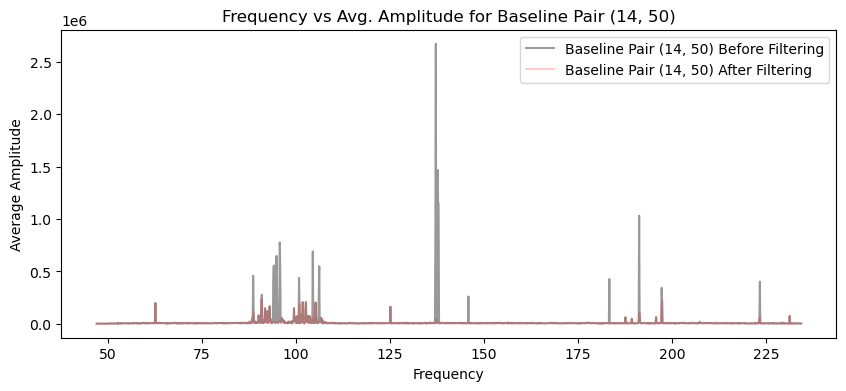

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14279994 -0.13637813 -0.1454727  ... -0.12586026 -0.12430772
 -0.12647974]


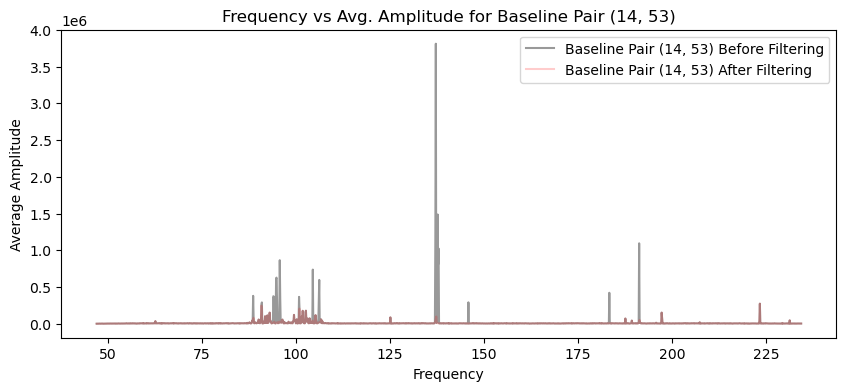

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14018988 -0.14145873 -0.14381743 ... -0.12778084 -0.13097346
 -0.14033092]


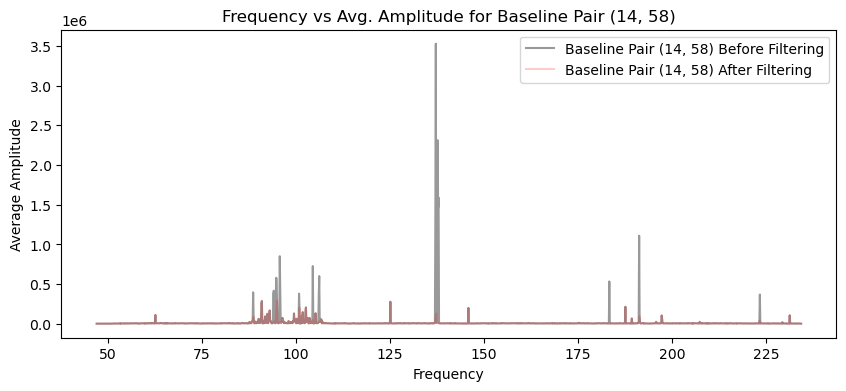

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.13858395 -0.13467773 -0.13256063 ... -0.12301904 -0.12457573
 -0.12194866]


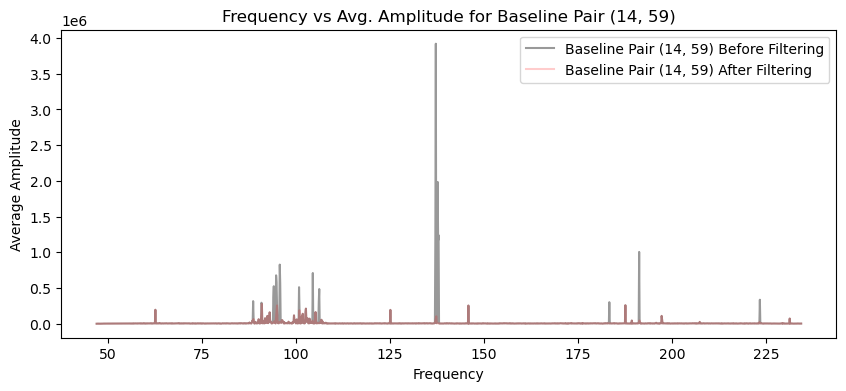

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.270589   -0.30559443 -0.27846113 ... -0.23009421 -0.04684931
 -0.07084835]


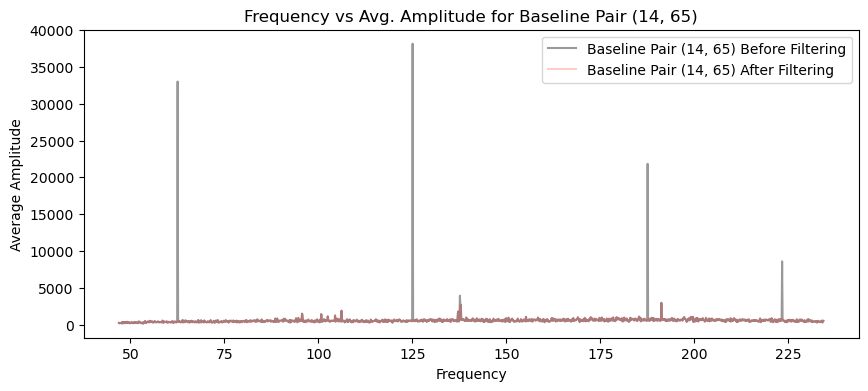

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15805535 -0.15731838 -0.15711273 ... -0.14163463 -0.13803471
 -0.15013283]


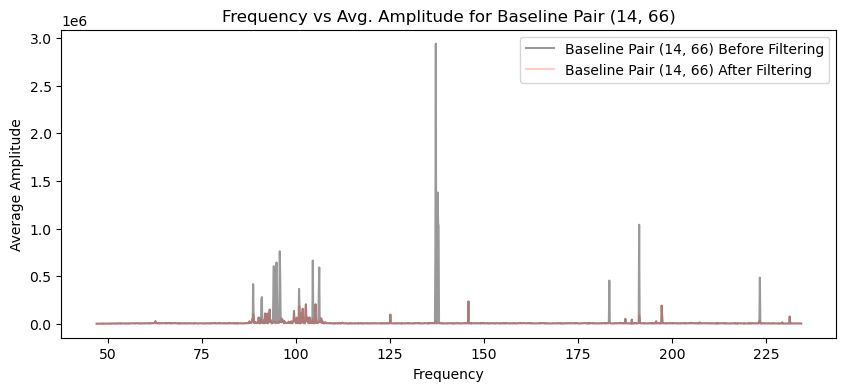

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14158955 -0.14361302 -0.15001424 ... -0.13352746 -0.13595114
 -0.12714401]


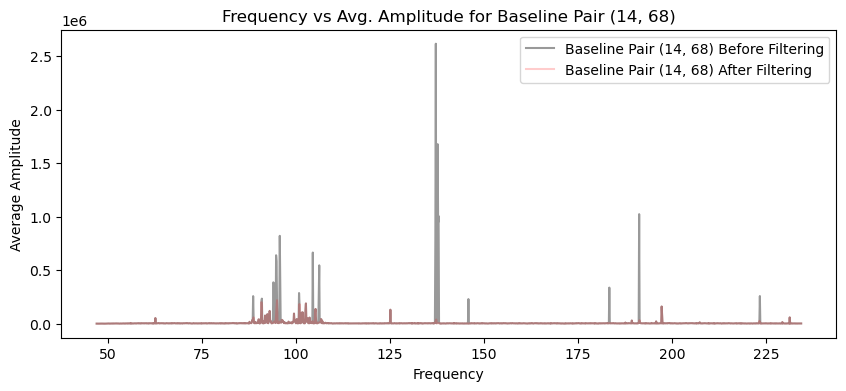

freqs shape: (1536,)
freqs_filtered shape: (1522,)
amplitudes_filtered shape: (20, 1522)
Threshold for baseline: [-0.09575091 -0.09429386 -0.09513154 ... -0.08830661 -0.08707084
 -0.08876541]


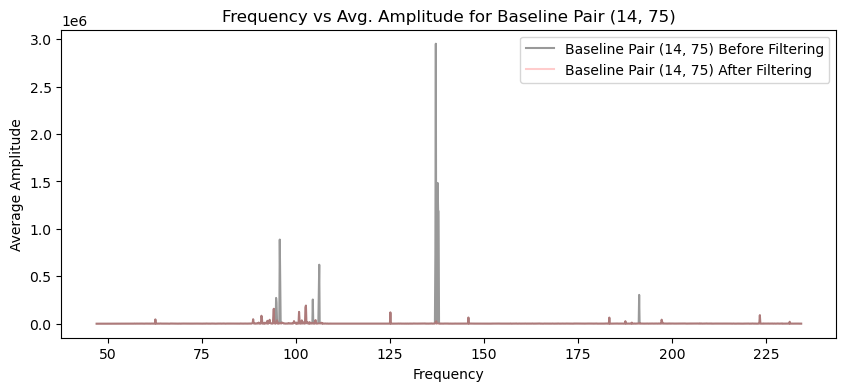

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.13921853 -0.13860599 -0.13486344 ... -0.13036761 -0.12422978
 -0.13300681]


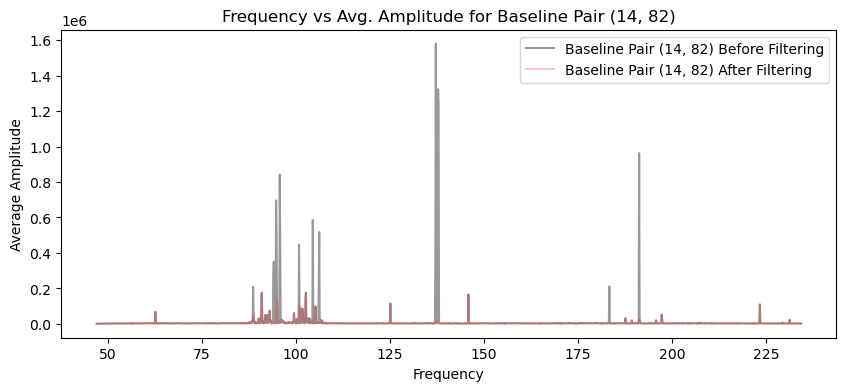

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18122358 -0.18405613 -0.1760566  ... -0.15882961 -0.17141283
 -0.17382605]


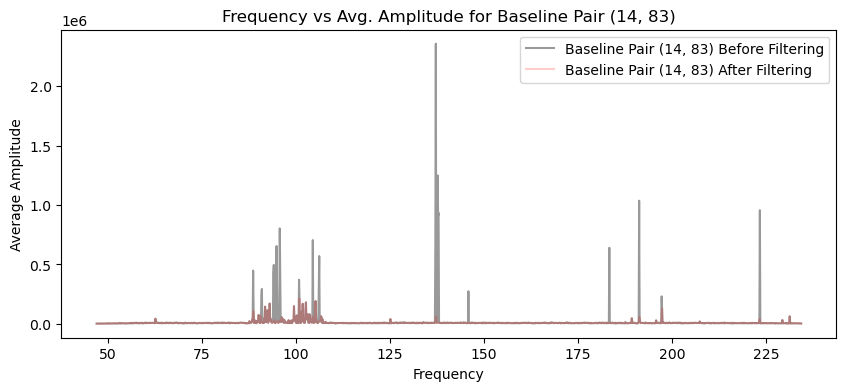

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.22055977 -0.21668784 -0.22119011 ... -0.01577848 -0.22987746
 -0.17357941]


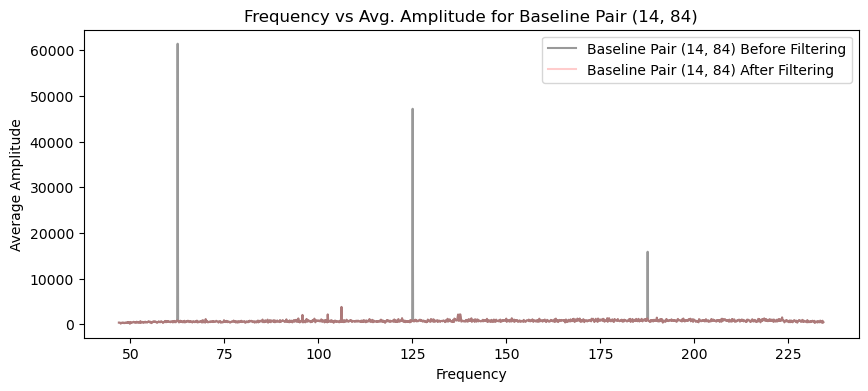

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15983496 -0.16060681 -0.16264571 ... -0.14894557 -0.14522558
 -0.14542619]


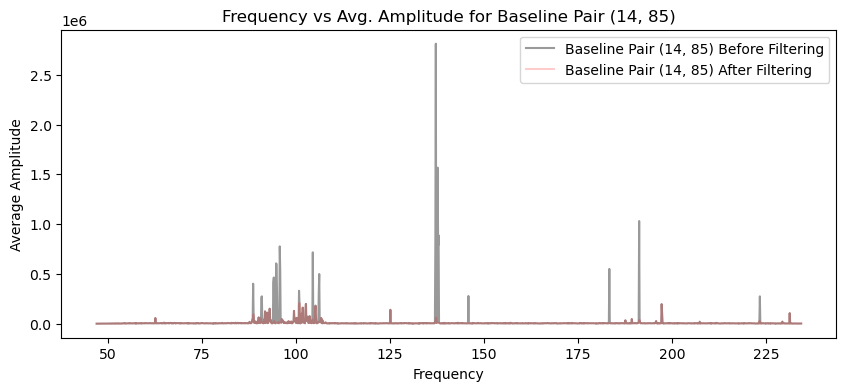

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.13358067 -0.13666978 -0.13252152 ... -0.12809607 -0.11134877
 -0.12081013]


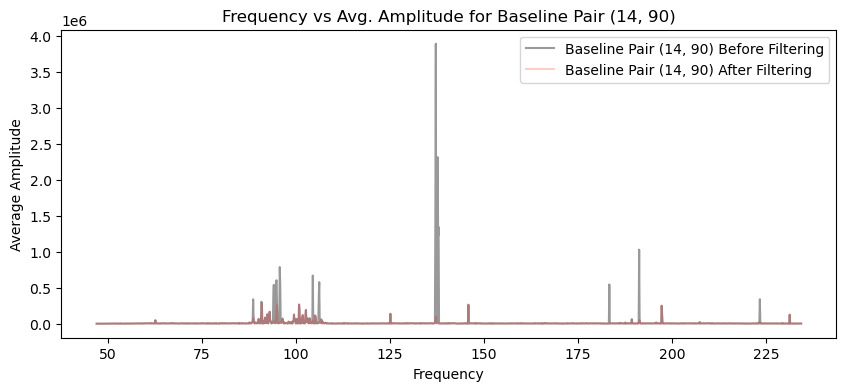

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14158942 -0.14669349 -0.15276704 ... -0.13916554 -0.13034485
 -0.13094919]


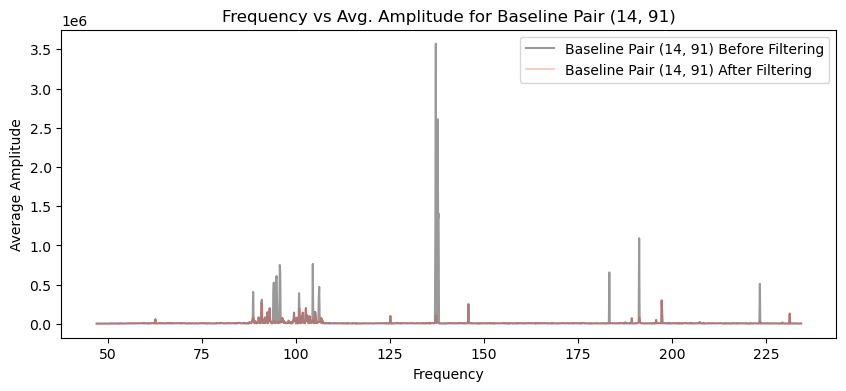

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.10169104 -0.12121617 -0.1462693  ... -0.0946062  -0.10757565
 -0.11315864]


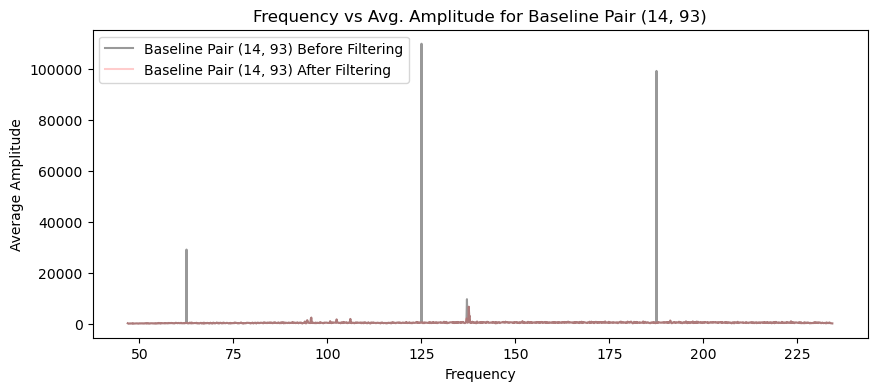

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.1879137  -0.17946044 -0.18579721 ... -0.15077281 -0.15398545
 -0.17495747]


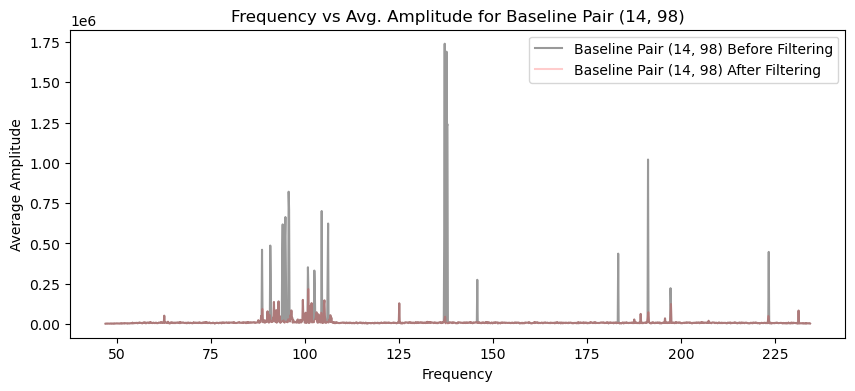

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16997608 -0.16692215 -0.16161657 ... -0.16123687 -0.1651286
 -0.15946919]


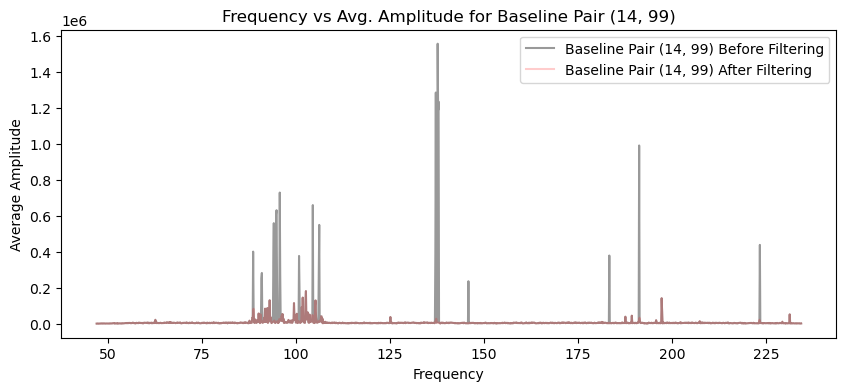

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18298041 -0.17220774 -0.178744   ... -0.15478247 -0.15215002
 -0.16031326]


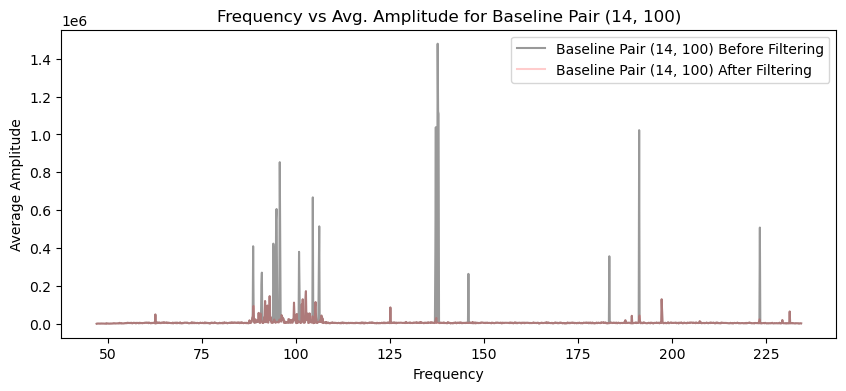

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19677996 -0.19224206 -0.19219691 ... -0.16282342 -0.17891481
 -0.15826731]


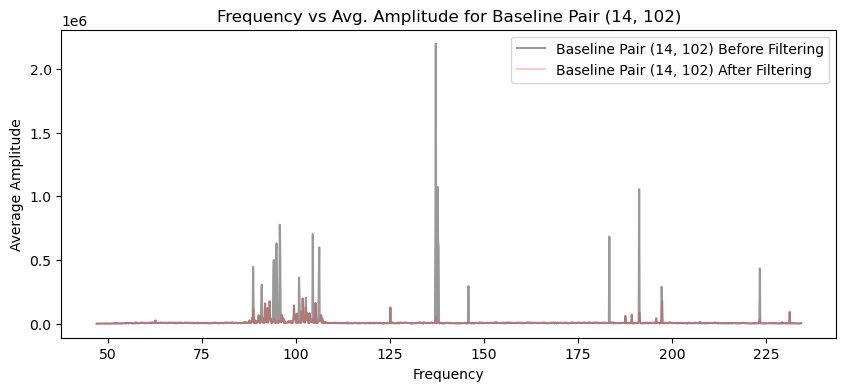

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.13727657 -0.13163908 -0.13450091 ... -0.11703829 -0.1293112
 -0.12475184]


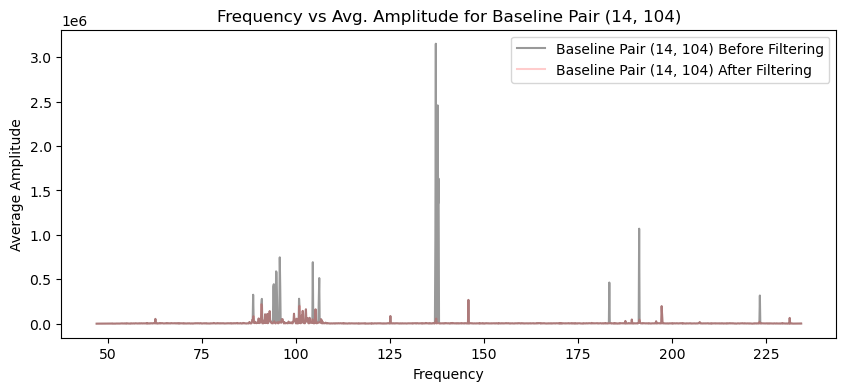

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18317301 -0.18424378 -0.19003161 ... -0.17583827 -0.17249213
 -0.16819204]


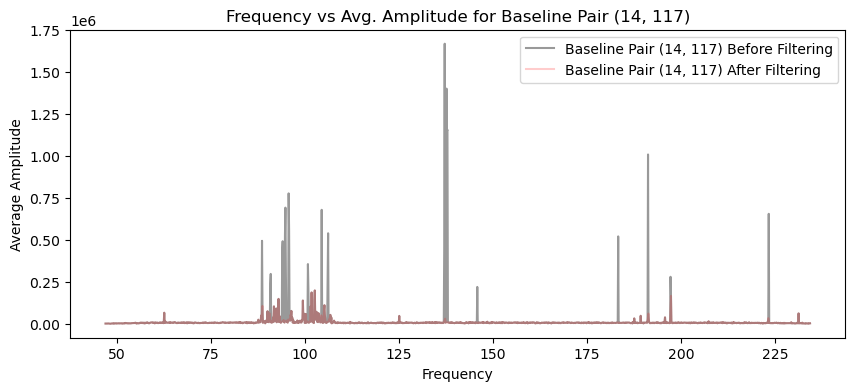

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18872766 -0.17908738 -0.18176506 ... -0.16864724 -0.17930679
 -0.1709892 ]


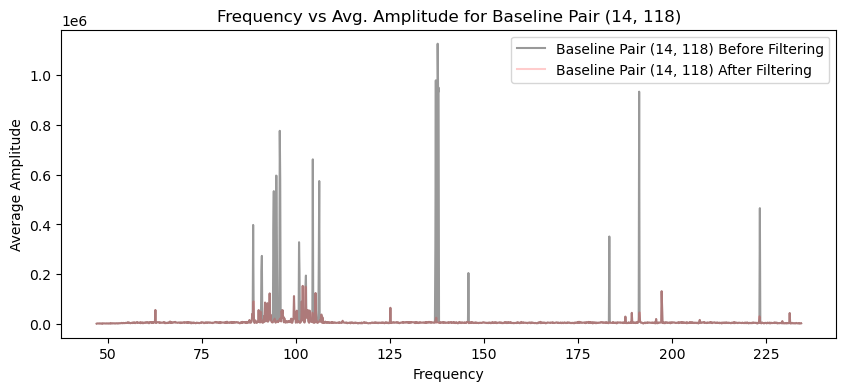

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.1872836  -0.18706583 -0.18052956 ... -0.17337586 -0.17060749
 -0.16917937]


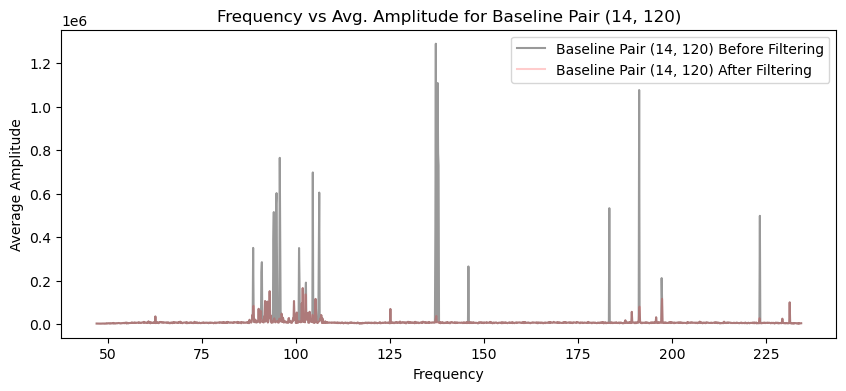

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15559012 -0.15373083 -0.15058409 ... -0.14754552 -0.15051748
 -0.12781394]


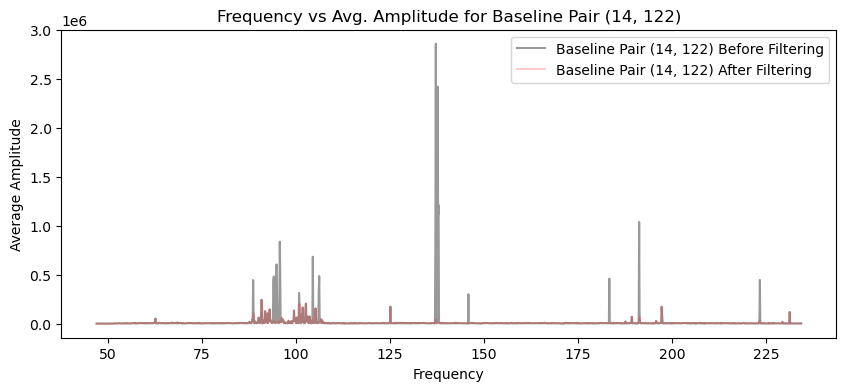

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.14061178 -0.14276378 -0.14682115 ... -0.1256768  -0.1224071
 -0.13587328]


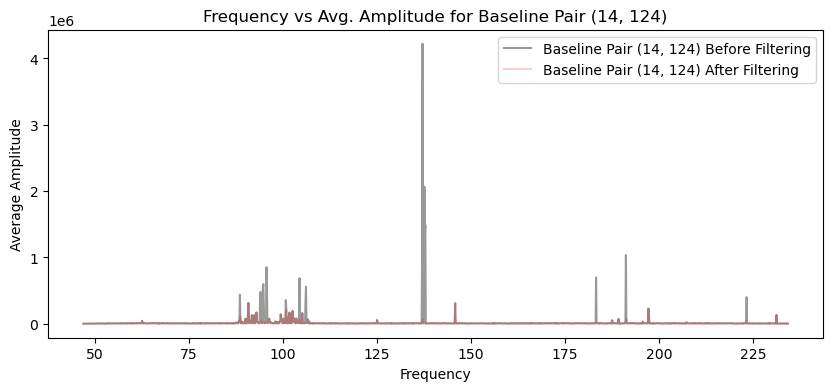

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.18825064 -0.18920343 -0.18443029 ... -0.15494215 -0.17489384
 -0.1733075 ]


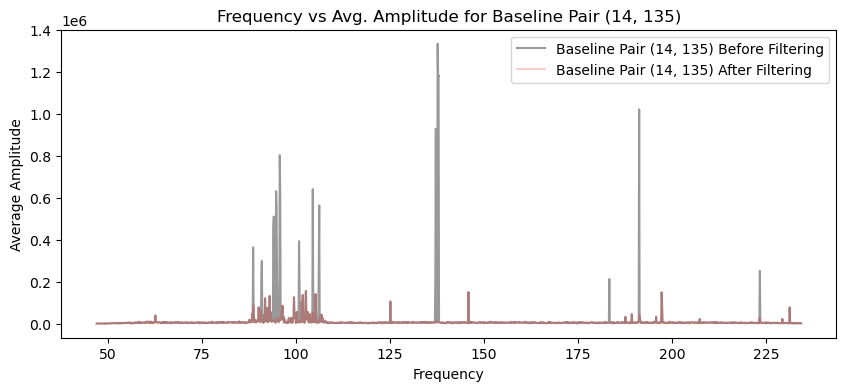

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19953133 -0.19215269 -0.19487511 ... -0.17678431 -0.16964139
 -0.17059487]


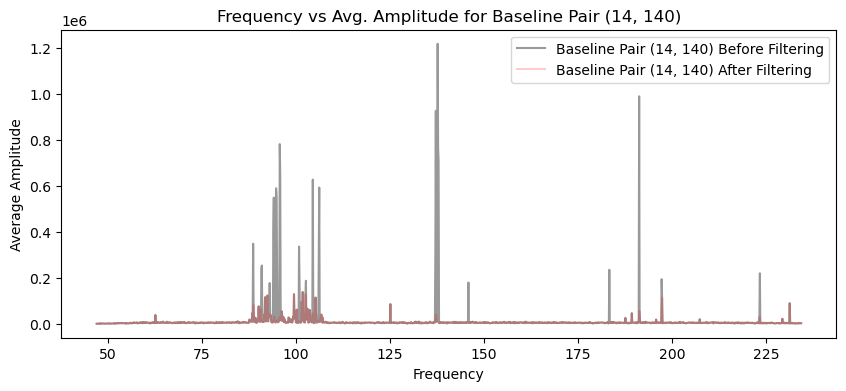

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.20450057 -0.20289677 -0.20393163 ... -0.16307475 -0.17834492
 -0.17928847]


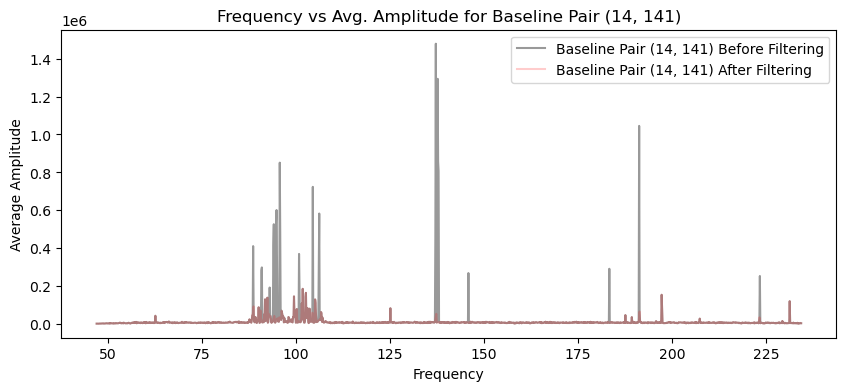

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.11288185 -0.12566387 -0.13789177 ... -0.05379409 -0.08051827
 -0.05811694]


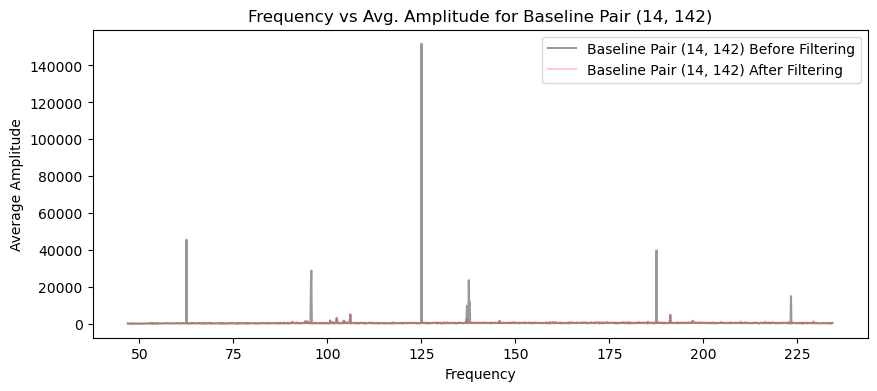

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19843896 -0.19053704 -0.20744106 ... -0.17677164 -0.19130504
 -0.18949903]


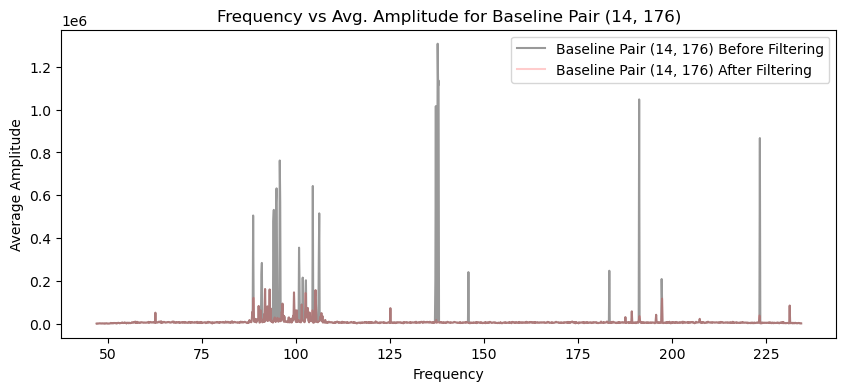

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.07237096 -0.05695136 -0.06374726 ... -0.0740796  -0.06476347
 -0.06911836]


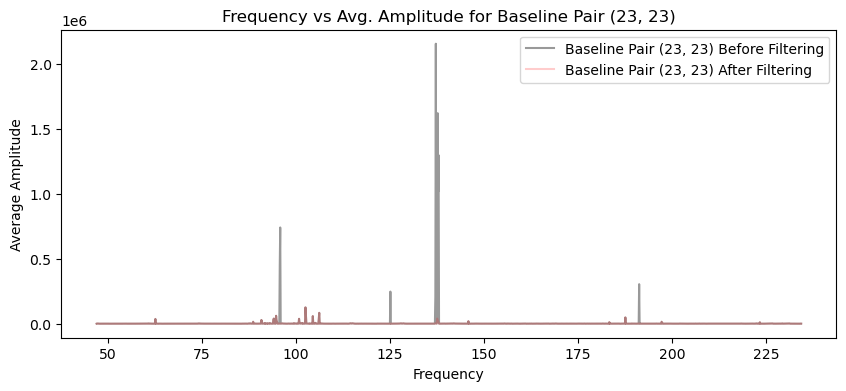

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.09308428 -0.09414794 -0.09030182 ... -0.08392152 -0.08431024
 -0.08686869]


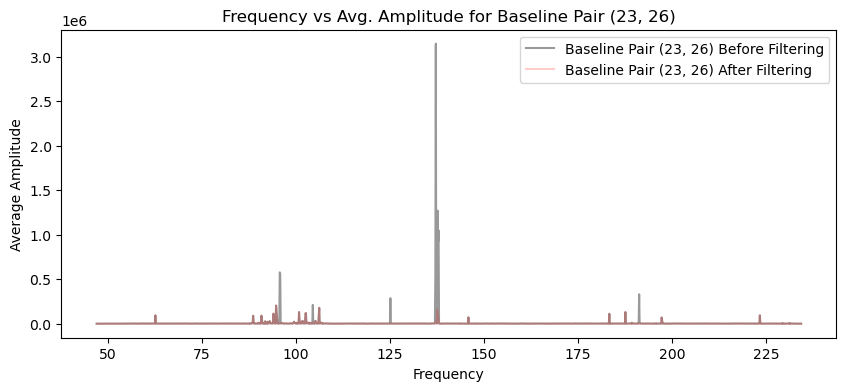

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.10148651 -0.09370566 -0.09406643 ... -0.08612323 -0.09170181
 -0.0894062 ]


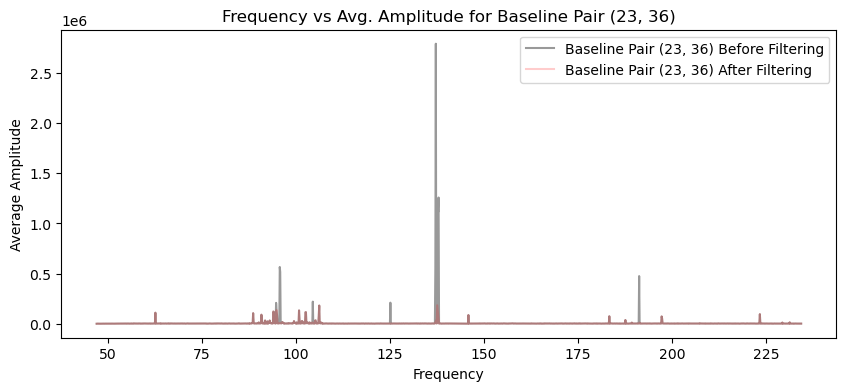

freqs shape: (1536,)
freqs_filtered shape: (1524,)
amplitudes_filtered shape: (20, 1524)
Threshold for baseline: [-0.09949368 -0.0984883  -0.09597261 ... -0.10094049 -0.09904061
 -0.09255396]


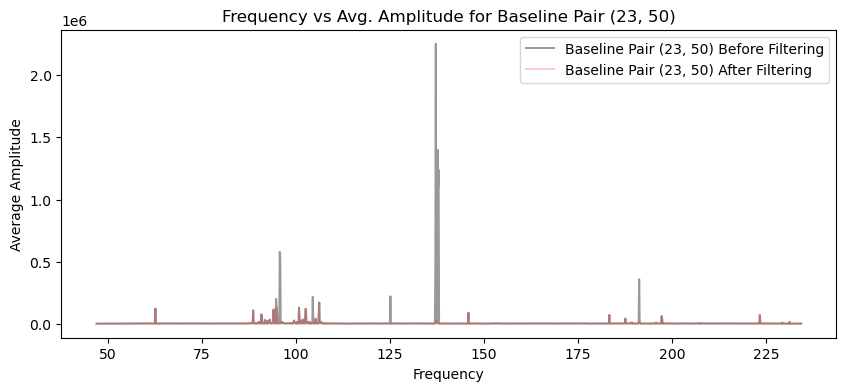

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.09656301 -0.09665639 -0.0975982  ... -0.09027837 -0.09371124
 -0.08858321]


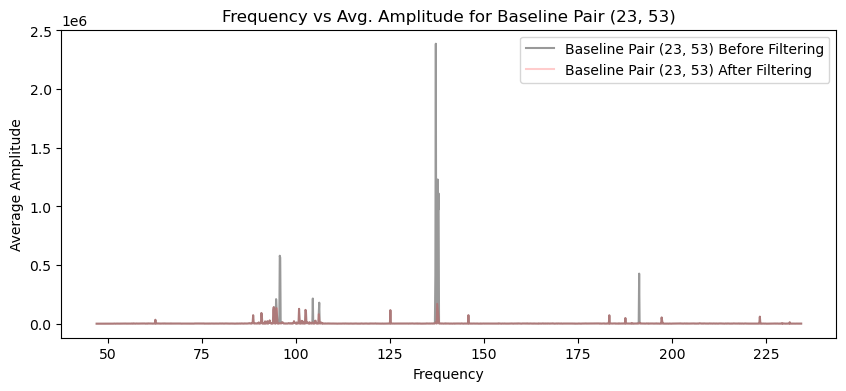

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.09115299 -0.09206851 -0.08882555 ... -0.07408861 -0.08802936
 -0.0888236 ]


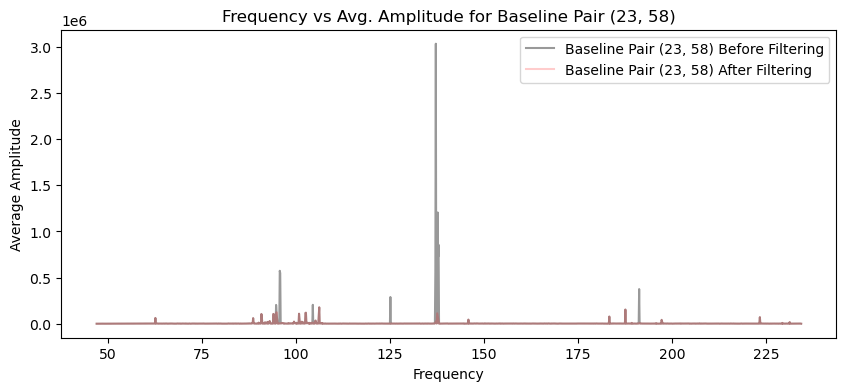

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.09289211 -0.09021692 -0.09324086 ... -0.08247476 -0.08162858
 -0.08321524]


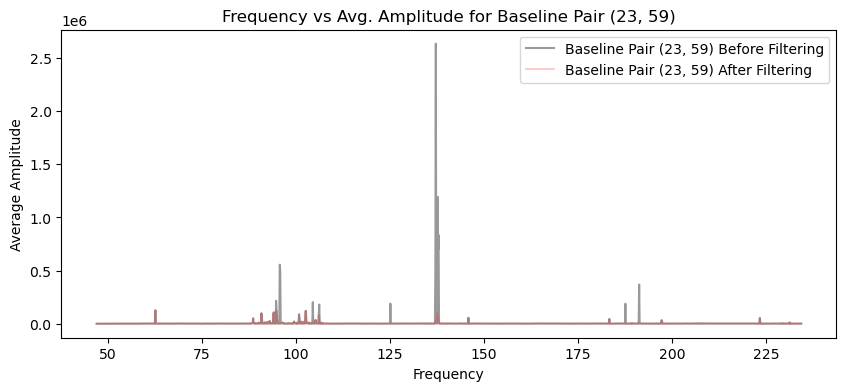

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.07403071 -0.0695705  -0.07381731 ... -0.03097085 -0.02686103
 -0.04173581]


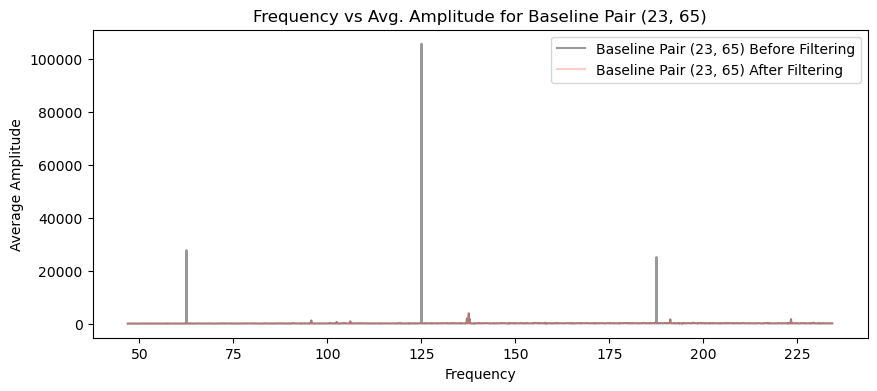

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.09990622 -0.09881383 -0.09608443 ... -0.09110634 -0.08906915
 -0.08872124]


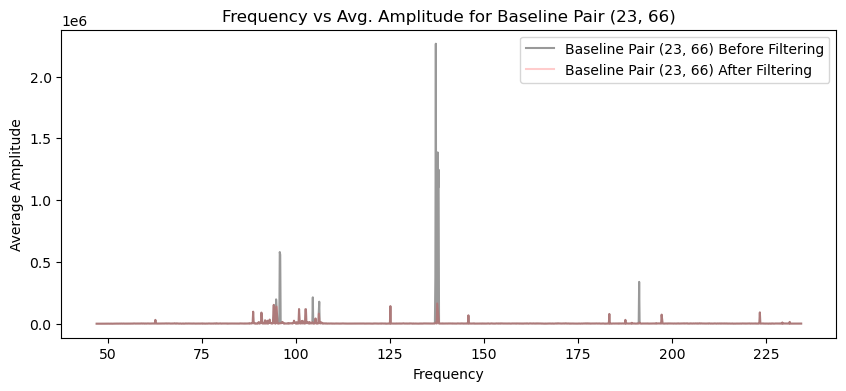

freqs shape: (1536,)
freqs_filtered shape: (1524,)
amplitudes_filtered shape: (20, 1524)
Threshold for baseline: [-0.09730728 -0.09305609 -0.0931678  ... -0.0889611  -0.08555636
 -0.08735341]


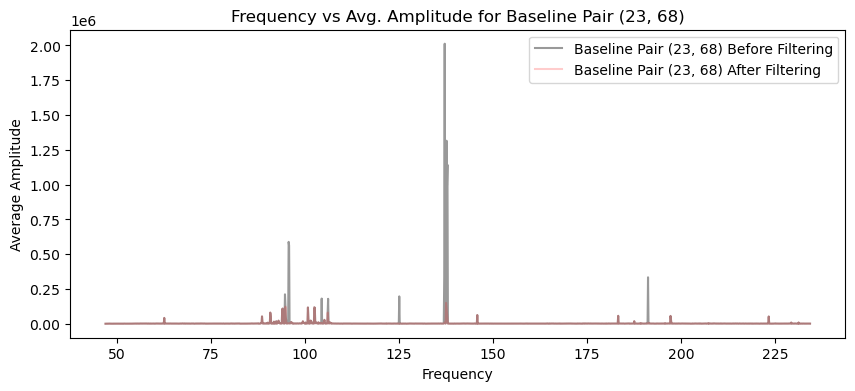

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.07385611 -0.07536282 -0.07485952 ... -0.07272578 -0.07140225
 -0.07061662]


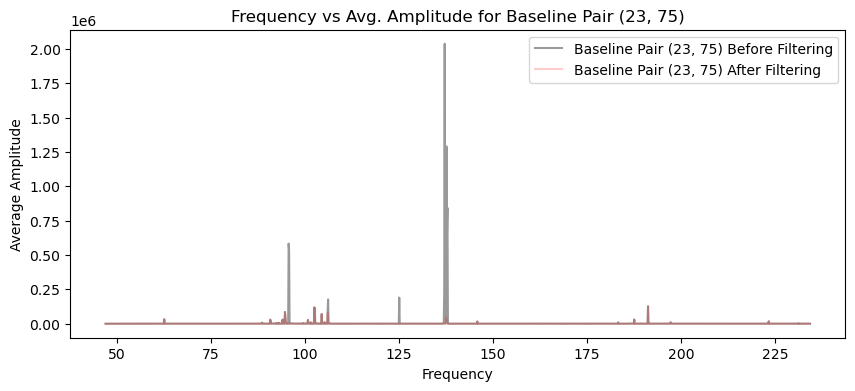

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.08437732 -0.08549077 -0.08684463 ... -0.08454441 -0.08050012
 -0.08505118]


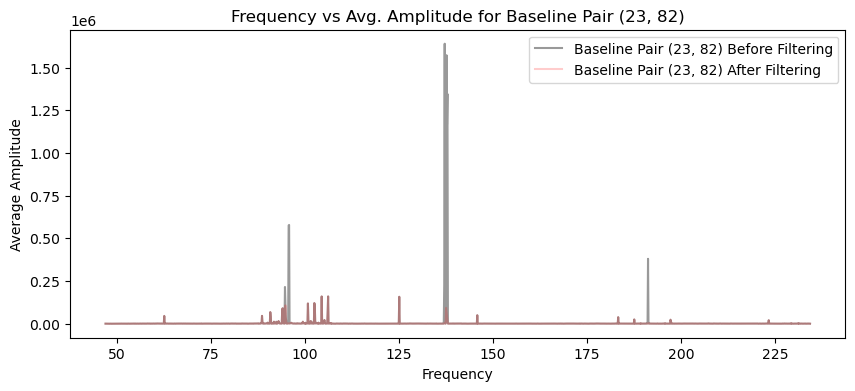

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.10138813 -0.10429635 -0.10235621 ... -0.10148944 -0.09906034
 -0.10368712]


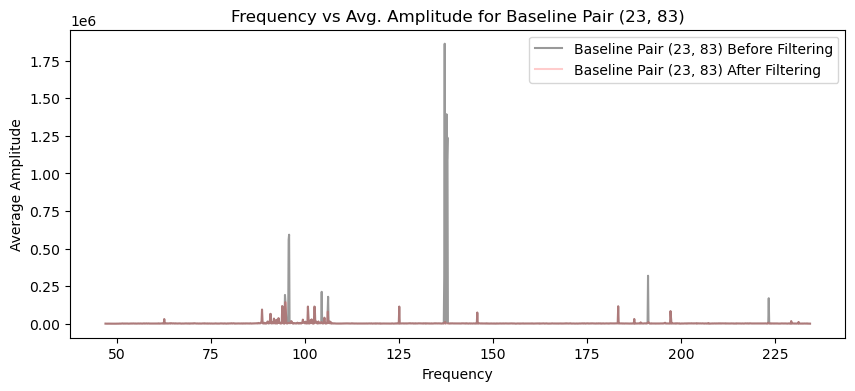

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.06603314 -0.07802977 -0.0676309  ... -0.04712507 -0.02728033
 -0.0510487 ]


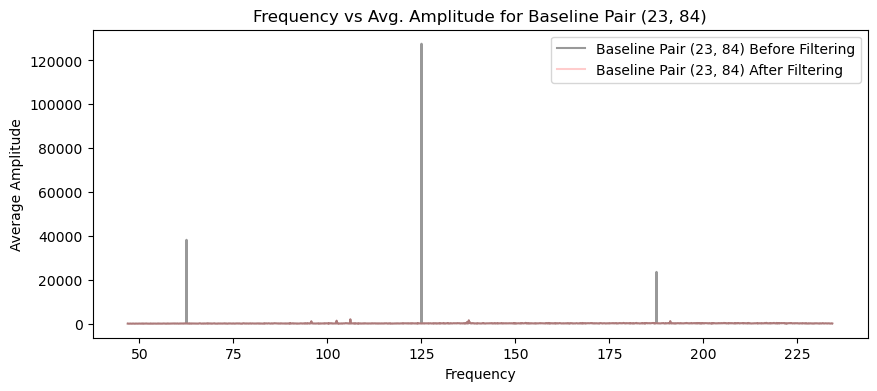

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.10606976 -0.10338163 -0.10701    ... -0.10427013 -0.09897551
 -0.1050824 ]


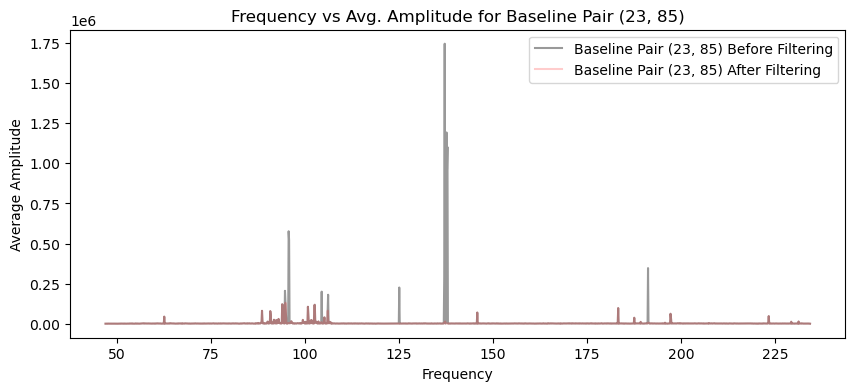

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.08904666 -0.09084003 -0.09172944 ... -0.08501014 -0.07736897
 -0.08421311]


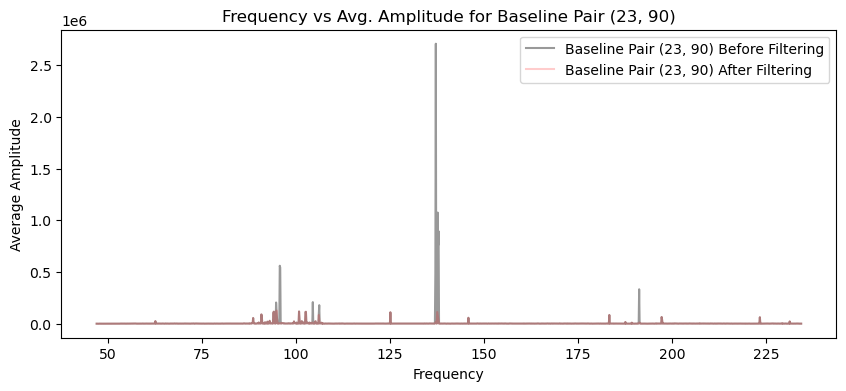

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.09647432 -0.09759609 -0.09631487 ... -0.08301368 -0.08524301
 -0.08961529]


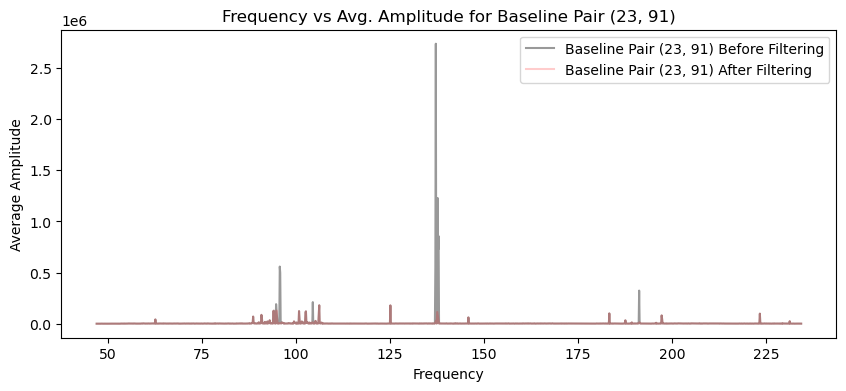

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.0576958  -0.05845577 -0.05877411 ... -0.04436358 -0.03575106
 -0.03165926]


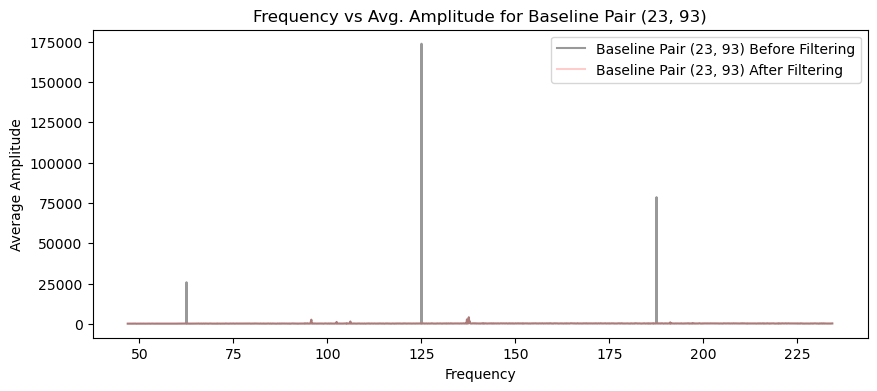

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.12474737 -0.1187011  -0.11459688 ... -0.11129431 -0.10418994
 -0.10725659]


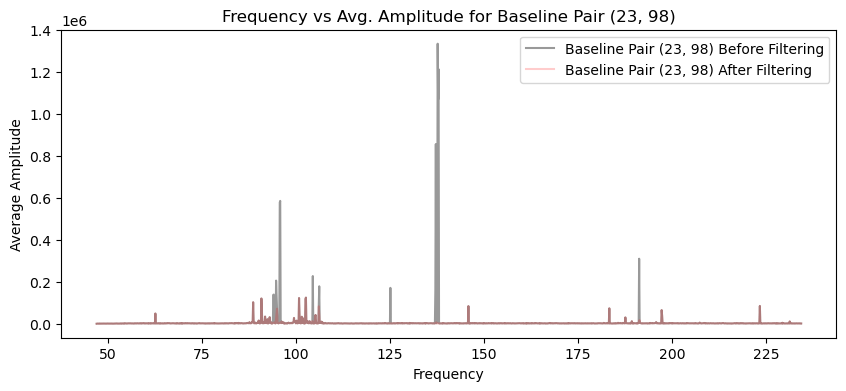

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.10549536 -0.10462889 -0.1072561  ... -0.09752517 -0.09692352
 -0.10520425]


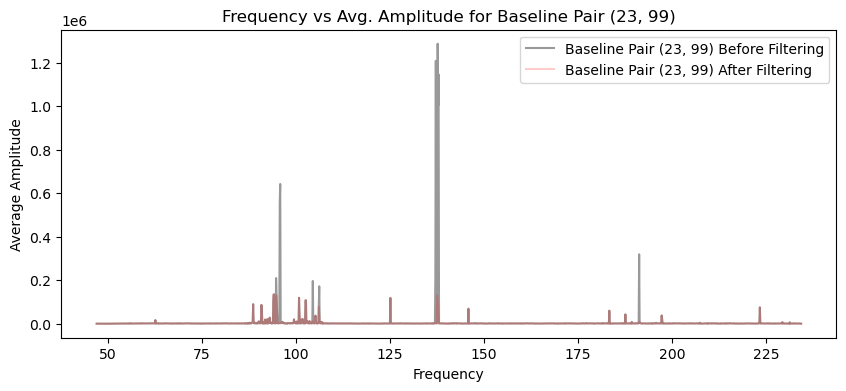

freqs shape: (1536,)
freqs_filtered shape: (1524,)
amplitudes_filtered shape: (20, 1524)
Threshold for baseline: [-0.10048158 -0.10045147 -0.10389125 ... -0.08770129 -0.09963255
 -0.09579889]


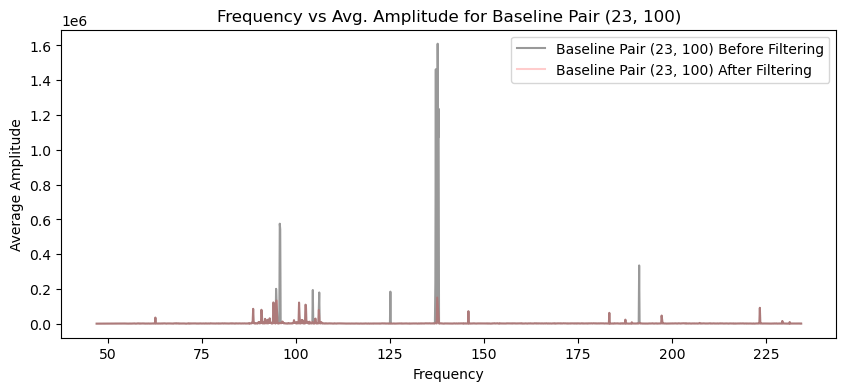

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.10637534 -0.10719238 -0.10879122 ... -0.09558023 -0.0988325
 -0.08734124]


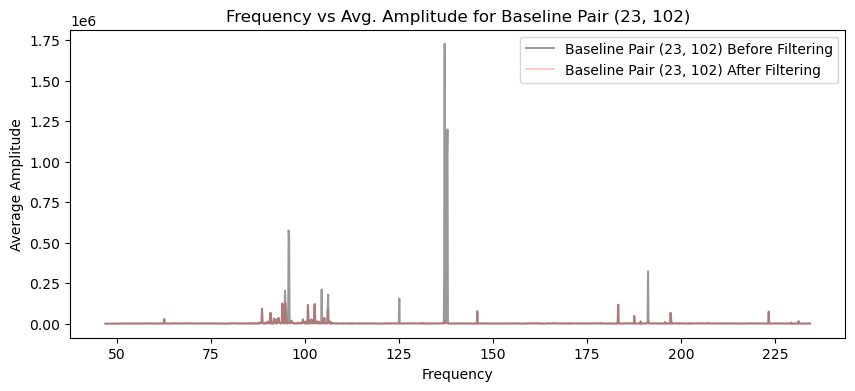

freqs shape: (1536,)
freqs_filtered shape: (1524,)
amplitudes_filtered shape: (20, 1524)
Threshold for baseline: [-0.10172371 -0.10131386 -0.09955937 ... -0.09207056 -0.09465764
 -0.09595122]


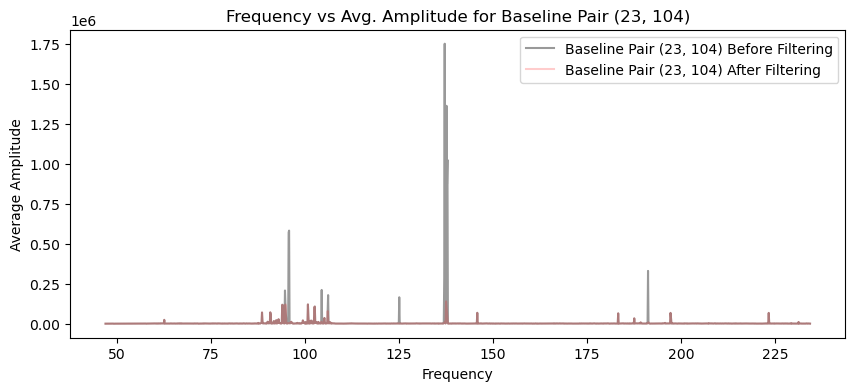

freqs shape: (1536,)
freqs_filtered shape: (1524,)
amplitudes_filtered shape: (20, 1524)
Threshold for baseline: [-0.11160561 -0.11556035 -0.11566041 ... -0.10165296 -0.1066818
 -0.09406556]


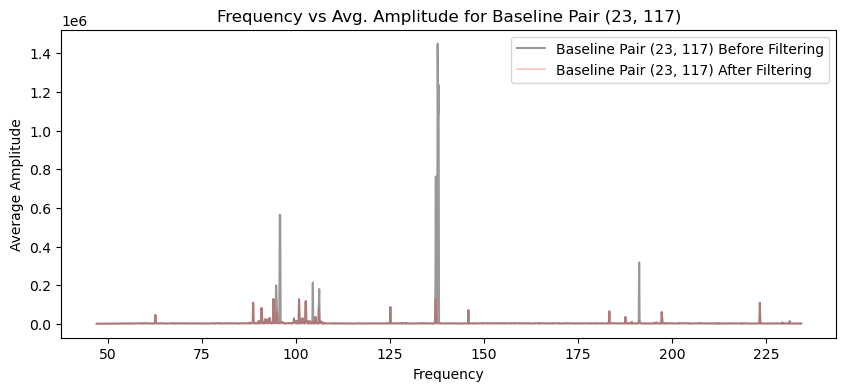

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.10902702 -0.10249217 -0.10399488 ... -0.09973104 -0.09571908
 -0.09445748]


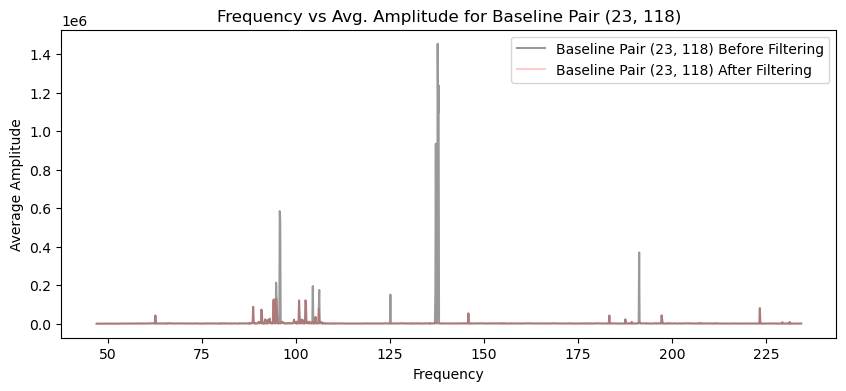

freqs shape: (1536,)
freqs_filtered shape: (1524,)
amplitudes_filtered shape: (20, 1524)
Threshold for baseline: [-0.10394468 -0.10825396 -0.10126309 ... -0.10156876 -0.09981866
 -0.09827784]


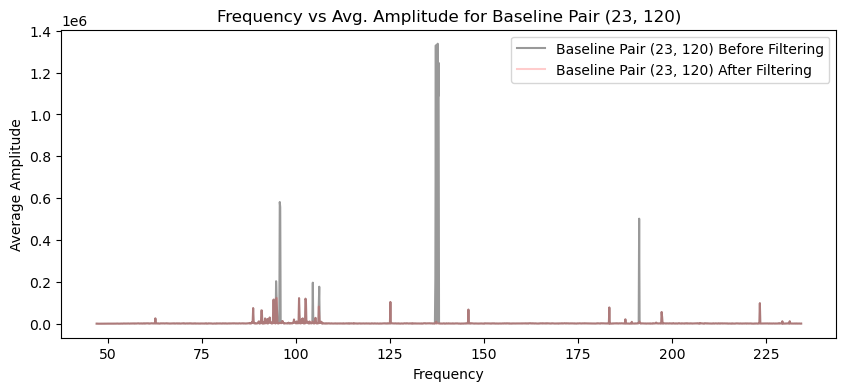

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.10726469 -0.10909423 -0.1066338  ... -0.08936409 -0.09294479
 -0.09991525]


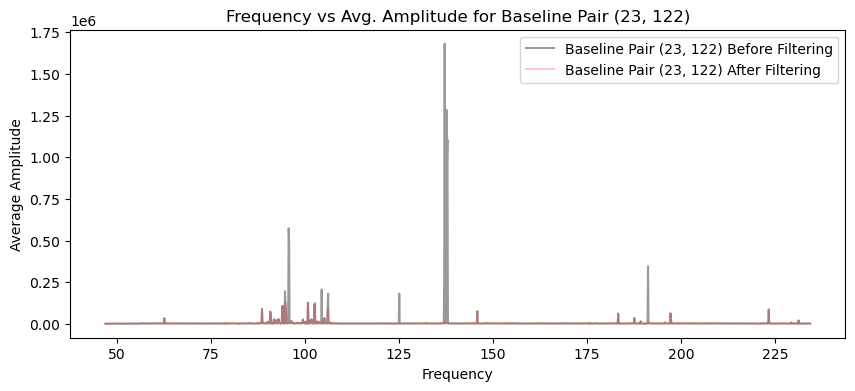

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.10033828 -0.10333584 -0.10196094 ... -0.09283968 -0.09597075
 -0.09744819]


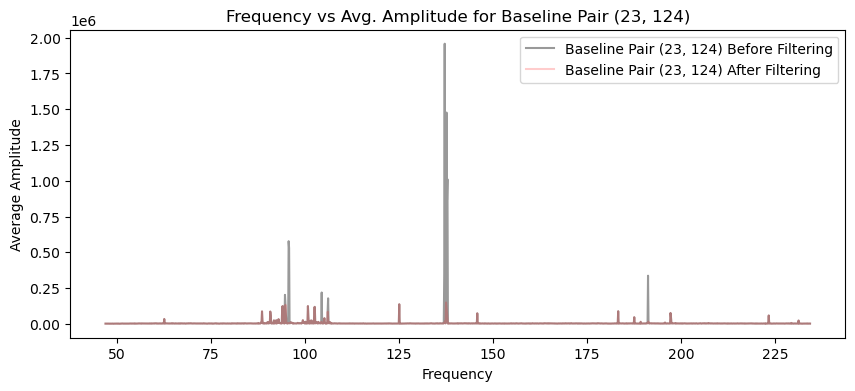

freqs shape: (1536,)
freqs_filtered shape: (1521,)
amplitudes_filtered shape: (20, 1521)
Threshold for baseline: [-0.11809755 -0.12041127 -0.12098058 ... -0.09371177 -0.10290073
 -0.10368881]


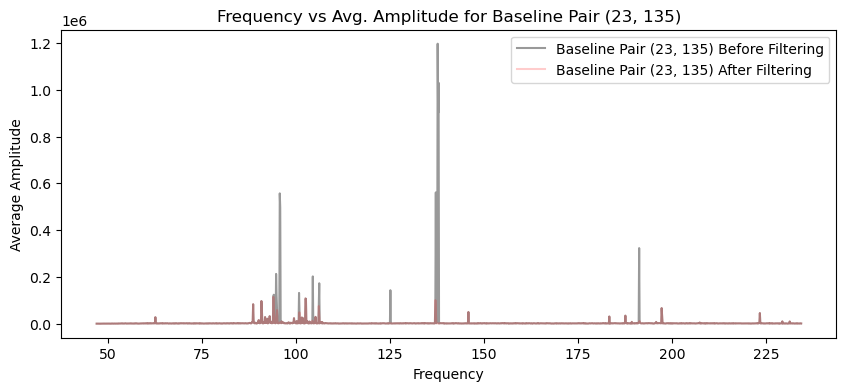

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.10979339 -0.11034105 -0.10892144 ... -0.09636493 -0.10179017
 -0.09064959]


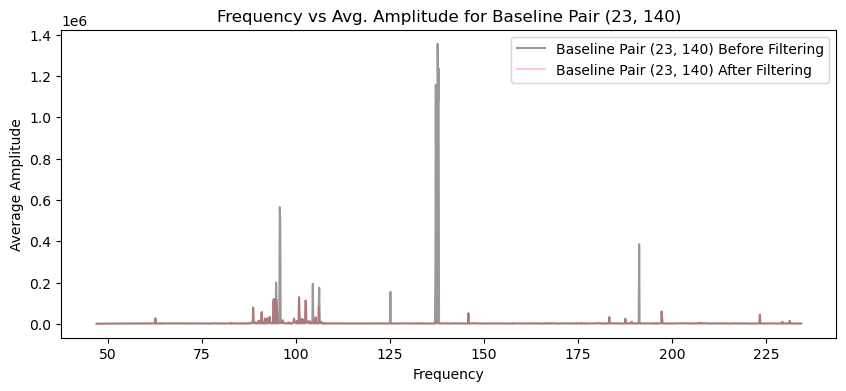

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.11128957 -0.11085878 -0.1081874  ... -0.09078477 -0.09868473
 -0.10164276]


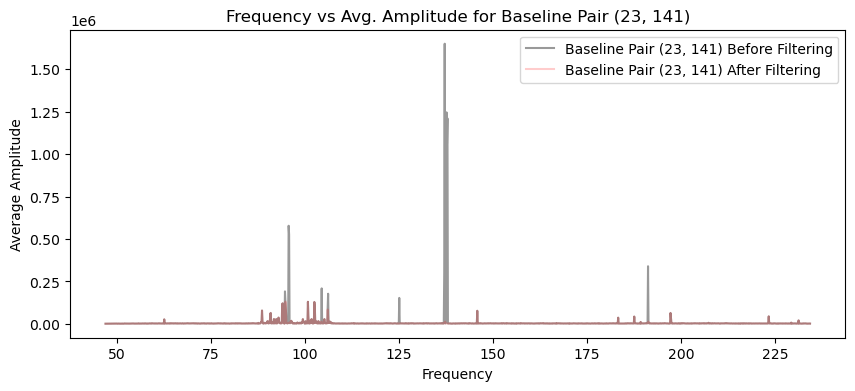

freqs shape: (1536,)
freqs_filtered shape: (1530,)
amplitudes_filtered shape: (20, 1530)
Threshold for baseline: [-0.07284305 -0.06776327 -0.07047349 ... -0.03926275 -0.05170202
 -0.04389988]


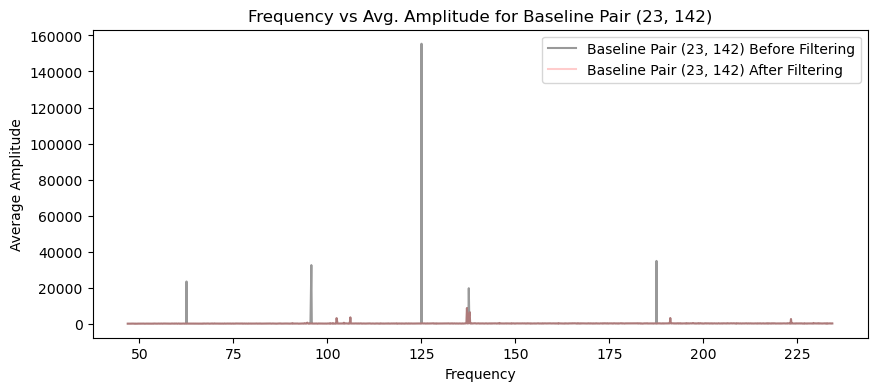

freqs shape: (1536,)
freqs_filtered shape: (1524,)
amplitudes_filtered shape: (20, 1524)
Threshold for baseline: [-0.11497708 -0.11889892 -0.12039179 ... -0.10329901 -0.09401158
 -0.10127347]


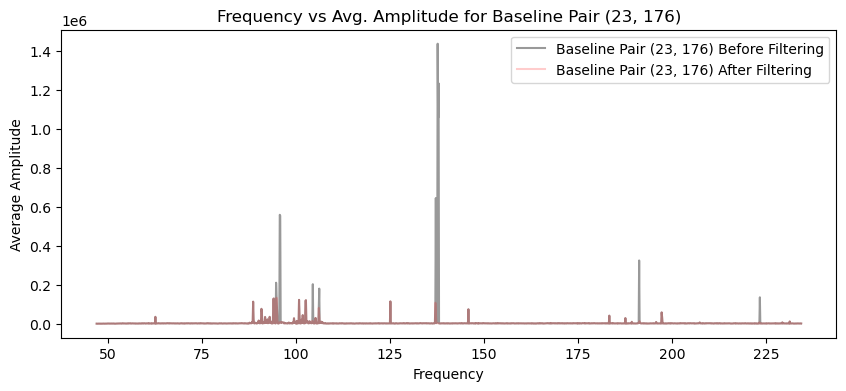

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.2875087  -0.27391141 -0.27941798 ... -0.24696546 -0.21808101
 -0.2106418 ]


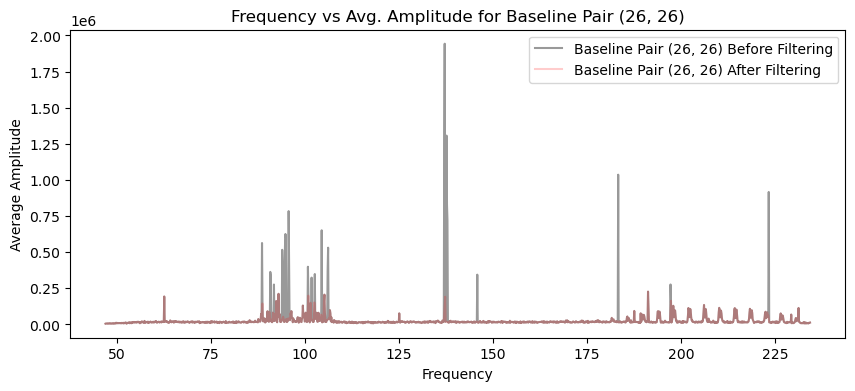

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.14584402 -0.1491612  -0.14323135 ... -0.12938543 -0.1342125
 -0.13497138]


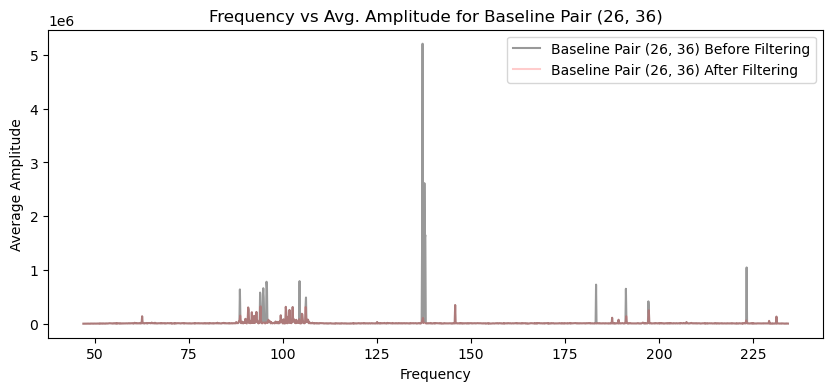

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19221498 -0.19910187 -0.19900939 ... -0.13230934 -0.16662255
 -0.14601694]


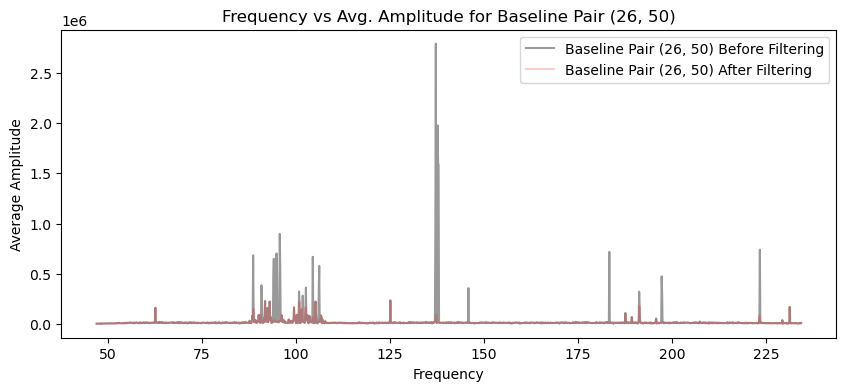

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17446656 -0.17369959 -0.17972015 ... -0.15563845 -0.17770128
 -0.16230107]


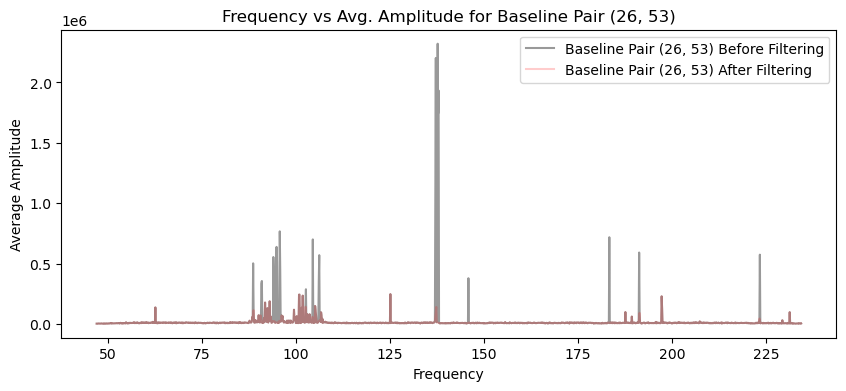

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15996464 -0.16404888 -0.16069385 ... -0.13491362 -0.15659529
 -0.14974326]


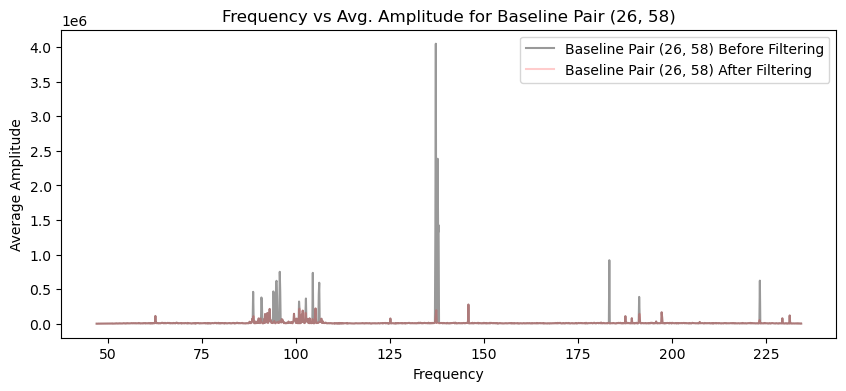

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.13789462 -0.14122061 -0.14029048 ... -0.1274166  -0.13205718
 -0.12936971]


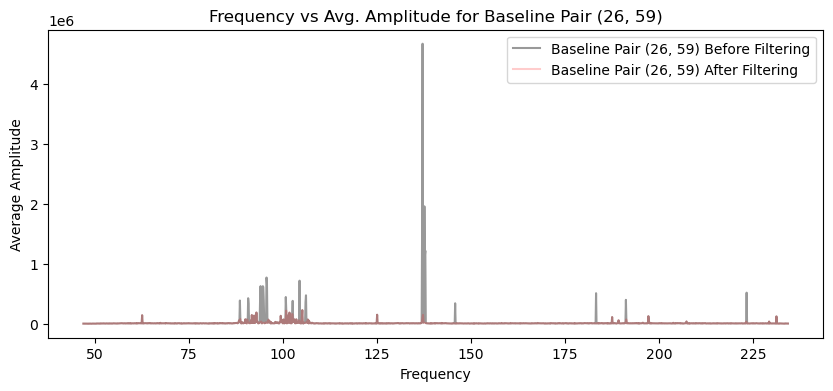

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.09460659 -0.11084775 -0.11111332 ... -0.09602938 -0.05869967
 -0.05231545]


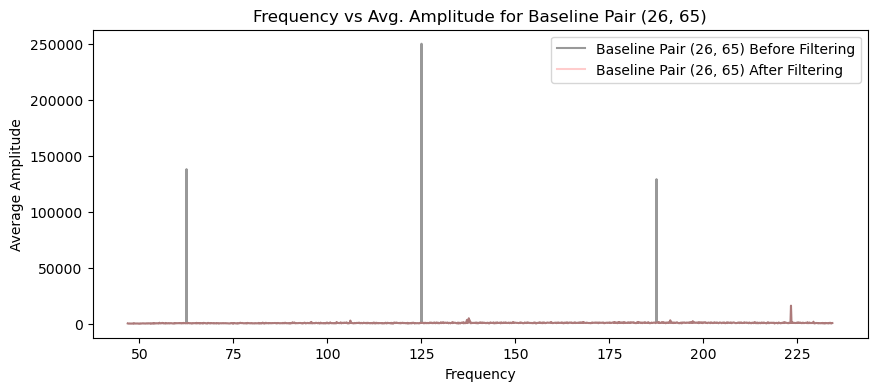

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.15175502 -0.15123842 -0.15008925 ... -0.1383096  -0.13681618
 -0.12738543]


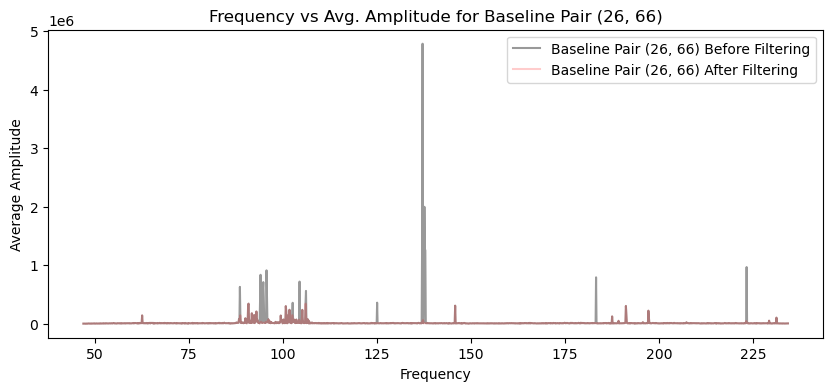

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16742519 -0.16636069 -0.16650357 ... -0.14535786 -0.15874488
 -0.16350399]


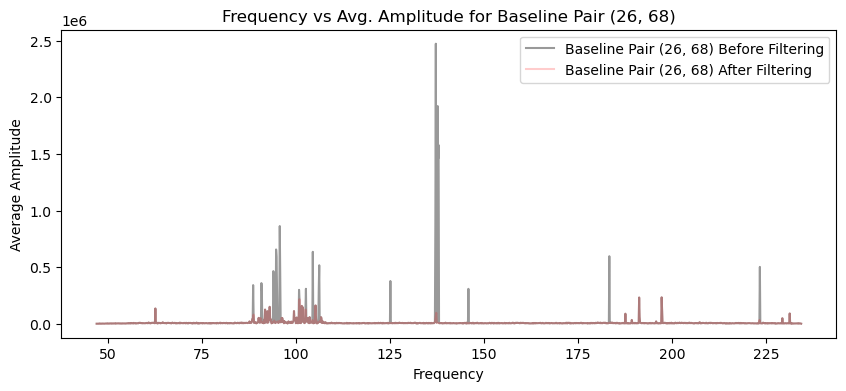

freqs shape: (1536,)
freqs_filtered shape: (1522,)
amplitudes_filtered shape: (20, 1522)
Threshold for baseline: [-0.09918521 -0.09971137 -0.09848858 ... -0.09272559 -0.08866303
 -0.08836624]


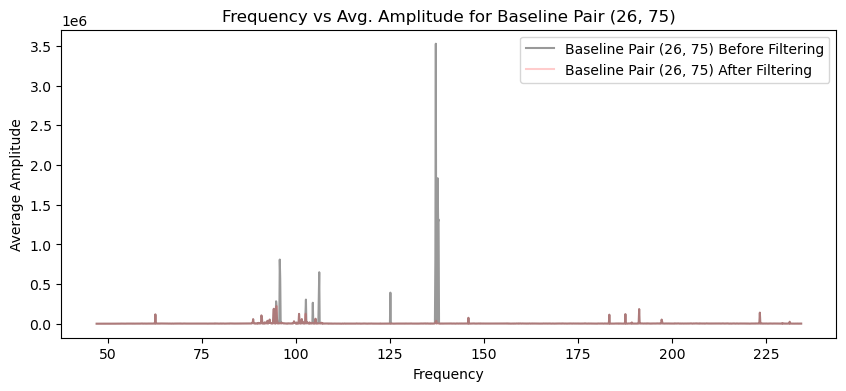

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.14244402 -0.14776766 -0.14099083 ... -0.12775614 -0.12225075
 -0.13715585]


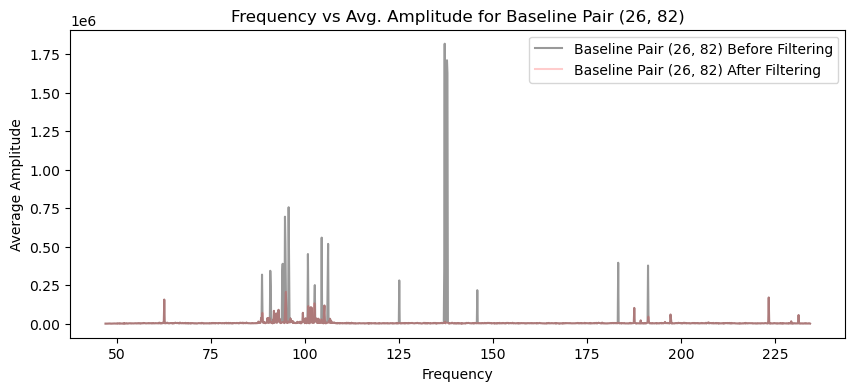

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.20641393 -0.21071867 -0.20084854 ... -0.18696051 -0.1810062
 -0.18620867]


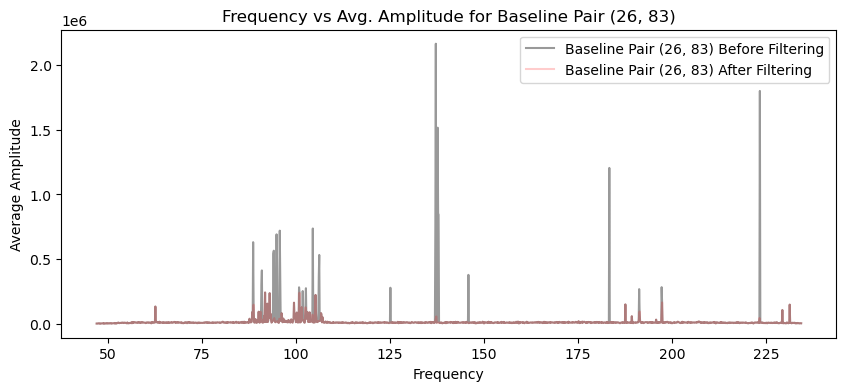

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.11400251 -0.12570755 -0.11727139 ... -0.07035342 -0.06865482
 -0.08646391]


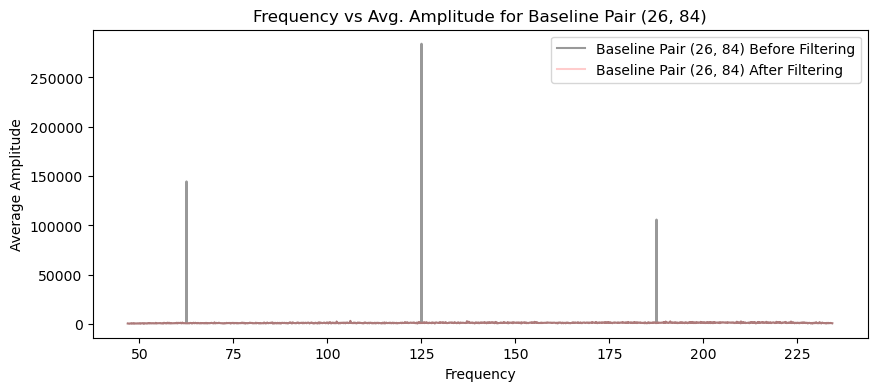

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15652508 -0.15954152 -0.16465631 ... -0.13587457 -0.14677374
 -0.15596791]


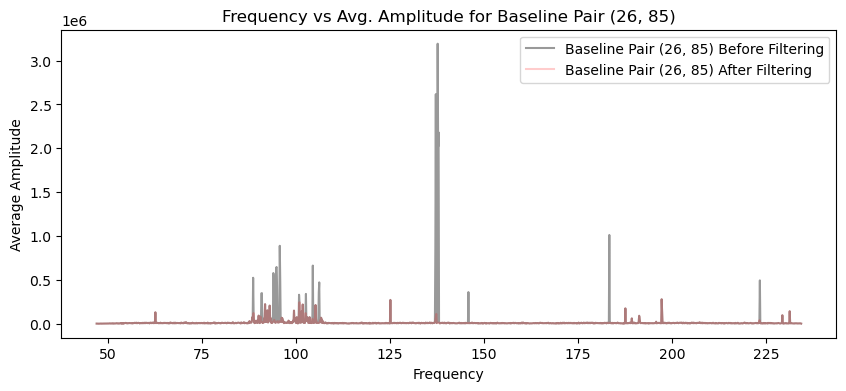

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16245481 -0.16080821 -0.1638147  ... -0.12744354 -0.15988598
 -0.14640812]


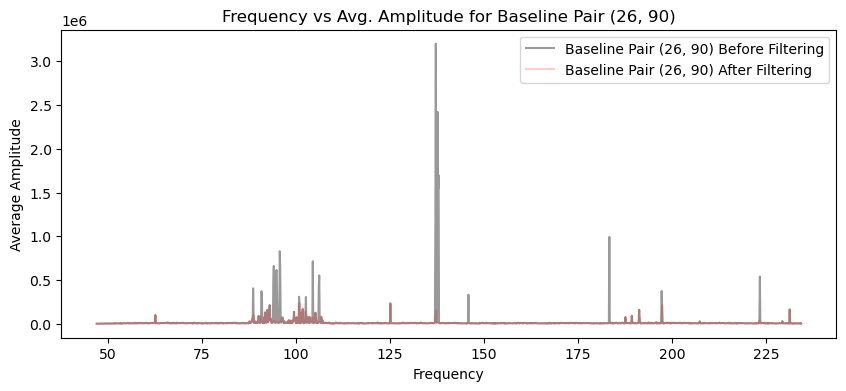

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17271434 -0.17286648 -0.16472681 ... -0.15529299 -0.15224611
 -0.15495011]


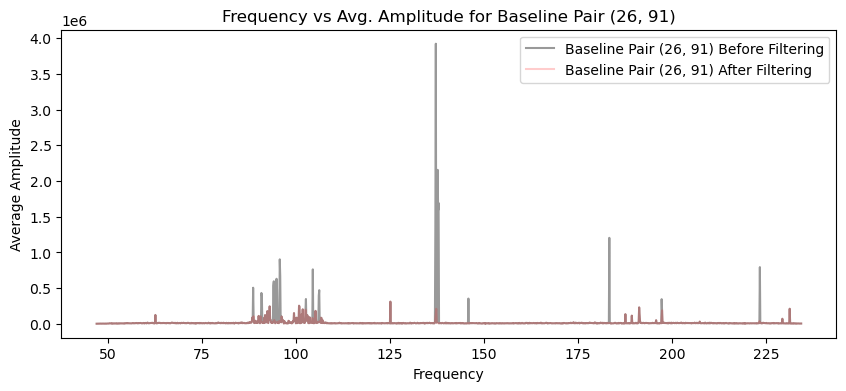

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.11334145 -0.11341305 -0.11427731 ... -0.06218113 -0.1009781
 -0.0632847 ]


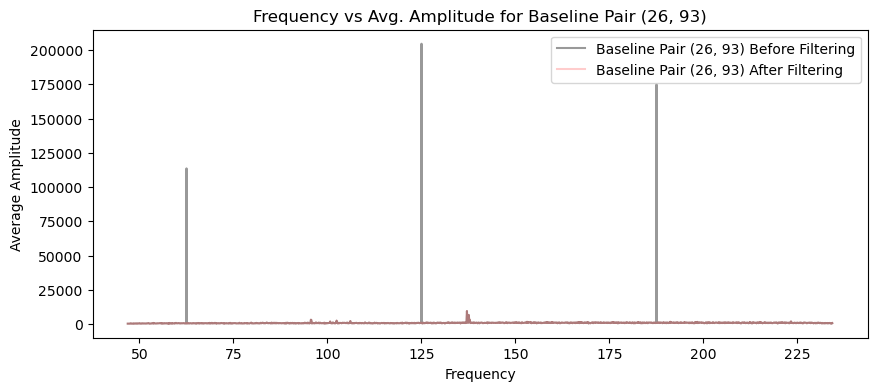

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.20444071 -0.19477601 -0.19952334 ... -0.1624614  -0.17522299
 -0.1926141 ]


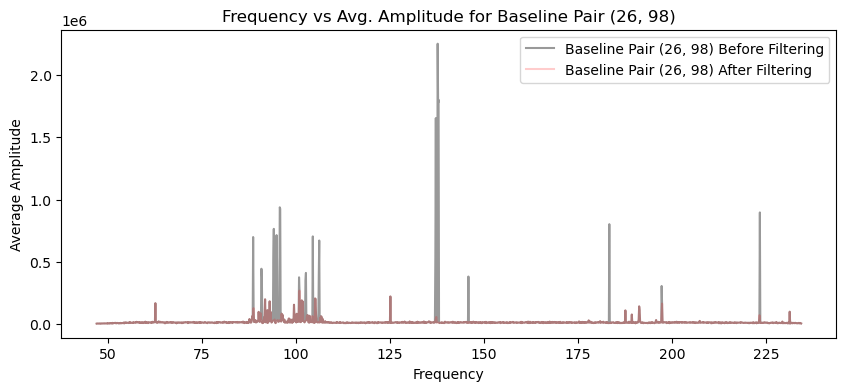

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.18151666 -0.17974891 -0.18451061 ... -0.17319594 -0.16501965
 -0.16593961]


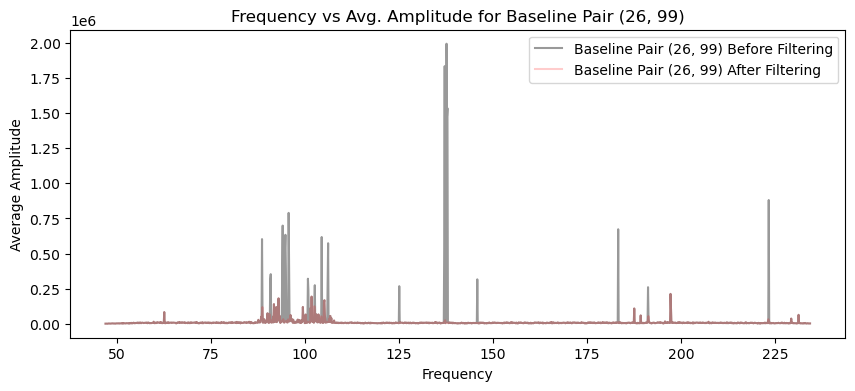

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.21049379 -0.2104148  -0.20751792 ... -0.17577557 -0.18174484
 -0.19033889]


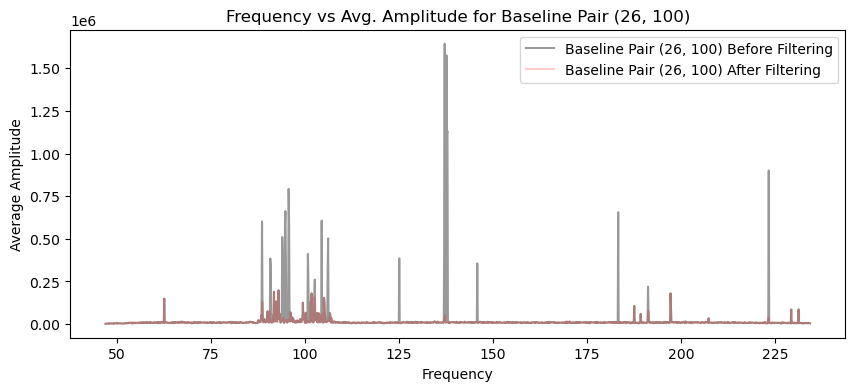

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19745944 -0.19535584 -0.19065048 ... -0.19259722 -0.18304777
 -0.17875925]


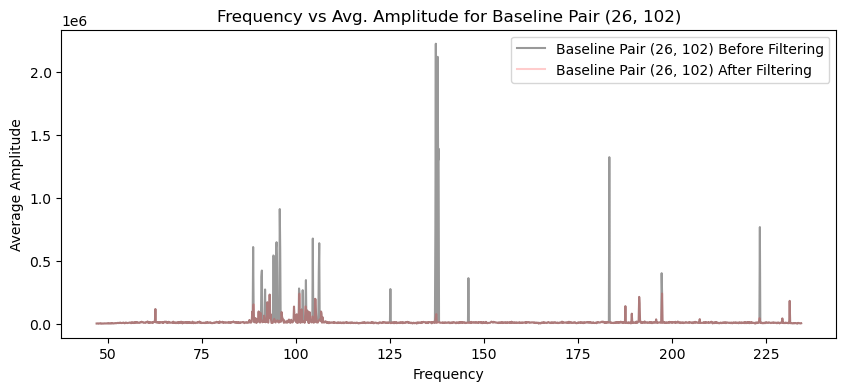

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17408252 -0.18631538 -0.16855003 ... -0.14800053 -0.15886227
 -0.16551848]


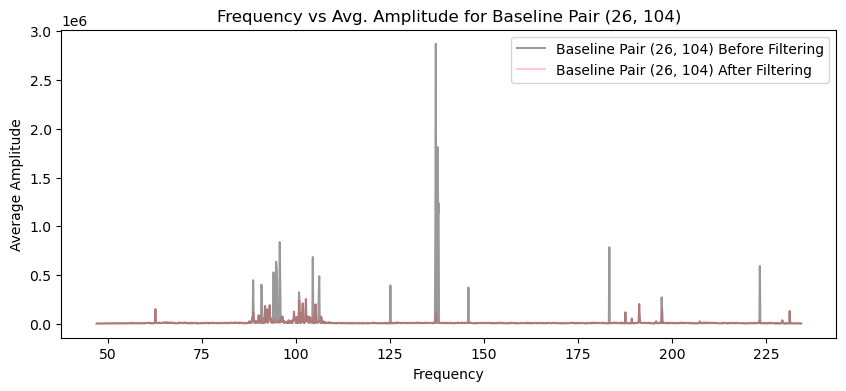

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.22207338 -0.21664877 -0.22149707 ... -0.19761271 -0.16481952
 -0.17472202]


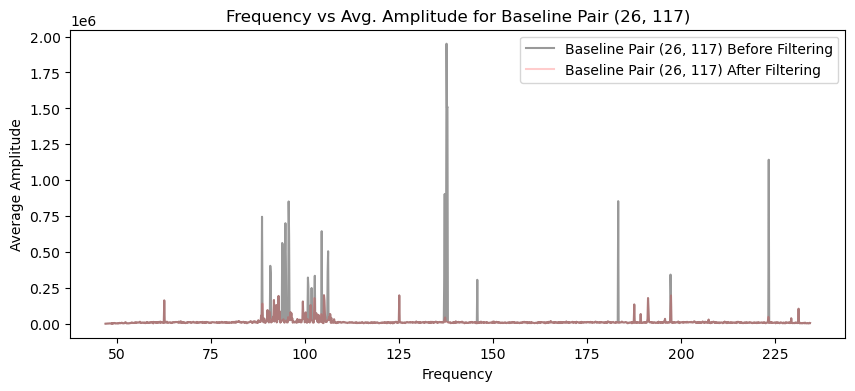

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.20063021 -0.21081532 -0.20675708 ... -0.17916077 -0.19511234
 -0.18995262]


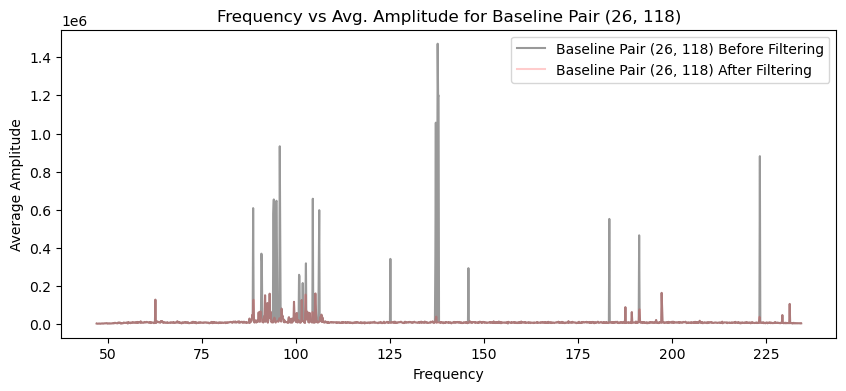

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.20474811 -0.19333306 -0.19954223 ... -0.18413269 -0.18224618
 -0.17136215]


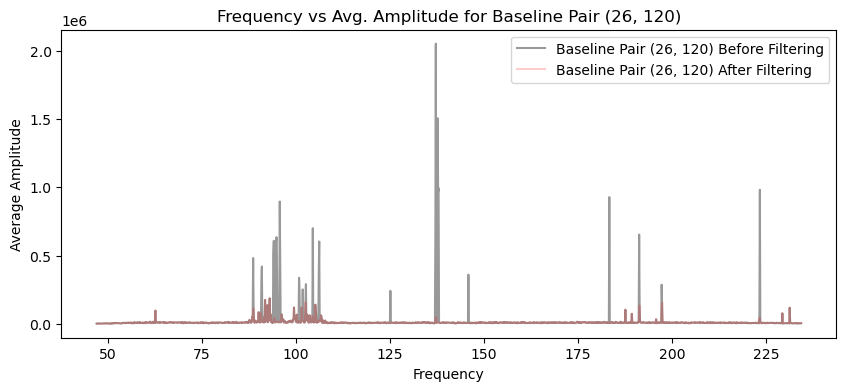

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15945933 -0.16451553 -0.16382998 ... -0.16256143 -0.16397242
 -0.14787484]


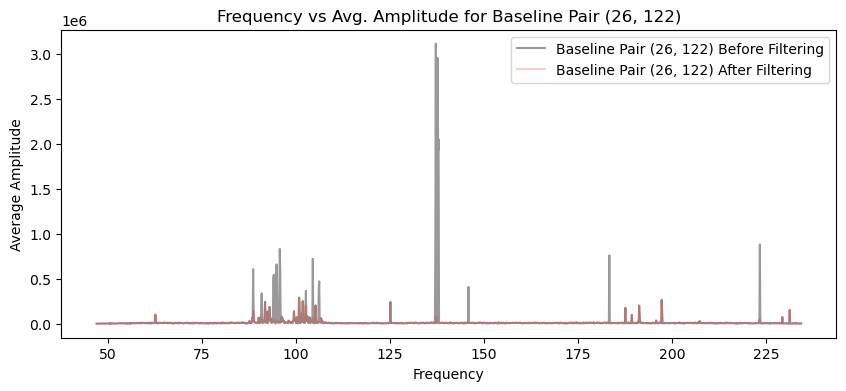

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16039579 -0.1592262  -0.16028845 ... -0.14239467 -0.15580069
 -0.1467902 ]


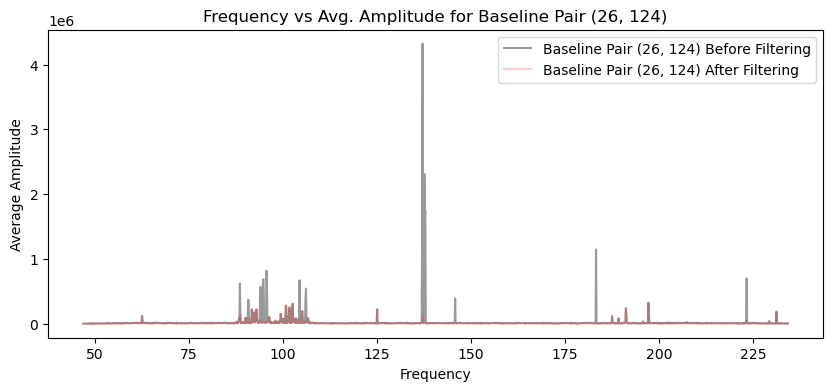

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.21954439 -0.21600775 -0.21816895 ... -0.17445489 -0.19729571
 -0.17121651]


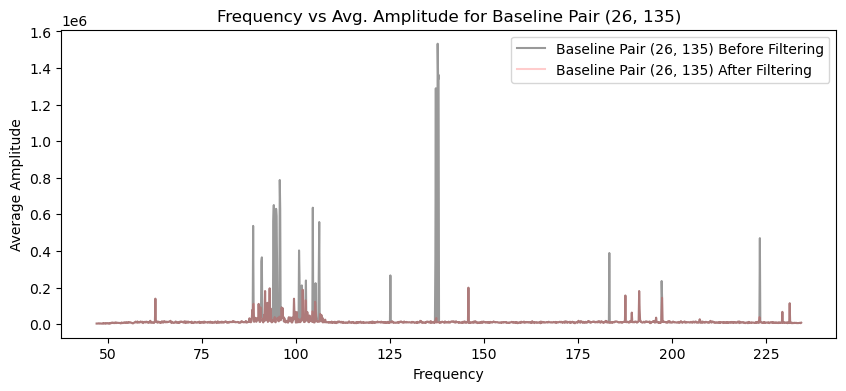

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.22695912 -0.23193772 -0.23040432 ... -0.2001851  -0.18425125
 -0.17163396]


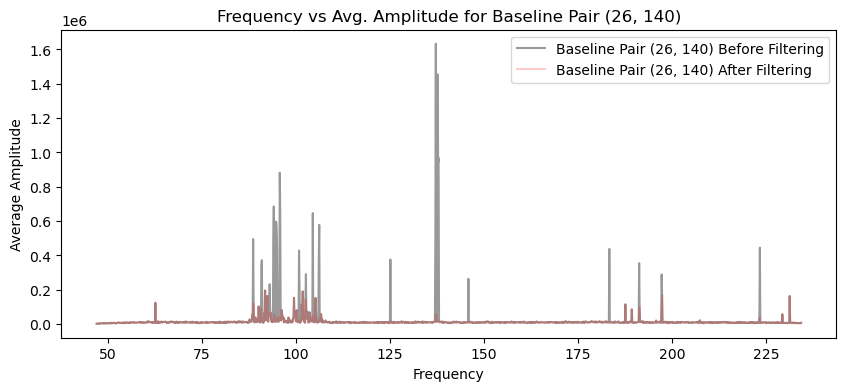

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16679342 -0.17383397 -0.17728834 ... -0.15122868 -0.13807032
 -0.14756122]


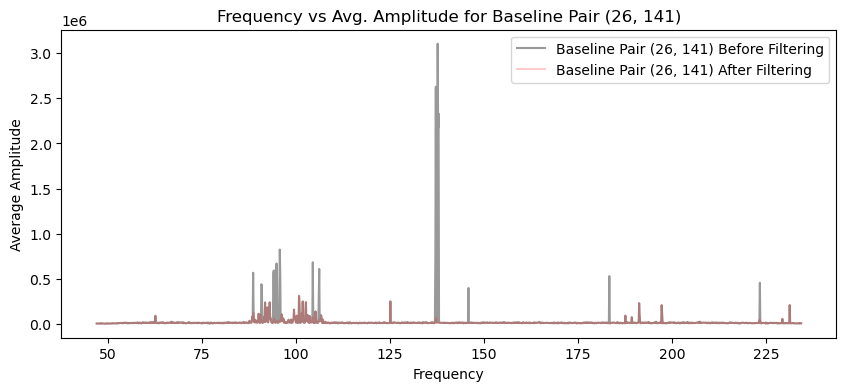

freqs shape: (1536,)
freqs_filtered shape: (1529,)
amplitudes_filtered shape: (20, 1529)
Threshold for baseline: [-0.10070019 -0.11000792 -0.10135007 ... -0.07981183 -0.06691231
 -0.08554684]


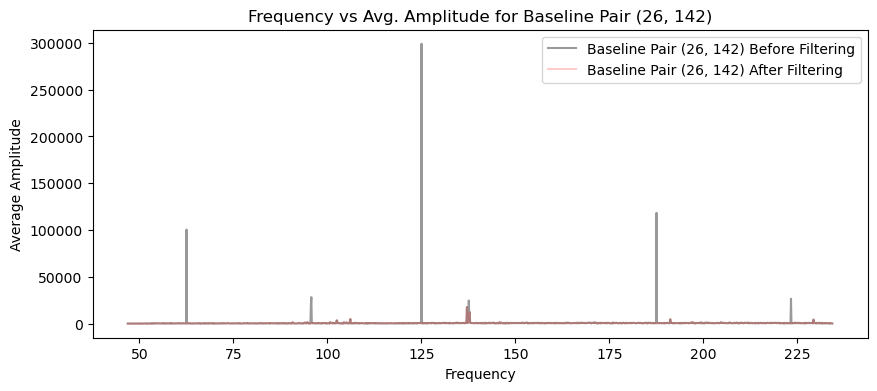

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.21225507 -0.20520593 -0.20545567 ... -0.19606769 -0.17129298
 -0.20769036]


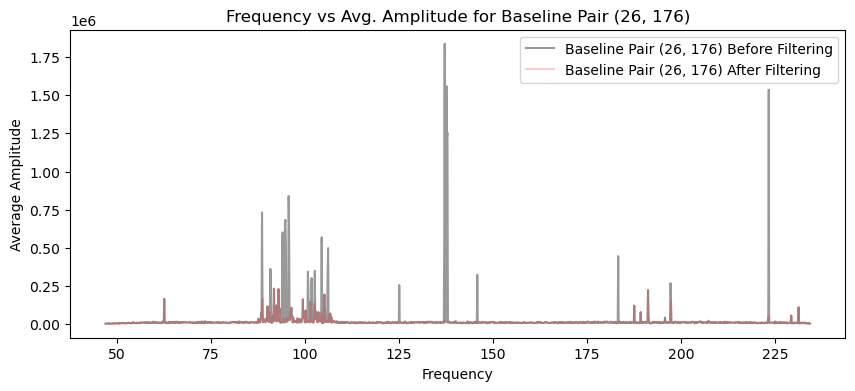

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.23754033 -0.26856668 -0.25827883 ... -0.24944923 -0.22941649
 -0.25998098]


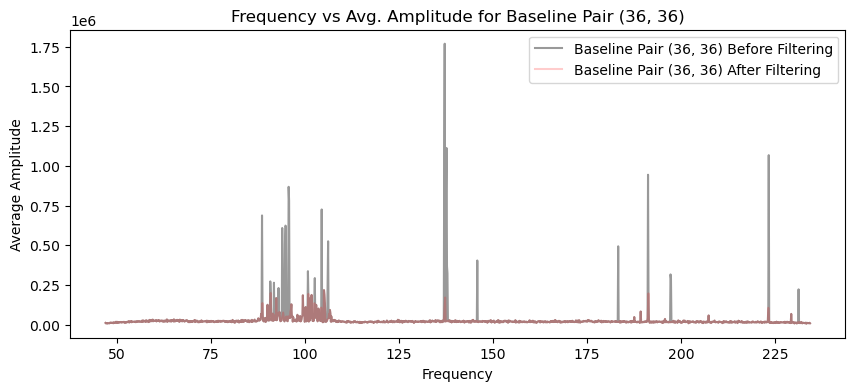

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.19973518 -0.19530342 -0.1994698  ... -0.16602481 -0.18469593
 -0.17273458]


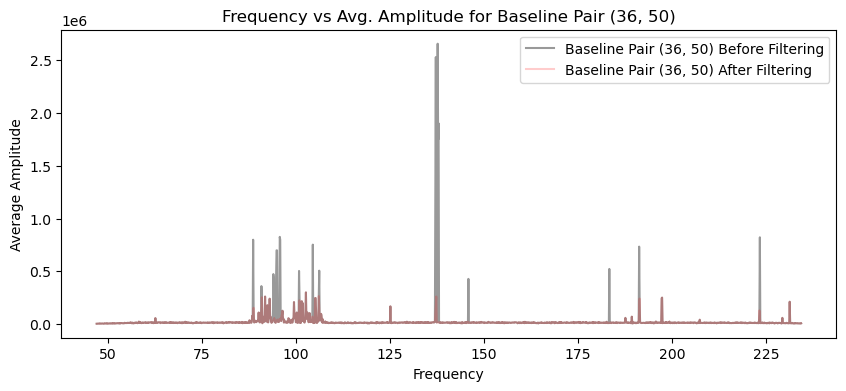

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.1475917  -0.14687877 -0.1538047  ... -0.06220952 -0.0892494
 -0.12329587]


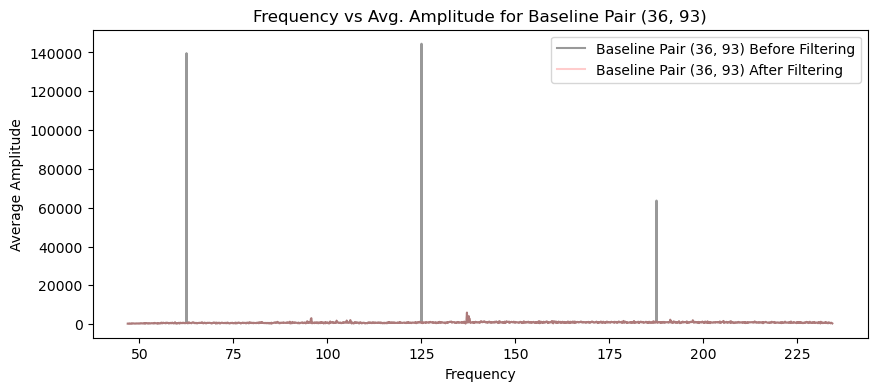

freqs shape: (1536,)
freqs_filtered shape: (1505,)
amplitudes_filtered shape: (20, 1505)
Threshold for baseline: [-0.28446237 -0.26874303 -0.27350534 ... -0.20727924 -0.19531775
 -0.16362069]


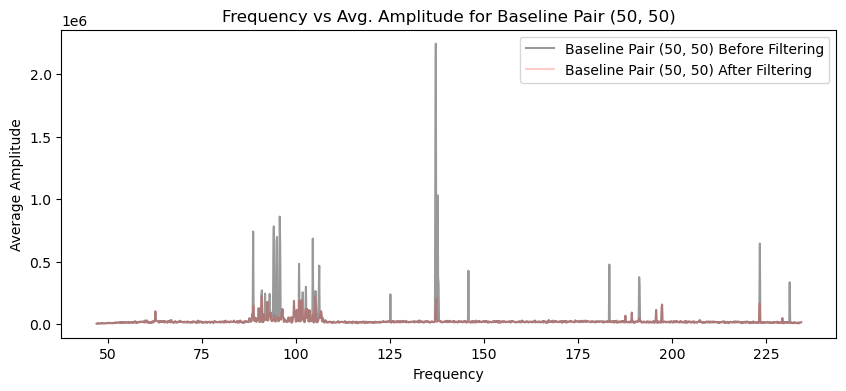

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.14123375 -0.14928571 -0.13101322 ... -0.07786904 -0.06271982
 -0.07295362]


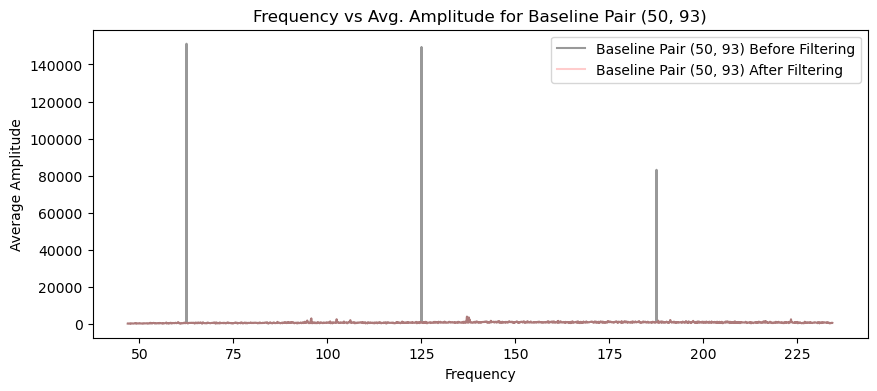

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17904637 -0.17462037 -0.18863513 ... -0.15648649 -0.15665619
 -0.1798579 ]


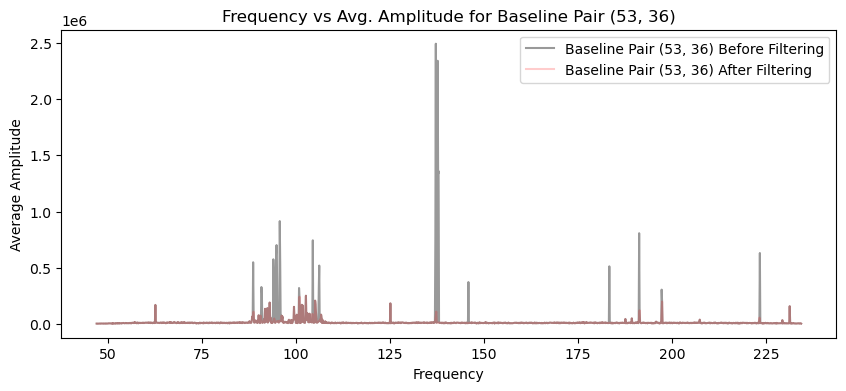

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.17769169 -0.17825431 -0.1895558  ... -0.16404545 -0.16203421
 -0.17608188]


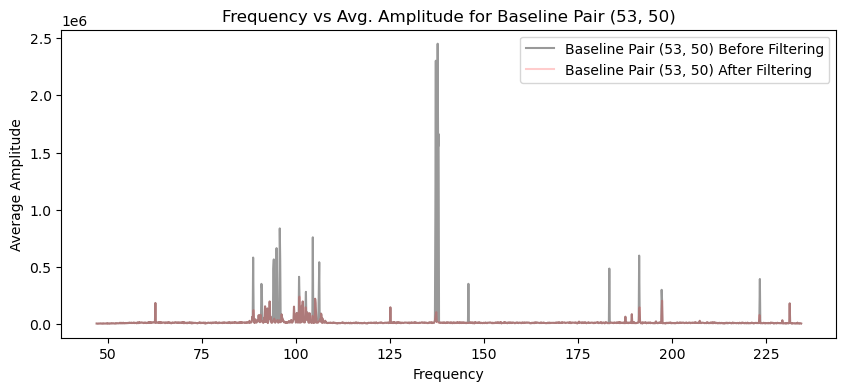

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.24136949 -0.2377839  -0.23944164 ... -0.2234477  -0.21299866
 -0.22813396]


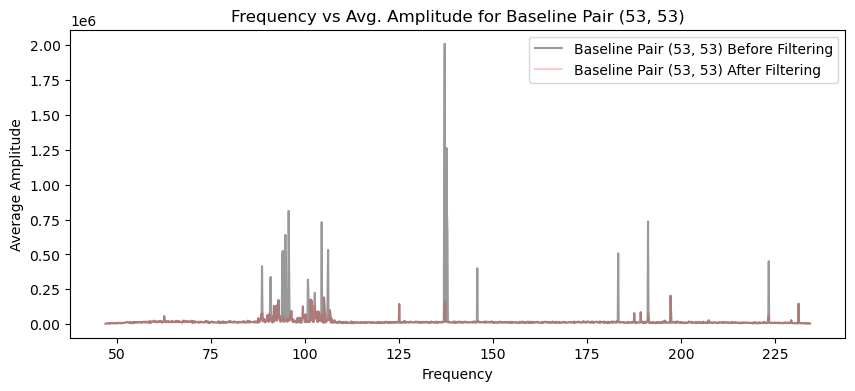

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.12938366 -0.18457675 -0.13443047 ... -0.08922995 -0.13373037
 -0.13199039]


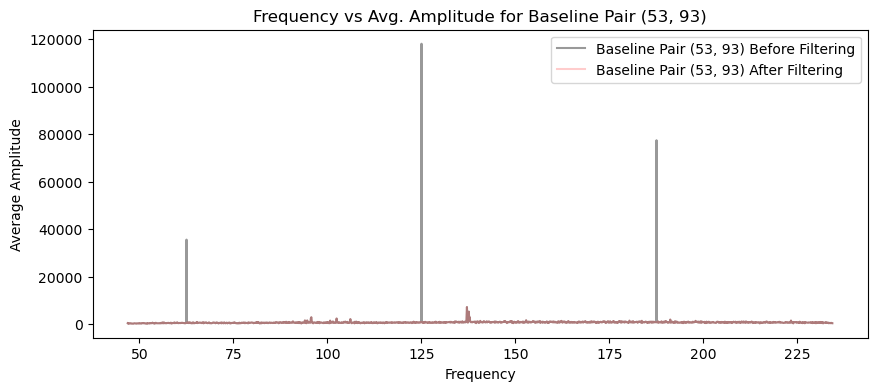

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14918714 -0.14025342 -0.14458679 ... -0.12192234 -0.14043286
 -0.12401631]


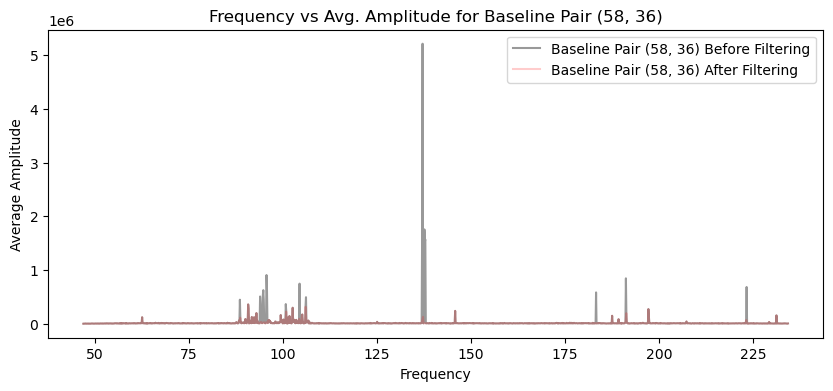

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17150453 -0.18039072 -0.18056196 ... -0.16776291 -0.14746609
 -0.14599918]


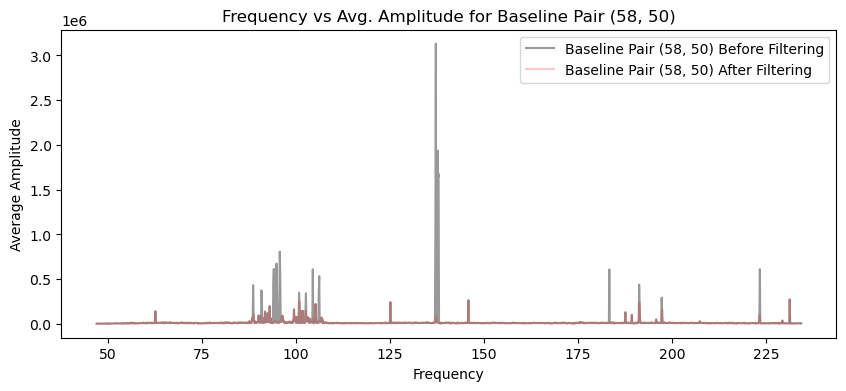

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16372774 -0.17816181 -0.17032008 ... -0.12668507 -0.15626733
 -0.14314536]


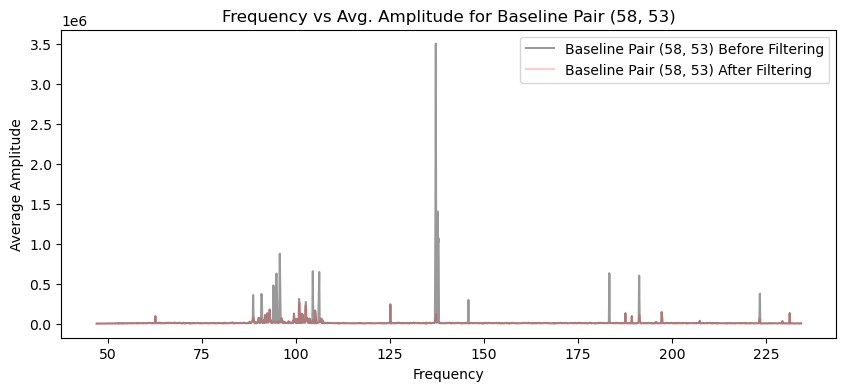

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19597517 -0.22864956 -0.25764132 ... -0.23642224 -0.25120351
 -0.23025247]


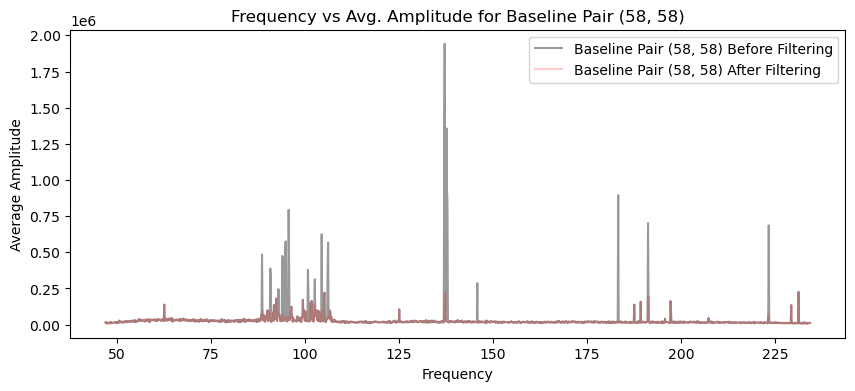

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.10429825 -0.11817479 -0.10652646 ... -0.0622191  -0.07054501
 -0.06465462]


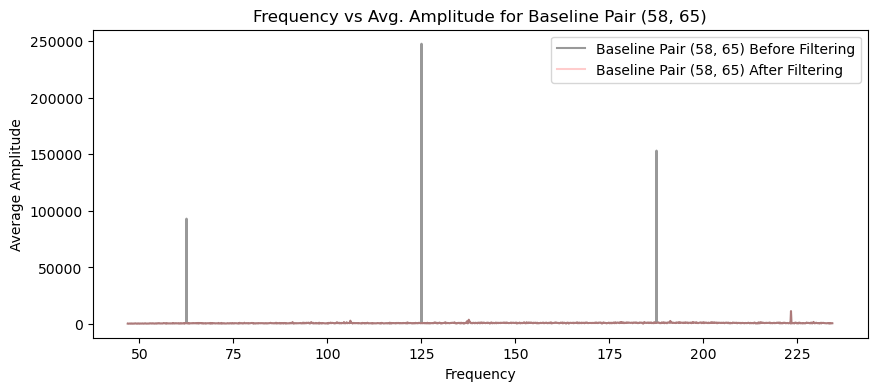

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19347873 -0.18644194 -0.19765644 ... -0.14840584 -0.17660645
 -0.15721197]


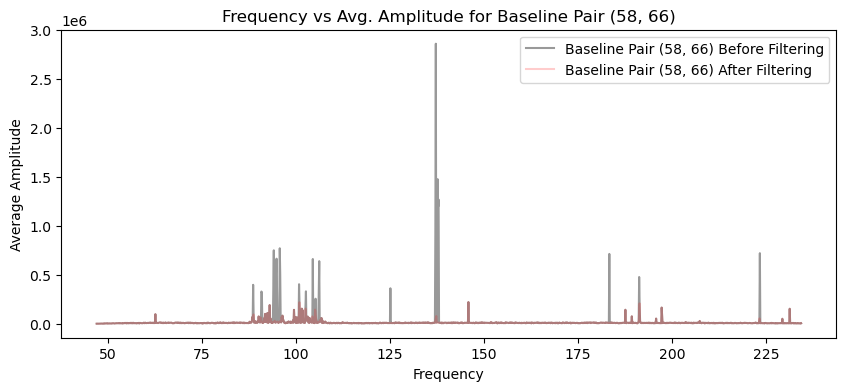

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16567946 -0.15543776 -0.16073134 ... -0.12755179 -0.13228371
 -0.14984034]


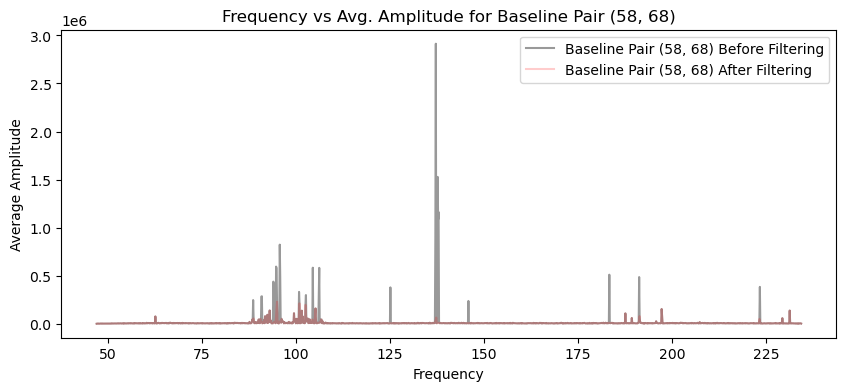

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.113203   -0.1150702  -0.11213211 ... -0.10111283 -0.10555194
 -0.10043058]


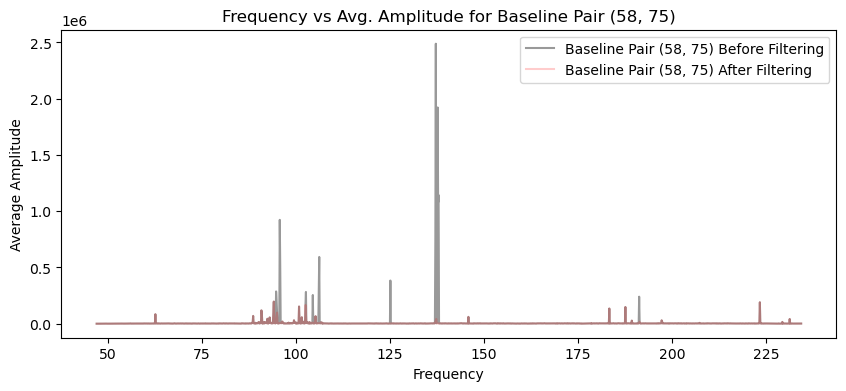

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.11122932 -0.10559297 -0.11980958 ... -0.04764645 -0.08689723
 -0.02999927]


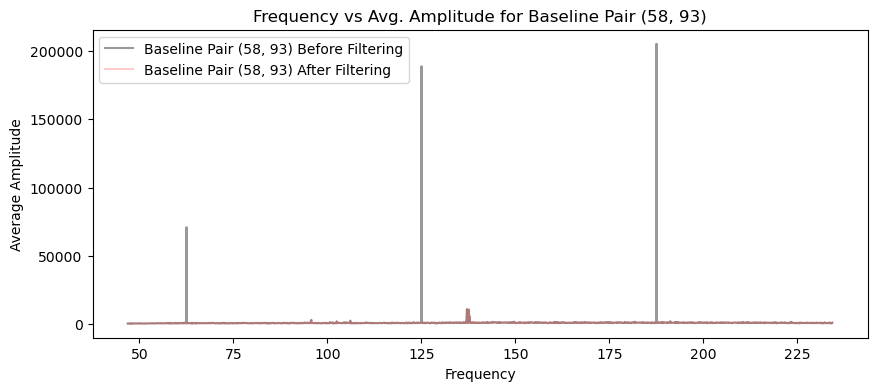

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.23041346 -0.24206209 -0.23529966 ... -0.21211784 -0.17848137
 -0.18460963]


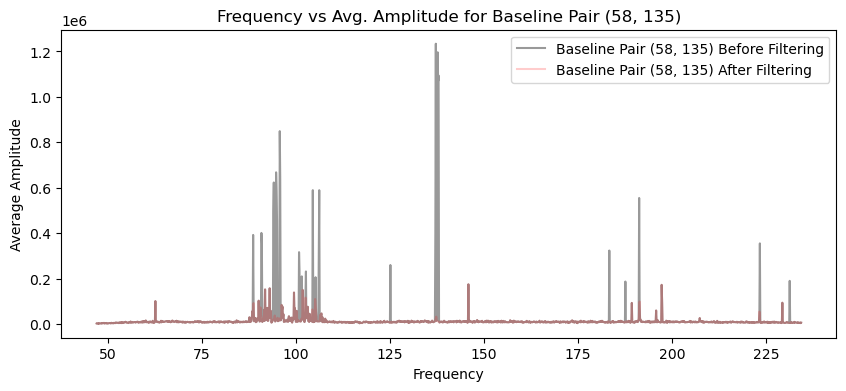

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.21254193 -0.21447471 -0.2183335  ... -0.17714453 -0.1971571
 -0.19712617]


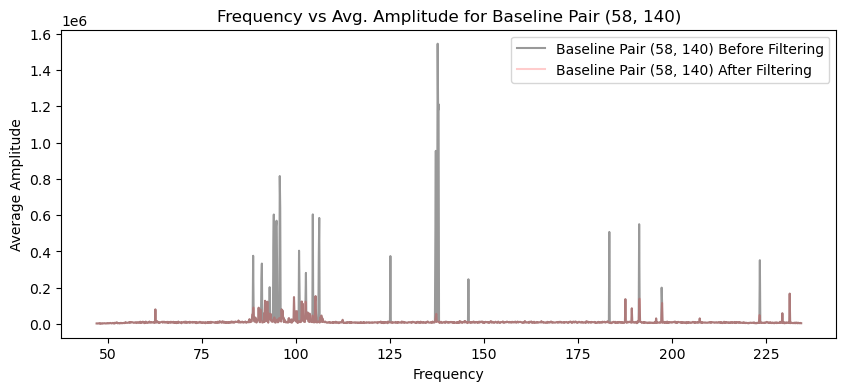

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.22353306 -0.21840273 -0.21581321 ... -0.17300955 -0.17549881
 -0.1775609 ]


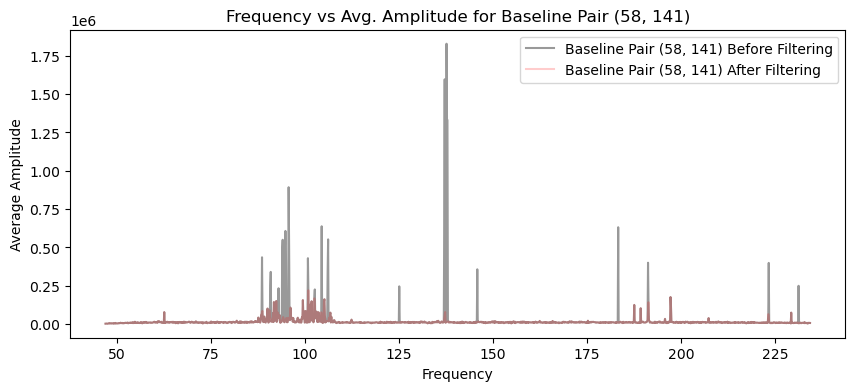

freqs shape: (1536,)
freqs_filtered shape: (1530,)
amplitudes_filtered shape: (20, 1530)
Threshold for baseline: [-0.0865173  -0.10805322 -0.1164228  ... -0.07565246 -0.00367555
 -0.02826513]


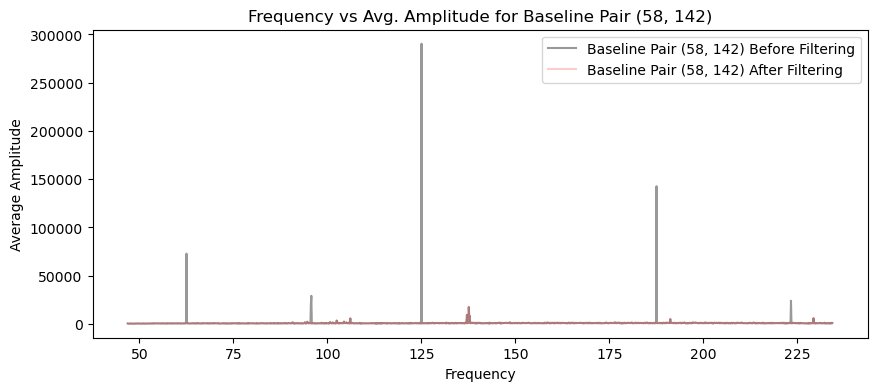

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.21618822 -0.21954437 -0.21442218 ... -0.20208465 -0.18072478
 -0.176071  ]


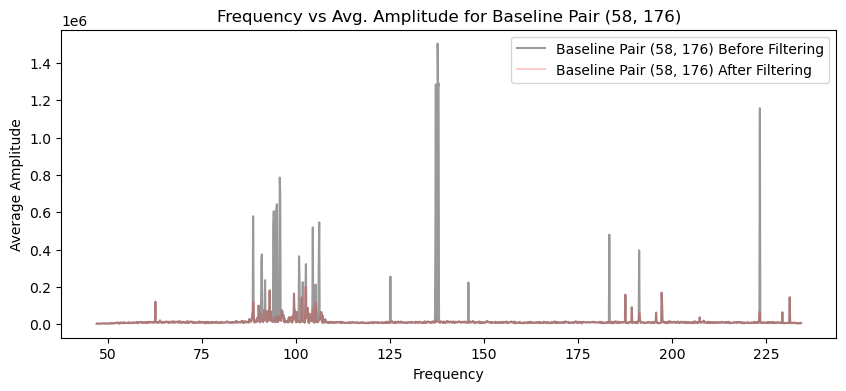

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.16519512 -0.15930693 -0.16207734 ... -0.13778016 -0.13176889
 -0.15302117]


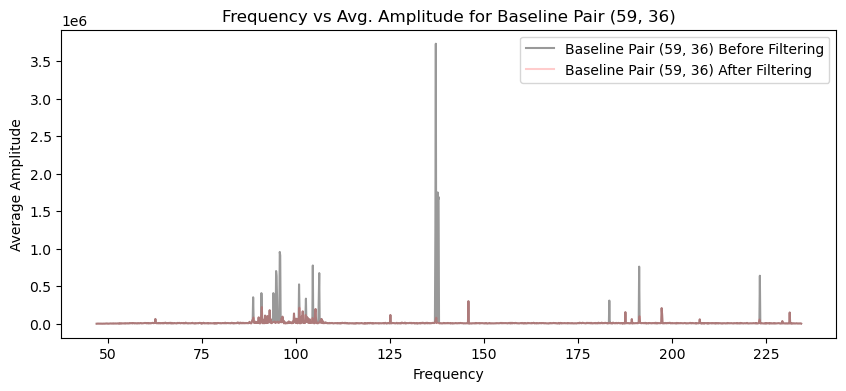

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18620678 -0.18153147 -0.18410412 ... -0.13733101 -0.14390392
 -0.14834694]


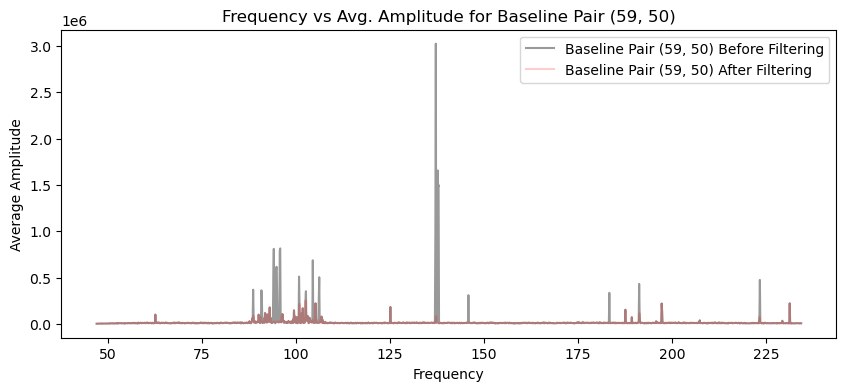

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15085482 -0.14518654 -0.146458   ... -0.13378677 -0.12978382
 -0.14304014]


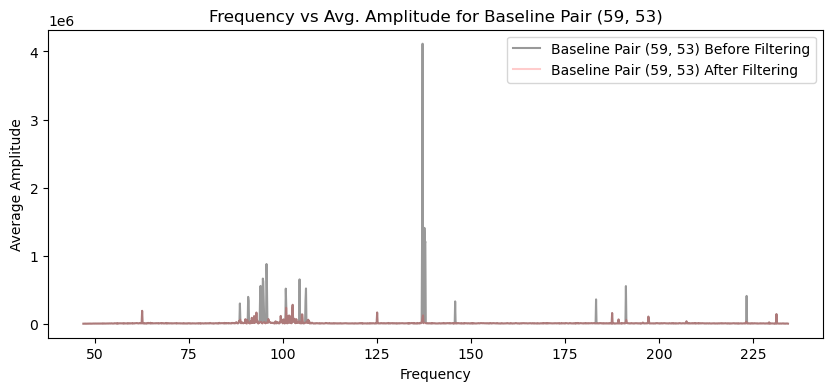

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.12391988 -0.13051556 -0.1342222  ... -0.11501368 -0.11735622
 -0.11596753]


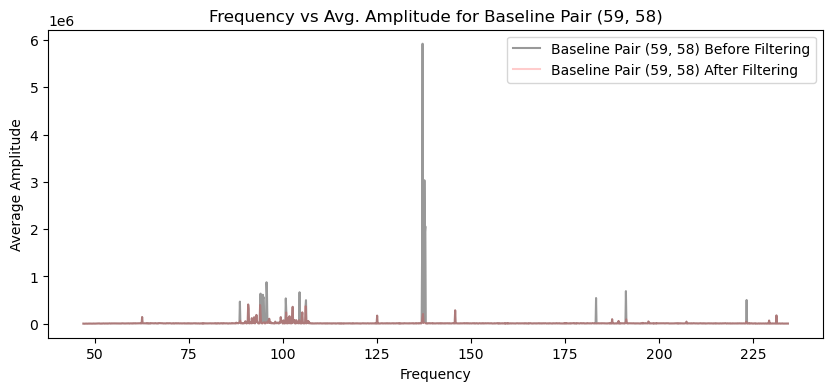

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.23952876 -0.2341229  -0.23135489 ... -0.17720417 -0.21629268
 -0.15656447]


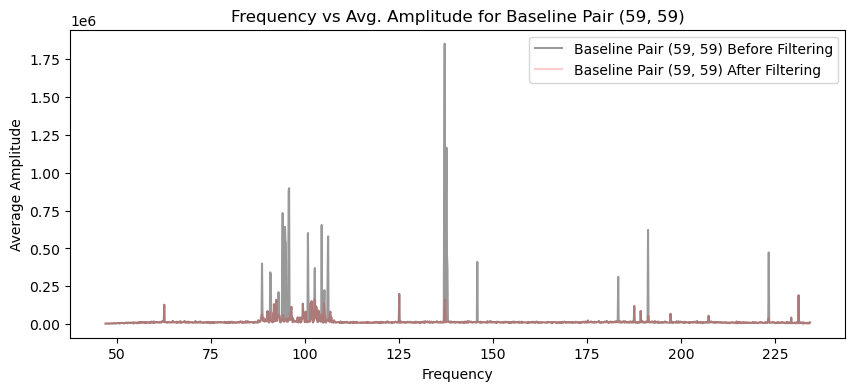

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.09431609 -0.12437257 -0.1057931  ... -0.0360105  -0.04974734
 -0.06643396]


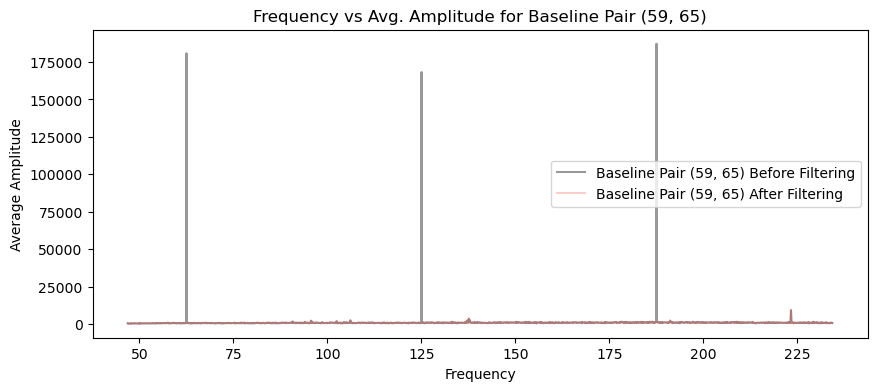

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.16300768 -0.16106527 -0.14954065 ... -0.12035769 -0.13983035
 -0.13941735]


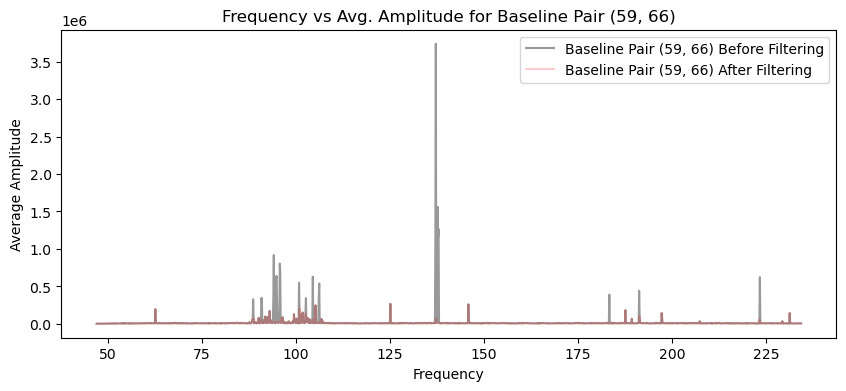

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15645894 -0.16267184 -0.16244994 ... -0.13019066 -0.14719875
 -0.14684326]


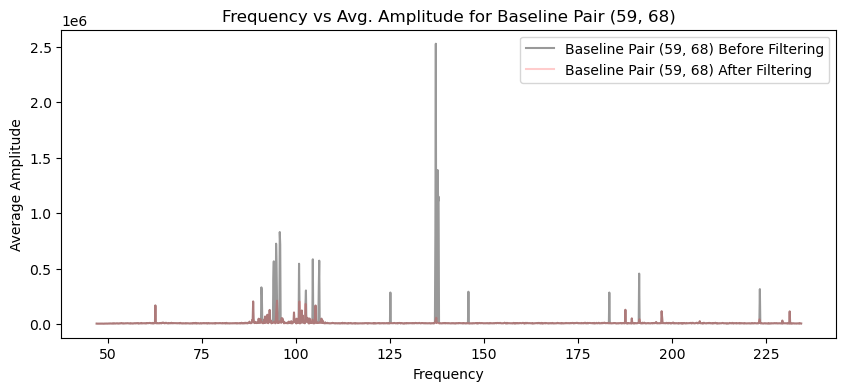

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.10837827 -0.10831012 -0.10649702 ... -0.09166395 -0.08660889
 -0.09770207]


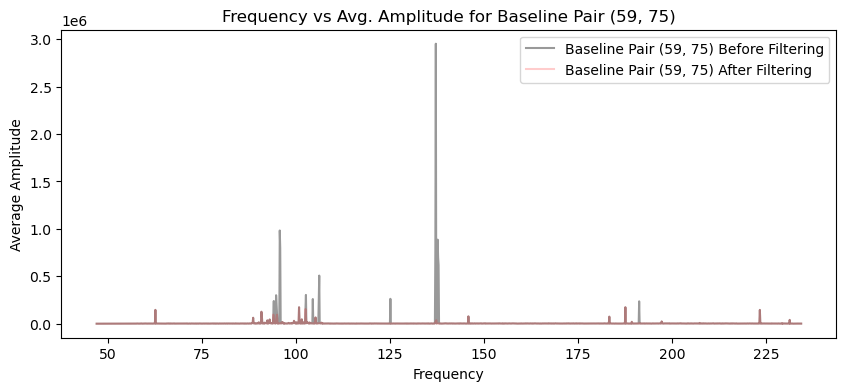

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.10141714 -0.11164434 -0.09215746 ... -0.06885704 -0.07946171
 -0.0644357 ]


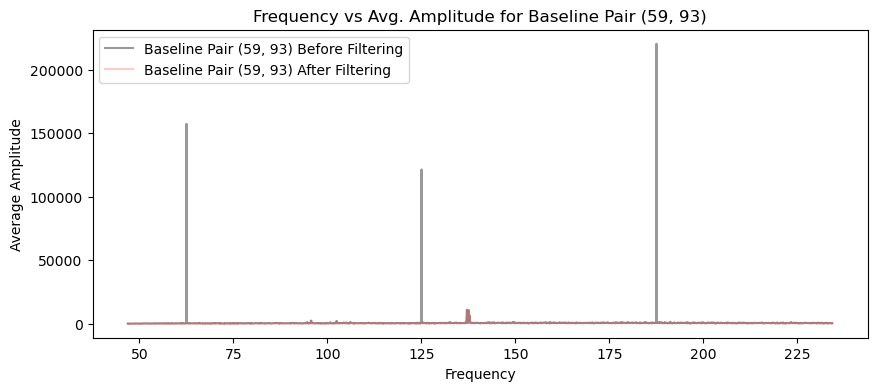

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.21046585 -0.20306311 -0.21894874 ... -0.17147932 -0.16734798
 -0.17523864]


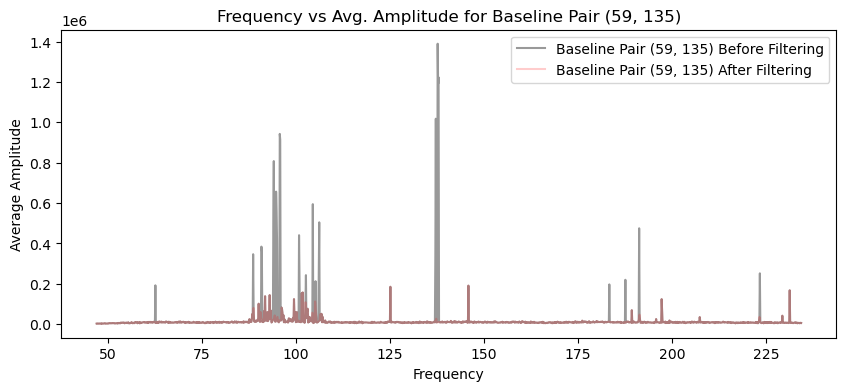

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.20662582 -0.20109176 -0.20152661 ... -0.17943667 -0.14549754
 -0.17034428]


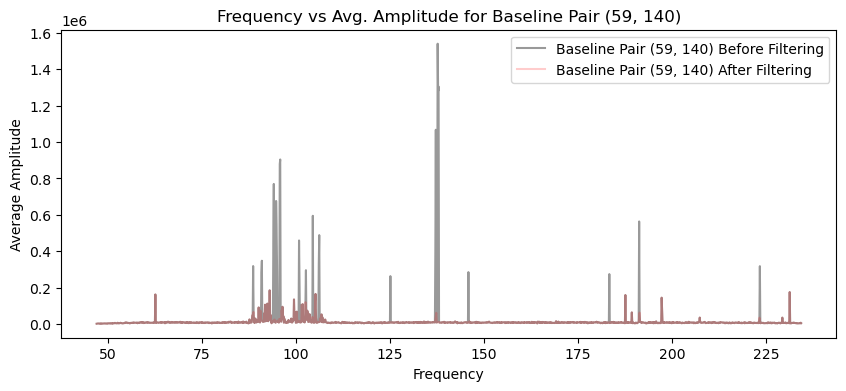

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.23015522 -0.21742734 -0.2037508  ... -0.18201557 -0.16717729
 -0.20850831]


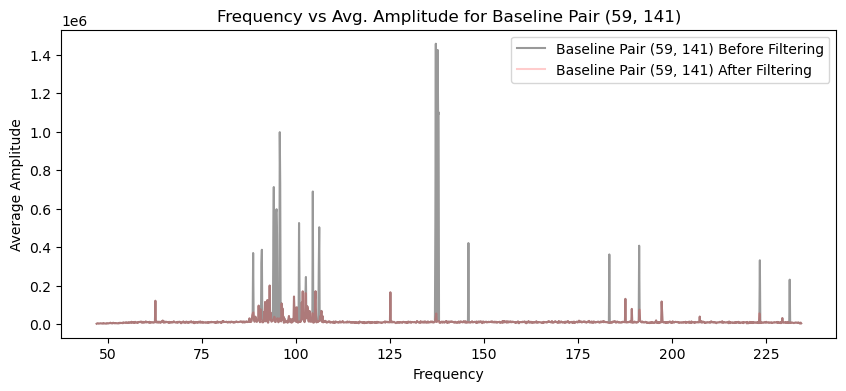

freqs shape: (1536,)
freqs_filtered shape: (1529,)
amplitudes_filtered shape: (20, 1529)
Threshold for baseline: [-0.11422981 -0.12000438 -0.08829753 ... -0.03326832 -0.06601318
 -0.07112412]


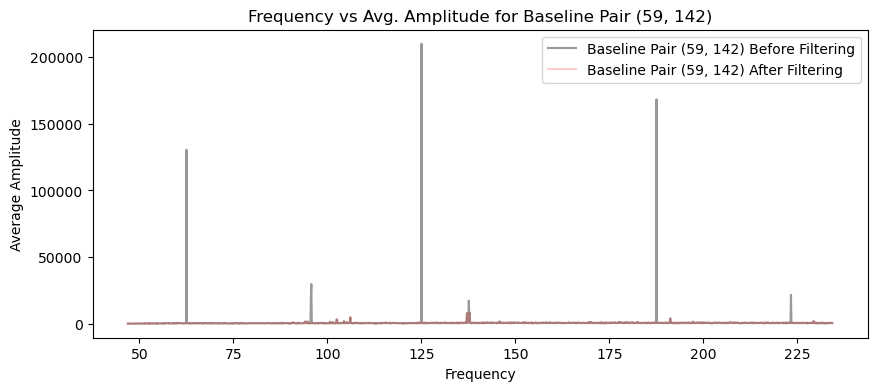

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.19542339 -0.21081001 -0.21295675 ... -0.20308448 -0.16524873
 -0.18644878]


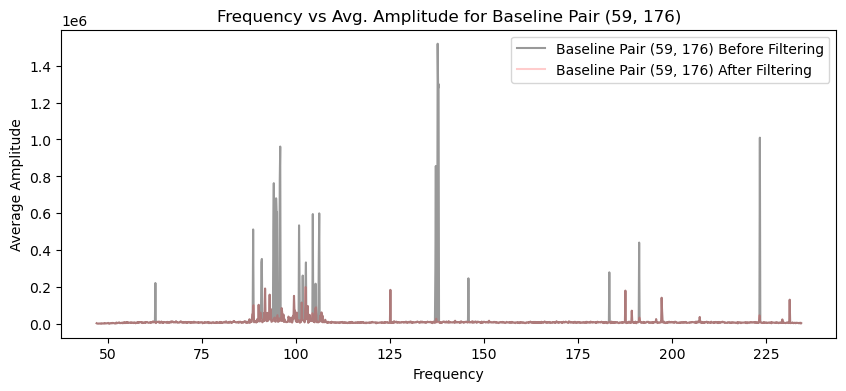

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.12583778 -0.11990428 -0.1430002  ... -0.06553336 -0.02106508
 -0.0491733 ]


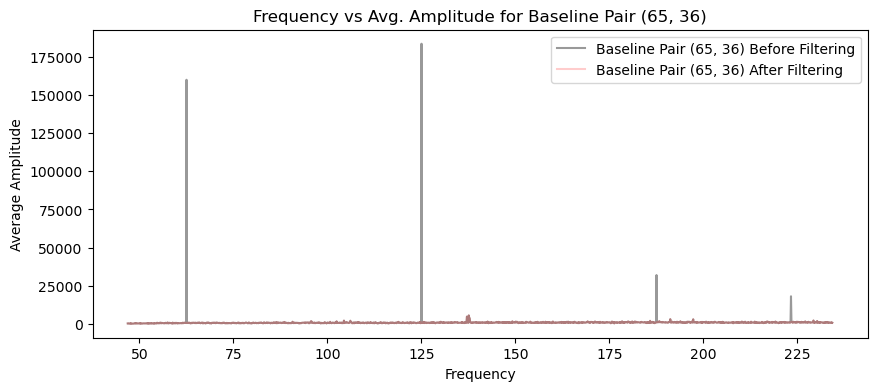

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.14492553 -0.1414116  -0.15260832 ... -0.02682987 -0.02419914
 -0.05667433]


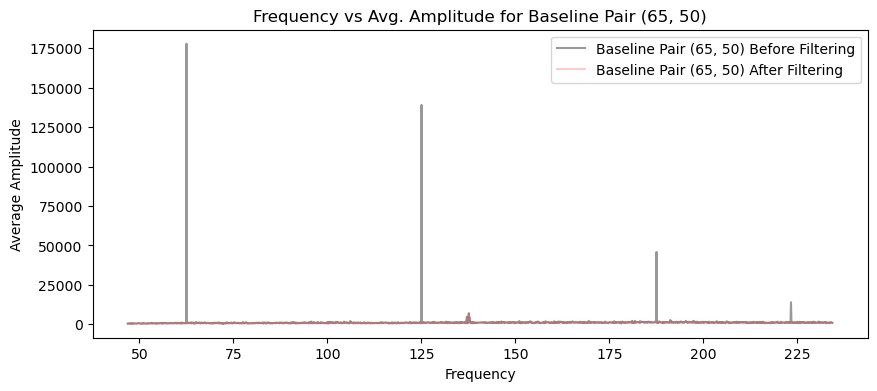

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.25129282 -0.18633565 -0.23027669 ... -0.00270243 -0.04225418
  0.00686564]


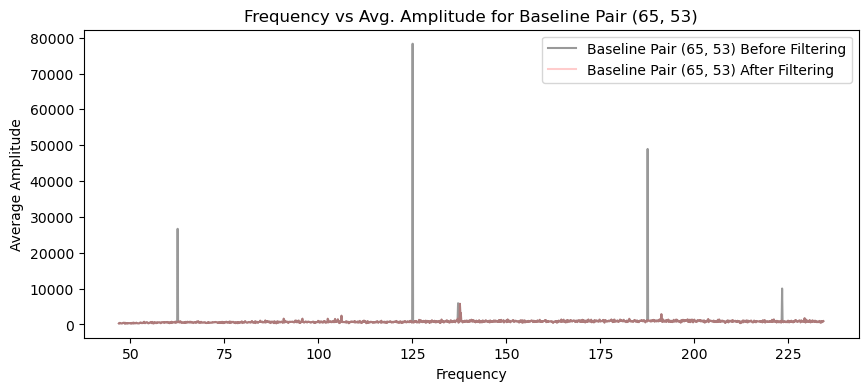

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.0718495  -0.19375325 -0.25079992 ...  0.09569158 -0.03494146
 -0.09194984]


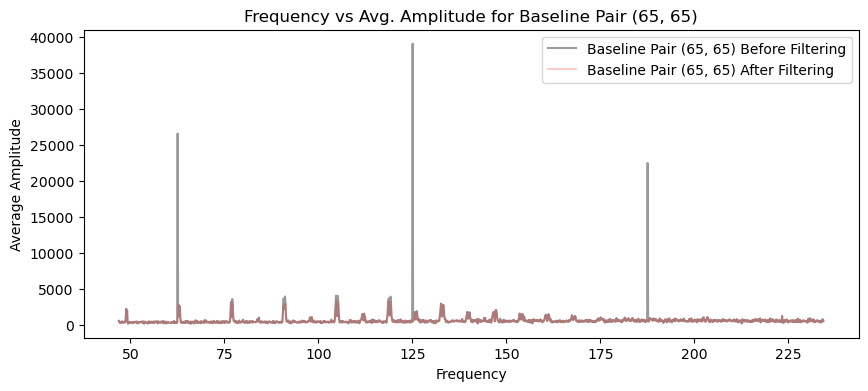

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.49290699 -0.43749998 -0.35536633 ... -0.10545734 -0.02451742
  0.01427689]


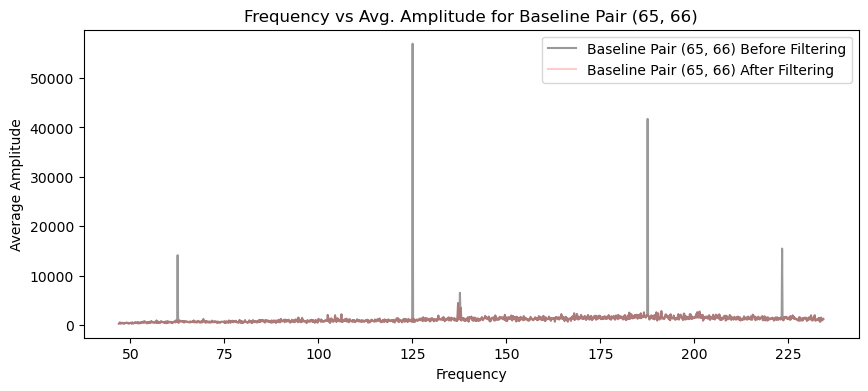

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.19471419 -0.1928828  -0.19073472 ...  0.01276737  0.02267705
 -0.01740038]


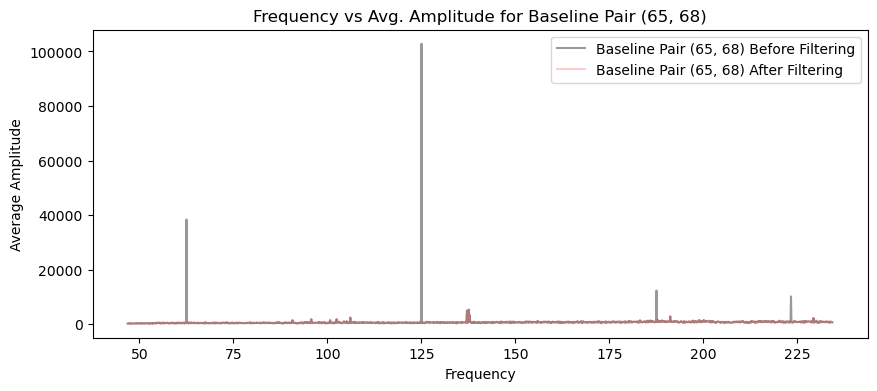

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.05846287 -0.04940823 -0.05941964 ... -0.04087855 -0.03826223
 -0.03660723]


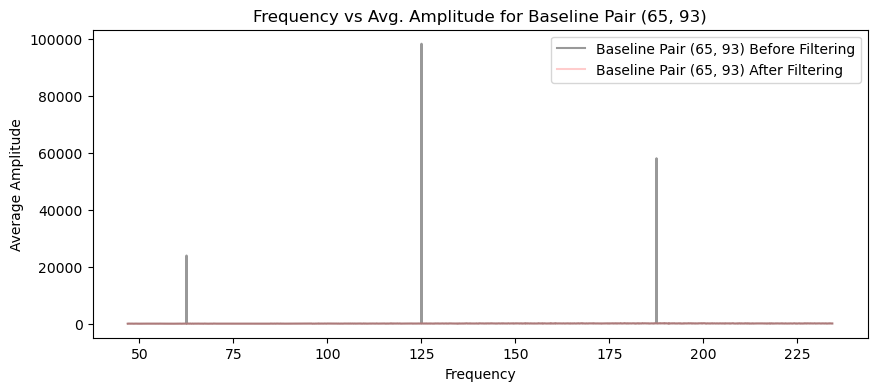

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14699405 -0.1476349  -0.1448004  ... -0.12148567 -0.11350946
 -0.12387857]


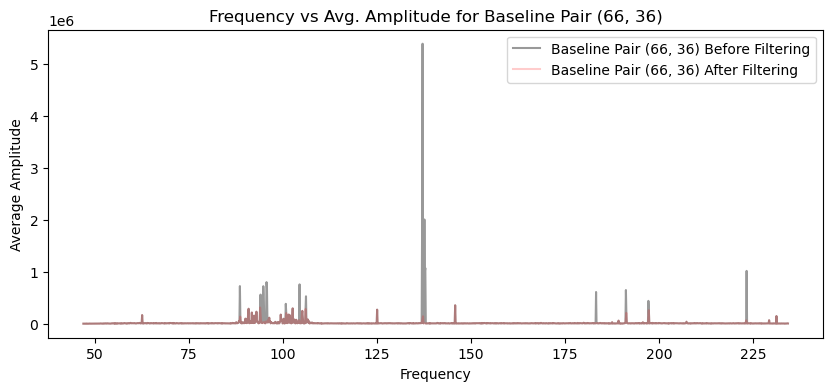

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17334262 -0.16651948 -0.17159253 ... -0.11934138 -0.15729448
 -0.14440436]


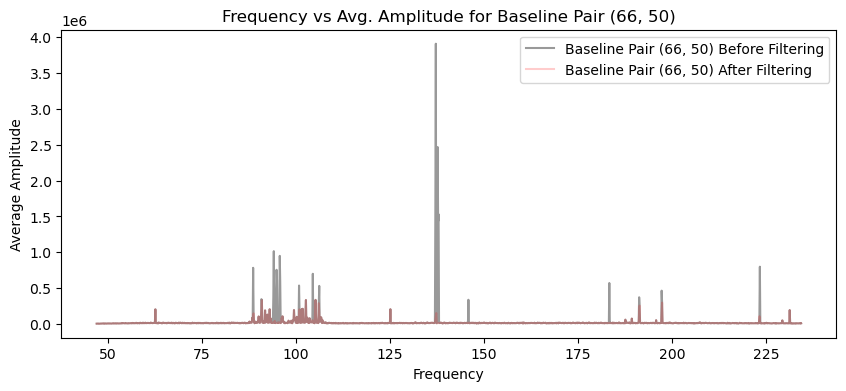

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.13807518 -0.15280372 -0.14567268 ... -0.13920949 -0.13086684
 -0.1348535 ]


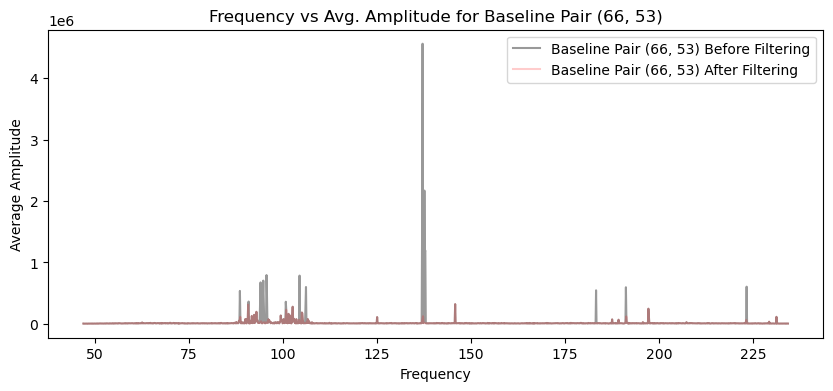

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.19328866 -0.18068276 -0.18445632 ... -0.1810293  -0.18222587
 -0.20692306]


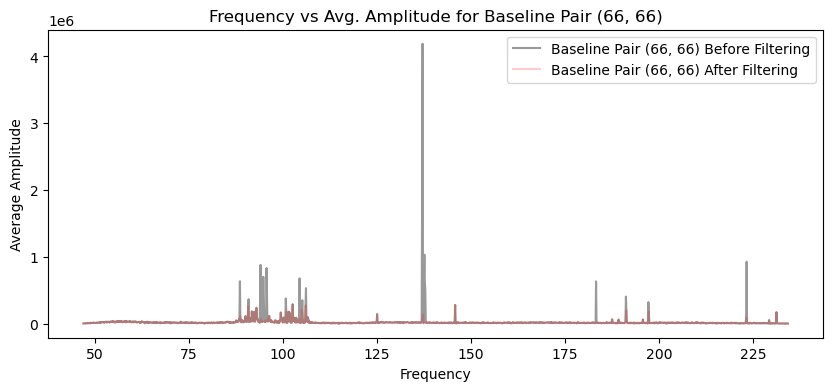

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.13626354 -0.13289573 -0.13780645 ... -0.12417204 -0.12151912
 -0.12127701]


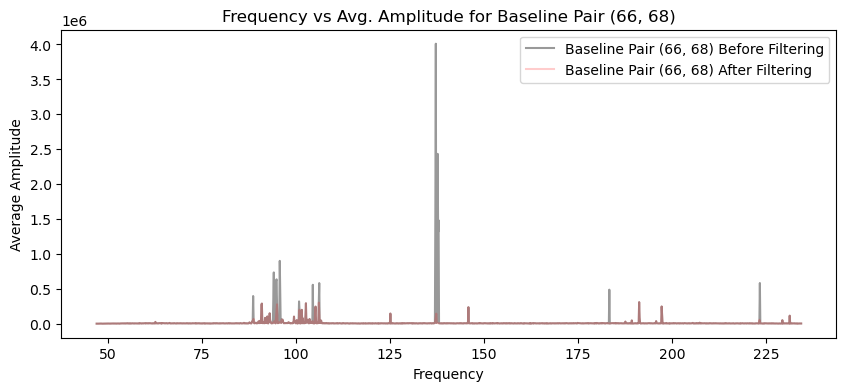

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.18457297 -0.19086022 -0.19177731 ...  0.02813783 -0.09335746
 -0.06667817]


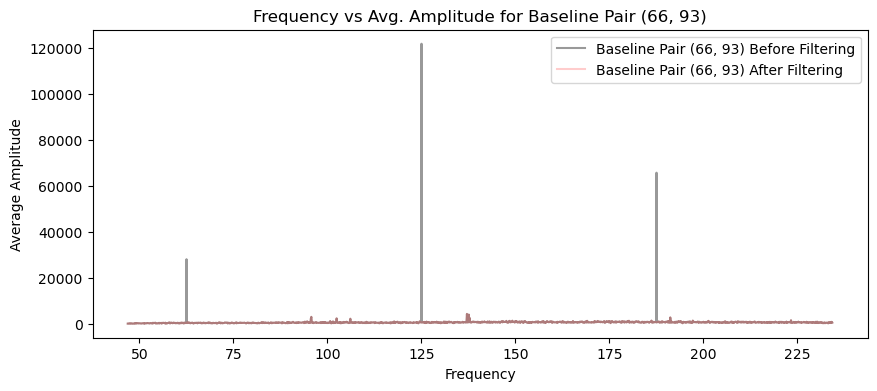

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14305375 -0.14368095 -0.15091294 ... -0.1326261  -0.13245387
 -0.13756632]


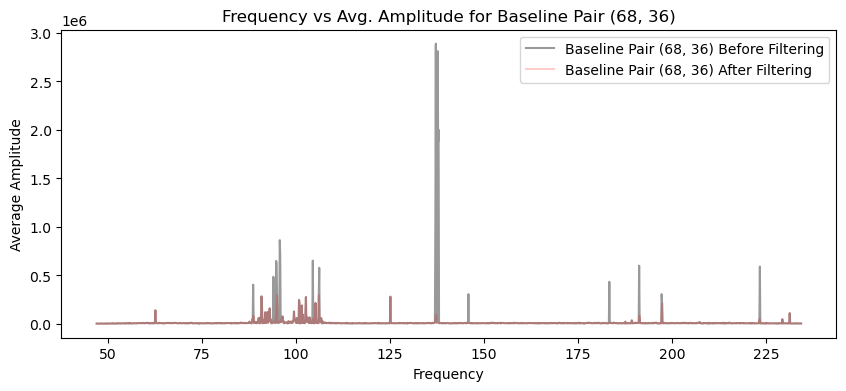

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.14109512 -0.13577185 -0.13693693 ... -0.13250709 -0.12797239
 -0.13116081]


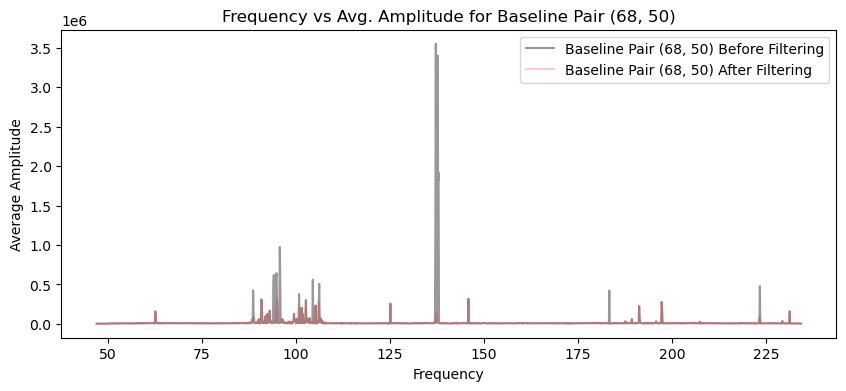

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16599144 -0.15801169 -0.16081724 ... -0.14496236 -0.15319889
 -0.15434811]


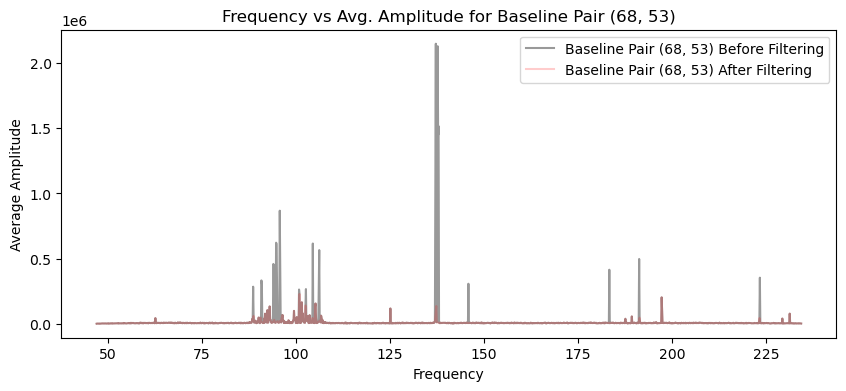

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18125788 -0.17088762 -0.18295519 ... -0.15583813 -0.14636299
 -0.15969625]


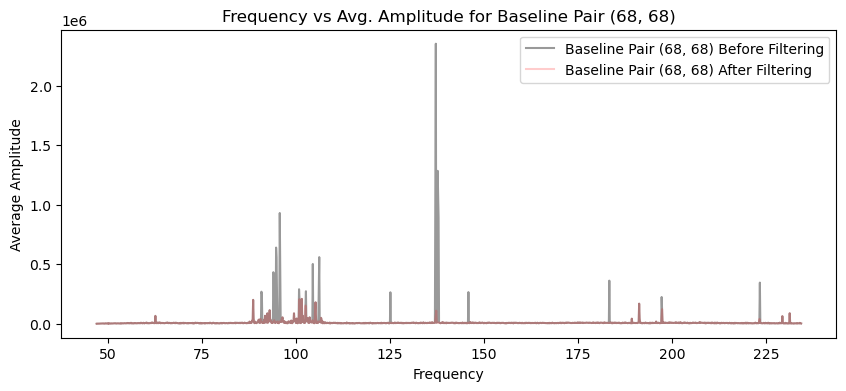

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.09097978 -0.11224152 -0.10218405 ... -0.06431306 -0.01326145
  0.0076623 ]


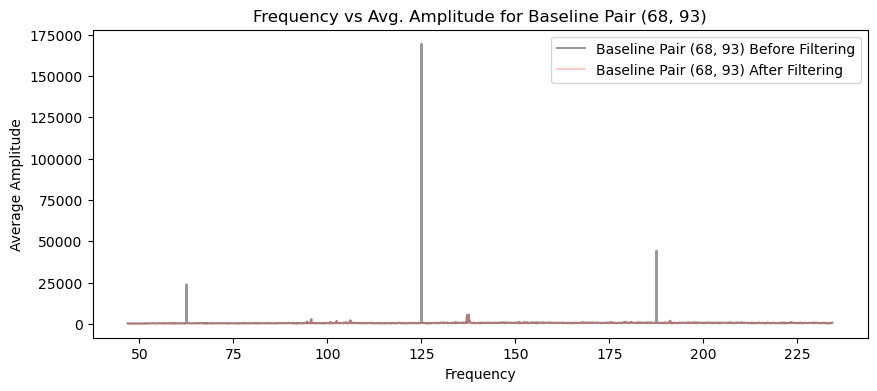

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.1143818  -0.11352138 -0.11057669 ... -0.09629823 -0.09948385
 -0.09541801]


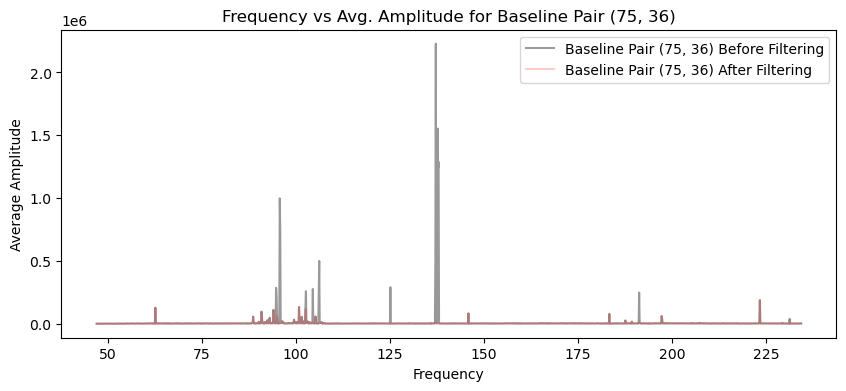

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.11691118 -0.11707736 -0.11633437 ... -0.09940193 -0.0984754
 -0.10252114]


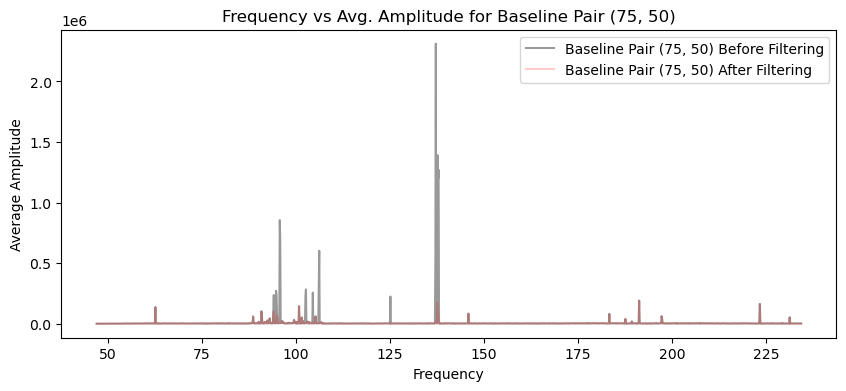

freqs shape: (1536,)
freqs_filtered shape: (1523,)
amplitudes_filtered shape: (20, 1523)
Threshold for baseline: [-0.09509058 -0.09457593 -0.09370411 ... -0.08593009 -0.08468641
 -0.08714475]


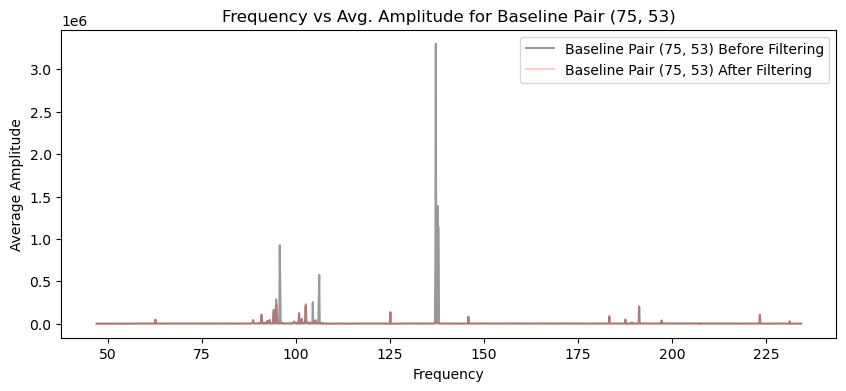

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.12502552 -0.10104239 -0.10941218 ... -0.04071276 -0.0257265
 -0.04149115]


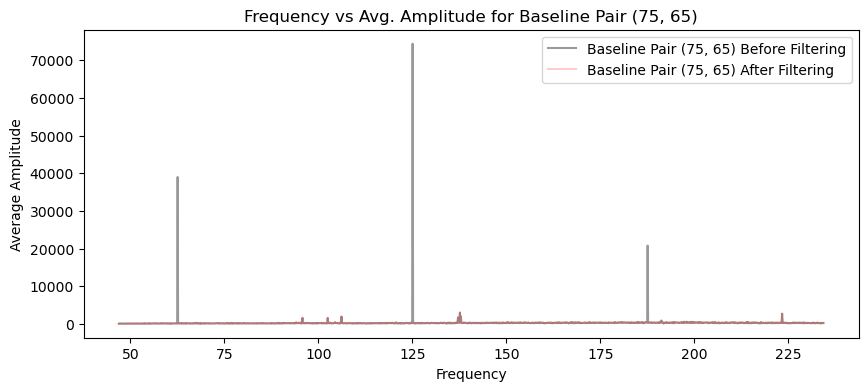

freqs shape: (1536,)
freqs_filtered shape: (1522,)
amplitudes_filtered shape: (20, 1522)
Threshold for baseline: [-0.11001535 -0.11029154 -0.10942711 ... -0.09075008 -0.09060376
 -0.09334604]


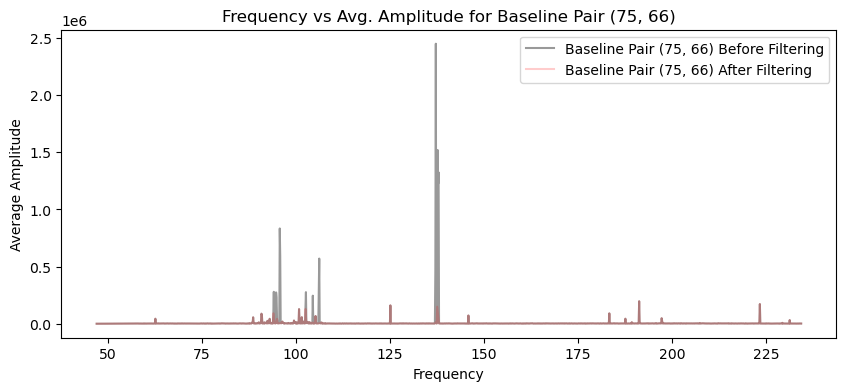

freqs shape: (1536,)
freqs_filtered shape: (1521,)
amplitudes_filtered shape: (20, 1521)
Threshold for baseline: [-0.10471344 -0.10850047 -0.10507154 ... -0.09048166 -0.09408496
 -0.09408315]


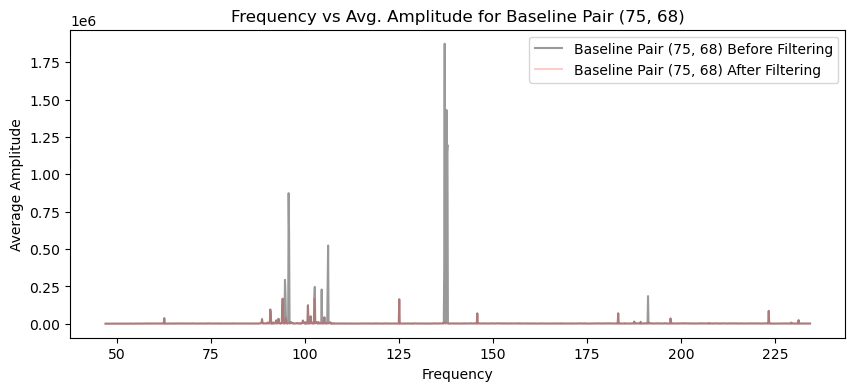

freqs shape: (1536,)
freqs_filtered shape: (1525,)
amplitudes_filtered shape: (20, 1525)
Threshold for baseline: [-0.07865301 -0.07695968 -0.08028593 ... -0.07632338 -0.07348139
 -0.0736501 ]


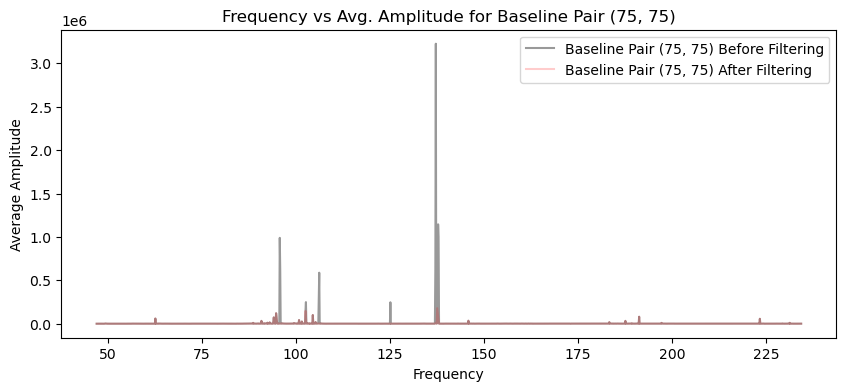

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.08016139 -0.07161486 -0.07689101 ... -0.03052535 -0.02737187
 -0.05824195]


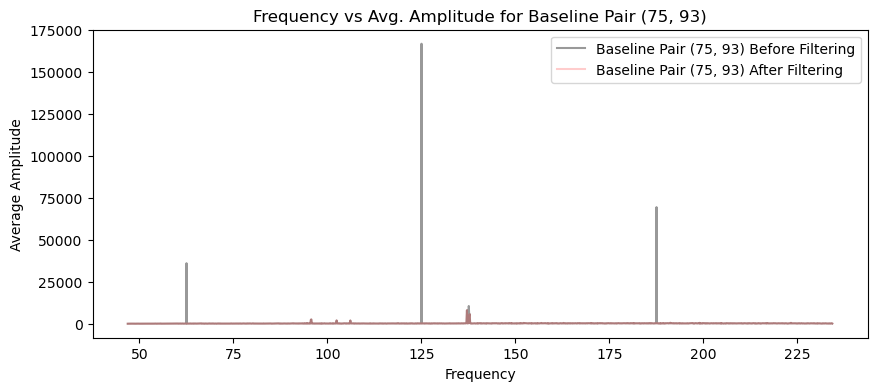

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.13028657 -0.13086083 -0.13264302 ... -0.11827573 -0.11325752
 -0.11825184]


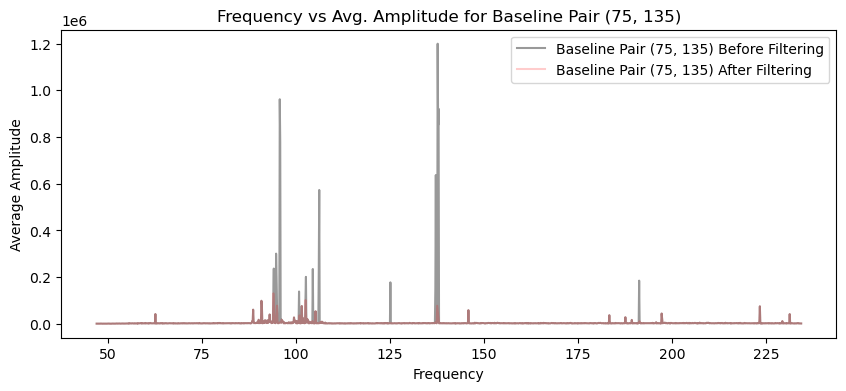

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.12491061 -0.12296331 -0.12537027 ... -0.10767841 -0.11595858
 -0.10302636]


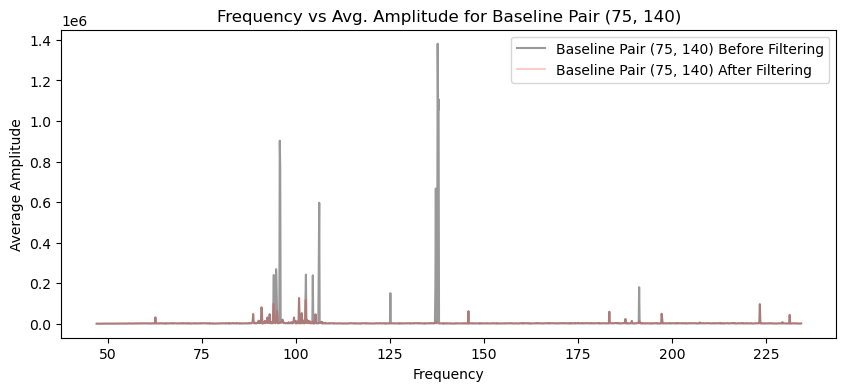

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.13277134 -0.12681467 -0.13185649 ... -0.09680941 -0.11518218
 -0.11387217]


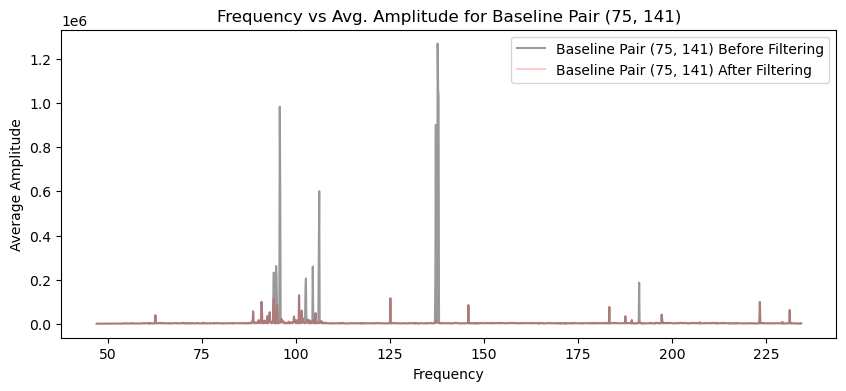

freqs shape: (1536,)
freqs_filtered shape: (1530,)
amplitudes_filtered shape: (20, 1530)
Threshold for baseline: [-0.06821936 -0.07148667 -0.07211238 ... -0.04555836 -0.02557162
 -0.04425254]


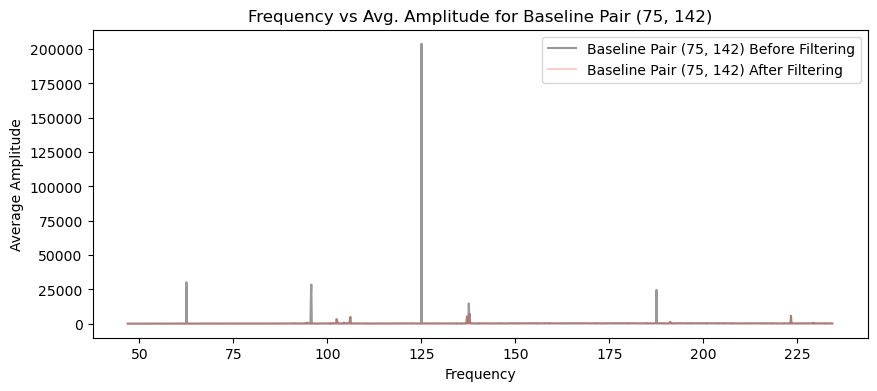

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.13951875 -0.14062021 -0.14243801 ... -0.12087336 -0.12083969
 -0.11630487]


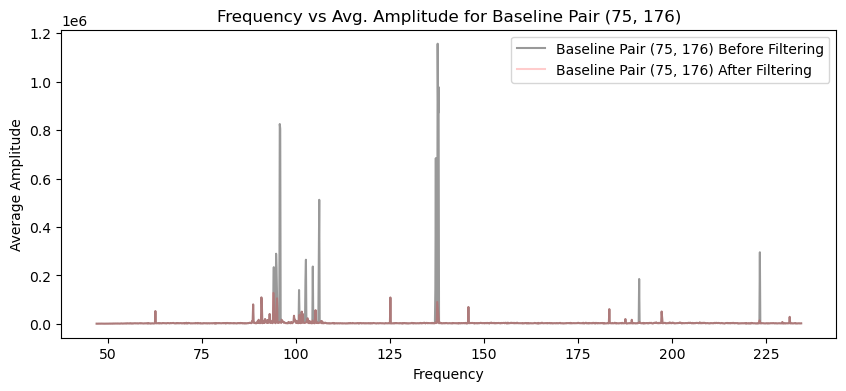

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.1181808  -0.11329153 -0.11401615 ... -0.11303632 -0.1068624
 -0.11099808]


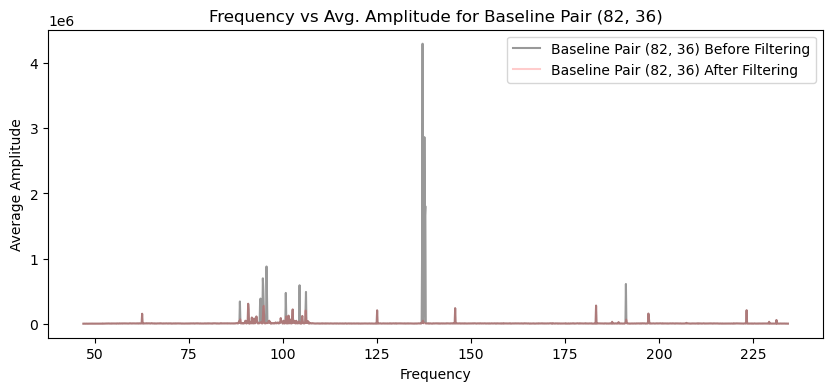

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.13368003 -0.1301407  -0.13326642 ... -0.11607785 -0.12853526
 -0.10446845]


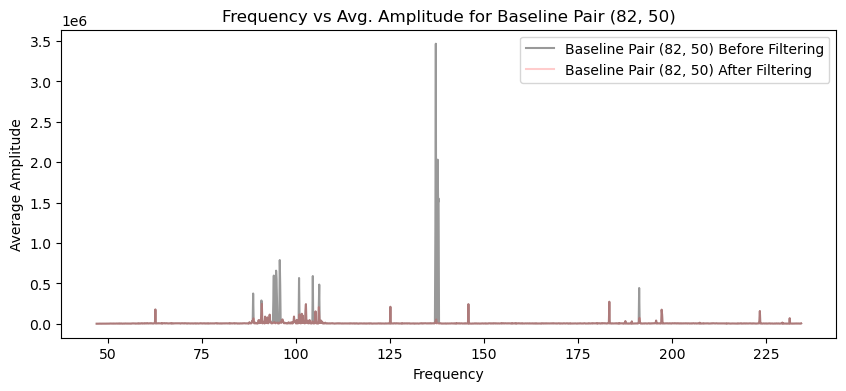

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.1230857  -0.12568674 -0.12760355 ... -0.11732251 -0.11639001
 -0.11426173]


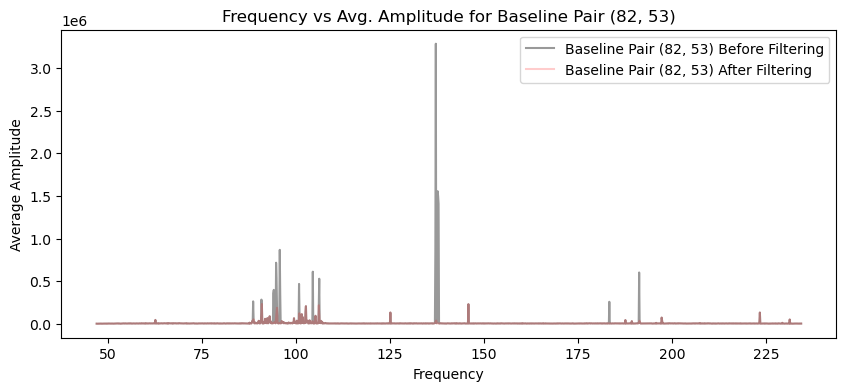

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.13572188 -0.13489529 -0.1351626  ... -0.1199189  -0.12883052
 -0.12096824]


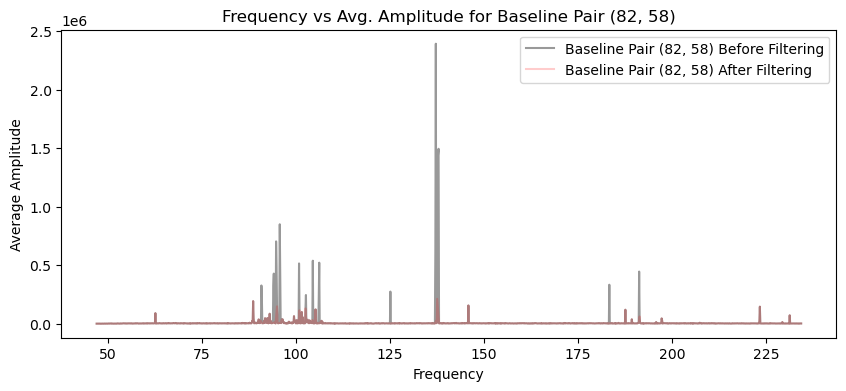

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.13111856 -0.13682585 -0.13450441 ... -0.11541396 -0.12743048
 -0.10984627]


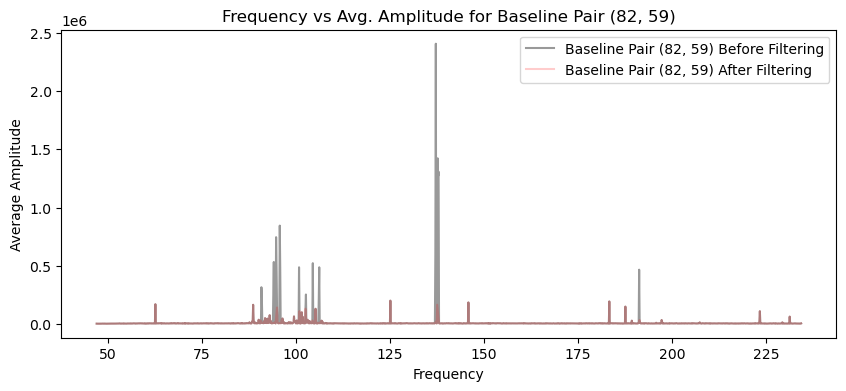

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.11130565 -0.09310485 -0.10564674 ... -0.04143898 -0.07843399
 -0.07158657]


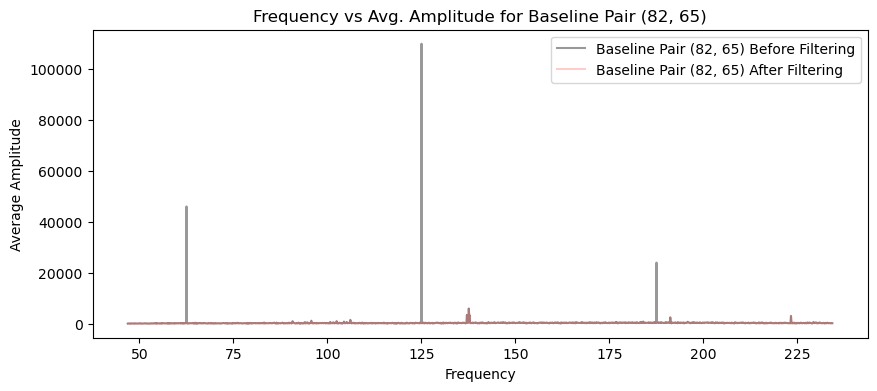

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.11999186 -0.12049213 -0.12037534 ... -0.11415026 -0.11249922
 -0.11396693]


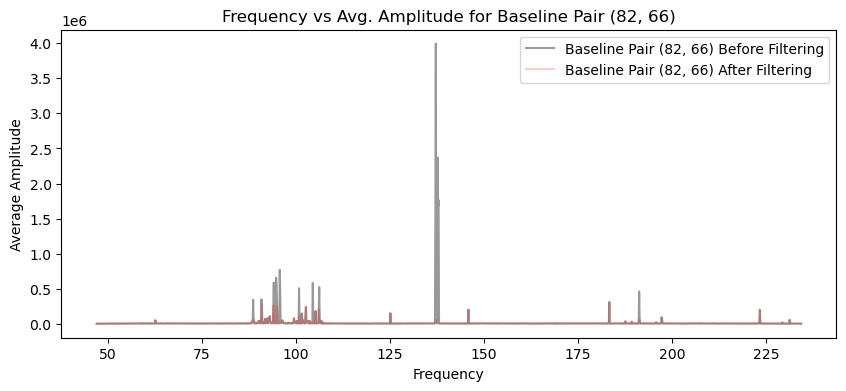

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.11573455 -0.1107744  -0.11237708 ... -0.10335292 -0.10114619
 -0.11125947]


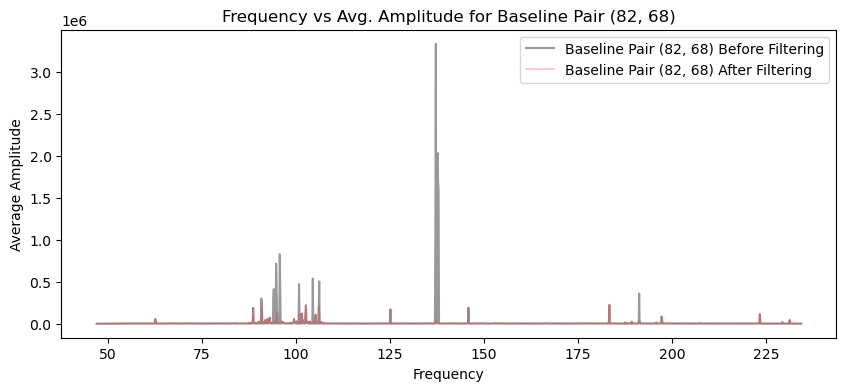

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.09943694 -0.0999976  -0.09888867 ... -0.08927576 -0.08868969
 -0.09168308]


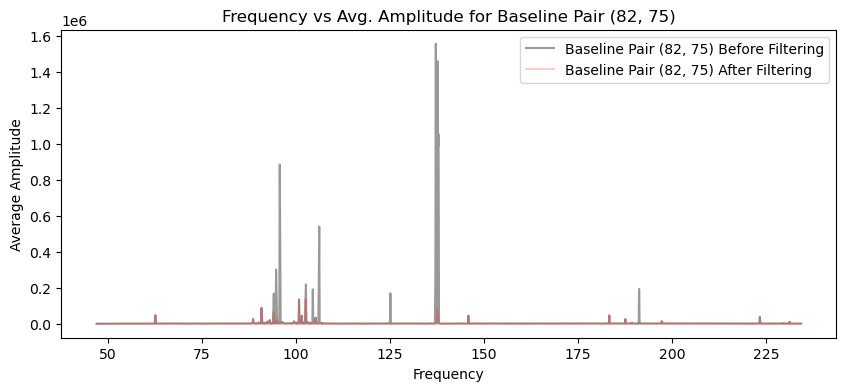

freqs shape: (1536,)
freqs_filtered shape: (1522,)
amplitudes_filtered shape: (20, 1522)
Threshold for baseline: [-0.10222246 -0.10401433 -0.10206481 ... -0.09827968 -0.0953067
 -0.09653154]


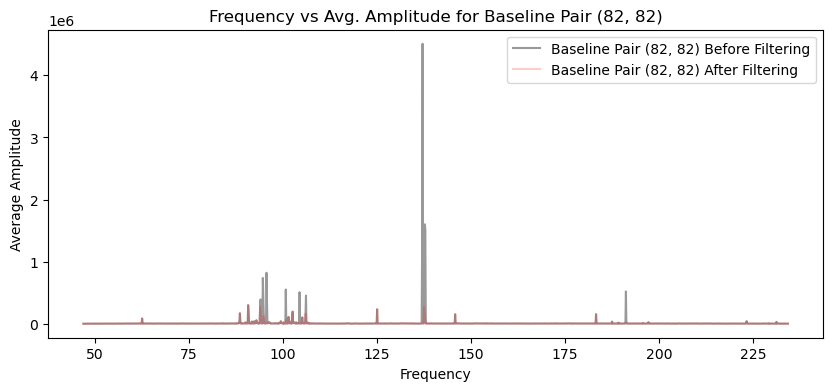

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.12807447 -0.12553044 -0.12852019 ... -0.12034308 -0.11713343
 -0.12253906]


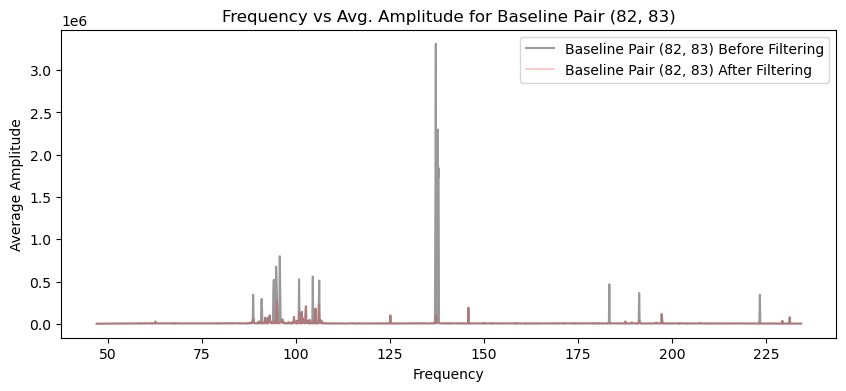

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.09562287 -0.07708683 -0.08511905 ... -0.07659657 -0.04761071
 -0.05507291]


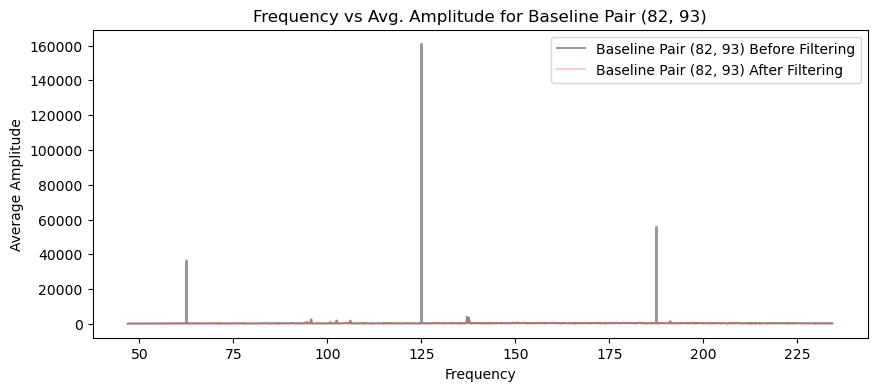

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.13082495 -0.13027131 -0.12982464 ... -0.1196941  -0.11505627
 -0.1093742 ]


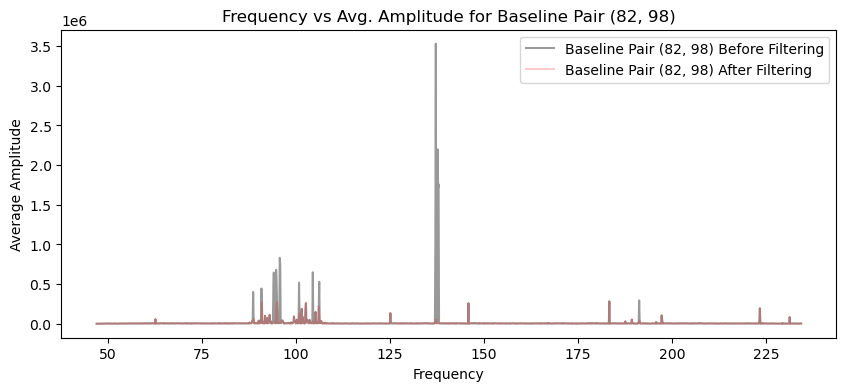

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.10945328 -0.11074087 -0.11277037 ... -0.10700154 -0.10412487
 -0.10352574]


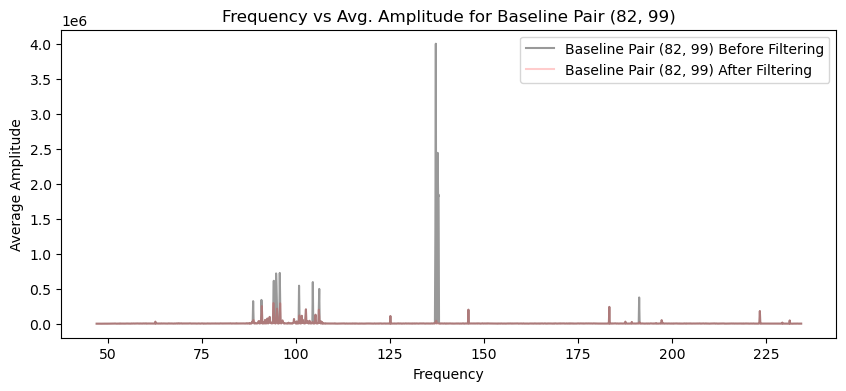

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.11946828 -0.12308948 -0.12299169 ... -0.10974208 -0.10925535
 -0.11079867]


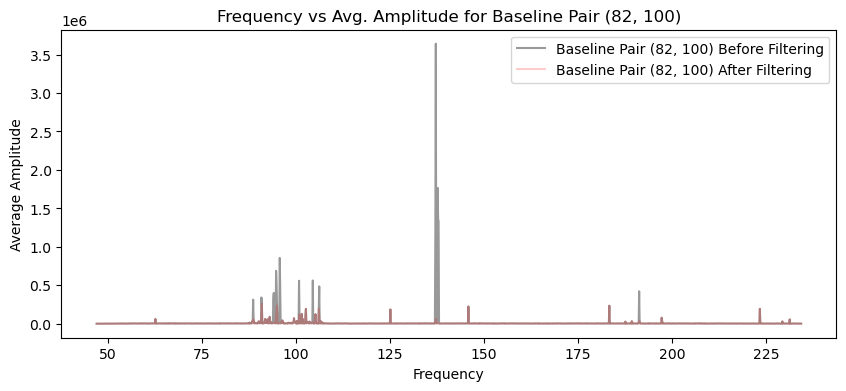

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.12315948 -0.11768164 -0.12221072 ... -0.11554271 -0.11514848
 -0.11347446]


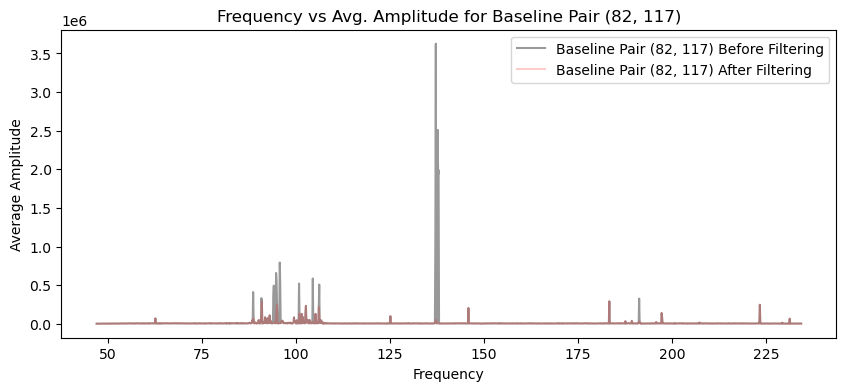

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.10281396 -0.10893163 -0.10914063 ... -0.10578148 -0.10077282
 -0.10808854]


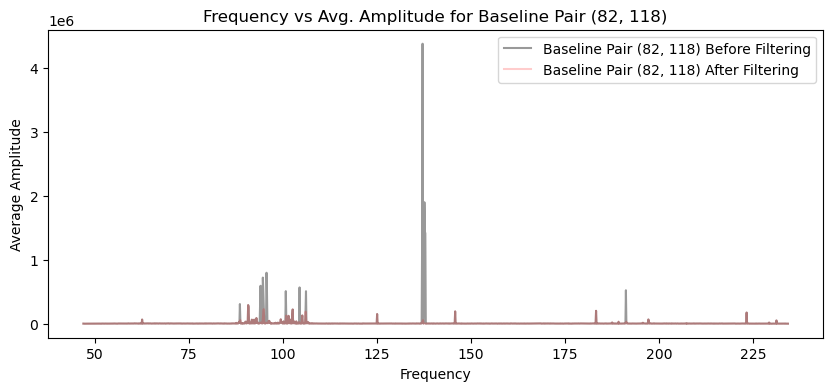

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.12482139 -0.12590669 -0.129094   ... -0.11735986 -0.11199373
 -0.11473801]


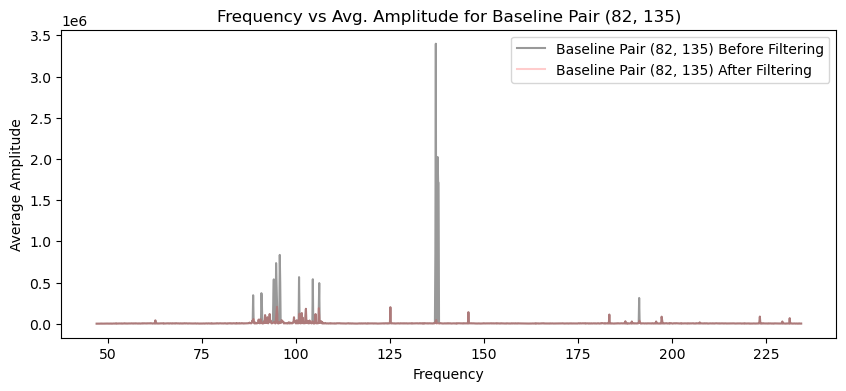

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.10813405 -0.11097877 -0.11388712 ... -0.10149435 -0.10620926
 -0.11120763]


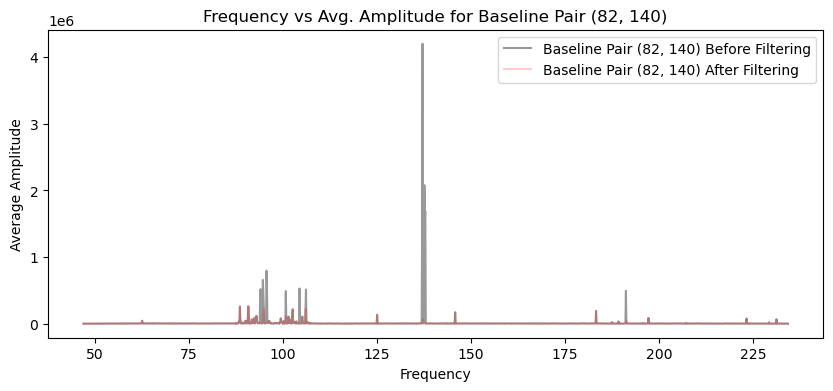

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.12571028 -0.12007734 -0.1200084  ... -0.09962945 -0.1119714
 -0.10952558]


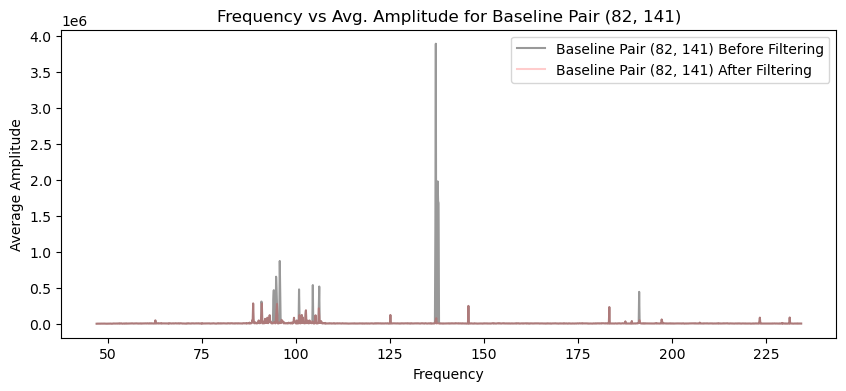

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.09389457 -0.08826153 -0.09602195 ... -0.06130459 -0.02920297
 -0.06556725]


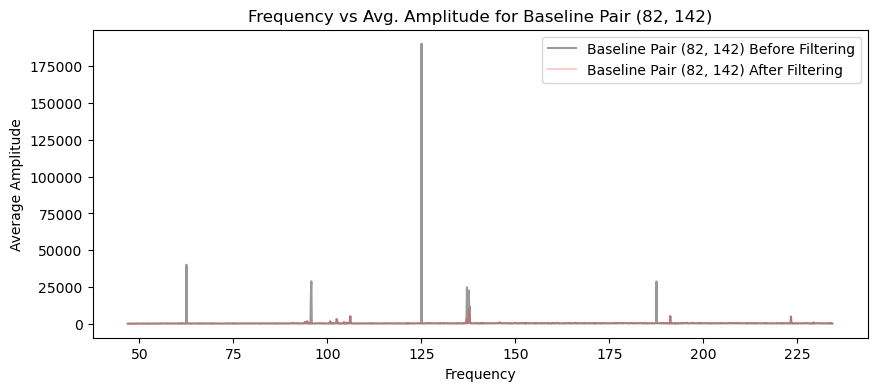

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.14888263 -0.14981976 -0.15183892 ... -0.14118249 -0.13688218
 -0.13486711]


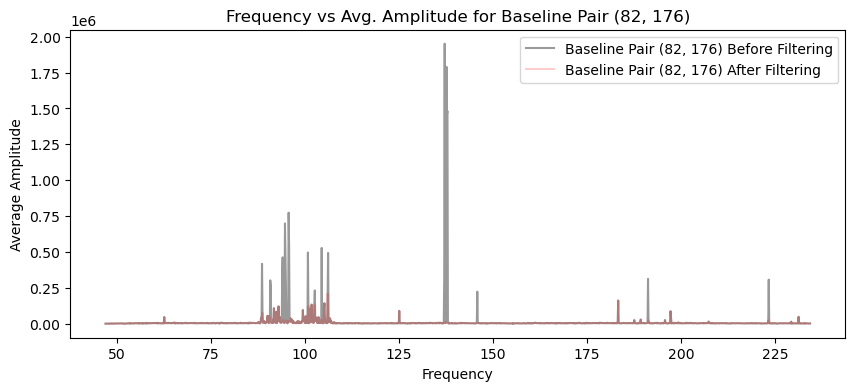

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.17217705 -0.17281378 -0.16338226 ... -0.16389668 -0.13552099
 -0.1566874 ]


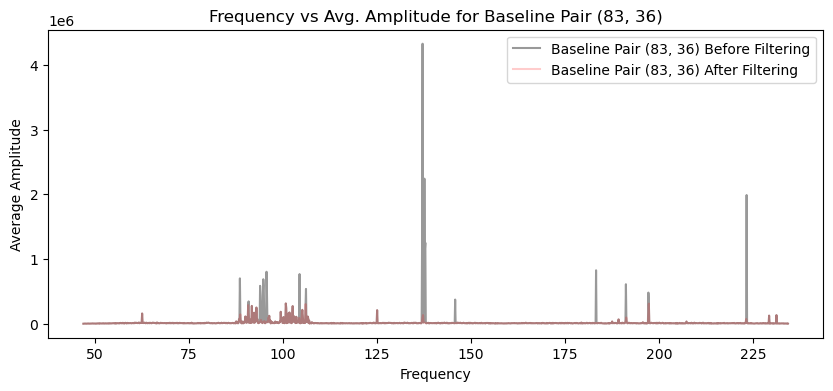

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.21455756 -0.20868882 -0.21940954 ... -0.18609646 -0.1966718
 -0.19177102]


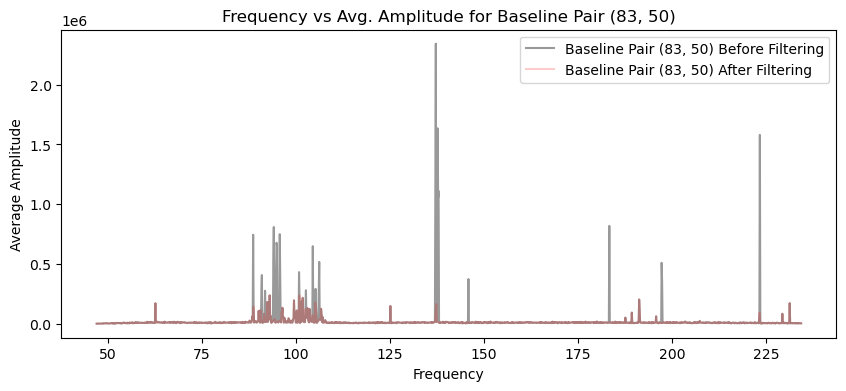

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19325172 -0.20175044 -0.19961409 ... -0.18442062 -0.17270505
 -0.16283613]


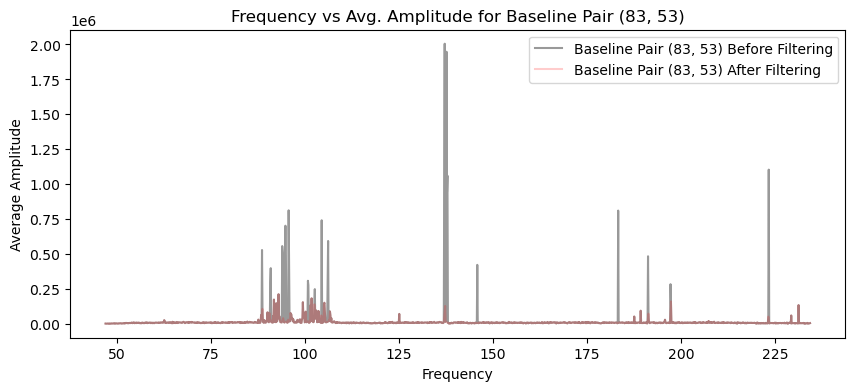

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19126158 -0.17800429 -0.1909998  ... -0.15530121 -0.16910195
 -0.16202603]


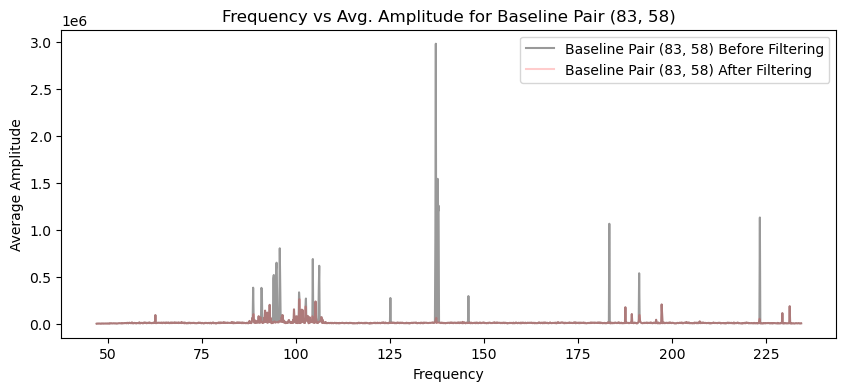

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18082294 -0.17847843 -0.1779149  ... -0.17272269 -0.16863626
 -0.17127398]


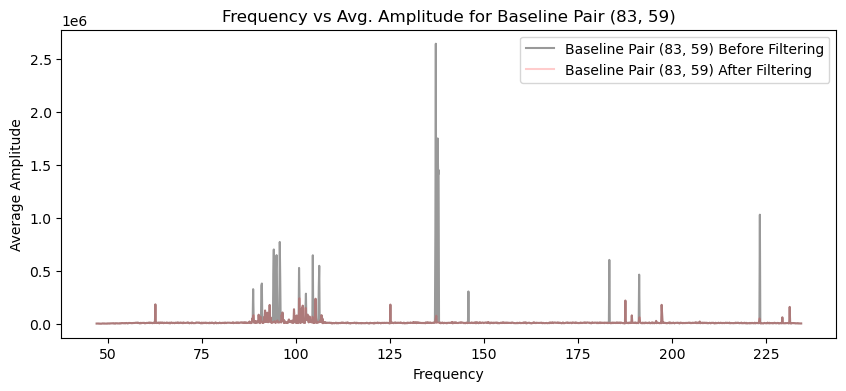

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.50378678 -0.56723127 -0.5089247  ...  0.00119985 -0.0323897
 -0.15920279]


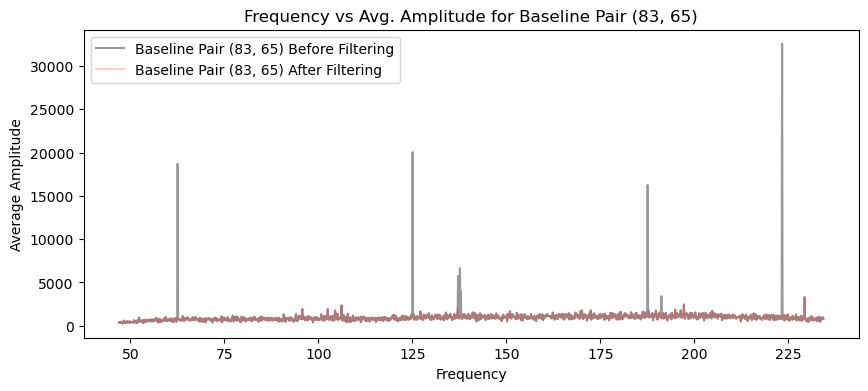

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.16853643 -0.16041852 -0.17932617 ... -0.16367046 -0.16072484
 -0.17312559]


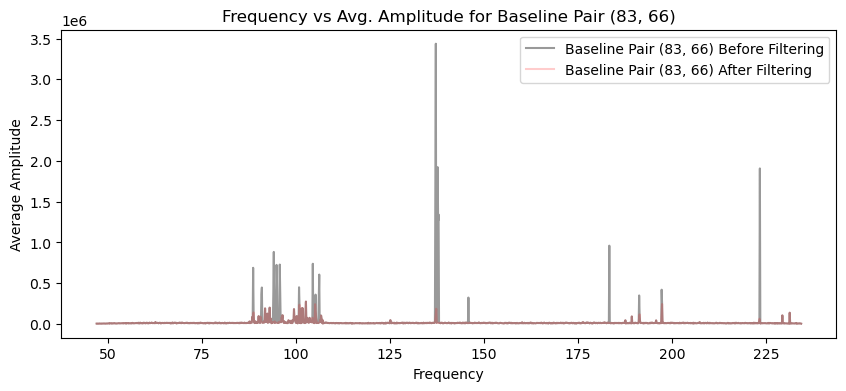

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.16117473 -0.16228782 -0.16131354 ... -0.13069752 -0.14867377
 -0.1270924 ]


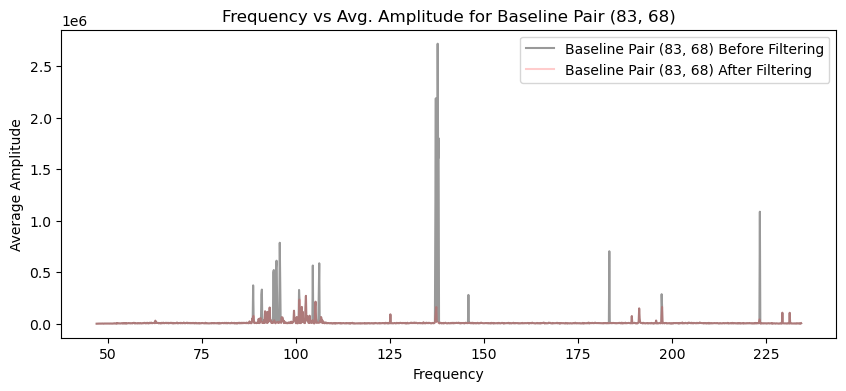

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.11889246 -0.11890252 -0.11744509 ... -0.09889202 -0.10095151
 -0.10263986]


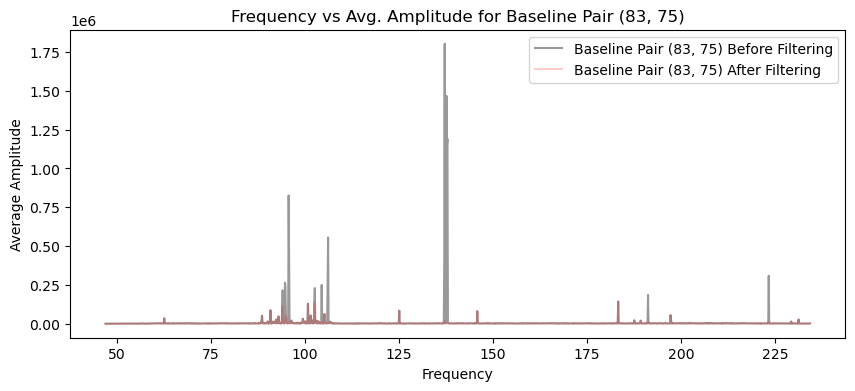

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.21889613 -0.21352147 -0.21310081 ... -0.20546665 -0.19620233
 -0.18027677]


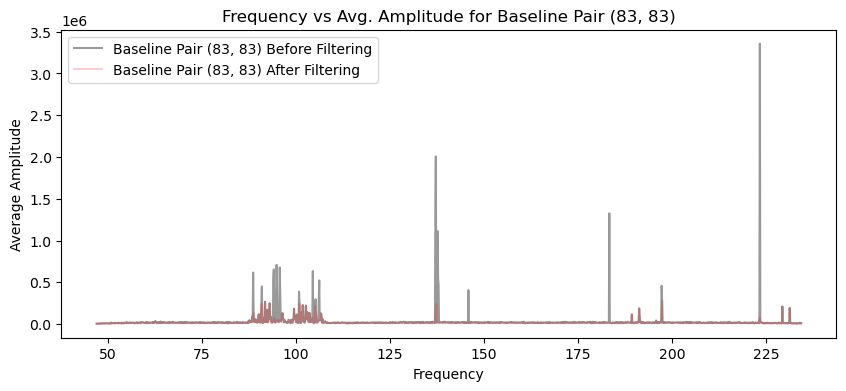

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.19905156 -0.2022789  -0.19017303 ... -0.11128705 -0.12477073
 -0.10241733]


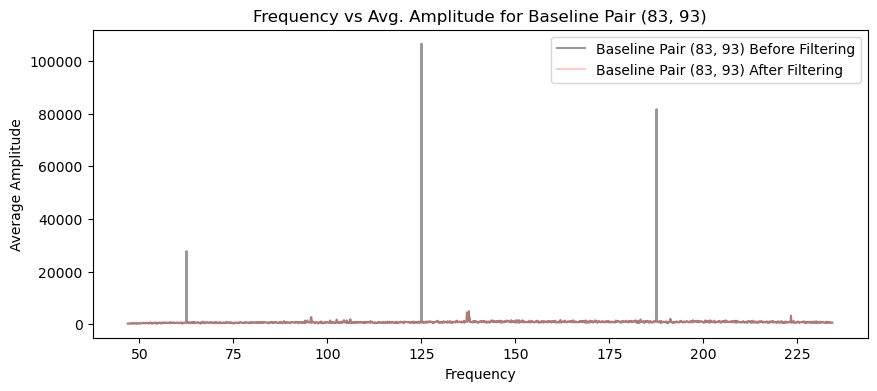

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.18694373 -0.16855896 -0.17498697 ... -0.15628147 -0.15597244
 -0.16862098]


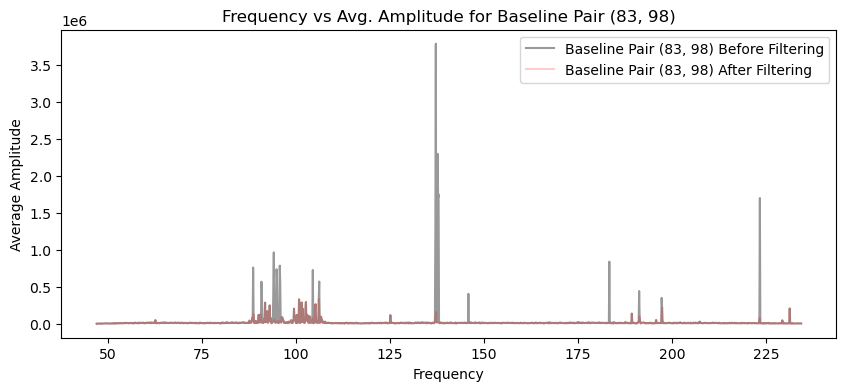

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15960024 -0.15674744 -0.15252269 ... -0.13857696 -0.1614587
 -0.14497823]


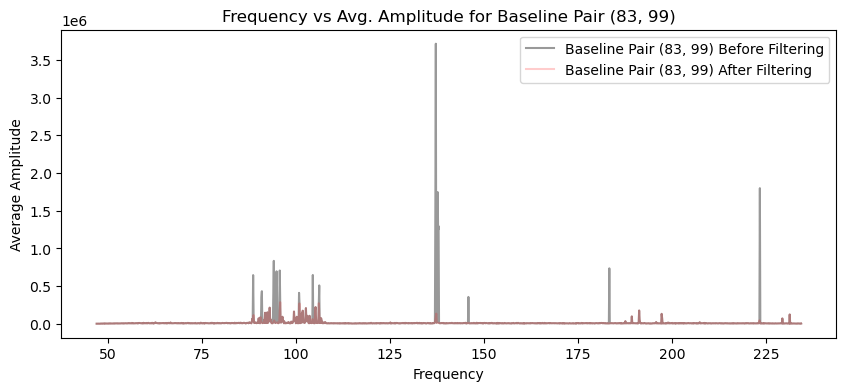

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.16976585 -0.1677728  -0.16105119 ... -0.14148915 -0.13438214
 -0.16103282]


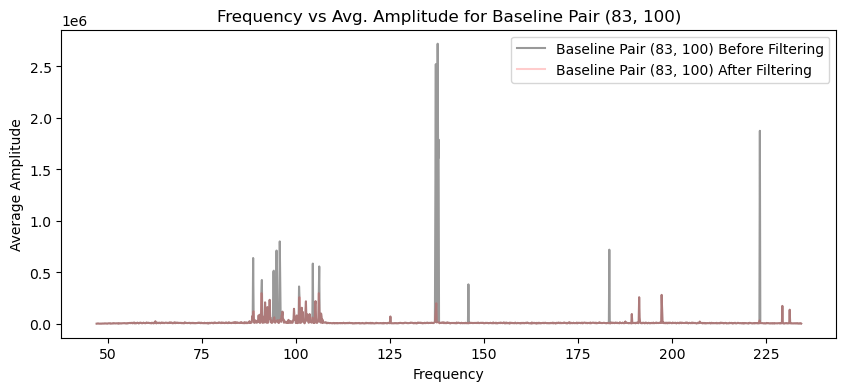

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.16448337 -0.16866796 -0.17198952 ... -0.15236152 -0.16258879
 -0.14323991]


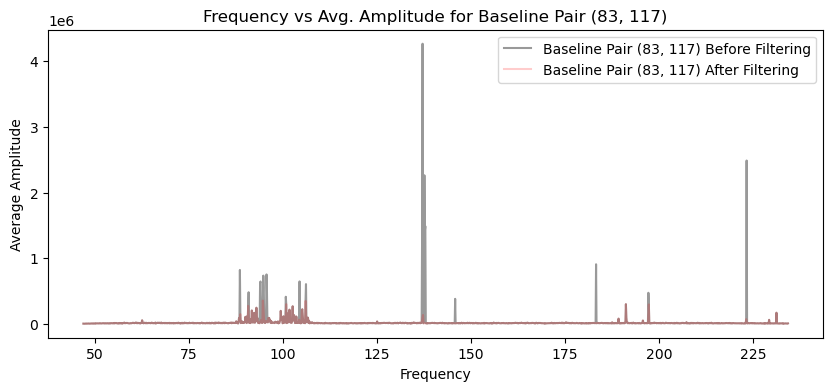

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.14402948 -0.14872341 -0.15013727 ... -0.14424094 -0.14480727
 -0.14886407]


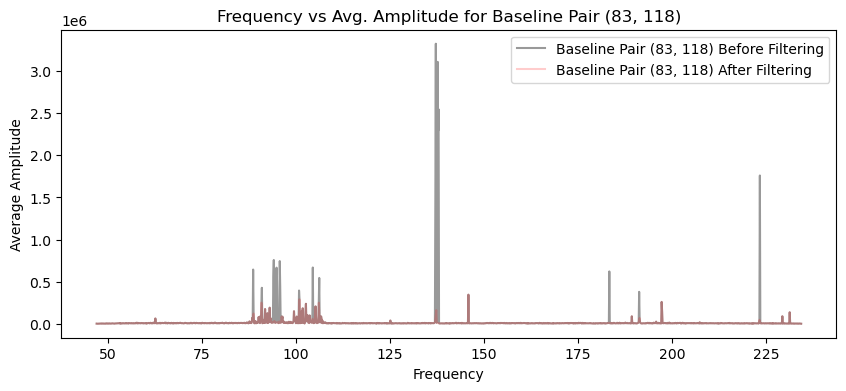

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16694903 -0.17067157 -0.17134005 ... -0.13794294 -0.13920662
 -0.15999437]


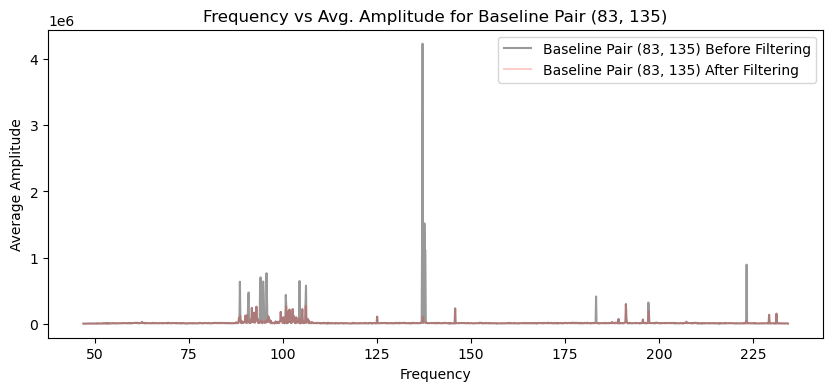

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17615622 -0.1755355  -0.17663823 ... -0.17174353 -0.17350559
 -0.16846391]


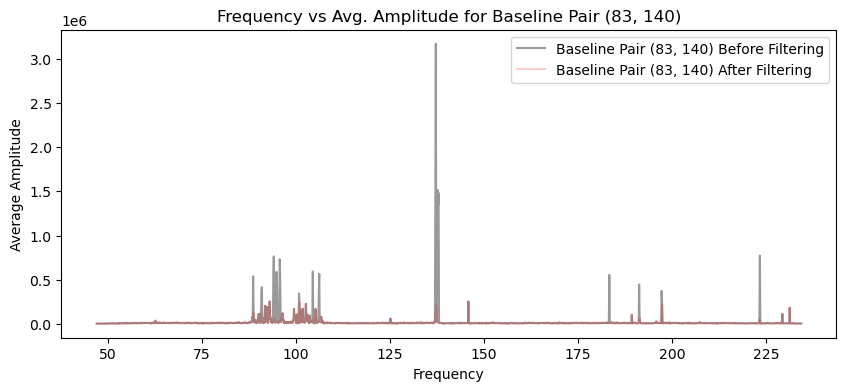

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.19413653 -0.19534229 -0.18878875 ... -0.17062521 -0.15479553
 -0.16107552]


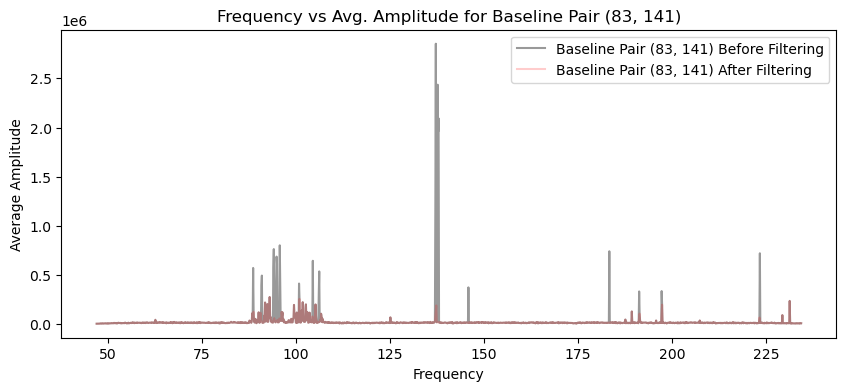

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.19758713 -0.22290111 -0.20286146 ... -0.12258459 -0.15595514
 -0.09721129]


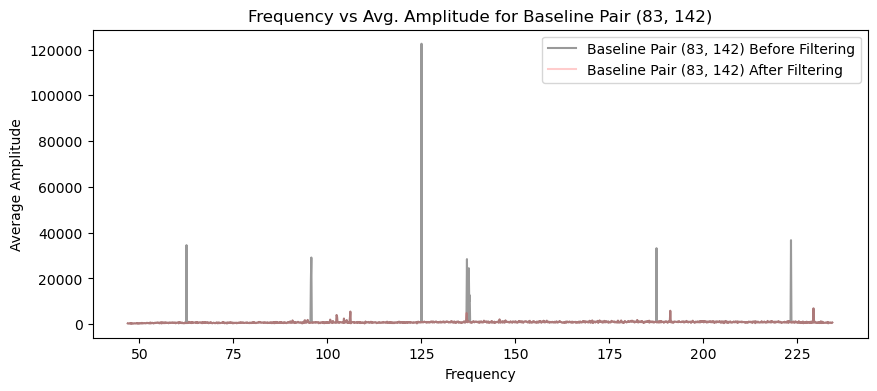

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19418024 -0.18540835 -0.18661268 ... -0.17308    -0.1802978
 -0.16392265]


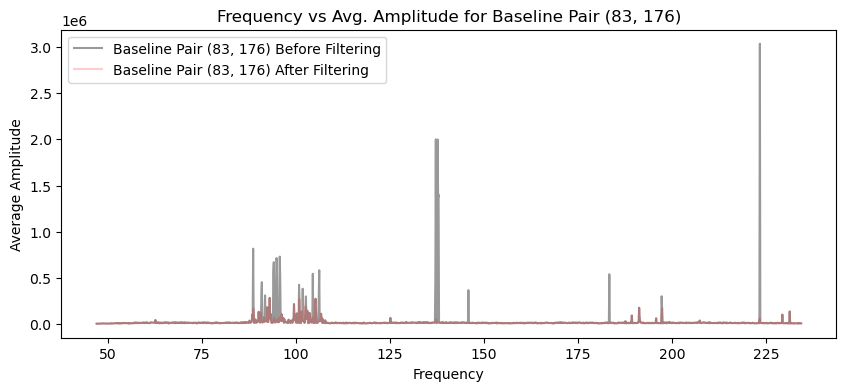

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.15272309 -0.14813729 -0.15702143 ... -0.09073344 -0.08675811
 -0.0391041 ]


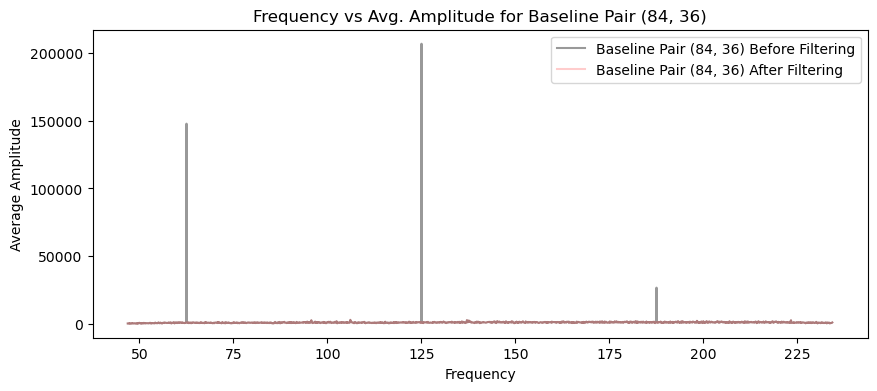

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.17208123 -0.17481934 -0.16469193 ... -0.11352639 -0.058191
 -0.08621887]


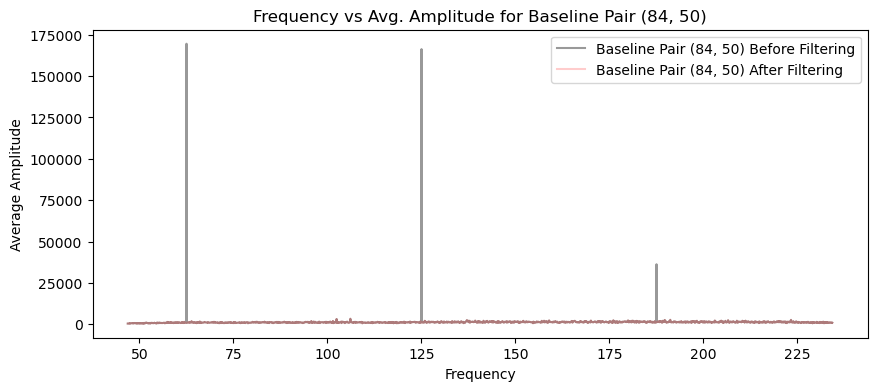

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.24098137 -0.25877356 -0.26333637 ... -0.18917339 -0.12310369
 -0.03155296]


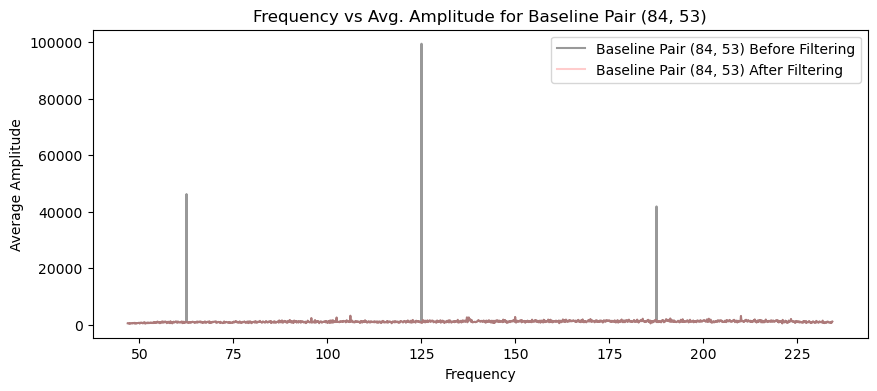

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.09431989 -0.09659337 -0.10275401 ... -0.08858232 -0.10148798
 -0.03189066]


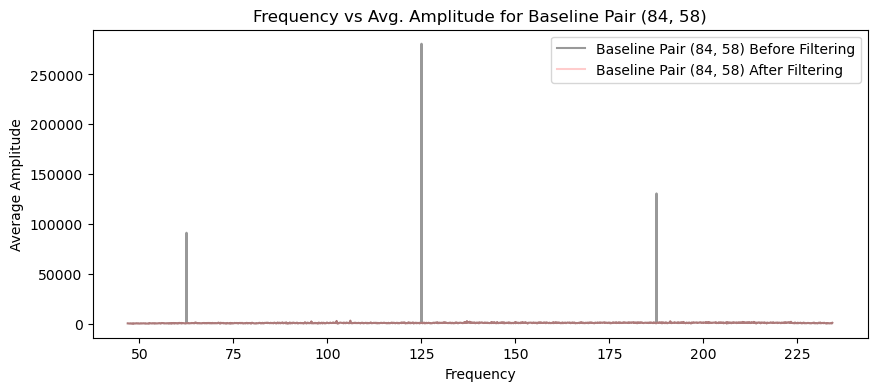

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.1392506  -0.13632348 -0.12443519 ... -0.07666081 -0.04863695
 -0.06851492]


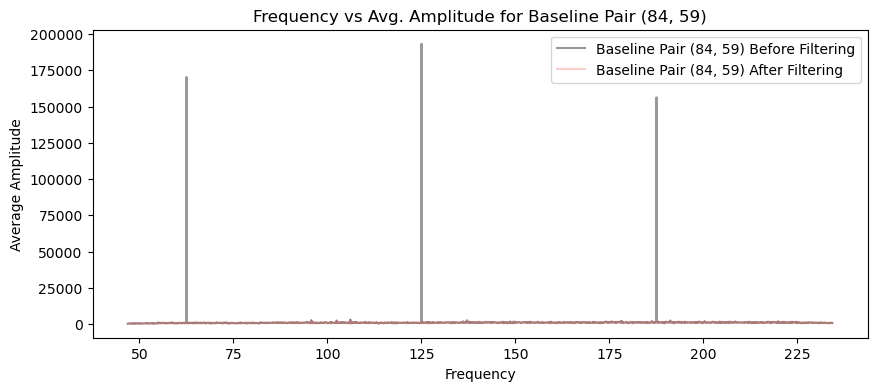

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.06881056 -0.10461633 -0.09451663 ... -0.03086297 -0.04540868
 -0.04513658]


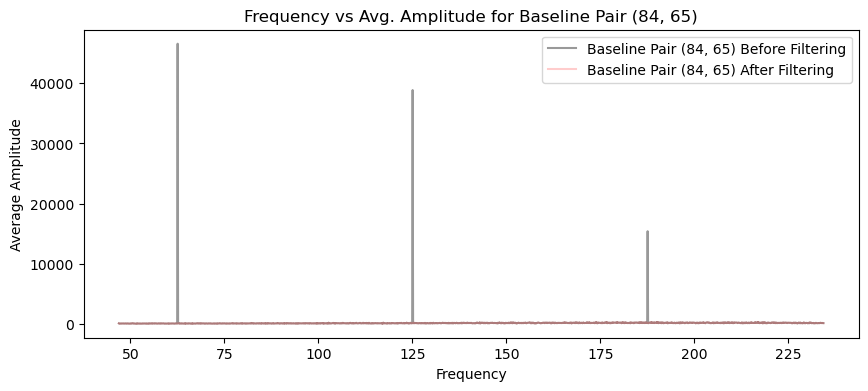

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.33001313 -0.27052901 -0.230188   ... -0.20244959 -0.15880523
 -0.00057791]


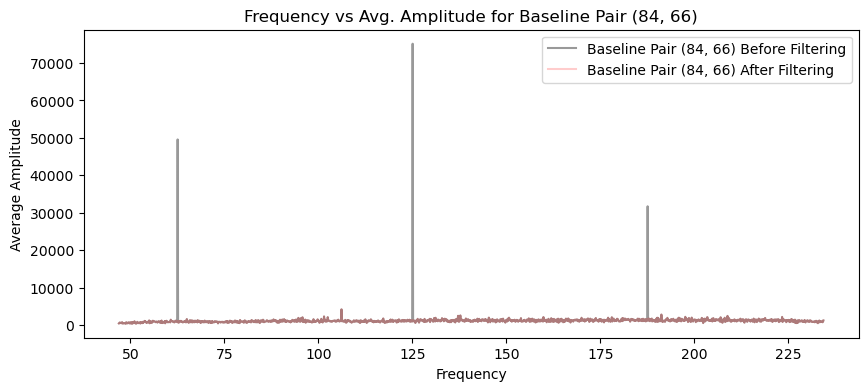

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.20481051 -0.1392133  -0.20425116 ... -0.11768148 -0.1217682
 -0.06693627]


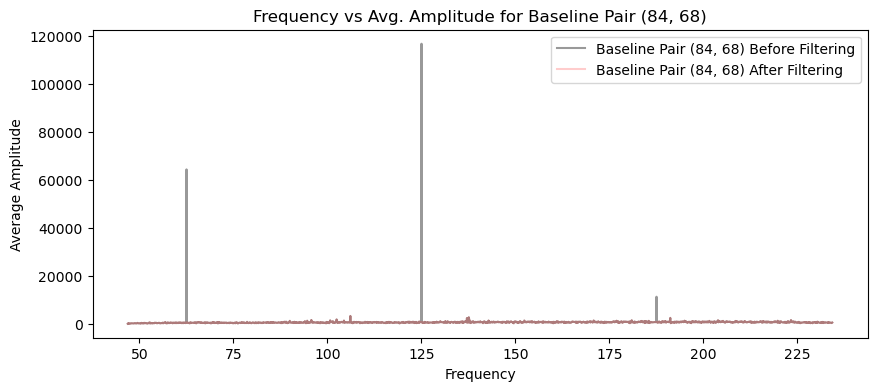

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.10474653 -0.12589684 -0.1219695  ... -0.06932027 -0.08794601
 -0.03078305]


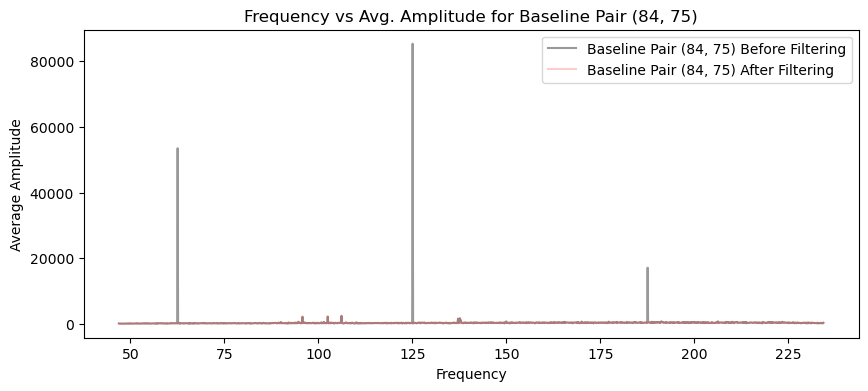

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.11141263 -0.1295739  -0.10573046 ... -0.02409316 -0.03579472
 -0.08380326]


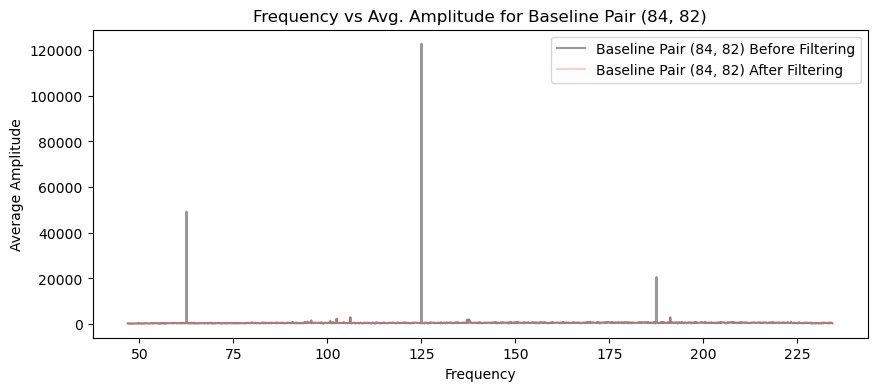

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.47262899 -0.56681227 -0.3016741  ... -0.41212846 -0.27470079
 -0.08378132]


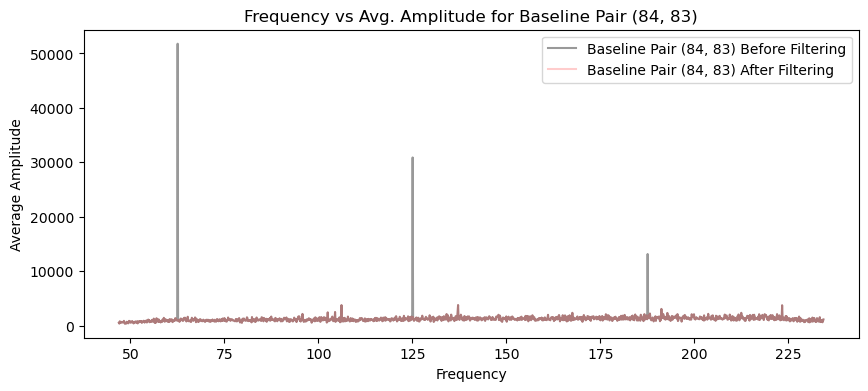

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.17924289 -0.1087684  -0.12588856 ...  0.00549384 -0.07330109
 -0.05604673]


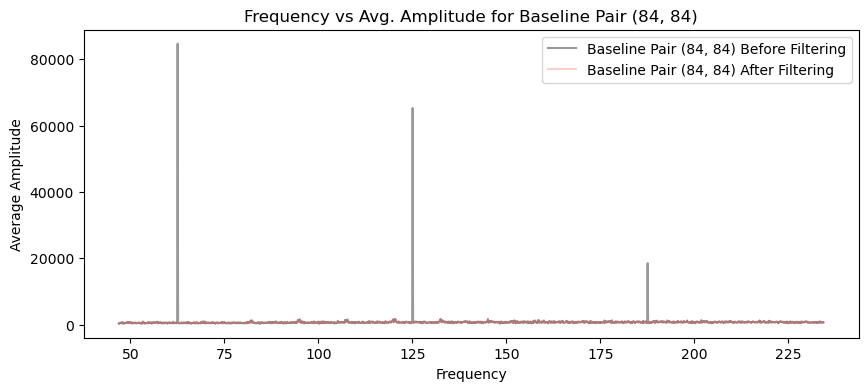

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.20486387 -0.12312786 -0.20579653 ... -0.1382841  -0.11400456
 -0.12714142]


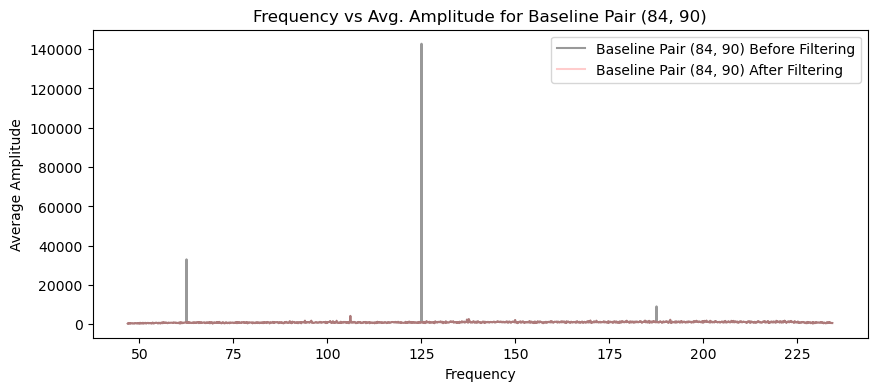

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.23669761 -0.31312837 -0.3452869  ... -0.06743529 -0.05329048
 -0.08893732]


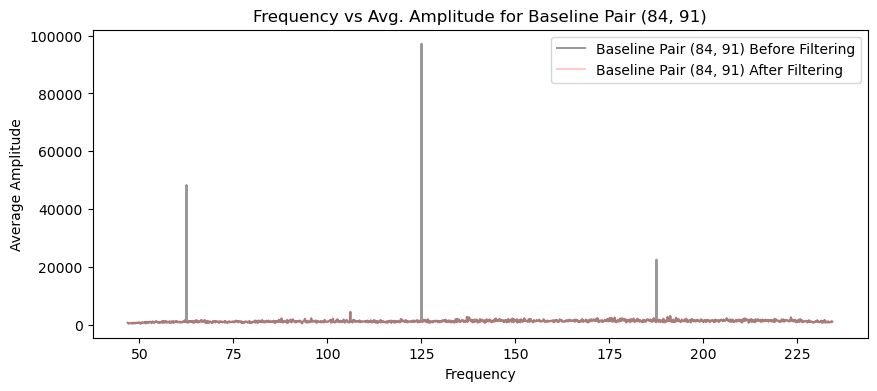

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.06566482 -0.05758471 -0.06362959 ... -0.04657645 -0.02858994
 -0.03463256]


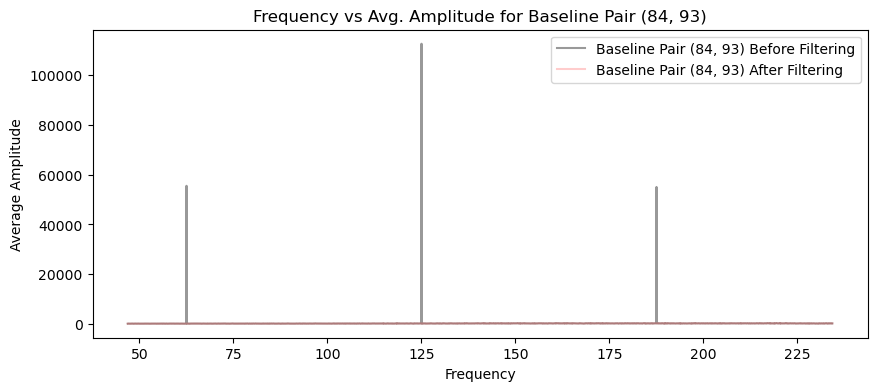

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.19401632 -0.180584   -0.23503786 ... -0.1742038  -0.11876129
 -0.15661855]


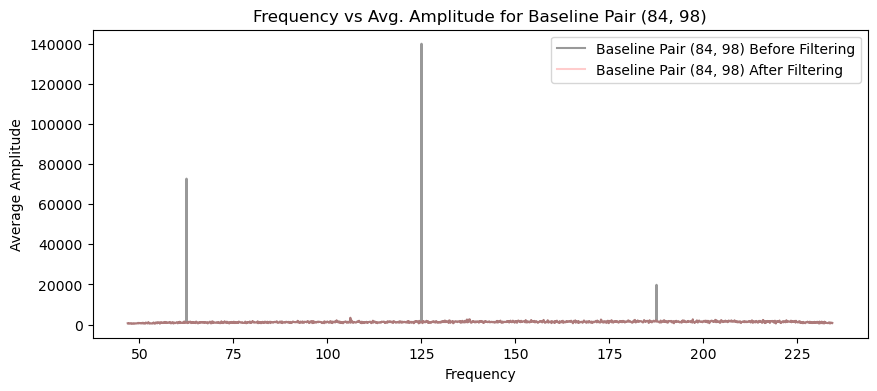

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.32318431 -0.3235429  -0.37534326 ... -0.23200977 -0.3235358
 -0.11820319]


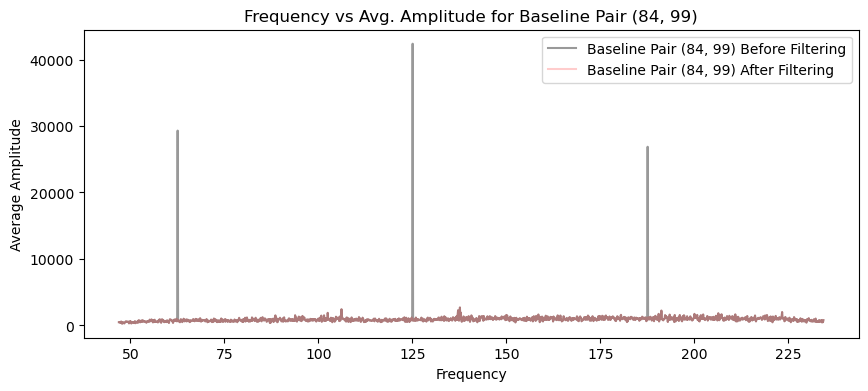

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.20540569 -0.25616761 -0.2436668  ... -0.11342339 -0.02878185
 -0.20984883]


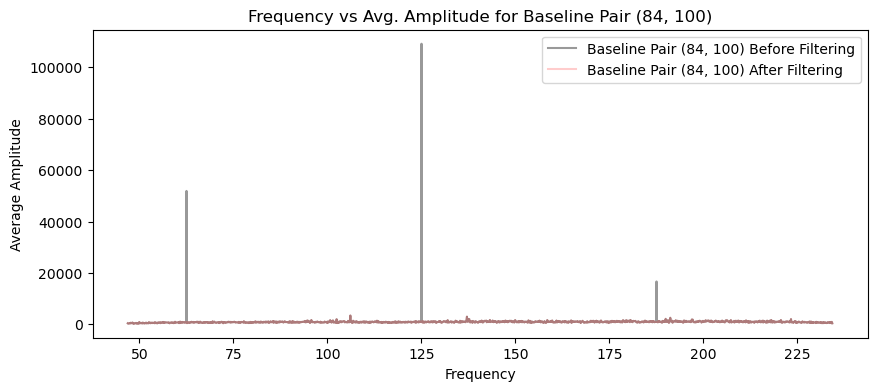

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.46408487 -0.48552137 -0.50155026 ... -0.18673491 -0.20434099
 -0.13690508]


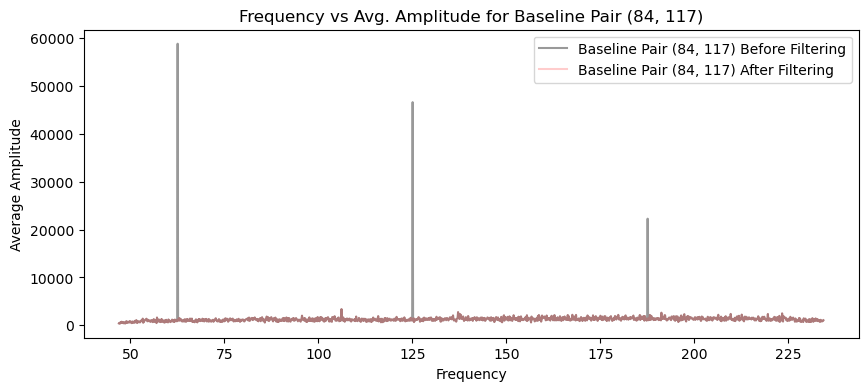

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.23422726 -0.19184942 -0.1986068  ... -0.18370907 -0.08571422
 -0.15754633]


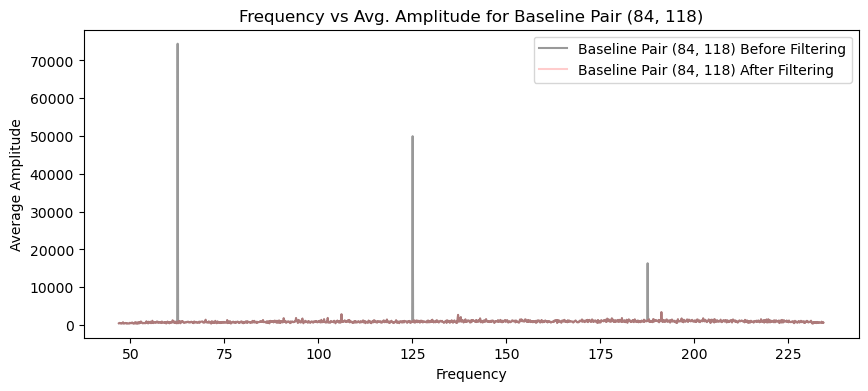

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.37758527 -0.40001174 -0.3964929  ... -0.12012791  0.02616139
 -0.12966638]


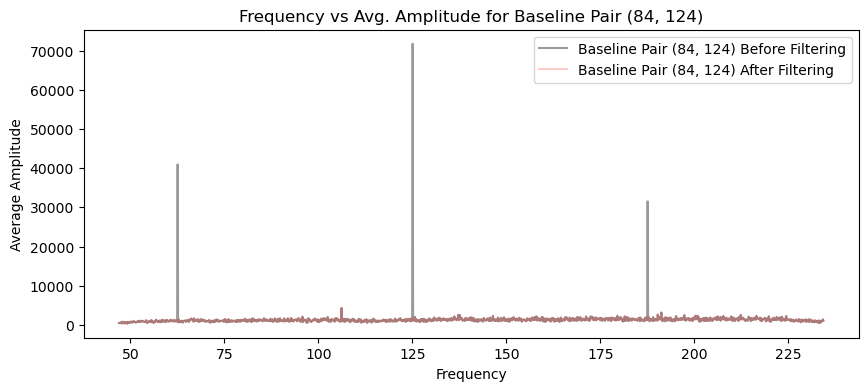

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.17893216 -0.22505021 -0.21801554 ... -0.10789943 -0.09463127
 -0.03162662]


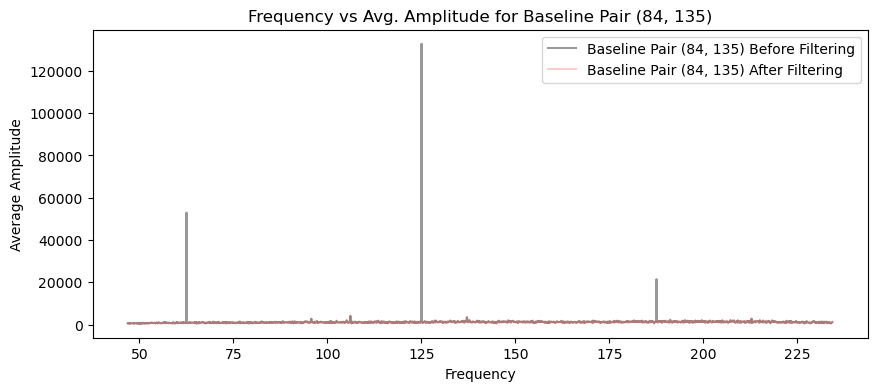

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.29307498 -0.25350788 -0.32113882 ... -0.12308519 -0.16422307
 -0.20548098]


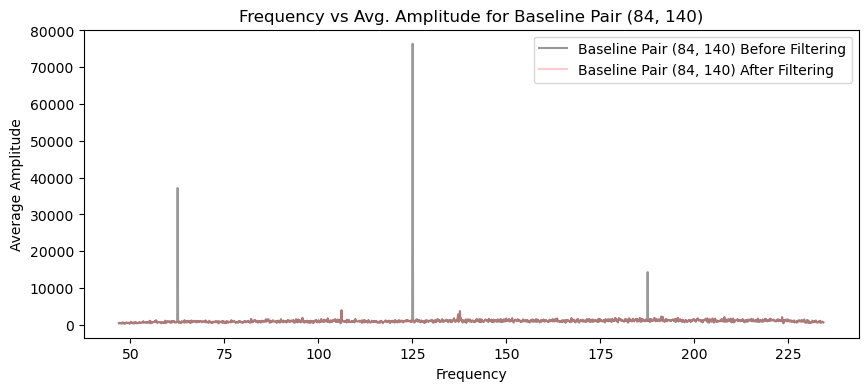

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.32836088 -0.37087593 -0.38854285 ... -0.30933511 -0.16197302
 -0.08236031]


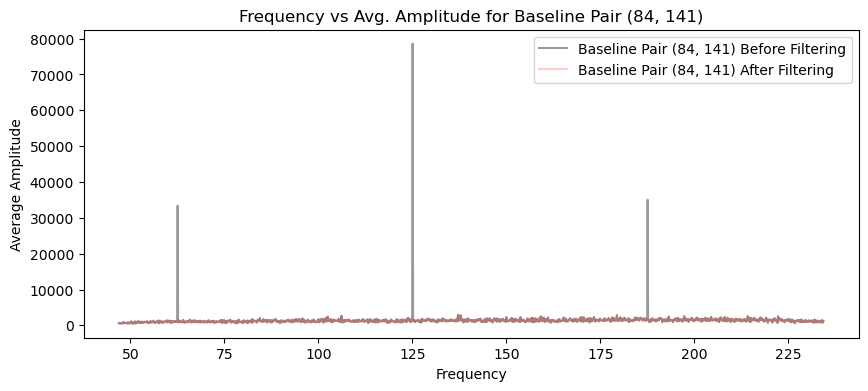

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.05240016 -0.05885144 -0.04685146 ... -0.03495256 -0.01396822
 -0.03053289]


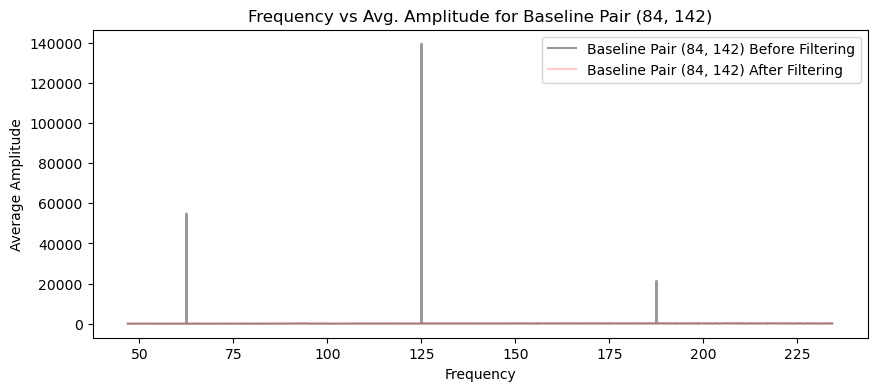

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.44868895 -0.45020585 -0.39677912 ... -0.29778484 -0.31942617
 -0.2943472 ]


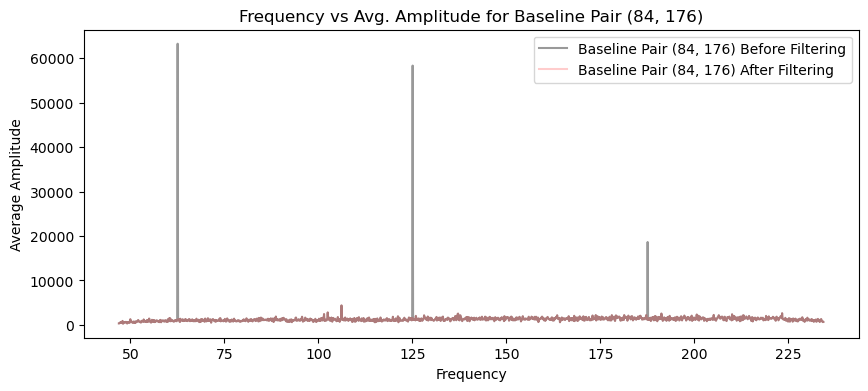

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.18883871 -0.18713009 -0.17489714 ... -0.16333948 -0.16990552
 -0.16441307]


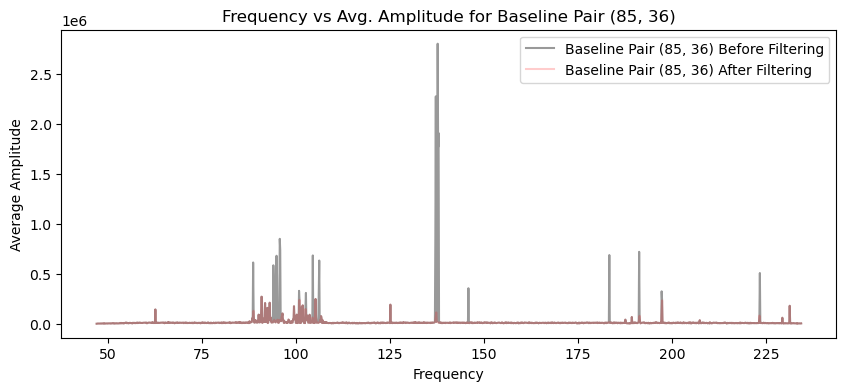

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.18861954 -0.17772619 -0.17370206 ... -0.15269111 -0.16106599
 -0.15328008]


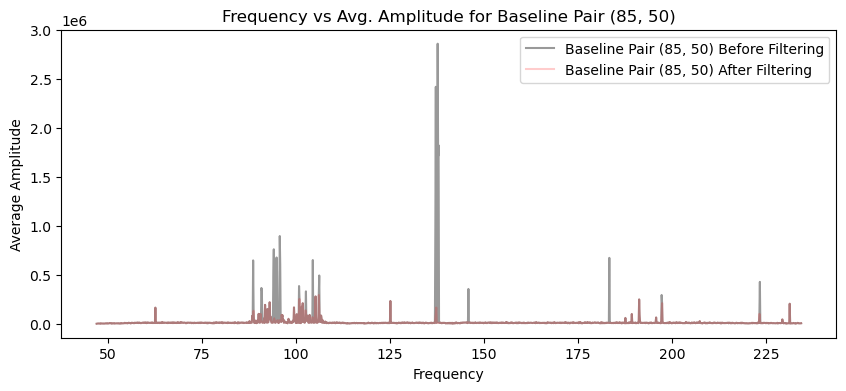

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.18995829 -0.19716641 -0.18481318 ... -0.16122203 -0.18610294
 -0.1705069 ]


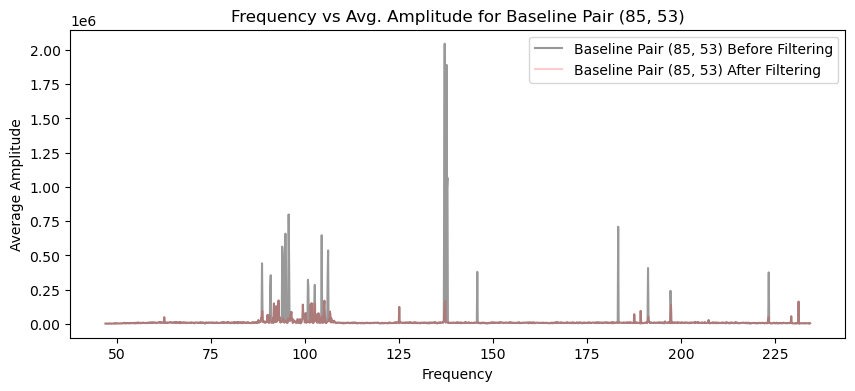

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19146878 -0.17296889 -0.17303562 ... -0.16093415 -0.1652289
 -0.17287463]


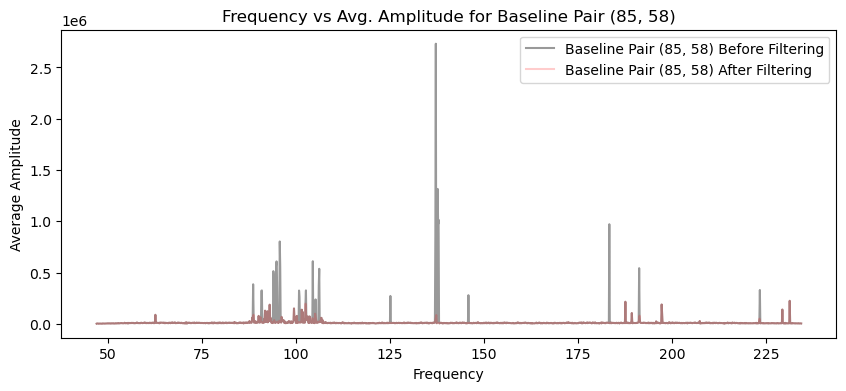

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19564731 -0.19834146 -0.18754155 ... -0.16649576 -0.16610868
 -0.16358372]


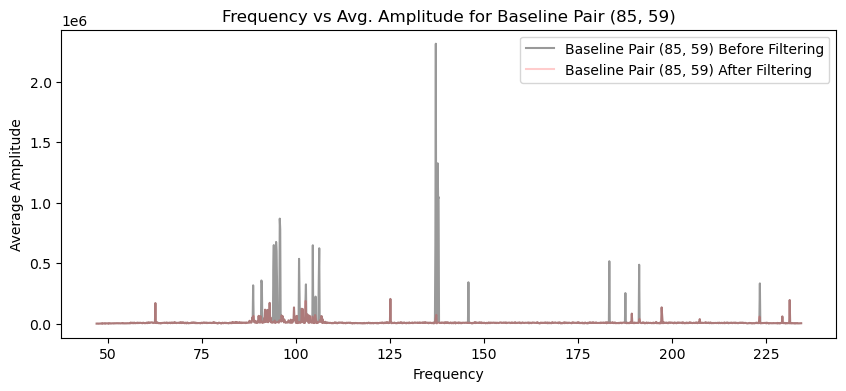

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.14309939 -0.20132893 -0.15382212 ... -0.05960592 -0.0913804
 -0.11650313]


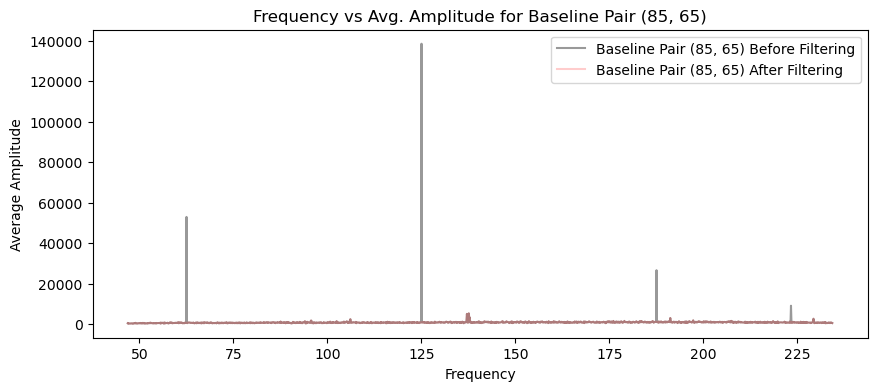

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.13701756 -0.13811248 -0.14132751 ... -0.12145008 -0.13353346
 -0.12596547]


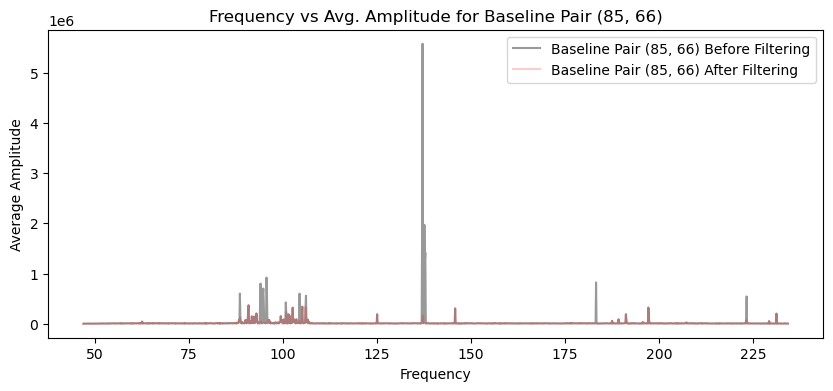

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1406113  -0.13280625 -0.13707965 ... -0.12438212 -0.12535505
 -0.12968071]


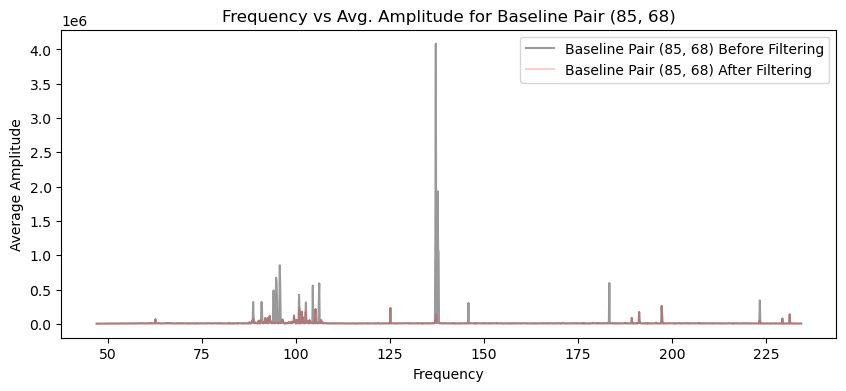

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.12036988 -0.12477523 -0.1229592  ... -0.10512831 -0.09809905
 -0.1086416 ]


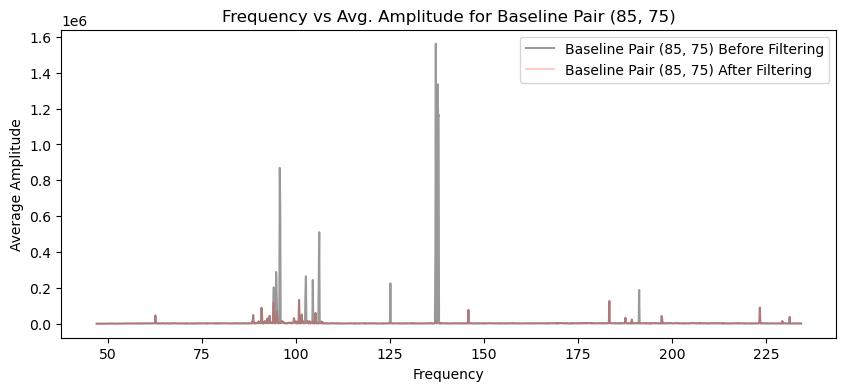

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.1243272  -0.12435341 -0.12298212 ... -0.11473448 -0.11549942
 -0.11293224]


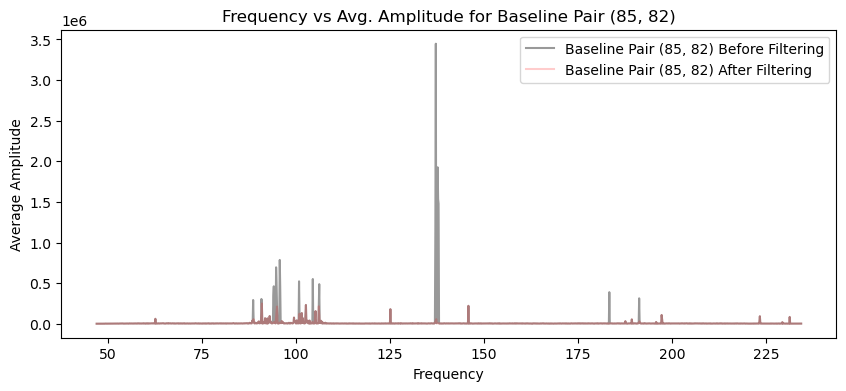

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17904248 -0.17297352 -0.17376092 ... -0.15526539 -0.16917017
 -0.15408936]


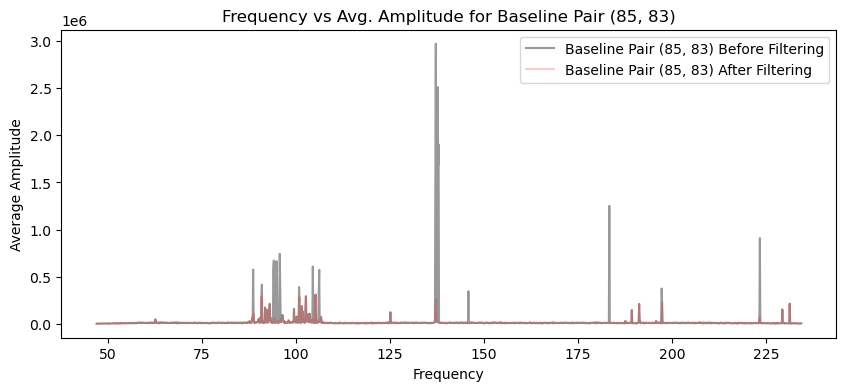

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.14813617 -0.19068008 -0.12296098 ... -0.10326856 -0.11072165
 -0.12461551]


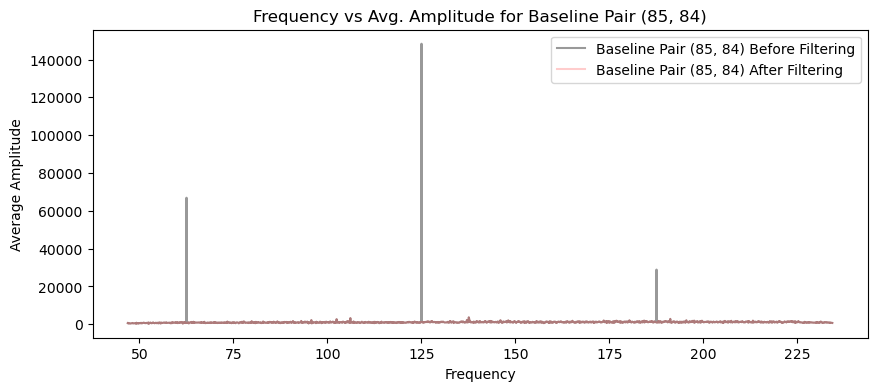

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.2443084  -0.24345992 -0.23851868 ... -0.23321231 -0.23662139
 -0.21902395]


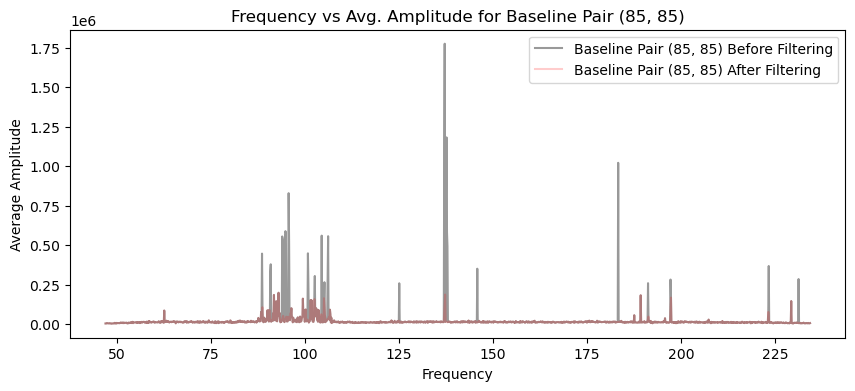

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1613815  -0.15754996 -0.16342654 ... -0.14665945 -0.14228604
 -0.13916715]


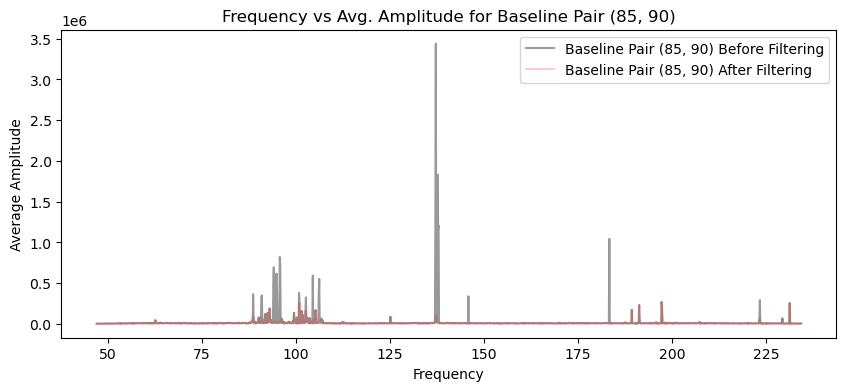

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15779431 -0.16607917 -0.16184996 ... -0.15773263 -0.13703694
 -0.14653458]


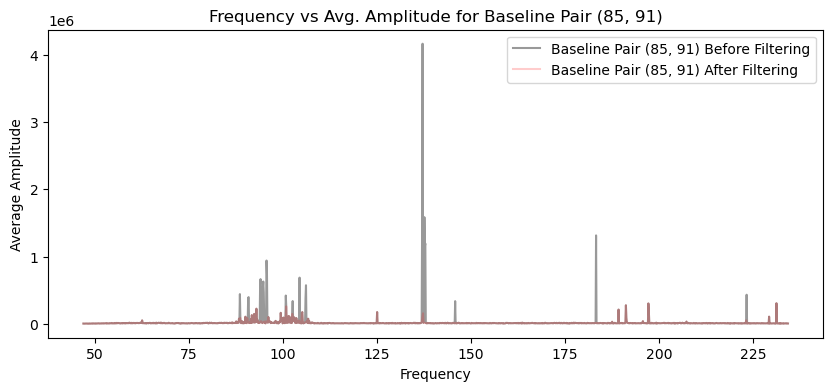

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.14203361 -0.12510989 -0.15975697 ... -0.11043237 -0.08819066
 -0.12467427]


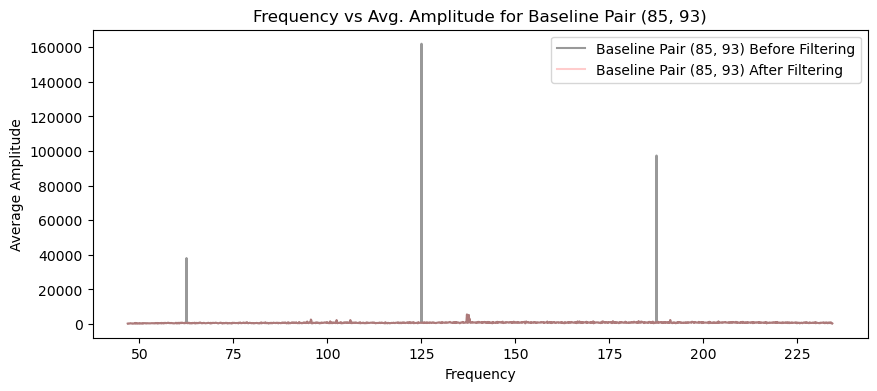

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.18043733 -0.17736664 -0.17277552 ... -0.15108501 -0.14181797
 -0.14689445]


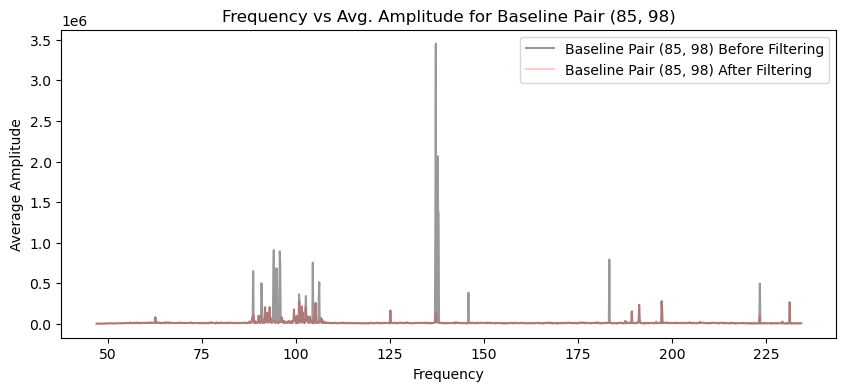

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15204427 -0.15391645 -0.1466358  ... -0.1508148  -0.13753535
 -0.1443499 ]


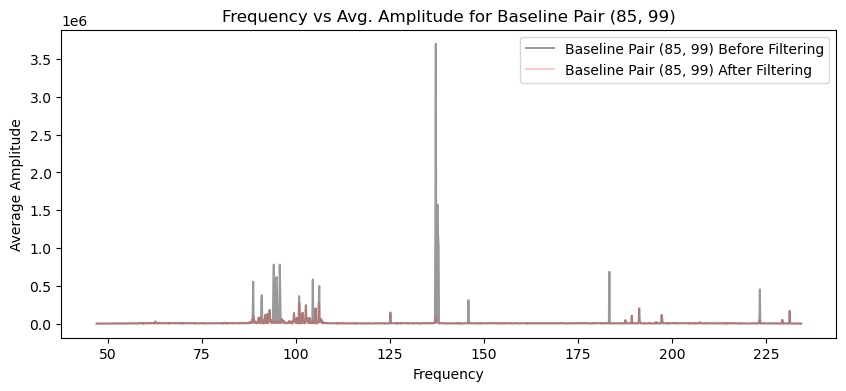

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19253058 -0.18484357 -0.18183655 ... -0.15523605 -0.17564715
 -0.16468903]


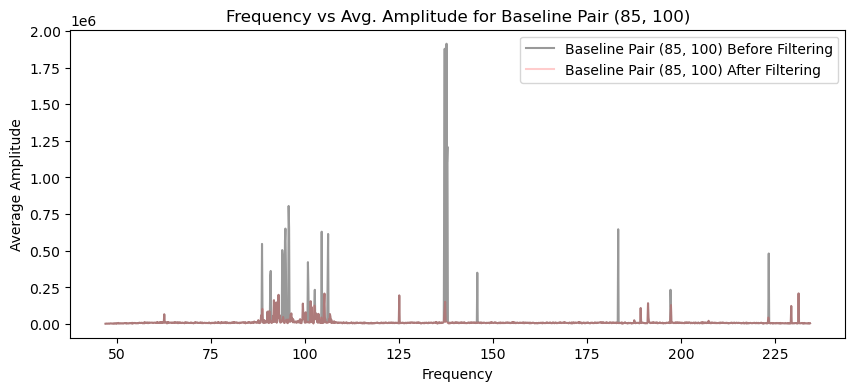

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15577722 -0.15438966 -0.15530649 ... -0.13837174 -0.14543843
 -0.14451612]


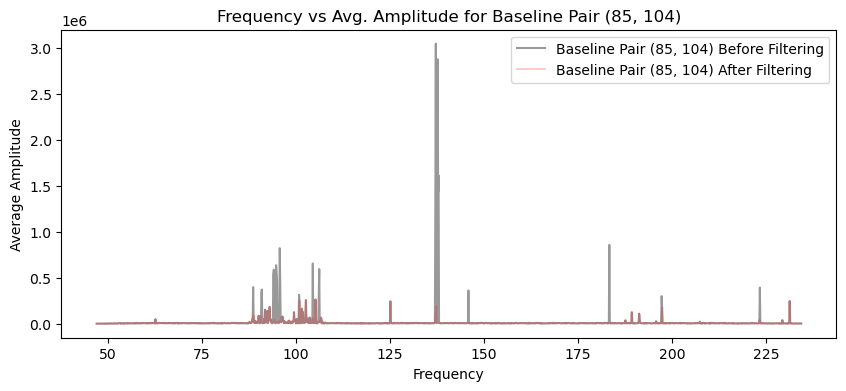

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16807621 -0.16314958 -0.16953799 ... -0.14225075 -0.15118882
 -0.15817608]


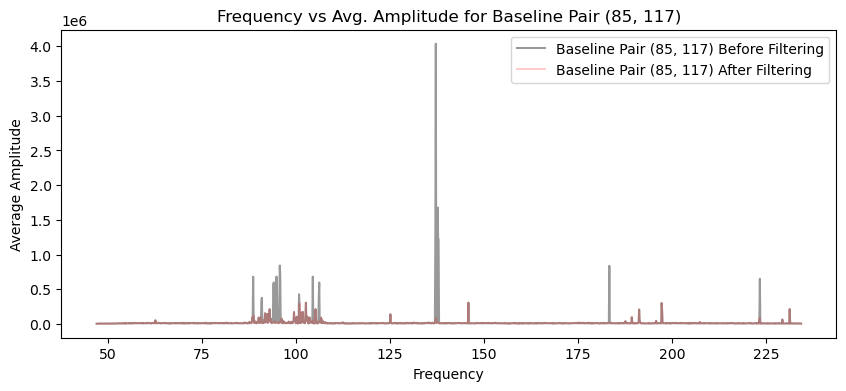

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.17571044 -0.18180323 -0.17043265 ... -0.16540048 -0.14499946
 -0.17634455]


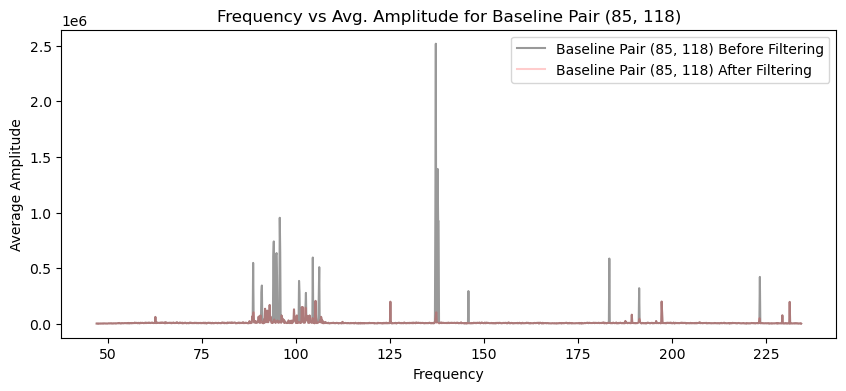

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15750627 -0.15470971 -0.15542349 ... -0.14282683 -0.14731119
 -0.14573077]


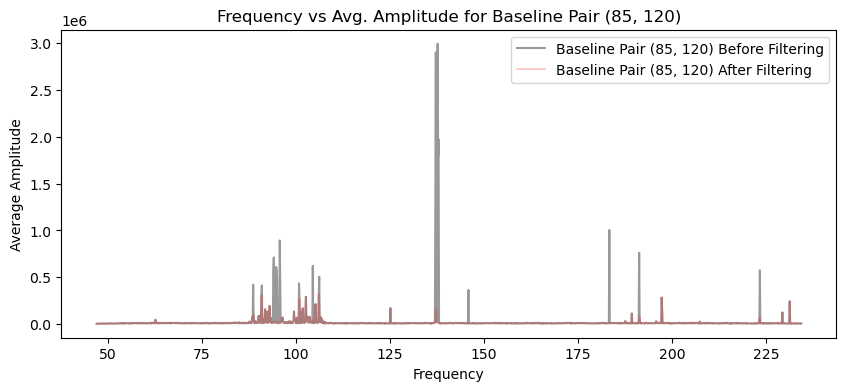

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15208187 -0.15547638 -0.16421239 ... -0.156271   -0.15314139
 -0.14771583]


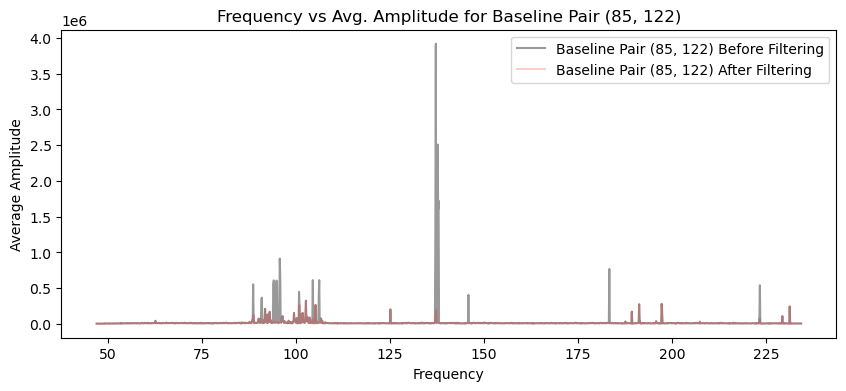

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.15060376 -0.14962653 -0.14926878 ... -0.14633748 -0.14229909
 -0.13956309]


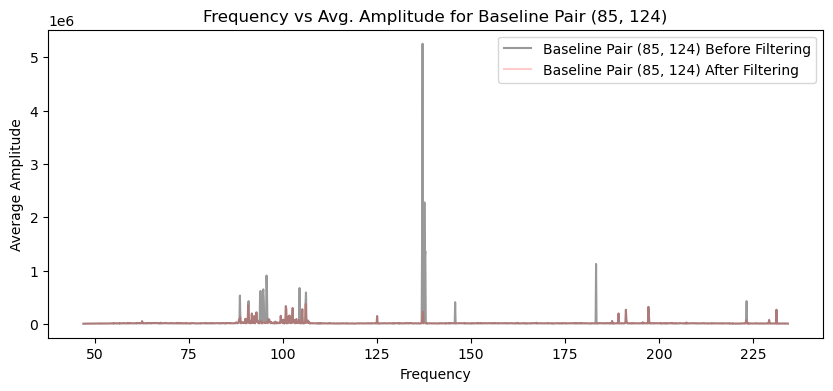

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.18376179 -0.18566468 -0.18352863 ... -0.14687021 -0.15536751
 -0.15274558]


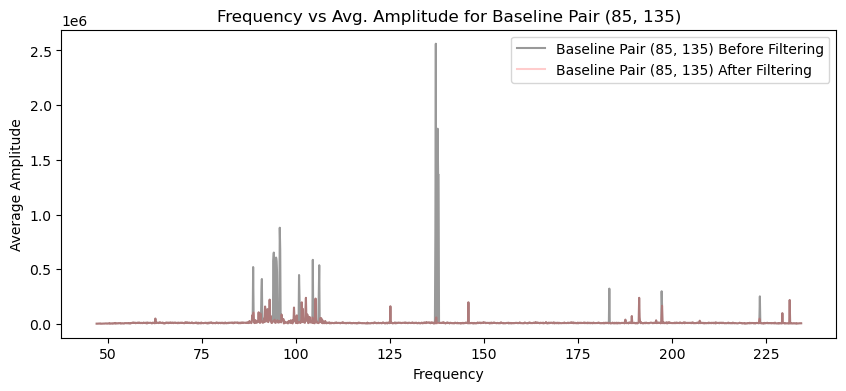

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.1410872  -0.14190979 -0.13980787 ... -0.12975875 -0.13467526
 -0.1358258 ]


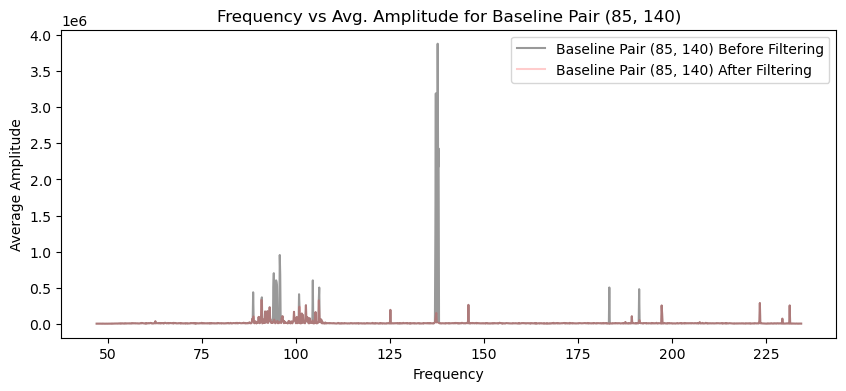

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.18003769 -0.18208835 -0.19202889 ... -0.14032561 -0.16721744
 -0.18148514]


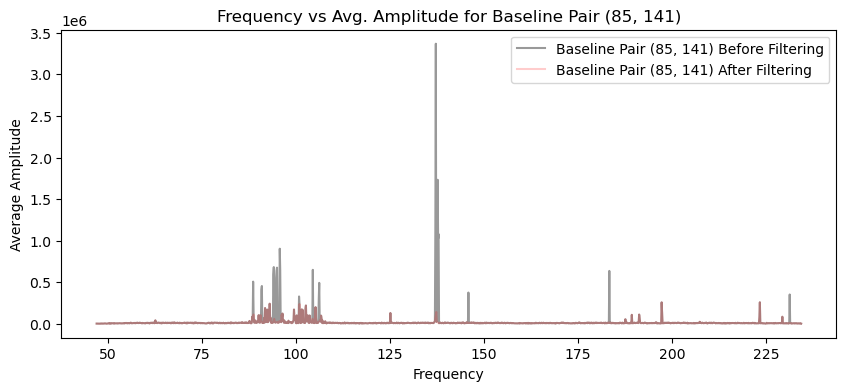

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.15278716 -0.11801503 -0.13871153 ... -0.09732282 -0.08437656
 -0.07688081]


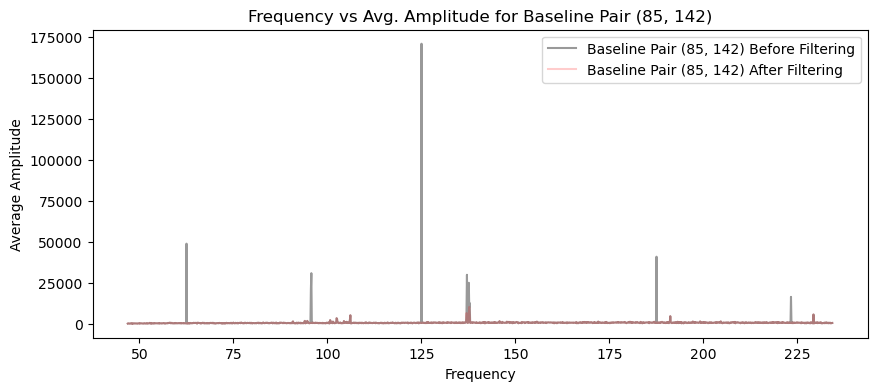

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.21862738 -0.20466084 -0.21898515 ... -0.19623317 -0.20078266
 -0.1778283 ]


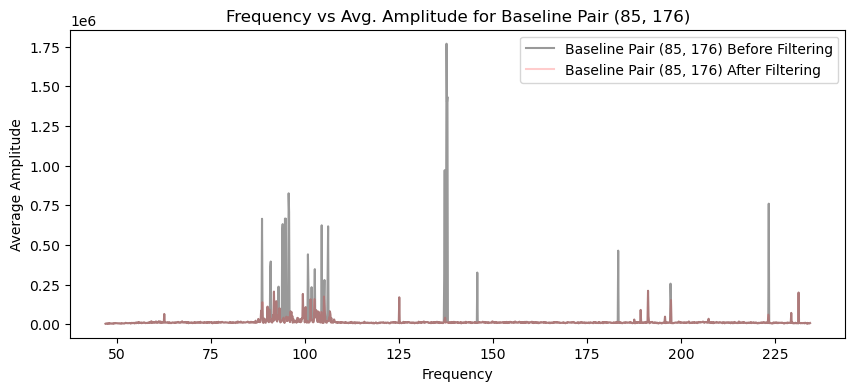

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.1469371  -0.14645352 -0.14108218 ... -0.13969806 -0.12347575
 -0.1319063 ]


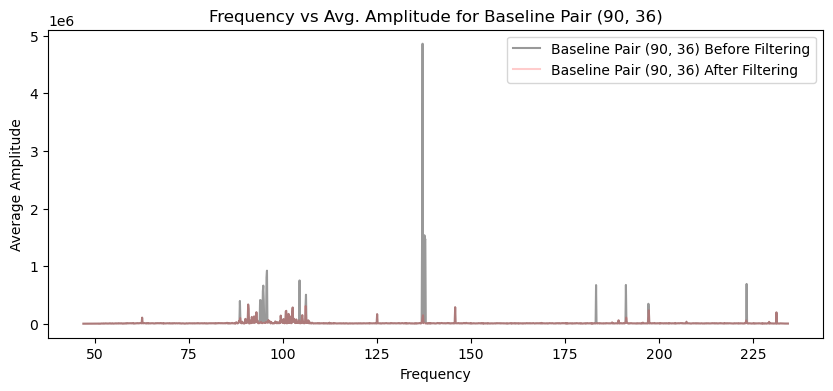

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15743901 -0.16163972 -0.16587893 ... -0.12284731 -0.14532755
 -0.14552632]


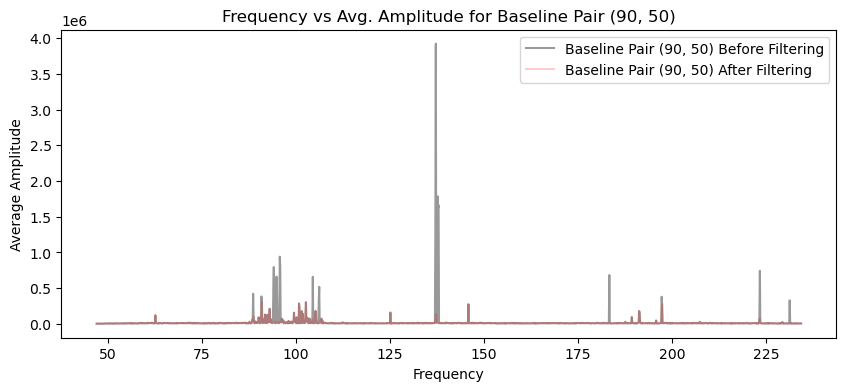

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14141103 -0.13282763 -0.13662115 ... -0.11431981 -0.12649696
 -0.12685814]


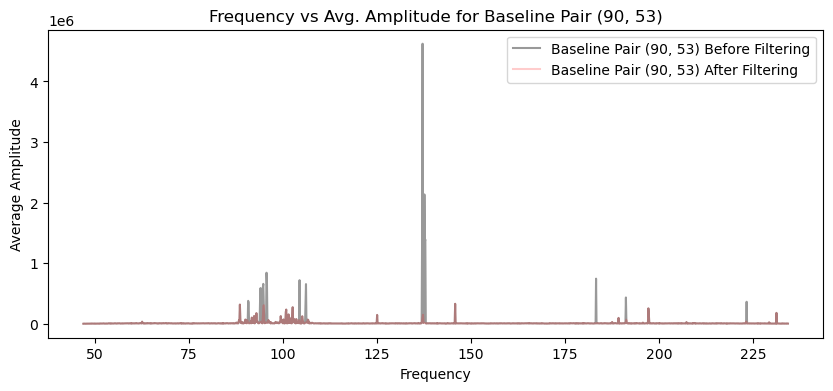

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17236812 -0.18250057 -0.17761466 ... -0.17102095 -0.13915927
 -0.15171404]


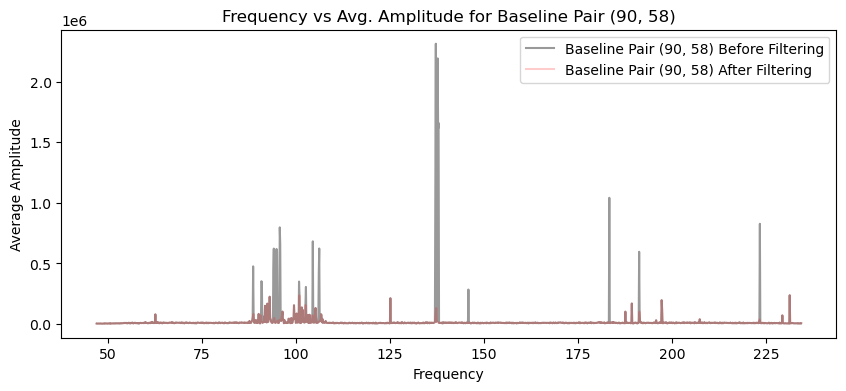

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16570957 -0.15749756 -0.15805179 ... -0.1578858  -0.14122741
 -0.15031535]


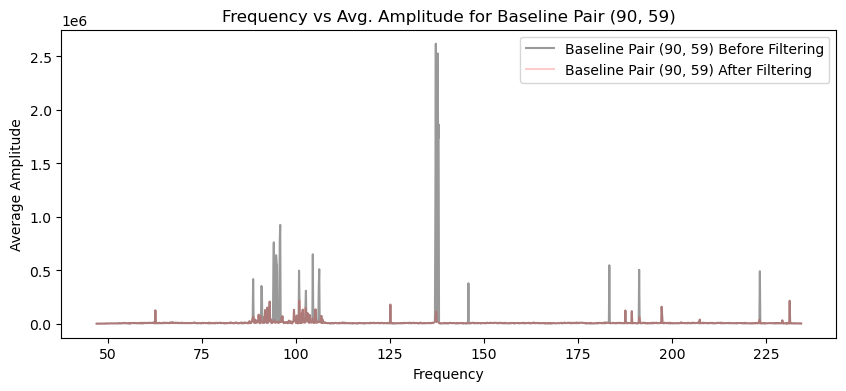

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.16411516 -0.16658187 -0.23633352 ... -0.11399526 -0.13406489
 -0.16861374]


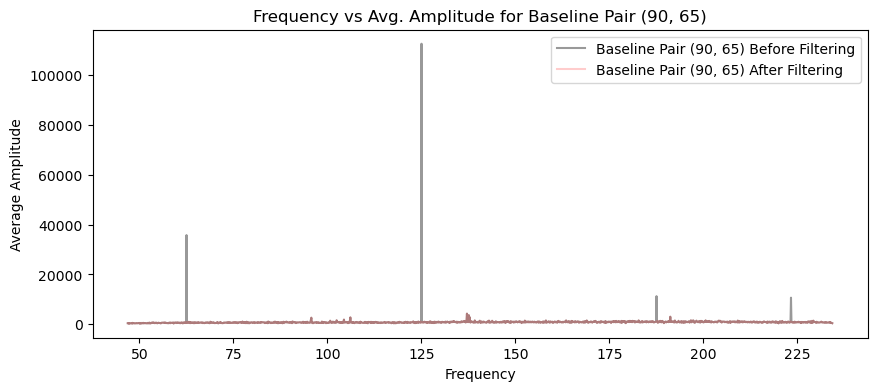

freqs shape: (1536,)
freqs_filtered shape: (1521,)
amplitudes_filtered shape: (20, 1521)
Threshold for baseline: [-0.12632634 -0.12736557 -0.12409127 ... -0.11677012 -0.11188806
 -0.11171231]


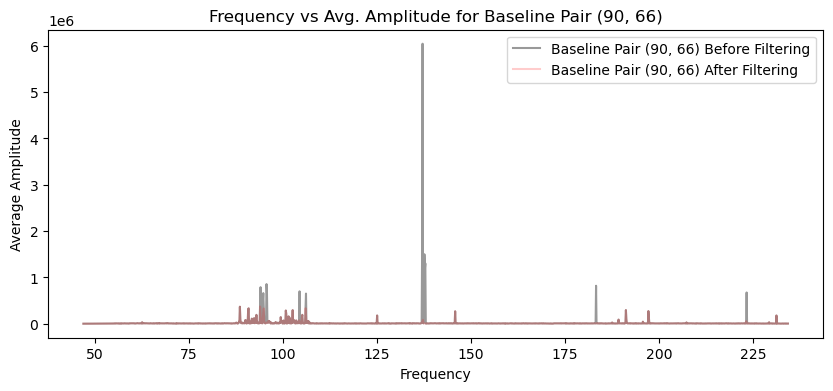

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.1442526  -0.13665827 -0.13235891 ... -0.11510094 -0.12733507
 -0.127604  ]


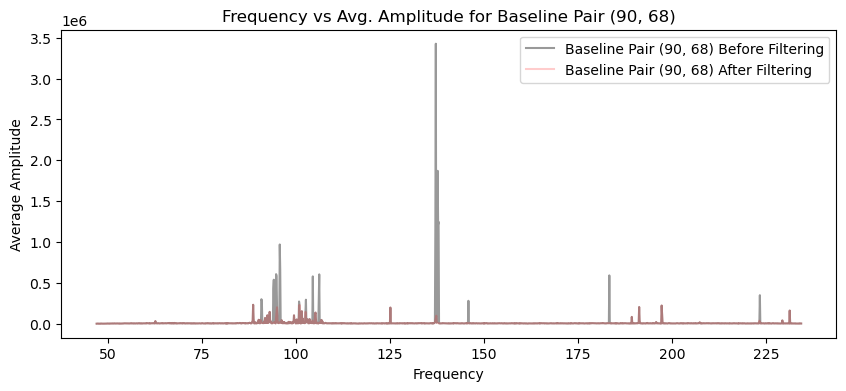

freqs shape: (1536,)
freqs_filtered shape: (1521,)
amplitudes_filtered shape: (20, 1521)
Threshold for baseline: [-0.10971382 -0.10782246 -0.10779886 ... -0.09861641 -0.09715633
 -0.10111375]


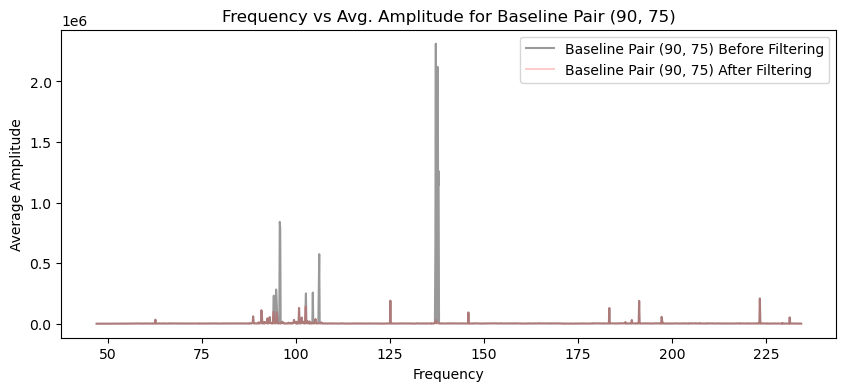

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.11183043 -0.11519014 -0.11351754 ... -0.1097092  -0.09935582
 -0.11427719]


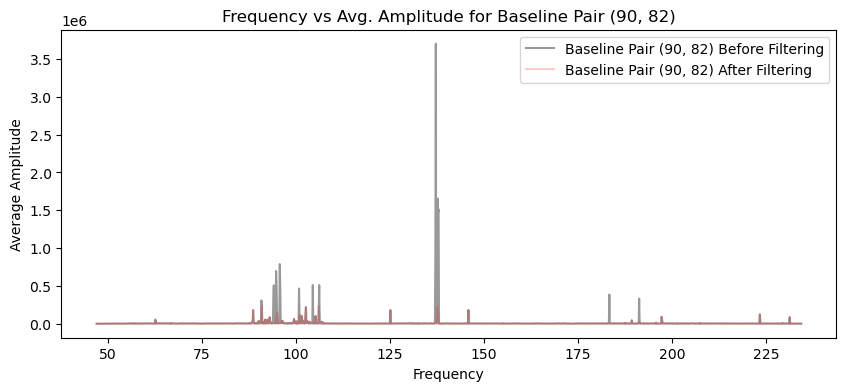

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.1448178  -0.13821475 -0.14244865 ... -0.11932945 -0.13383734
 -0.13246021]


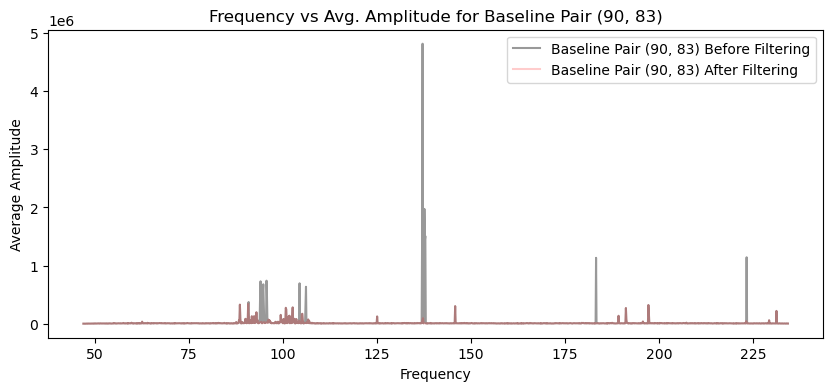

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.25076012 -0.21623012 -0.22815385 ... -0.19809235 -0.2104853
 -0.22692509]


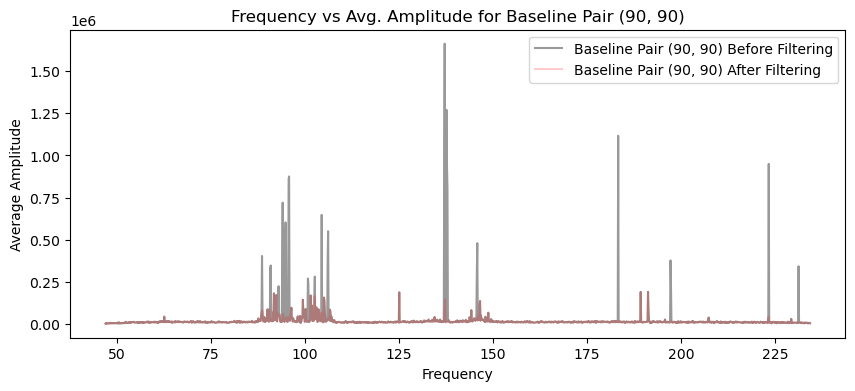

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.1344264  -0.13704877 -0.13253207 ... -0.13243753 -0.11869691
 -0.12157815]


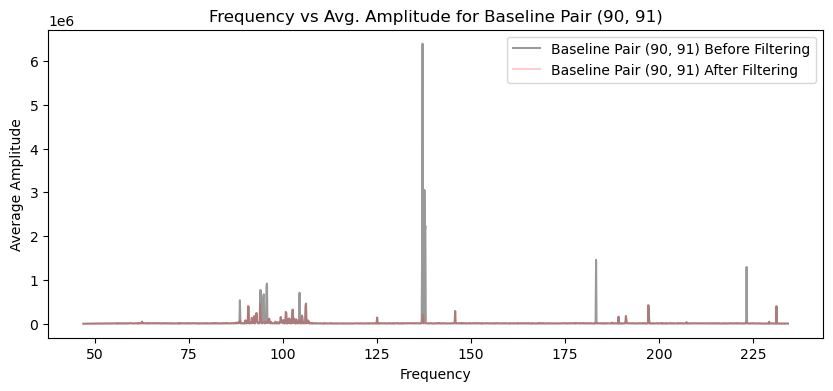

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.11893219 -0.16511084 -0.16343883 ... -0.04266822 -0.03639137
 -0.11134247]


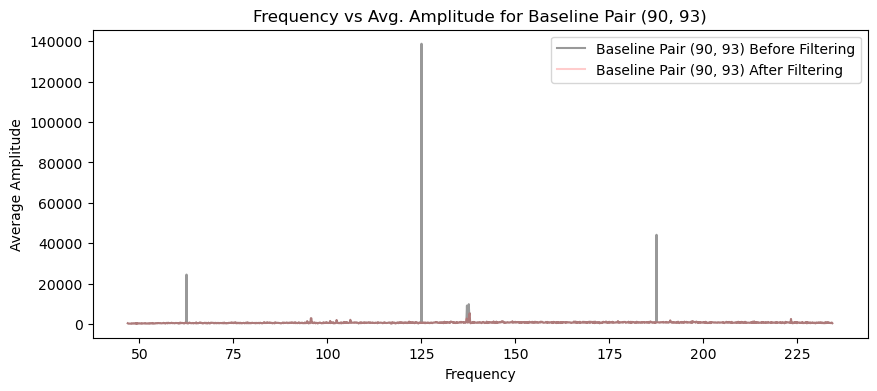

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18904651 -0.18860032 -0.18690264 ... -0.14998858 -0.16543704
 -0.15927491]


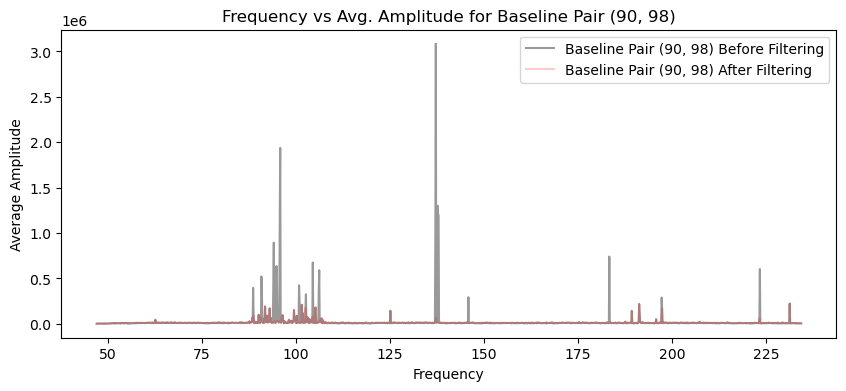

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.14349116 -0.13198898 -0.14240497 ... -0.12425692 -0.12639332
 -0.12848371]


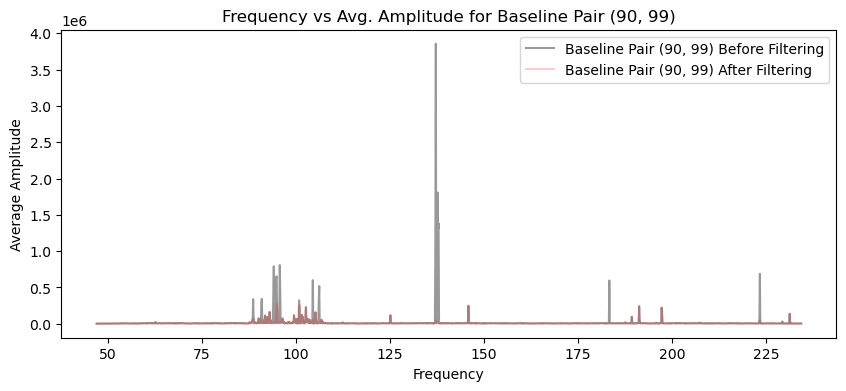

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15774411 -0.16239542 -0.16364255 ... -0.12433719 -0.15230994
 -0.13231284]


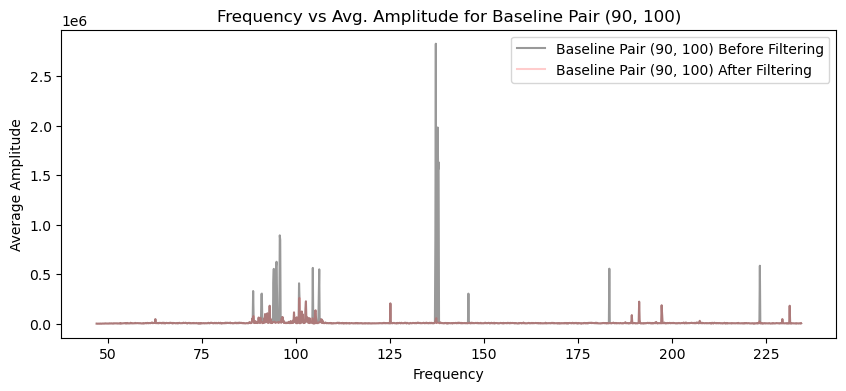

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19417011 -0.19007492 -0.18660049 ... -0.16277541 -0.16269703
 -0.17049039]


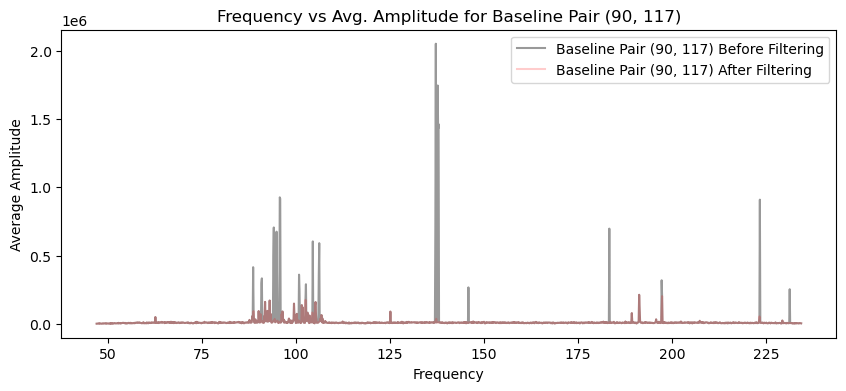

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.17985824 -0.17384555 -0.1839819  ... -0.16947247 -0.1570775
 -0.1684545 ]


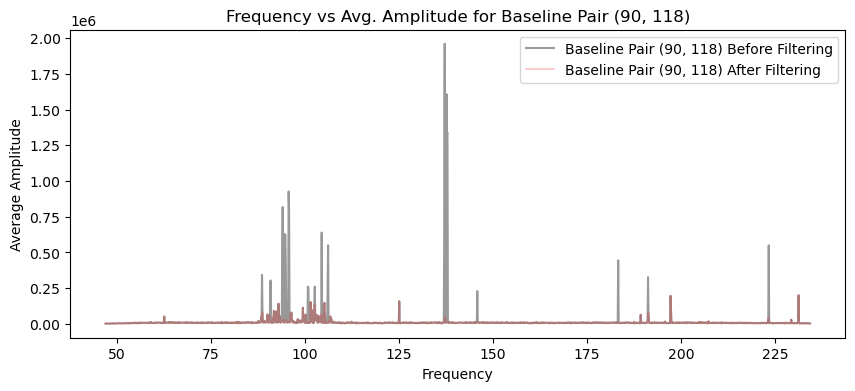

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18404151 -0.18209569 -0.18948365 ... -0.16674132 -0.14796882
 -0.15424629]


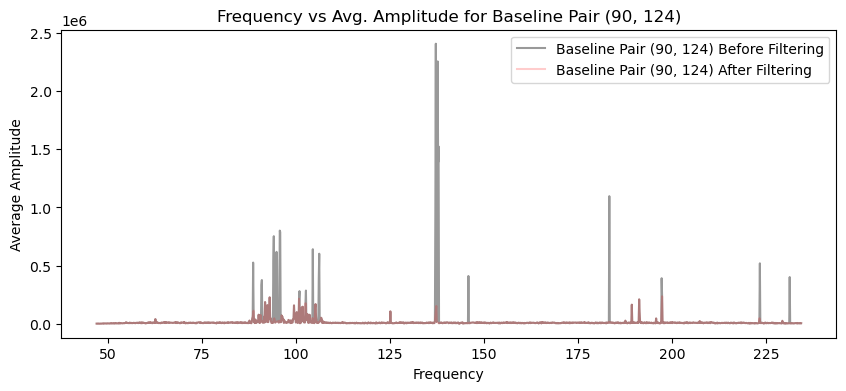

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.21356893 -0.21843049 -0.21754435 ... -0.17253308 -0.18877702
 -0.19552832]


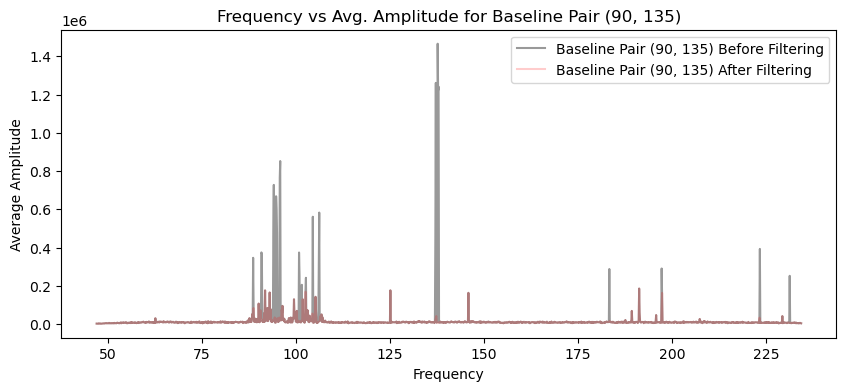

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.18493384 -0.18627186 -0.19073509 ... -0.18016579 -0.18161086
 -0.14652759]


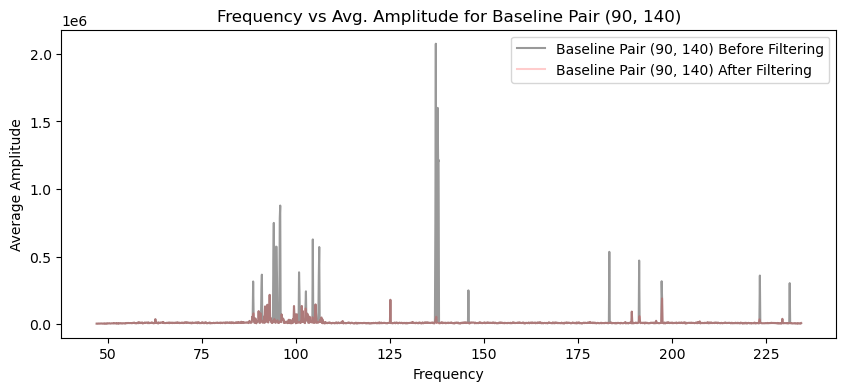

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.19205288 -0.19919995 -0.18351755 ... -0.16952599 -0.17651491
 -0.17753826]


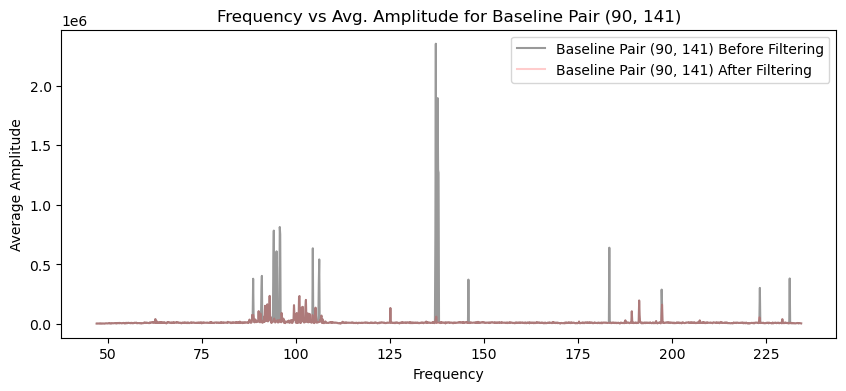

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.12092582 -0.13410495 -0.13282397 ... -0.03614624 -0.06639393
 -0.07889625]


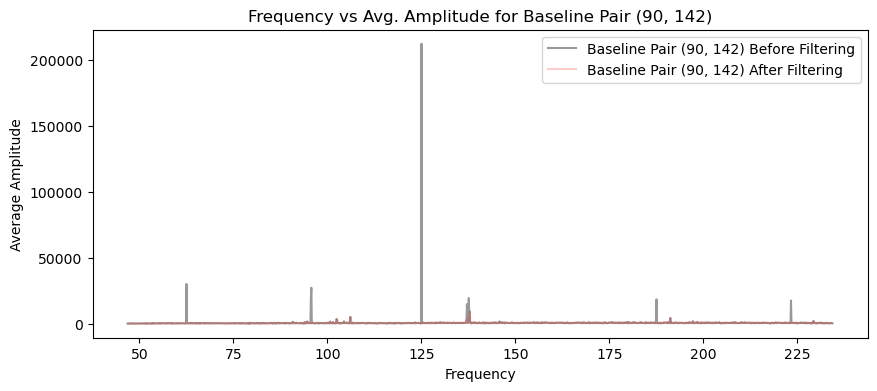

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.20583919 -0.21719829 -0.22096875 ... -0.20782143 -0.19095717
 -0.19818045]


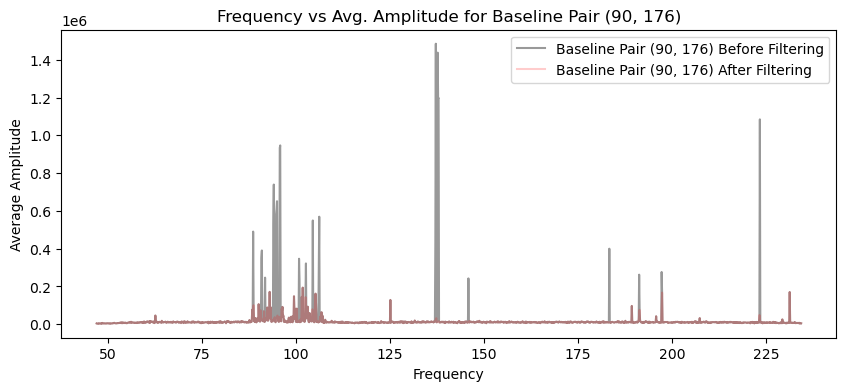

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14511757 -0.14287107 -0.13568836 ... -0.12958762 -0.1245851
 -0.12125483]


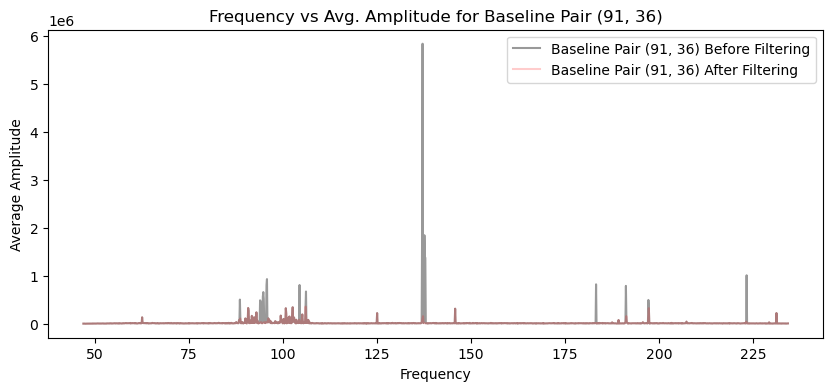

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1637529  -0.16621694 -0.16982734 ... -0.14908795 -0.15480439
 -0.13439235]


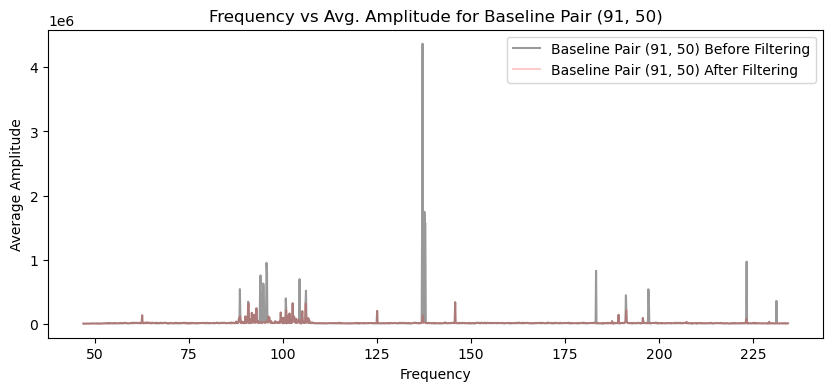

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14879972 -0.14206973 -0.14213934 ... -0.1416659  -0.13937794
 -0.12614951]


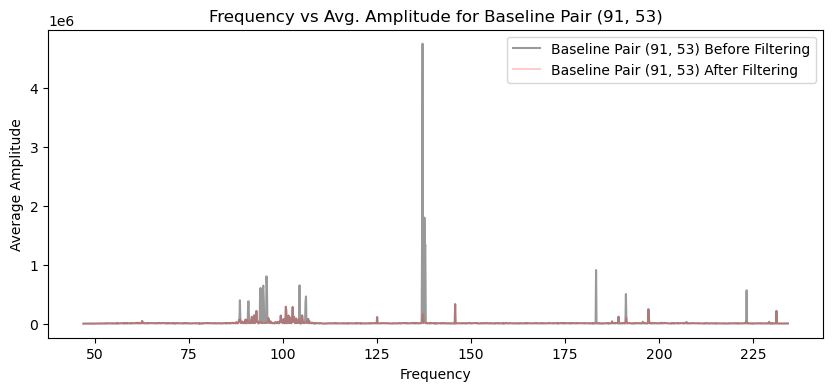

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.20132655 -0.19805042 -0.192136   ... -0.15136333 -0.16542299
 -0.17297583]


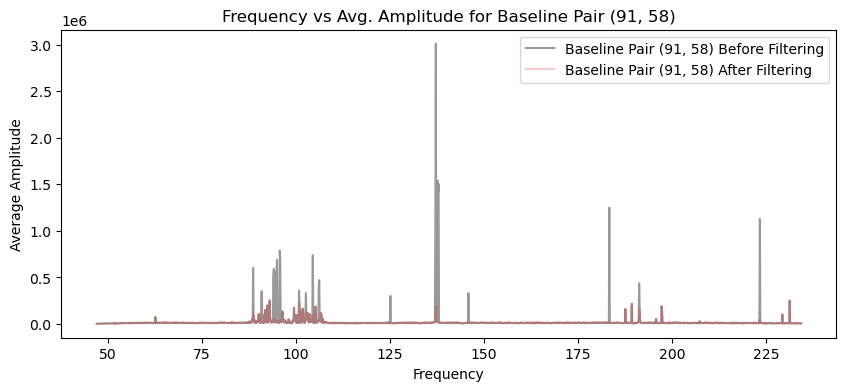

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.21054976 -0.1994564  -0.19880644 ... -0.18012786 -0.17565305
 -0.18818526]


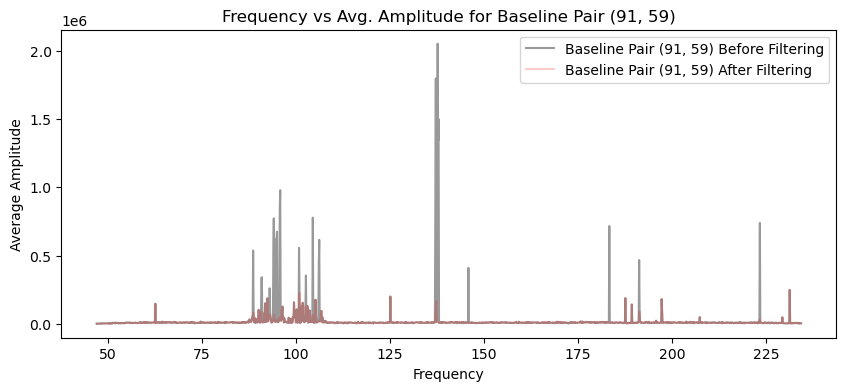

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.31378212 -0.26869361 -0.20262132 ... -0.09027939  0.0071036
 -0.06461792]


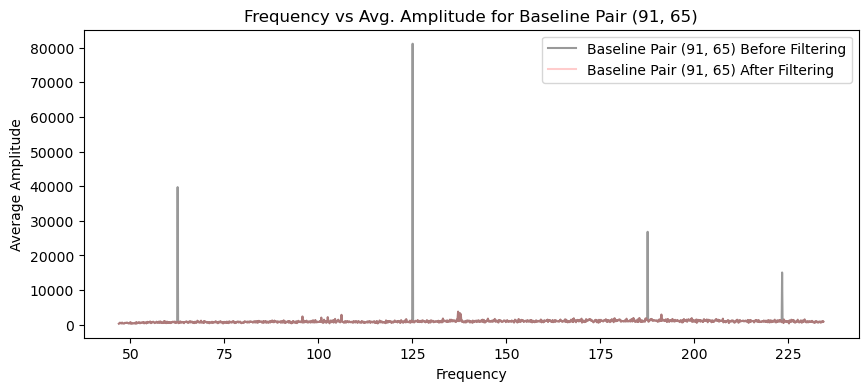

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17047179 -0.16923491 -0.15919715 ... -0.1361755  -0.14645616
 -0.15129043]


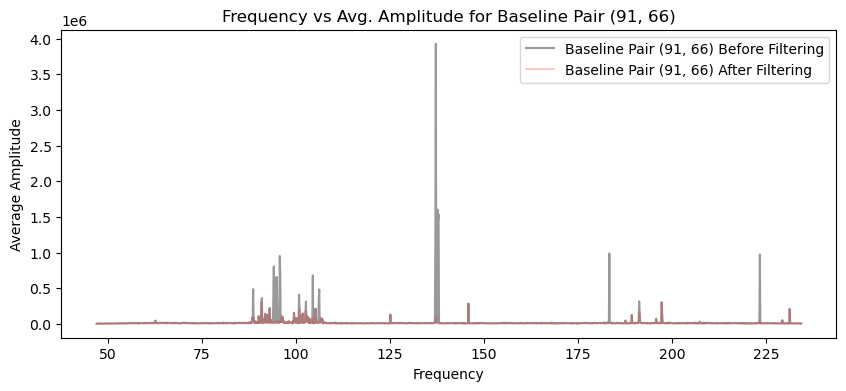

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.14332594 -0.13320131 -0.13933352 ... -0.13551255 -0.13892745
 -0.12160728]


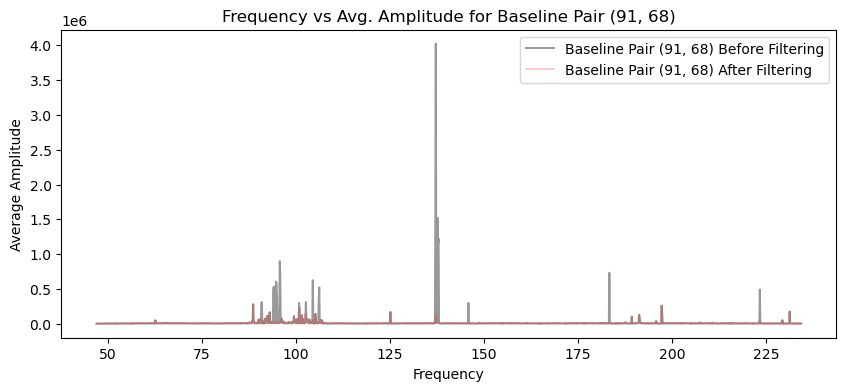

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.11551198 -0.11413066 -0.11490383 ... -0.10072609 -0.09841526
 -0.10515145]


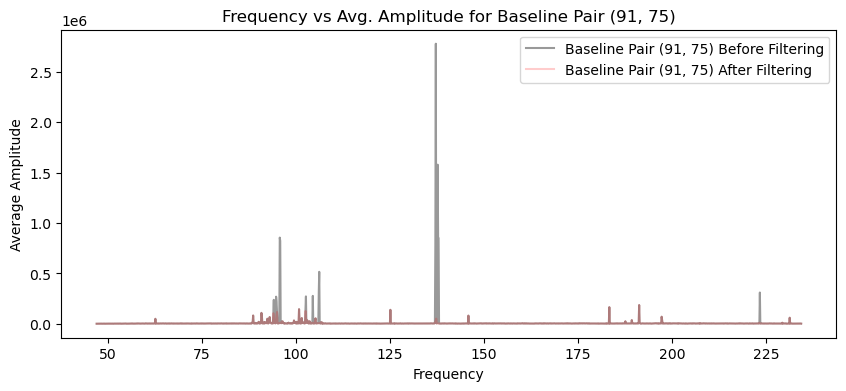

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.13750359 -0.13564544 -0.13802165 ... -0.11743153 -0.11822284
 -0.12491783]


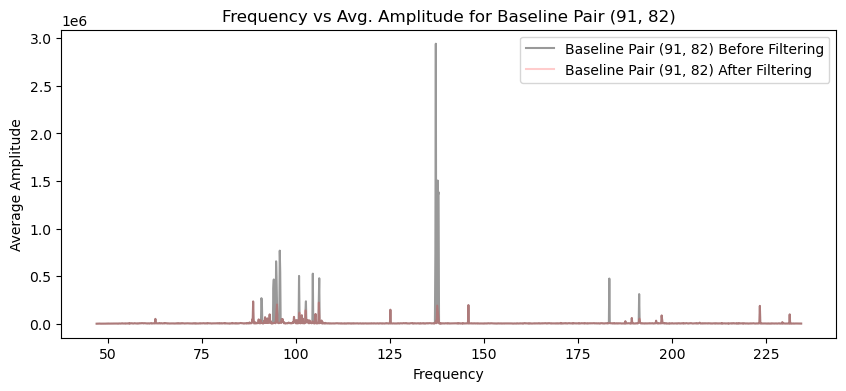

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15436724 -0.15482377 -0.16432776 ... -0.14578114 -0.15638219
 -0.1397609 ]


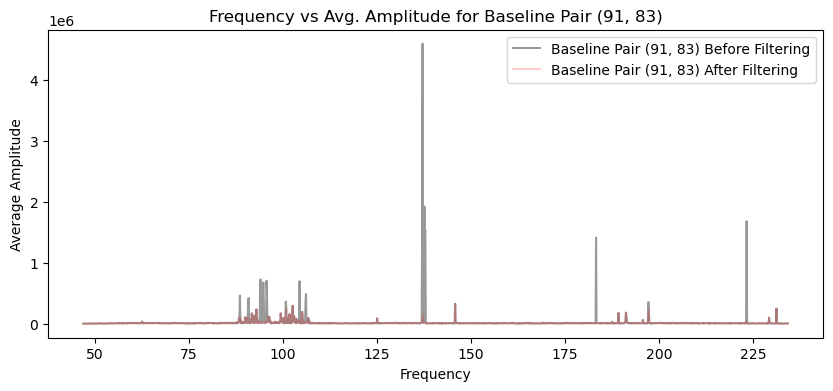

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.26666621 -0.26539518 -0.2623982  ... -0.18663228 -0.22075395
 -0.22142808]


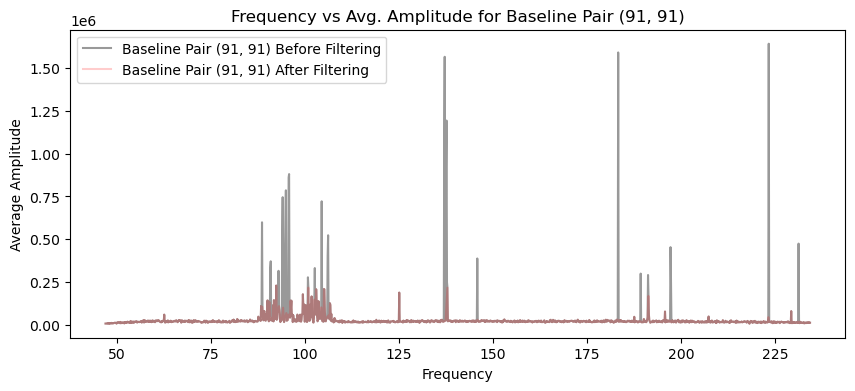

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.14305409 -0.14713325 -0.1626535  ... -0.06758338 -0.0770132
 -0.11910698]


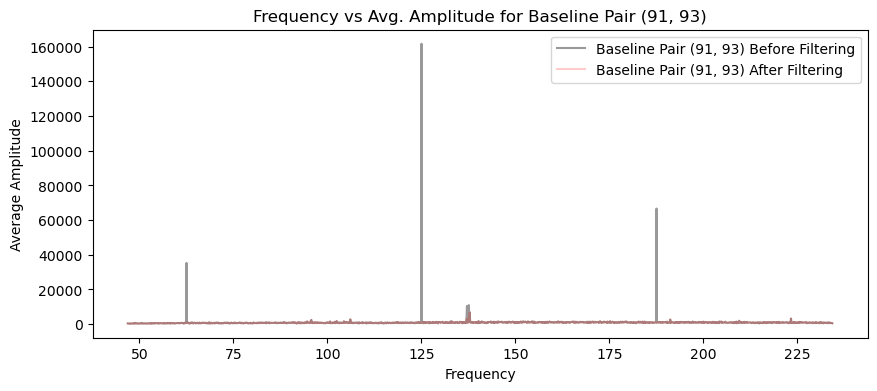

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19935873 -0.20207589 -0.19573119 ... -0.17017869 -0.17709157
 -0.15940169]


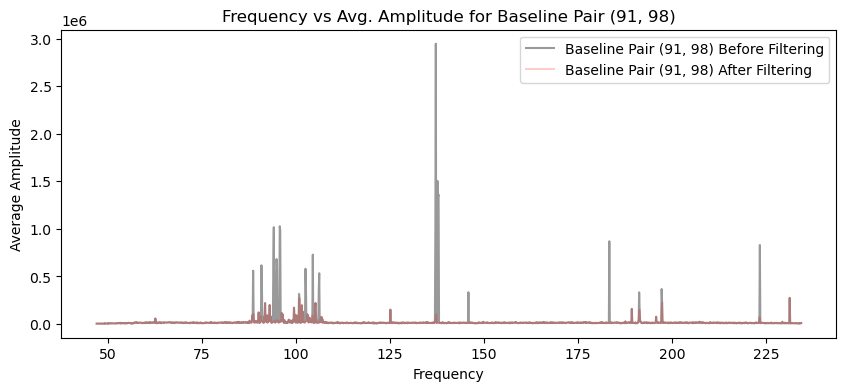

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.16192367 -0.16156573 -0.15754228 ... -0.14970583 -0.14364888
 -0.14838861]


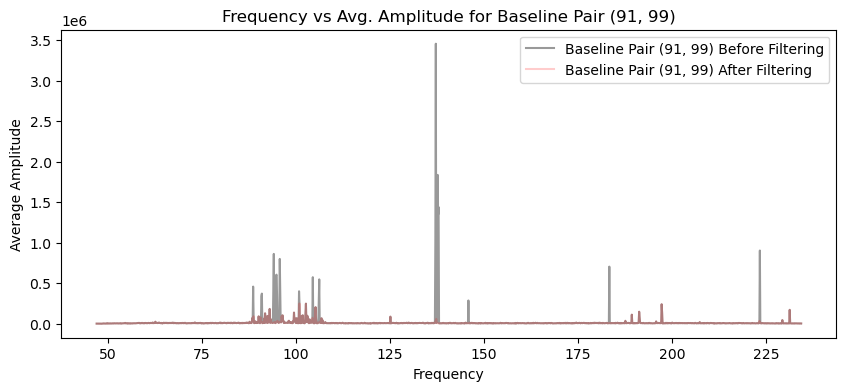

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17519586 -0.1739459  -0.1734264  ... -0.15993739 -0.15951953
 -0.15237361]


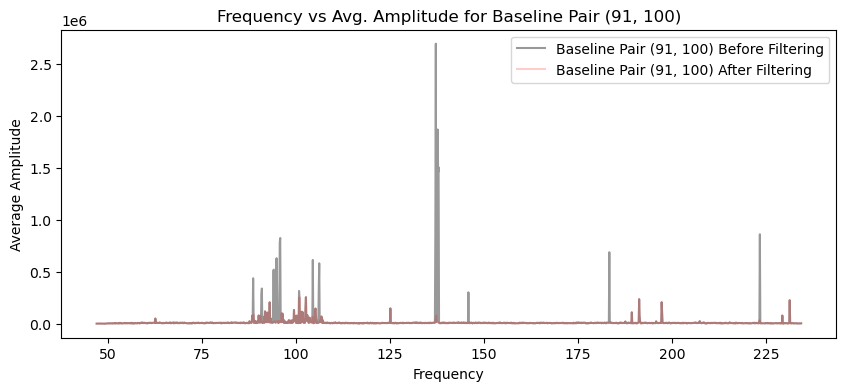

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.19796284 -0.21306379 -0.19958864 ... -0.17495238 -0.1869317
 -0.18180382]


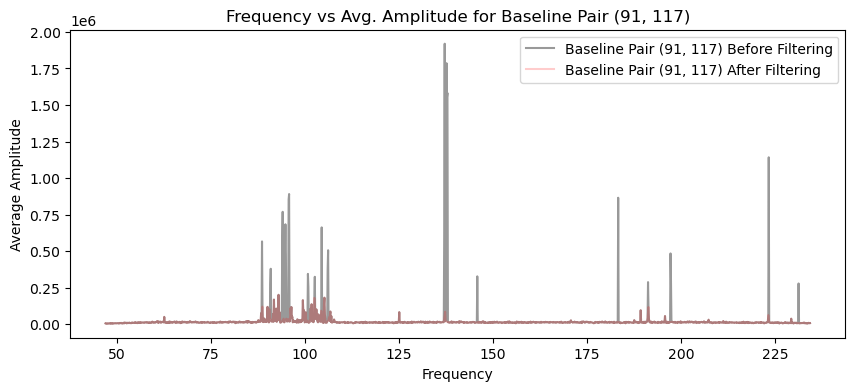

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.20077129 -0.2001973  -0.20027752 ... -0.1850449  -0.19264629
 -0.17707658]


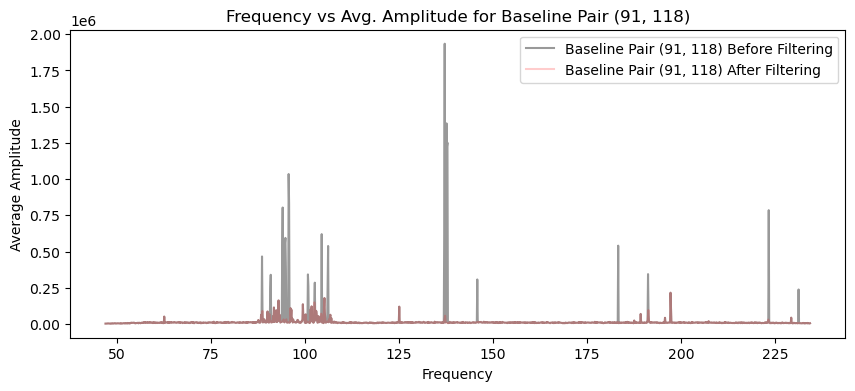

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19140454 -0.18373099 -0.19043119 ... -0.176075   -0.17913254
 -0.19143316]


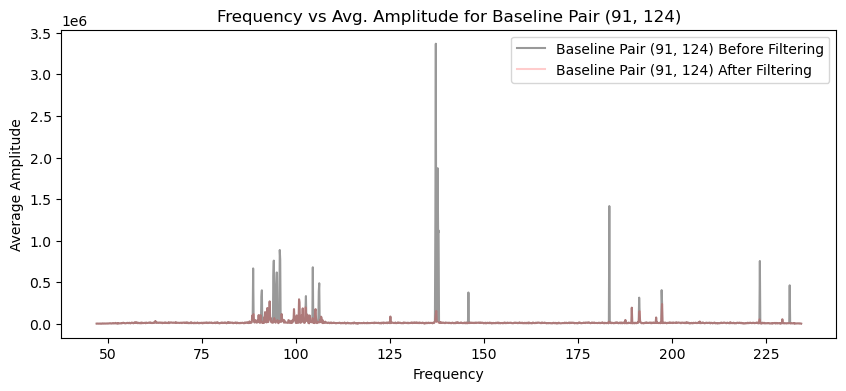

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.21297161 -0.22504792 -0.21739573 ... -0.1862267  -0.16922884
 -0.18954205]


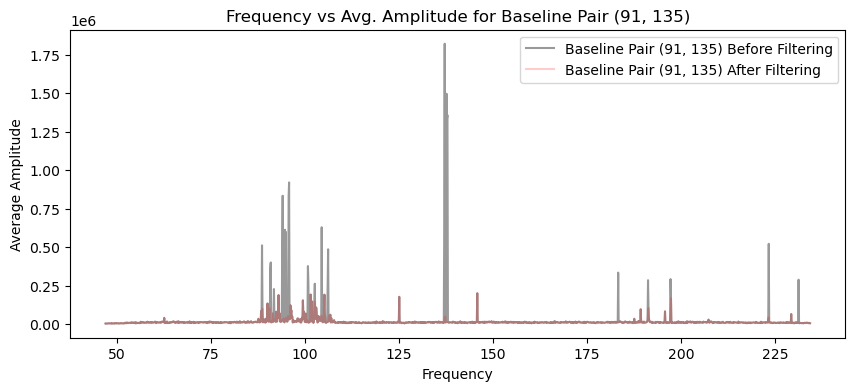

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.20868735 -0.20496841 -0.20739184 ... -0.17132007 -0.17758191
 -0.19883077]


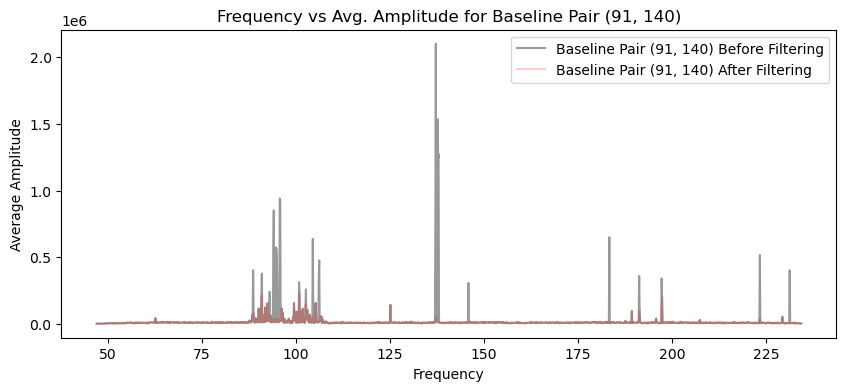

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19951357 -0.19159649 -0.20646089 ... -0.19032136 -0.18861756
 -0.17069118]


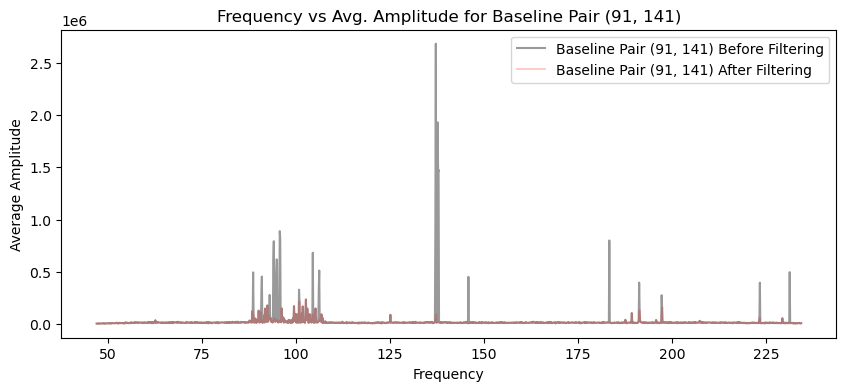

freqs shape: (1536,)
freqs_filtered shape: (1529,)
amplitudes_filtered shape: (20, 1529)
Threshold for baseline: [-0.18681863 -0.18508124 -0.16095542 ... -0.12116425 -0.01273866
 -0.03196535]


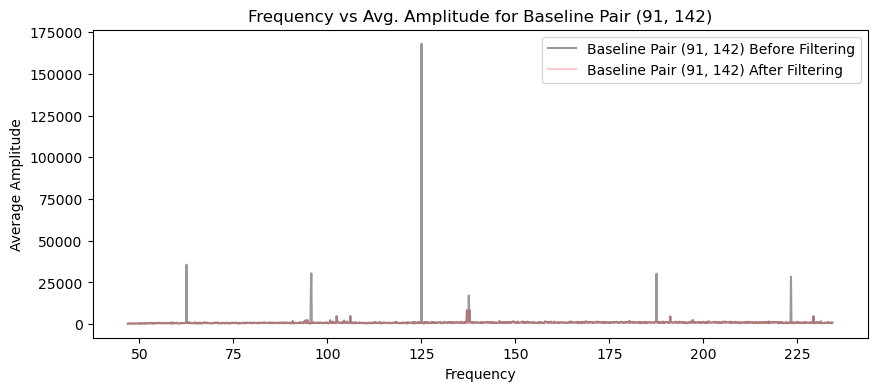

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.22323892 -0.21980421 -0.22143703 ... -0.20755851 -0.17978433
 -0.17089598]


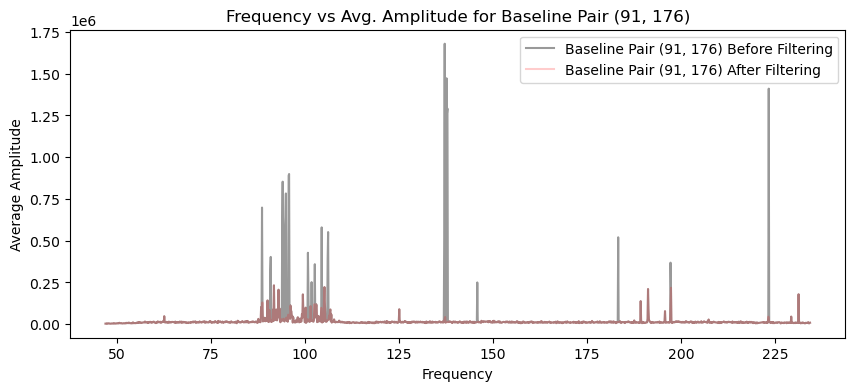

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.07955907 -0.10614596 -0.07638807 ... -0.01971335 -0.0994832
 -0.07659886]


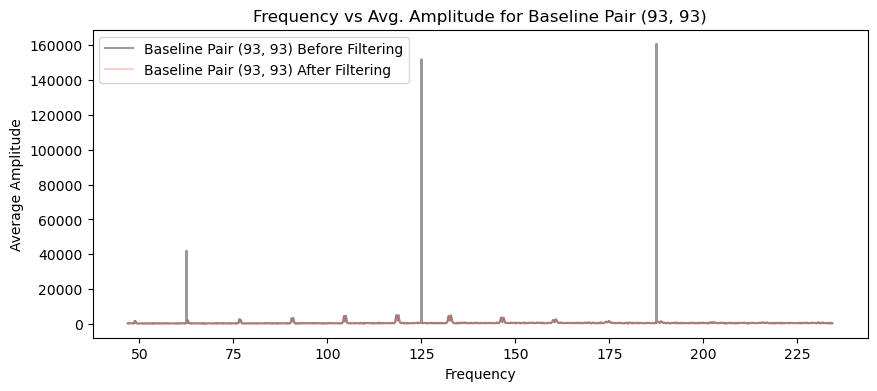

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17213503 -0.17387758 -0.18698513 ... -0.16357753 -0.14728694
 -0.14520539]


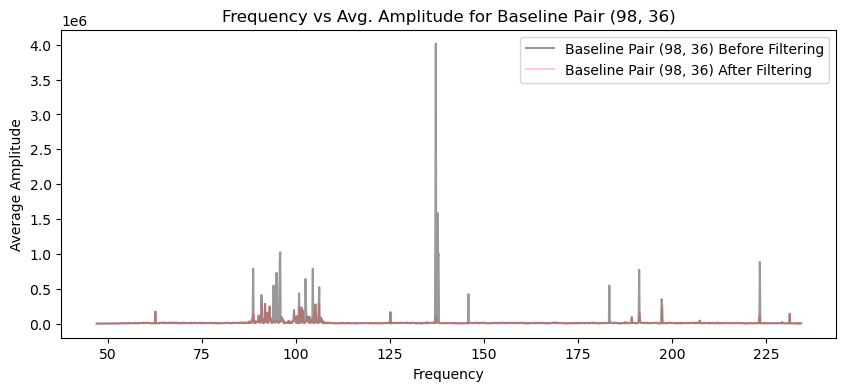

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.2098328  -0.21826689 -0.21104231 ... -0.18368446 -0.16936922
 -0.18161438]


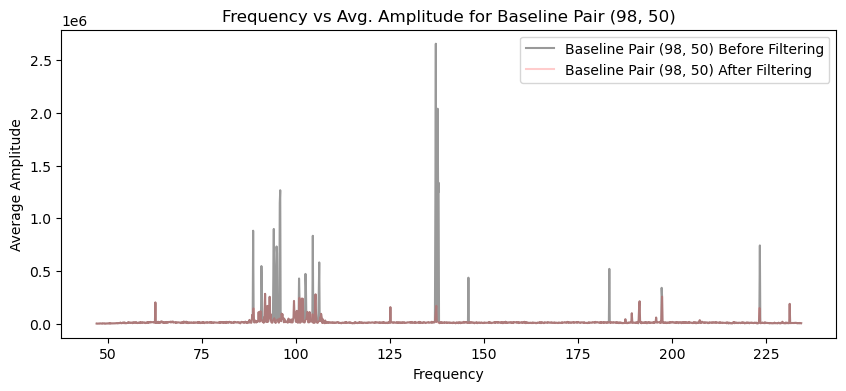

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18189387 -0.17405703 -0.17409209 ... -0.17204589 -0.1733309
 -0.17133262]


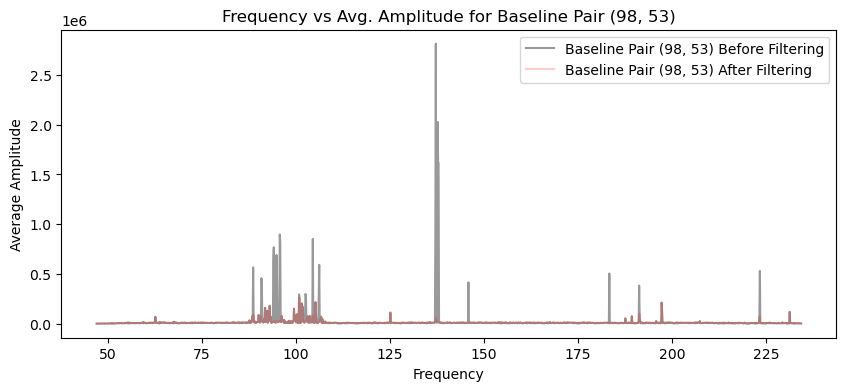

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.21840562 -0.21344146 -0.22591268 ... -0.18691168 -0.18971815
 -0.19582733]


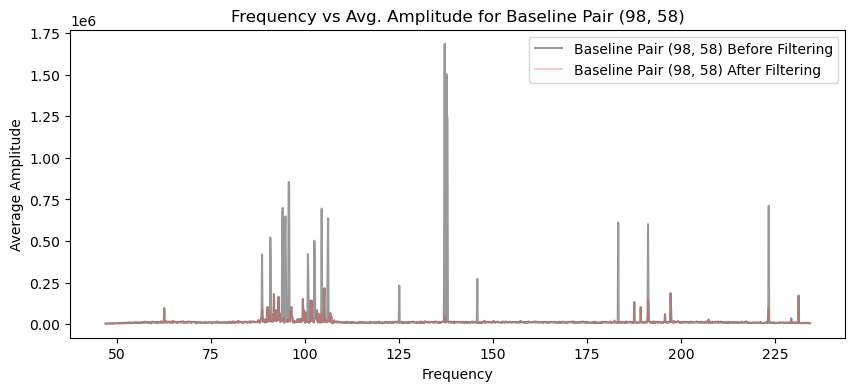

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.22081362 -0.21378842 -0.22511291 ... -0.16044531 -0.18633545
 -0.18909817]


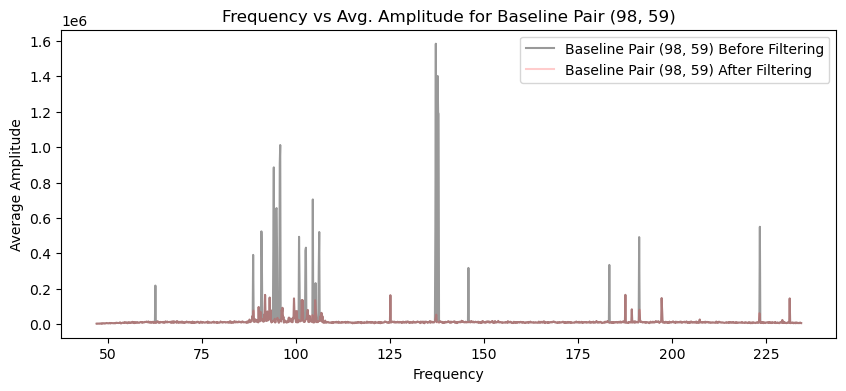

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.20607201 -0.24571833 -0.16119512 ... -0.09594305 -0.07978677
 -0.05769753]


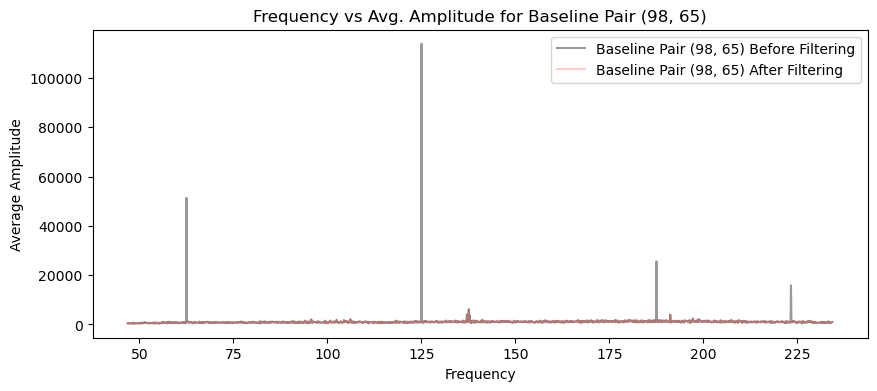

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15790834 -0.17029096 -0.16437971 ... -0.13787551 -0.13964682
 -0.14617129]


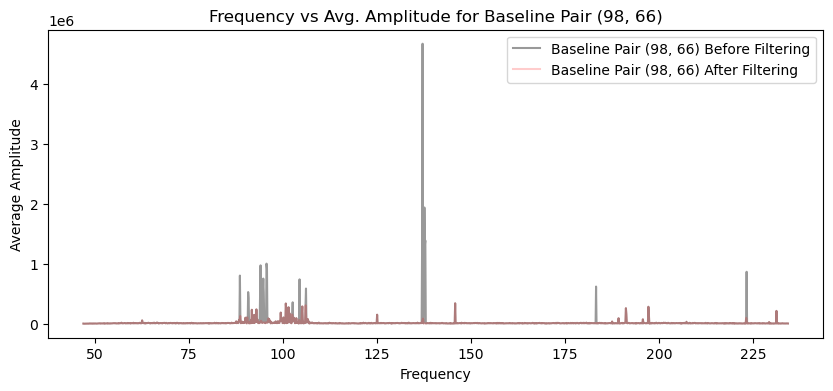

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.14603187 -0.15180638 -0.15170025 ... -0.1381946  -0.13682435
 -0.13418708]


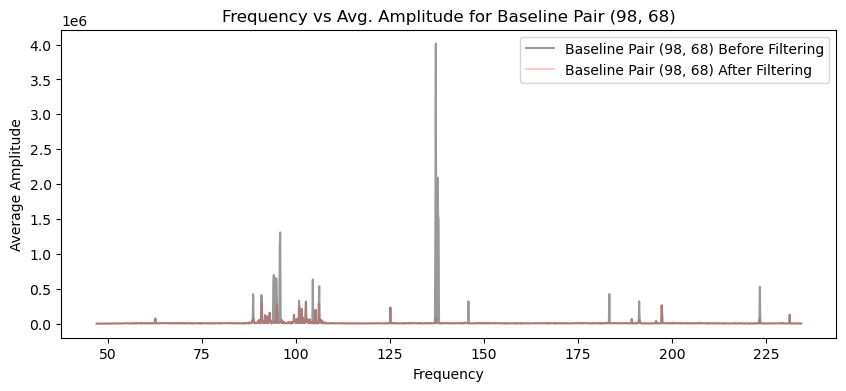

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.12881306 -0.12649297 -0.12633705 ... -0.10118824 -0.09984212
 -0.11091337]


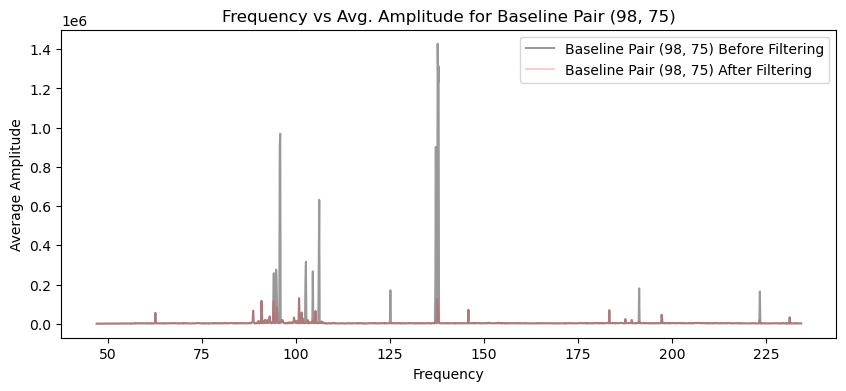

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.20107881 -0.19985094 -0.18670763 ...  0.06347953 -0.10542572
 -0.06930385]


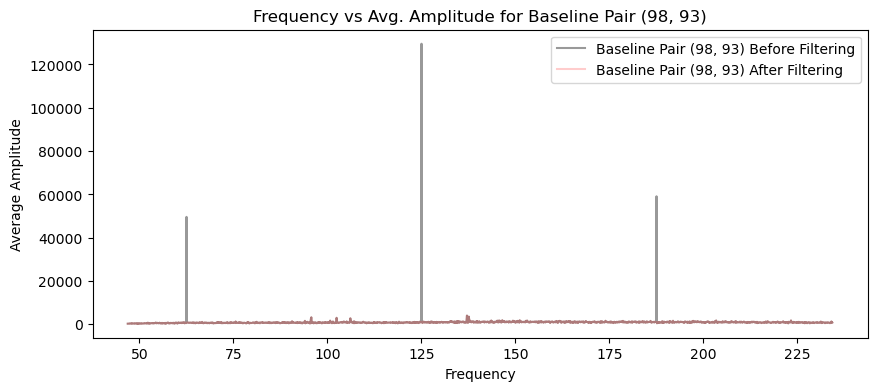

freqs shape: (1536,)
freqs_filtered shape: (1505,)
amplitudes_filtered shape: (20, 1505)
Threshold for baseline: [-0.42497604 -0.44435608 -0.43521798 ... -0.36560593 -0.38237238
 -0.34717469]


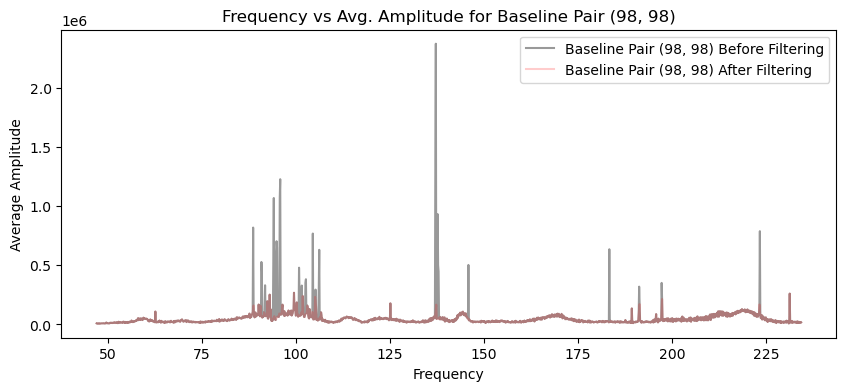

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15471913 -0.1749489  -0.1674921  ... -0.15067092 -0.13541398
 -0.14772939]


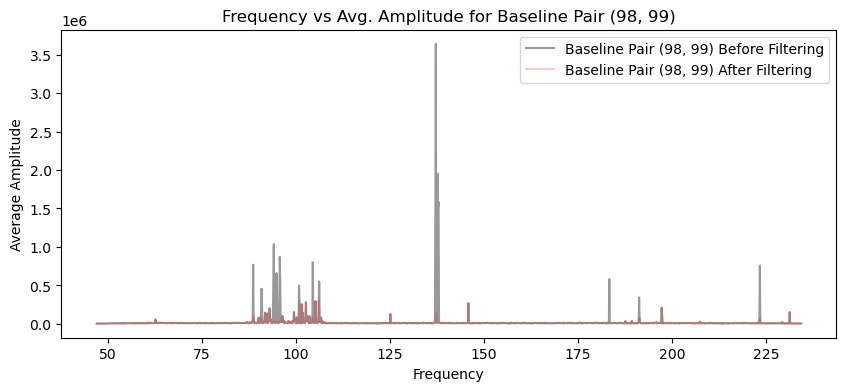

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17708835 -0.18983291 -0.17406818 ... -0.16823978 -0.15995076
 -0.16935481]


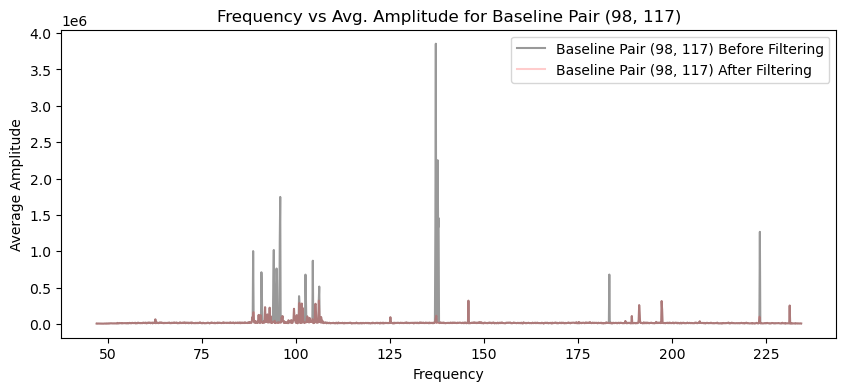

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18357636 -0.18683753 -0.19112723 ... -0.14953247 -0.16220013
 -0.18967164]


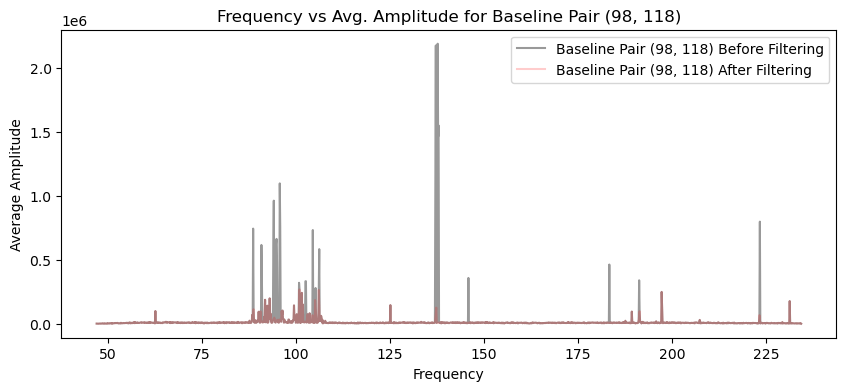

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.19037137 -0.18413074 -0.18915146 ... -0.16986755 -0.17836584
 -0.18232528]


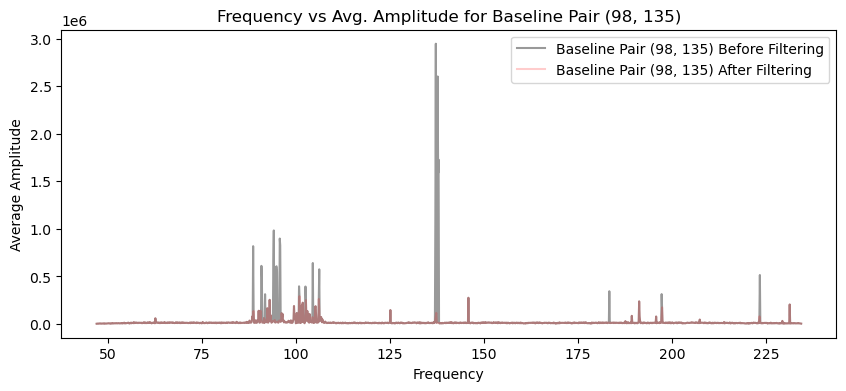

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.19992977 -0.18355073 -0.18509654 ... -0.17481794 -0.1662234
 -0.17095989]


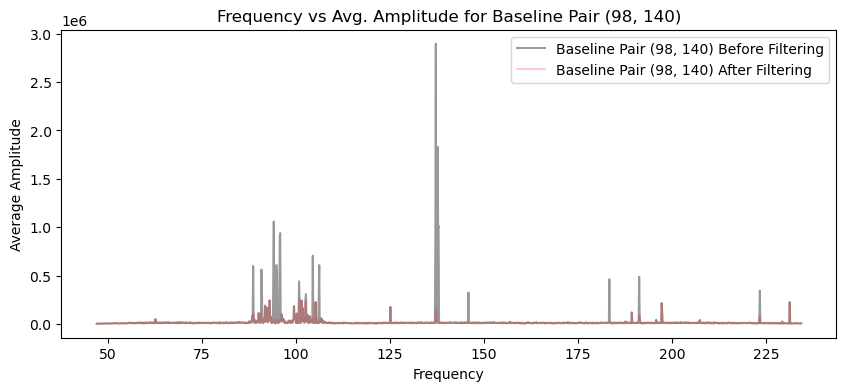

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.19038921 -0.17918755 -0.18198729 ... -0.15907148 -0.17270935
 -0.16181088]


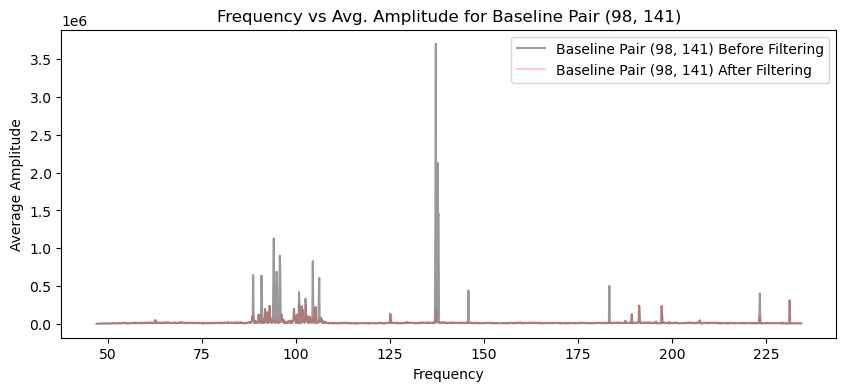

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.20592396 -0.17363833 -0.18495907 ... -0.01904205 -0.04195915
 -0.06499264]


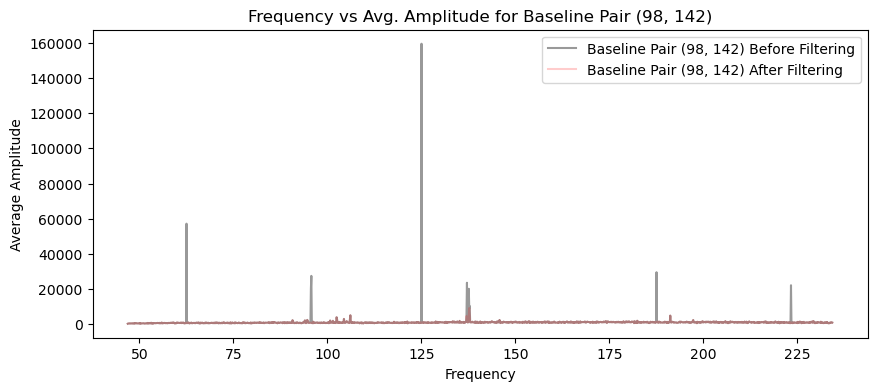

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.18497966 -0.18199662 -0.17825642 ... -0.1607577  -0.15069378
 -0.16772097]


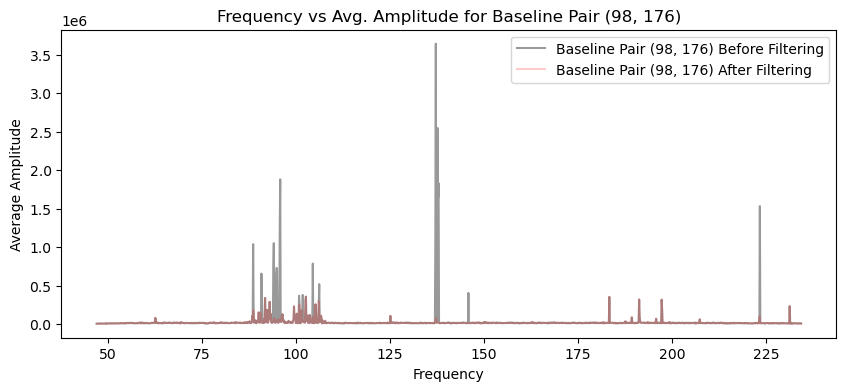

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.1399754  -0.14003545 -0.13980863 ... -0.12250269 -0.13755832
 -0.13020978]


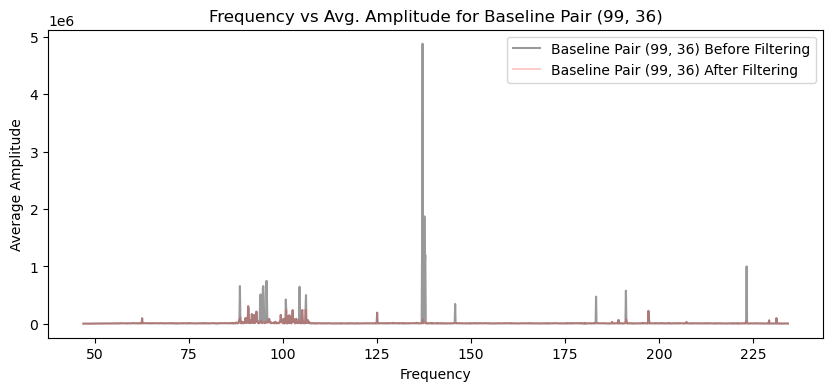

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.14586244 -0.14880633 -0.15263492 ... -0.14911666 -0.12796057
 -0.12629751]


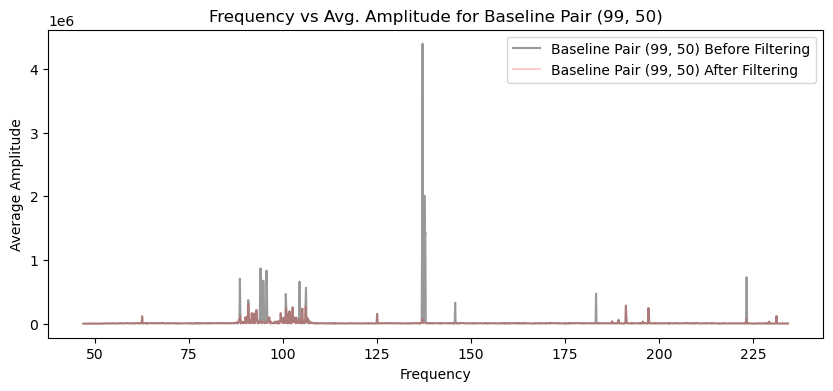

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.14523132 -0.13575788 -0.13971139 ... -0.13354543 -0.1273679
 -0.12475186]


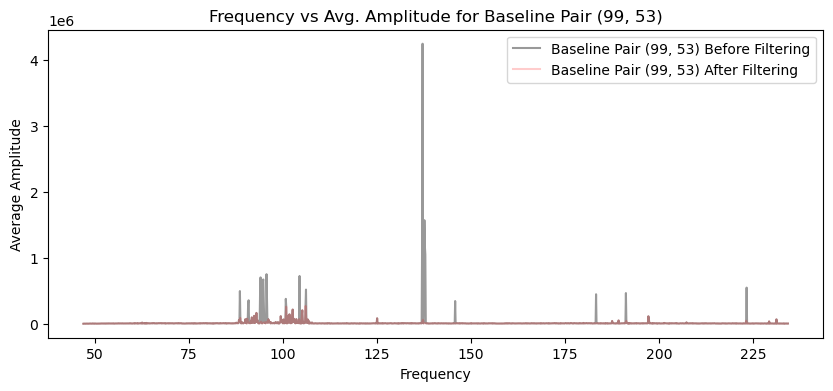

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.18576898 -0.18234198 -0.18740883 ... -0.17130853 -0.17756895
 -0.16593613]


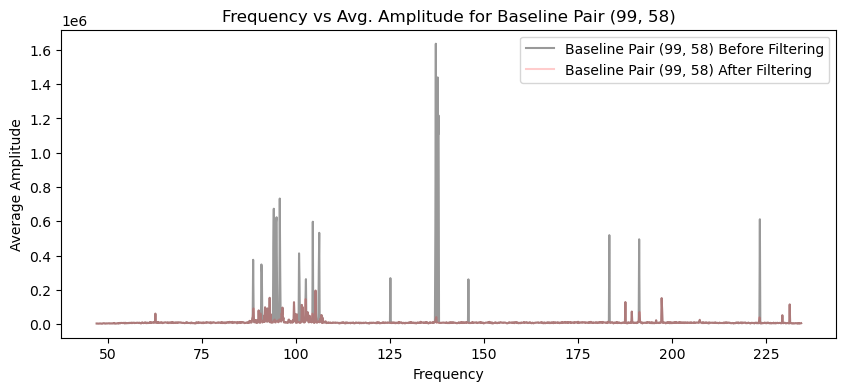

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18723693 -0.18388613 -0.18278159 ... -0.17276938 -0.15217672
 -0.17341109]


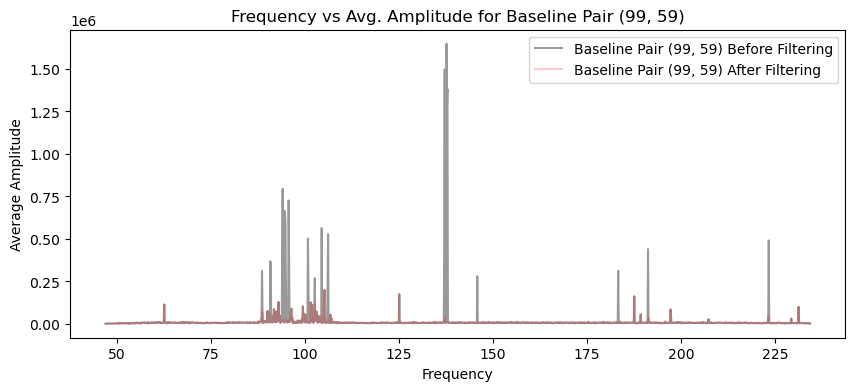

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.37114535 -0.43607614 -0.35678837 ... -0.27682166 -0.39610085
 -0.27897497]


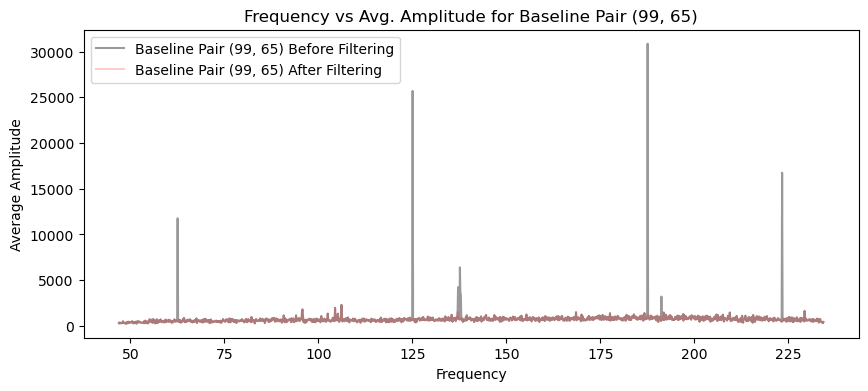

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.141487   -0.14089516 -0.14512643 ... -0.12840038 -0.13941329
 -0.13713357]


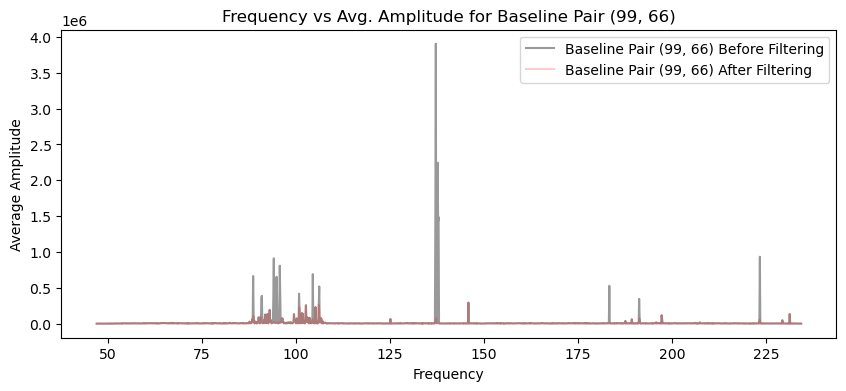

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.13781845 -0.1273901  -0.12837555 ... -0.12618204 -0.13097884
 -0.11685055]


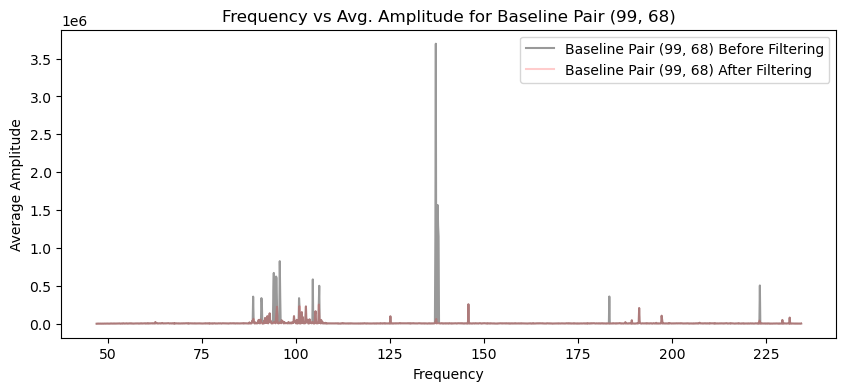

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.11498361 -0.11372752 -0.11029464 ... -0.09238794 -0.09336493
 -0.10033565]


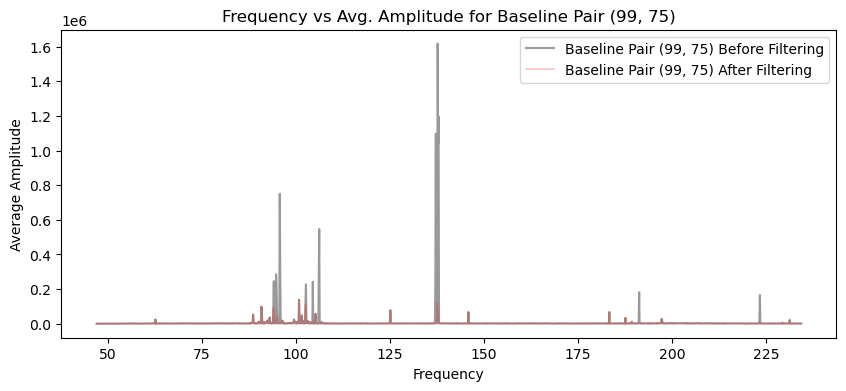

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.12721211 -0.13113403 -0.15934452 ... -0.09943719 -0.09142701
 -0.08458474]


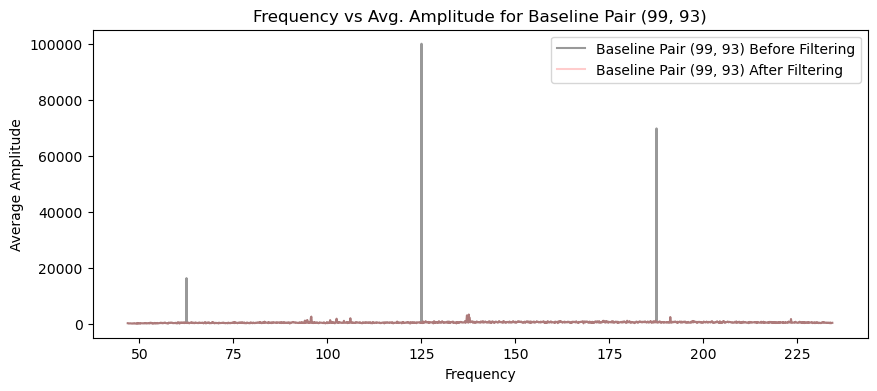

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15477013 -0.15537249 -0.15406788 ... -0.13884961 -0.13721981
 -0.15354836]


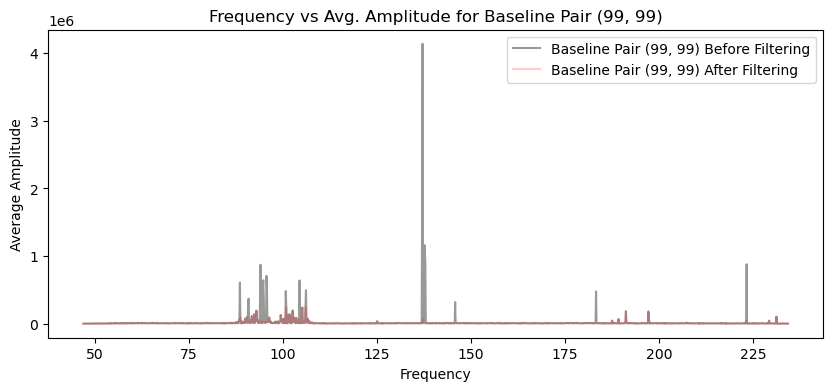

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16105339 -0.16507249 -0.16905656 ... -0.14885904 -0.14689
 -0.151076  ]


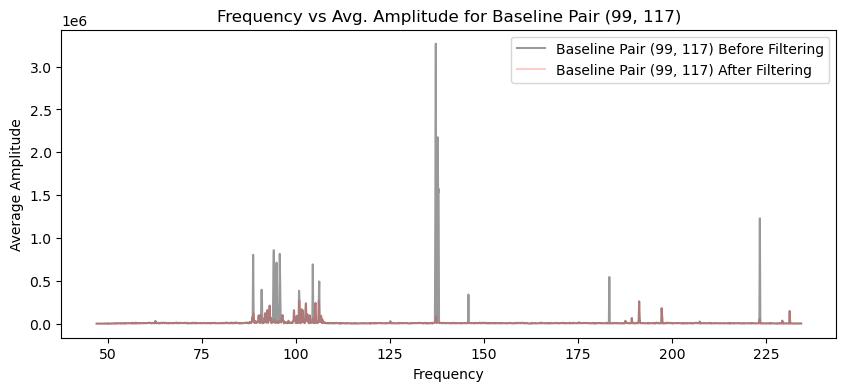

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14543687 -0.13962843 -0.14693759 ... -0.13356623 -0.14042124
 -0.13074365]


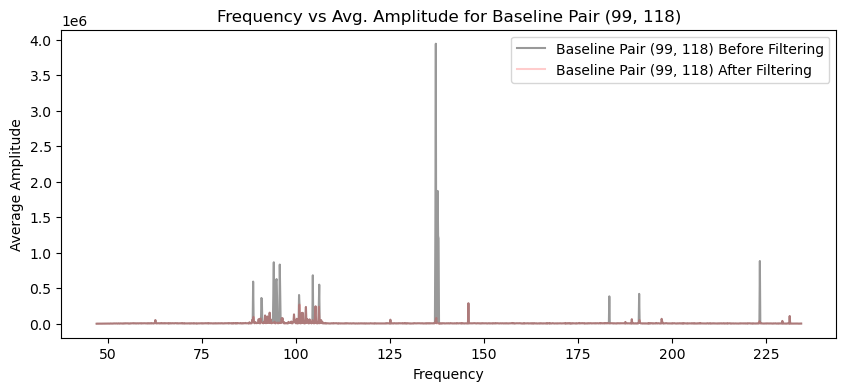

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.15026615 -0.14576966 -0.14597074 ... -0.14767181 -0.1322979
 -0.13232046]


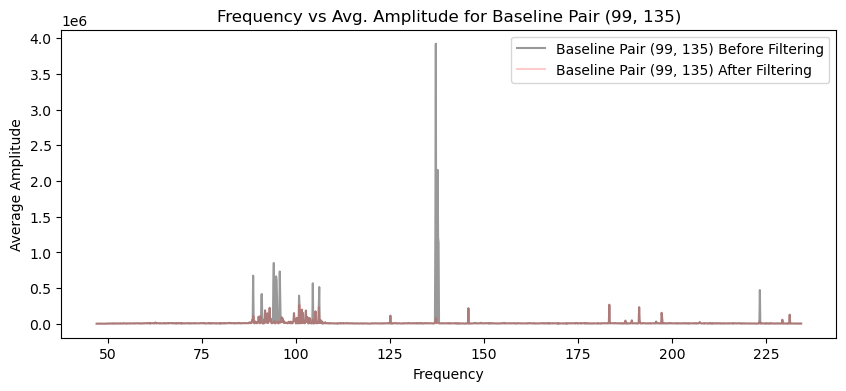

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14336406 -0.13777504 -0.14173398 ... -0.12437701 -0.13945141
 -0.14128881]


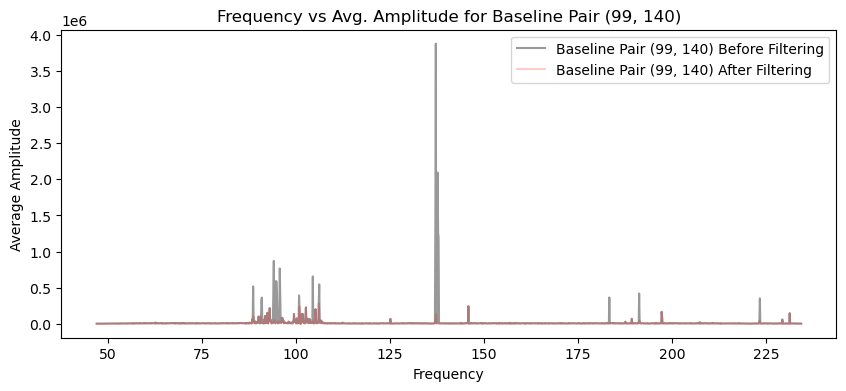

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14216652 -0.14175882 -0.15471095 ... -0.12431308 -0.13064134
 -0.14450404]


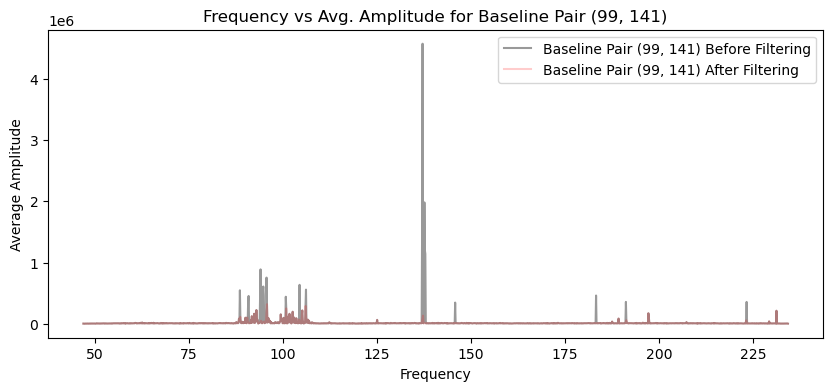

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.15986632 -0.1524147  -0.16538978 ... -0.09692782 -0.0867655
 -0.1236878 ]


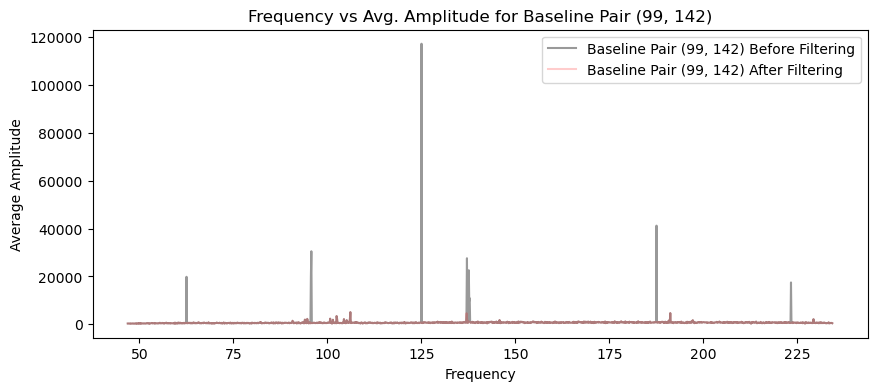

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15897011 -0.17112716 -0.1711482  ... -0.15813807 -0.1628291
 -0.15632922]


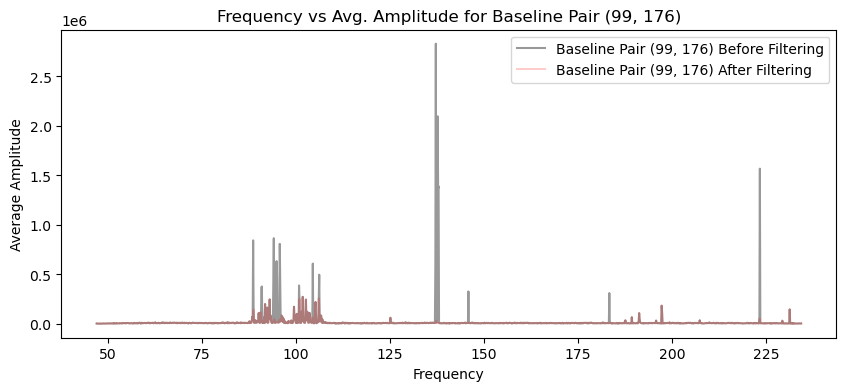

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.1457019  -0.14484724 -0.14684172 ... -0.124732   -0.13377675
 -0.12436195]


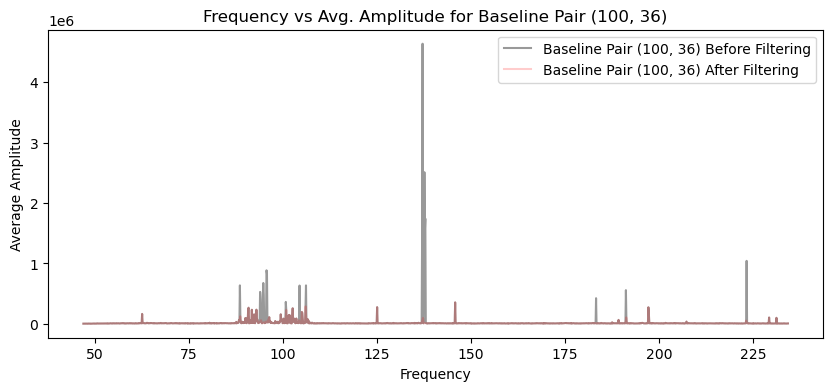

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.18162219 -0.17986155 -0.18389007 ... -0.15940015 -0.17530056
 -0.15351419]


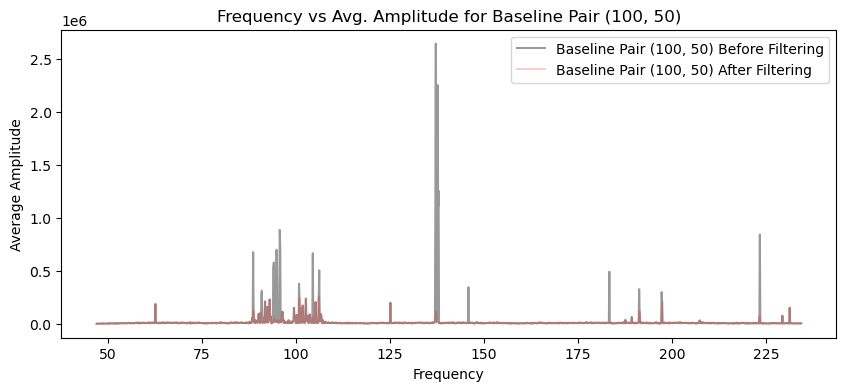

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.19726741 -0.18603469 -0.18083438 ... -0.18117836 -0.16738813
 -0.1683707 ]


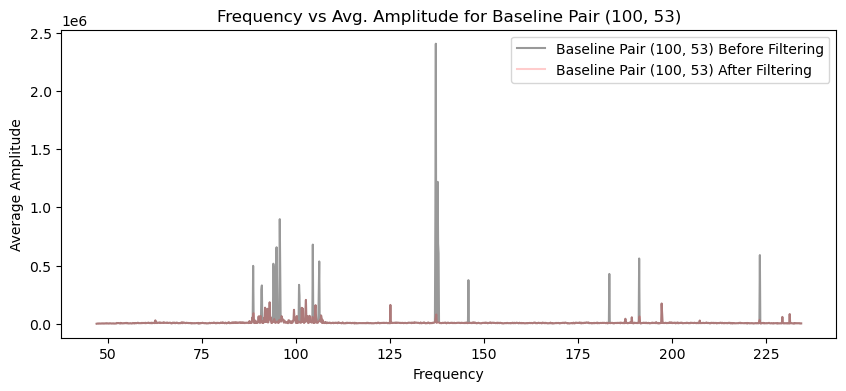

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19728408 -0.18817824 -0.19071134 ... -0.16328231 -0.18468814
 -0.1706584 ]


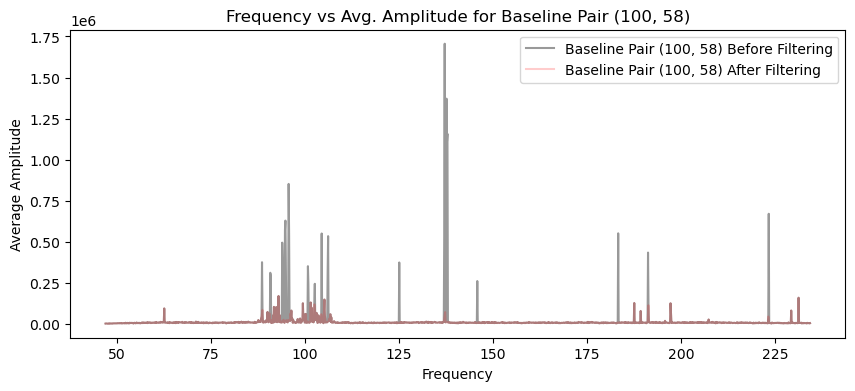

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.18742273 -0.18636787 -0.18495258 ... -0.16498911 -0.14606164
 -0.16083578]


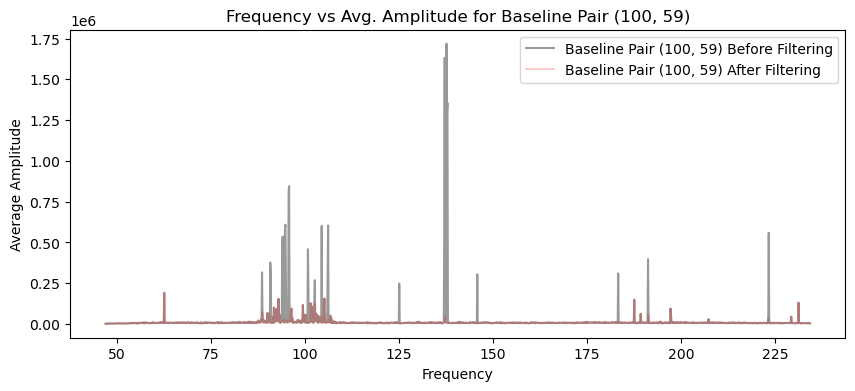

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.2401708  -0.18291122 -0.18893572 ... -0.09679772 -0.10057877
 -0.10945912]


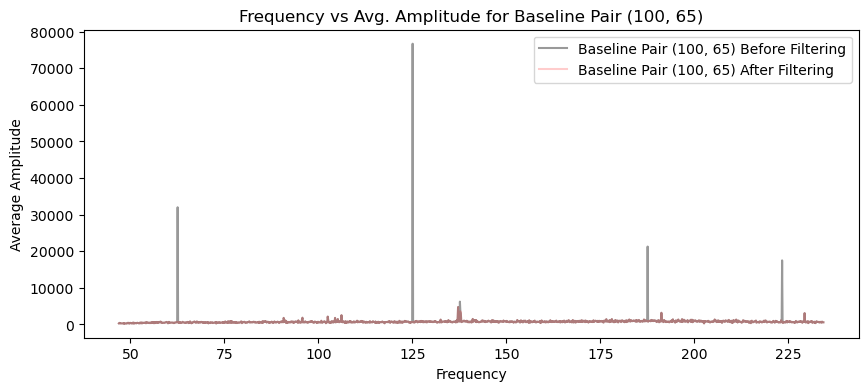

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15642191 -0.15653327 -0.15256098 ... -0.13571818 -0.14464118
 -0.1380055 ]


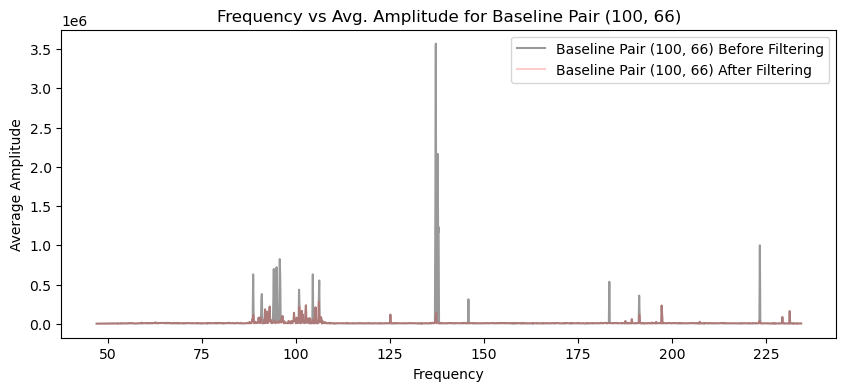

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15225983 -0.15341627 -0.15699673 ... -0.13517016 -0.14443396
 -0.12986305]


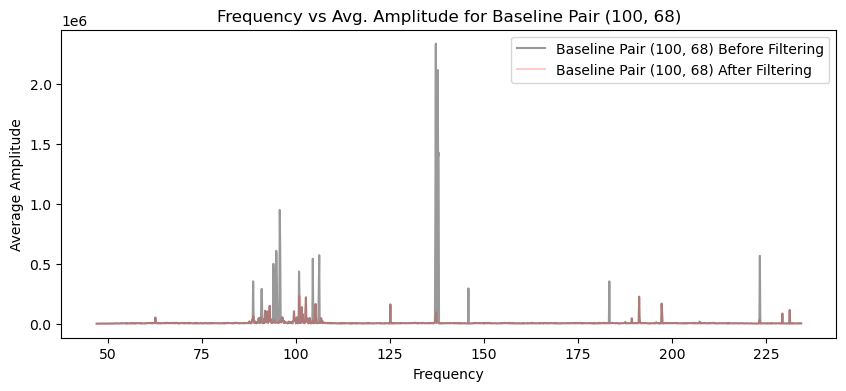

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.11894103 -0.118827   -0.11810477 ... -0.10323828 -0.10277523
 -0.09806186]


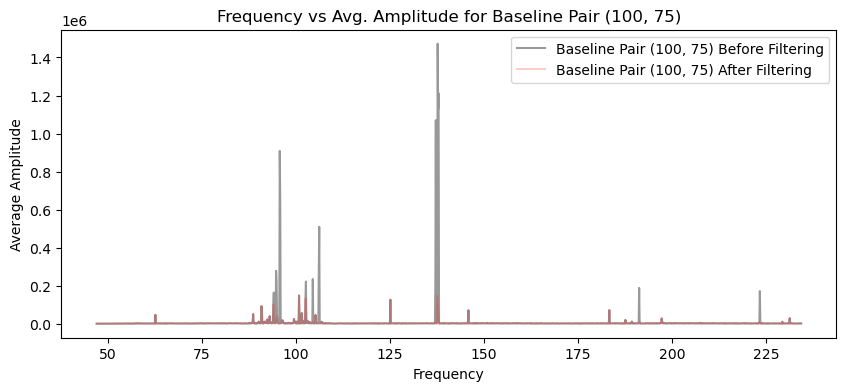

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.12318472 -0.1305646  -0.09348793 ... -0.07199449 -0.05921917
 -0.08151955]


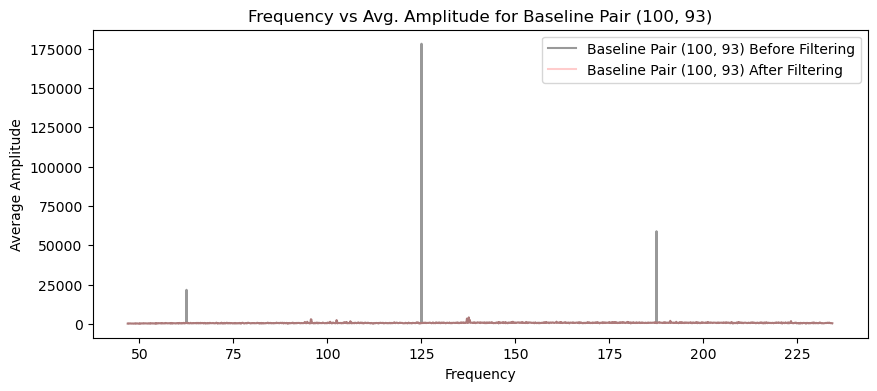

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17790964 -0.16199794 -0.17250933 ... -0.14281805 -0.13353569
 -0.15216583]


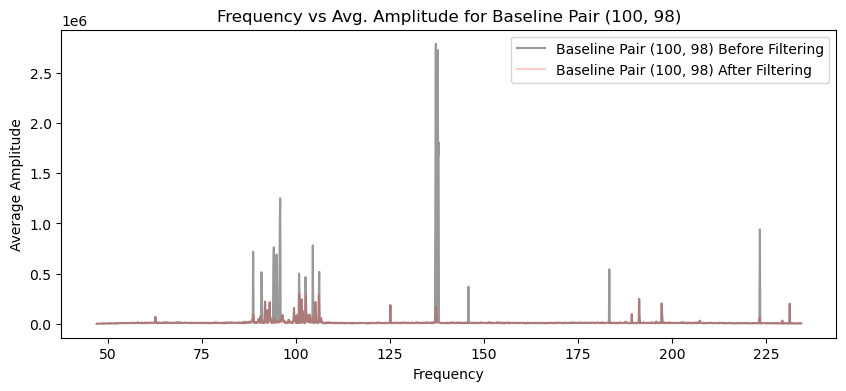

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.14232278 -0.14726596 -0.14521533 ... -0.13277716 -0.12920284
 -0.13937702]


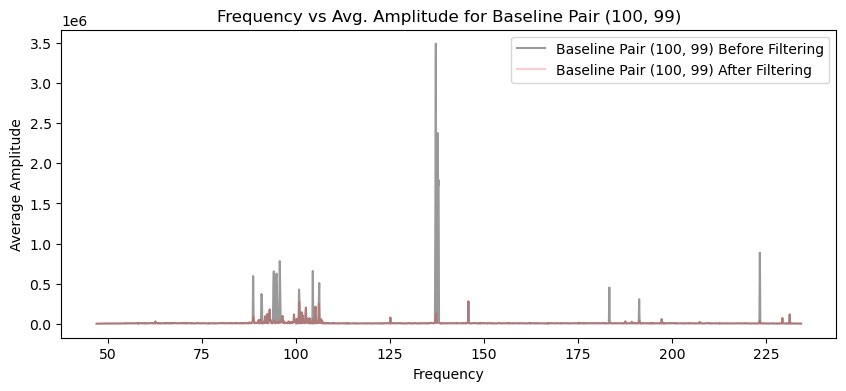

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.20770215 -0.18805689 -0.19486687 ... -0.21034217 -0.21367565
 -0.2020287 ]


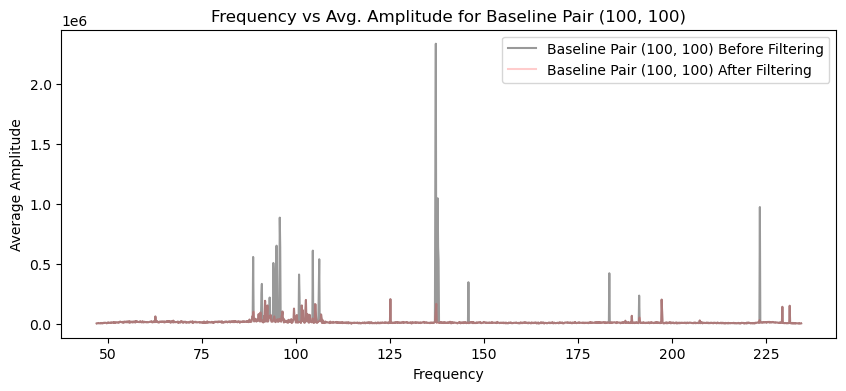

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.1685183  -0.15534151 -0.16327528 ... -0.14003812 -0.1494936
 -0.14268716]


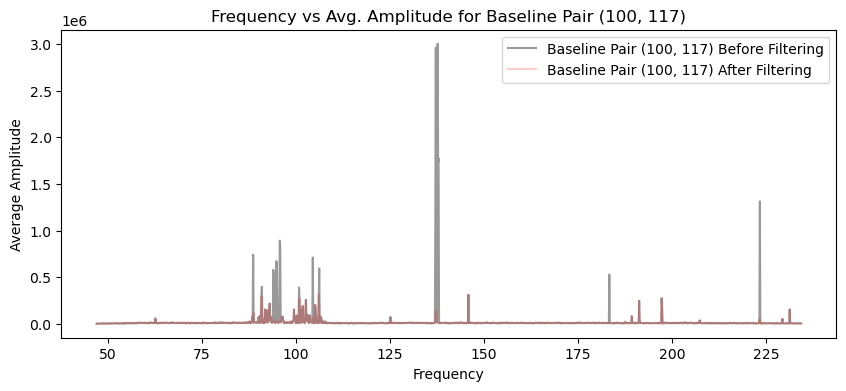

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15918958 -0.1571327  -0.16063364 ... -0.14998632 -0.14406185
 -0.14838562]


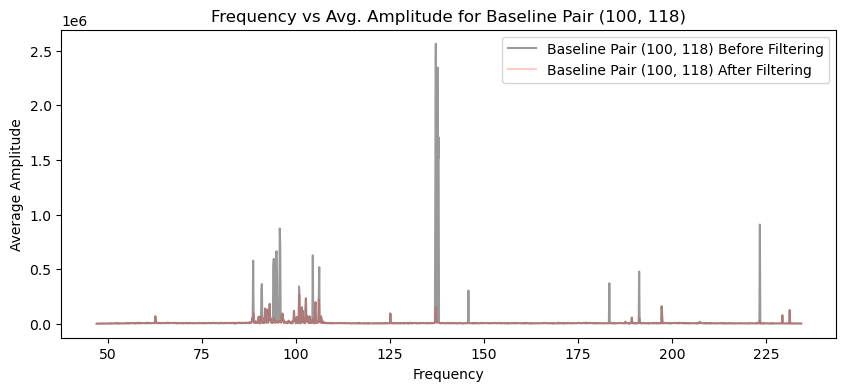

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.1469916  -0.16355296 -0.15809077 ... -0.14542131 -0.1458396
 -0.14840697]


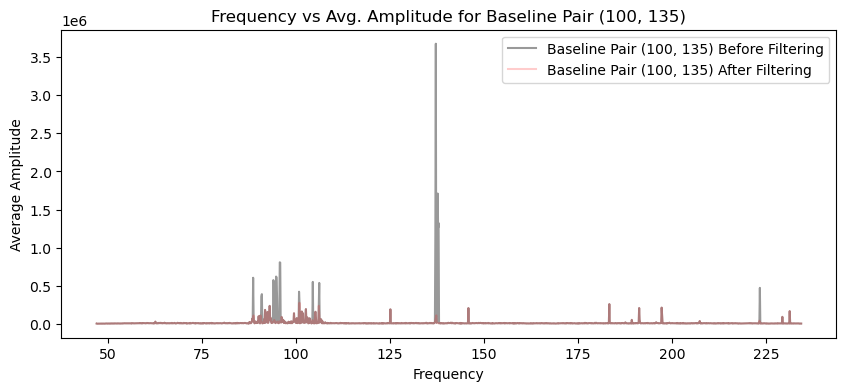

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15218788 -0.15017155 -0.15066433 ... -0.12192923 -0.12788028
 -0.13333003]


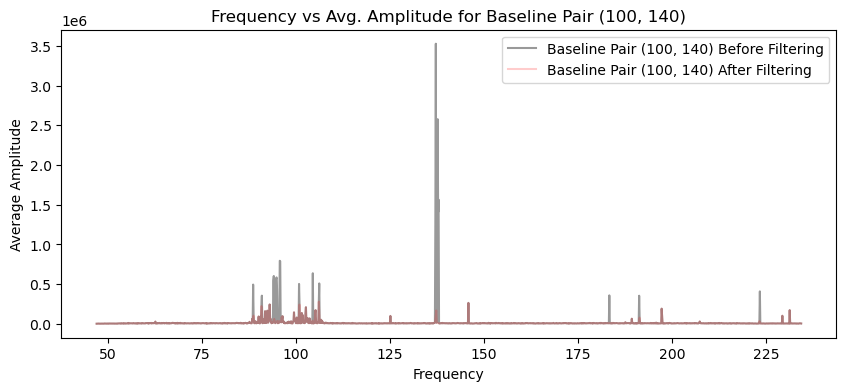

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17482369 -0.16620113 -0.16454767 ... -0.1606887  -0.14902413
 -0.1581715 ]


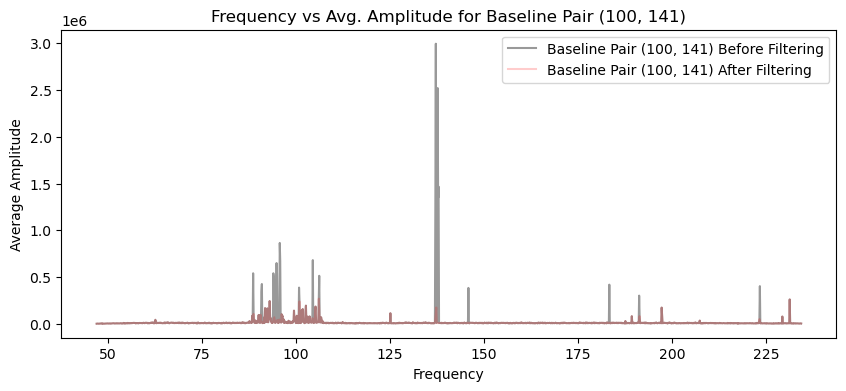

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.12567244 -0.12999993 -0.13323345 ... -0.08298312 -0.07889448
 -0.06088867]


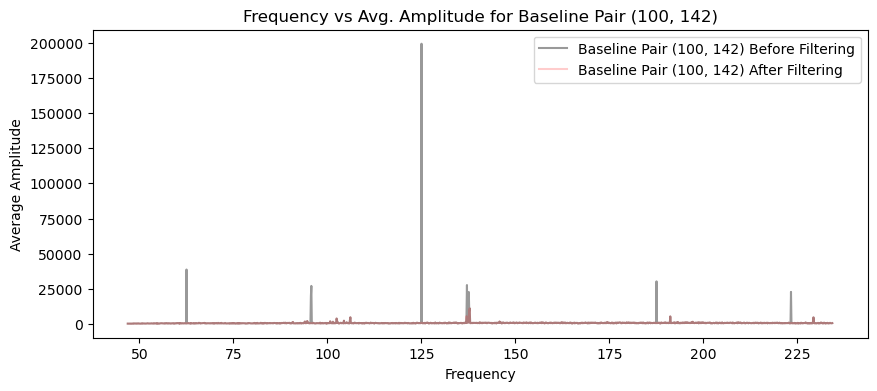

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.1769977  -0.18758899 -0.18043007 ... -0.14814616 -0.16425726
 -0.16522487]


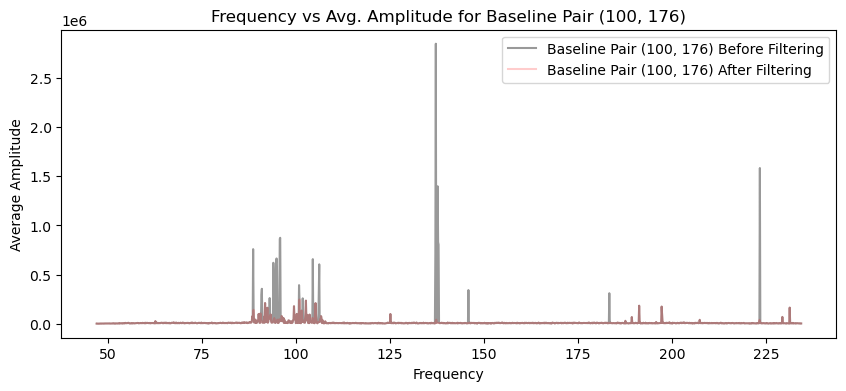

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17776667 -0.17775075 -0.18440961 ... -0.12980452 -0.15941774
 -0.15555564]


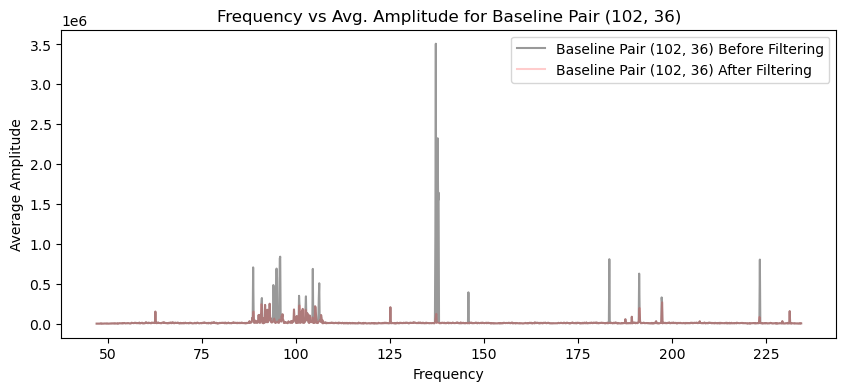

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19035653 -0.19880625 -0.20533319 ... -0.15857586 -0.1884908
 -0.18669268]


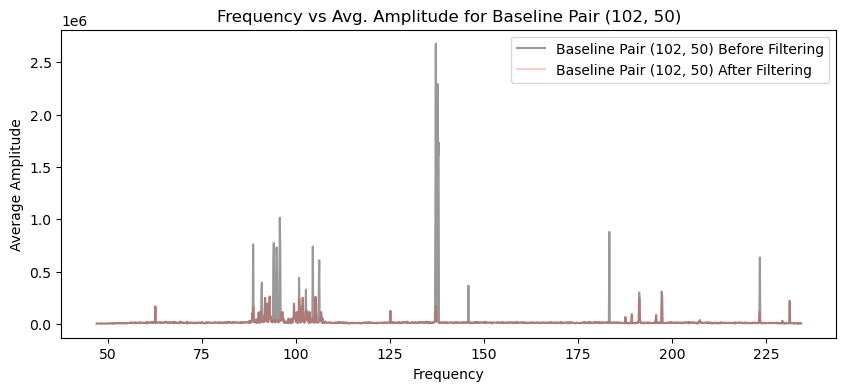

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18113242 -0.17623213 -0.17588032 ... -0.15748325 -0.16342139
 -0.15335781]


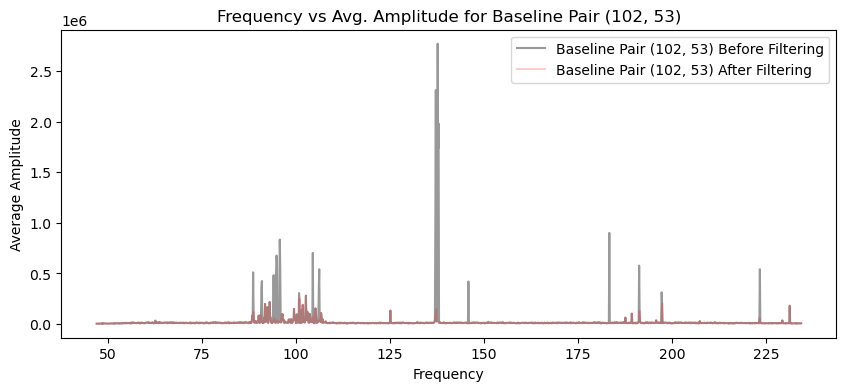

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.20380477 -0.21704566 -0.20191077 ... -0.18856249 -0.16598783
 -0.19486695]


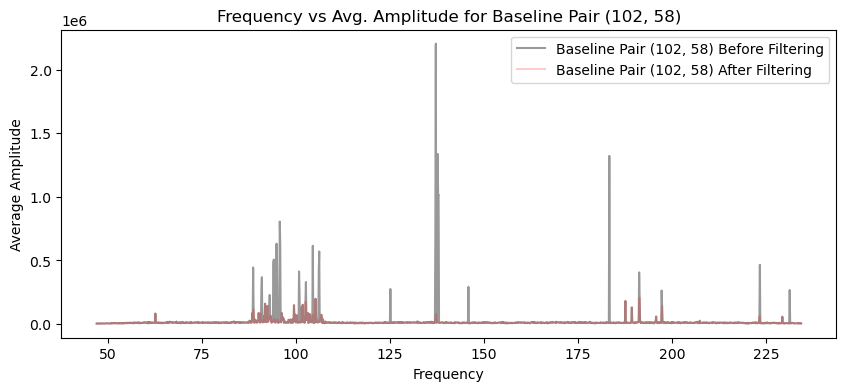

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.21645816 -0.21593421 -0.20369369 ... -0.19450493 -0.20253579
 -0.18543286]


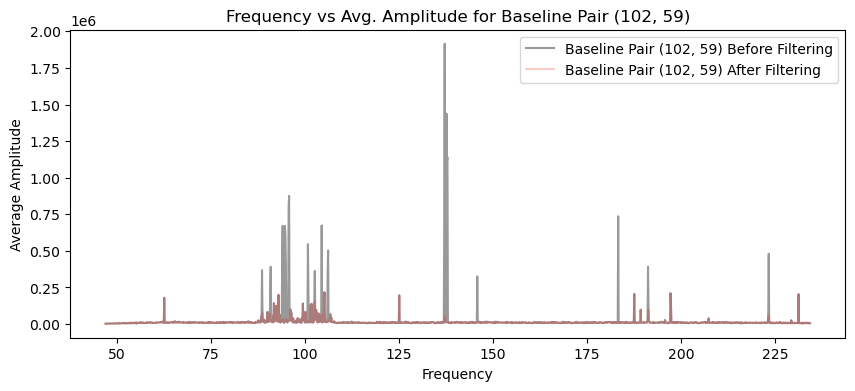

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.20199265 -0.25754299 -0.18916352 ... -0.15477816 -0.1046062
 -0.1216403 ]


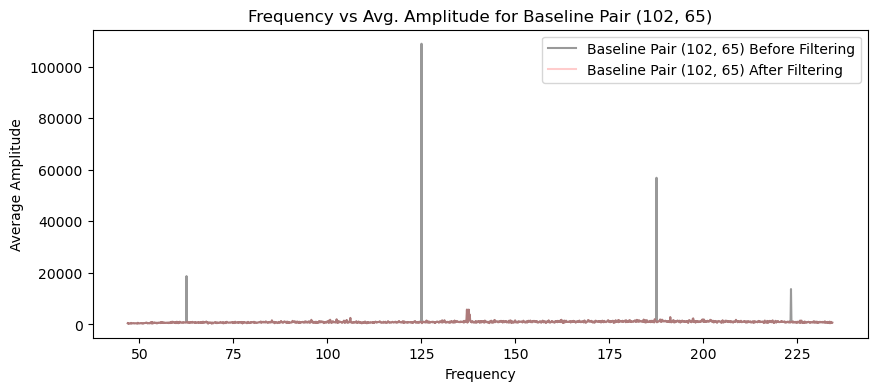

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15432459 -0.15860186 -0.15029169 ... -0.12960674 -0.13671056
 -0.13496013]


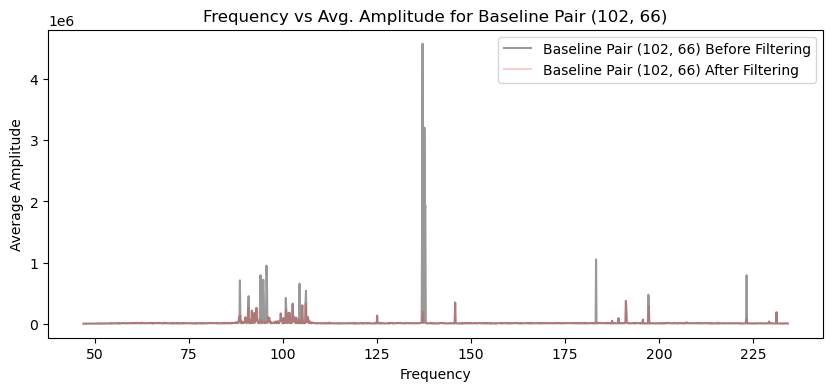

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16903644 -0.17380763 -0.17505971 ... -0.16952259 -0.15595129
 -0.15925098]


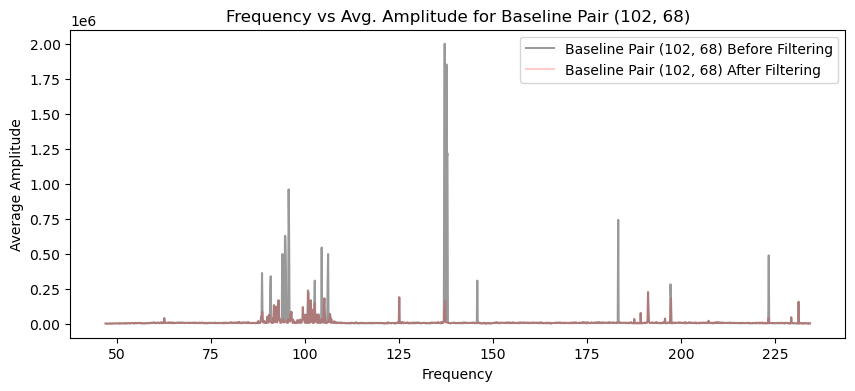

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.13042567 -0.1262989  -0.12904372 ... -0.11249378 -0.10854941
 -0.10539652]


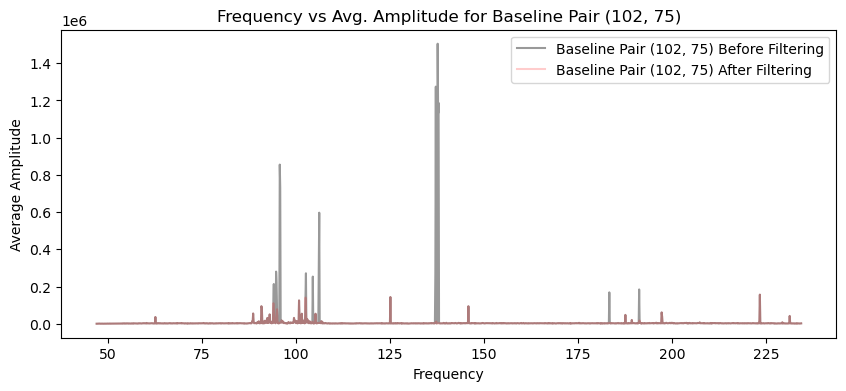

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.13381737 -0.12713713 -0.12952343 ... -0.11309119 -0.11953814
 -0.11813156]


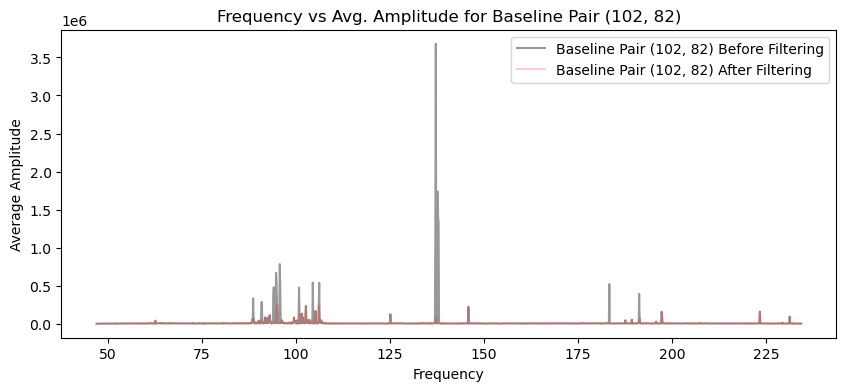

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15829527 -0.16833651 -0.16783222 ... -0.13771069 -0.14434622
 -0.14889481]


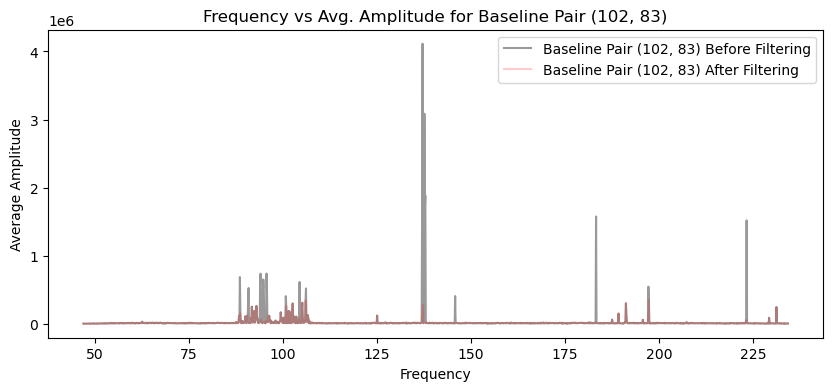

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.29460916 -0.2576217  -0.28978208 ... -0.04271474 -0.17471869
 -0.03710594]


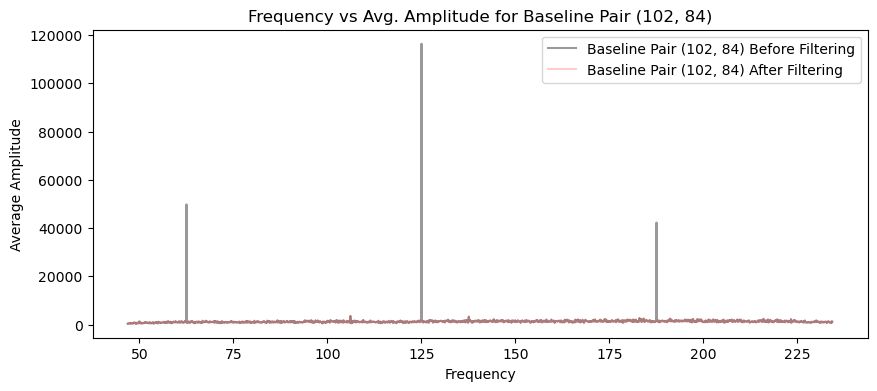

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18974994 -0.19164444 -0.18539129 ... -0.16884752 -0.1753659
 -0.14062948]


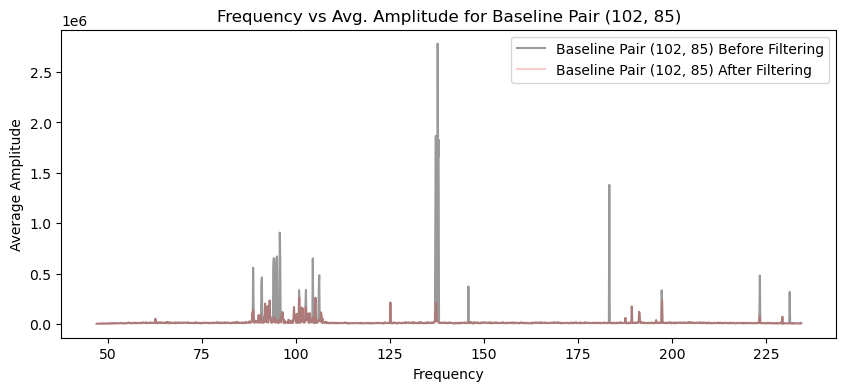

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.19030753 -0.18002744 -0.17889605 ... -0.16101376 -0.15720795
 -0.17216961]


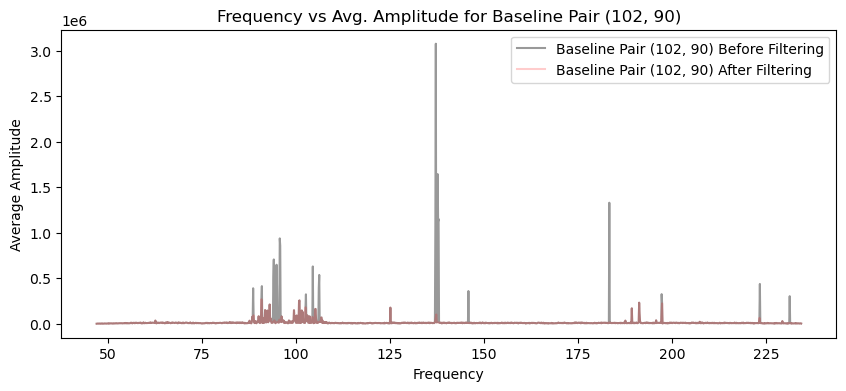

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.20530073 -0.20820782 -0.19710351 ... -0.16959492 -0.16544763
 -0.17730373]


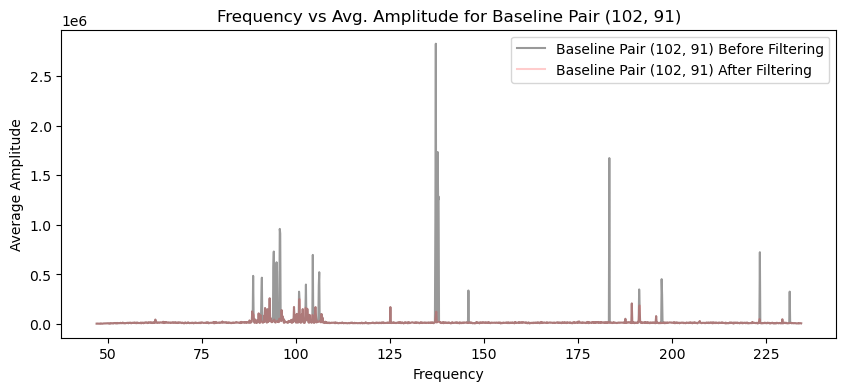

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.17381509 -0.16318551 -0.13933215 ... -0.09315737 -0.09470773
 -0.08556083]


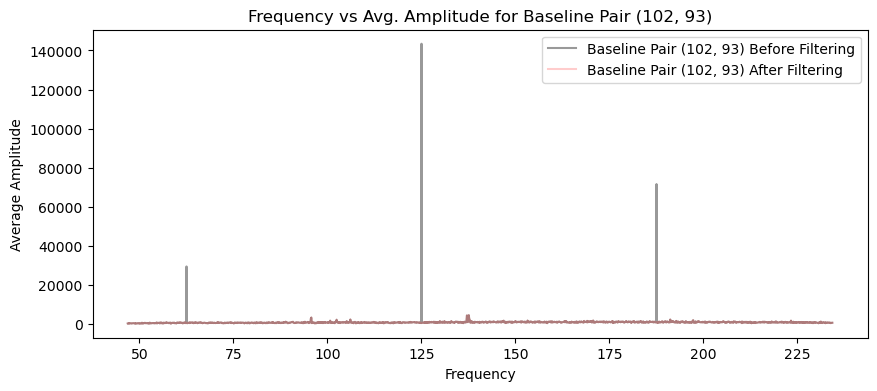

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.19566914 -0.18978529 -0.18021178 ... -0.16629023 -0.17027266
 -0.16821428]


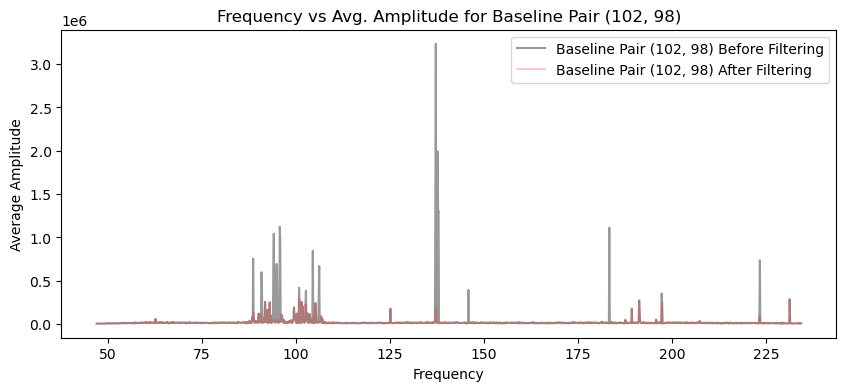

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.16454567 -0.16353197 -0.17744065 ... -0.14619153 -0.16259426
 -0.15069437]


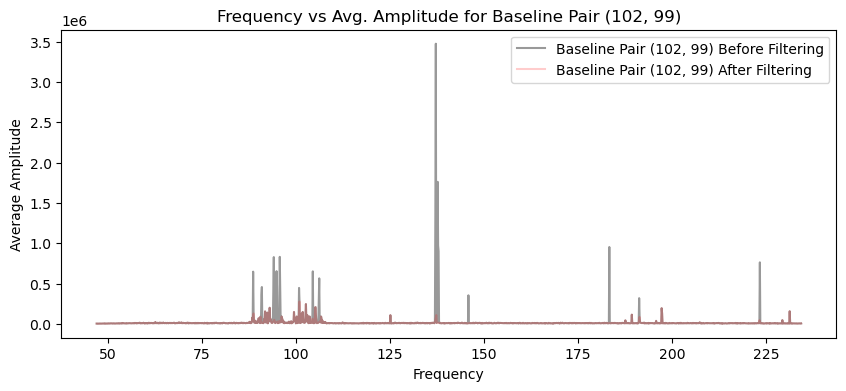

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17167204 -0.17648253 -0.16857905 ... -0.15405898 -0.13975044
 -0.1473199 ]


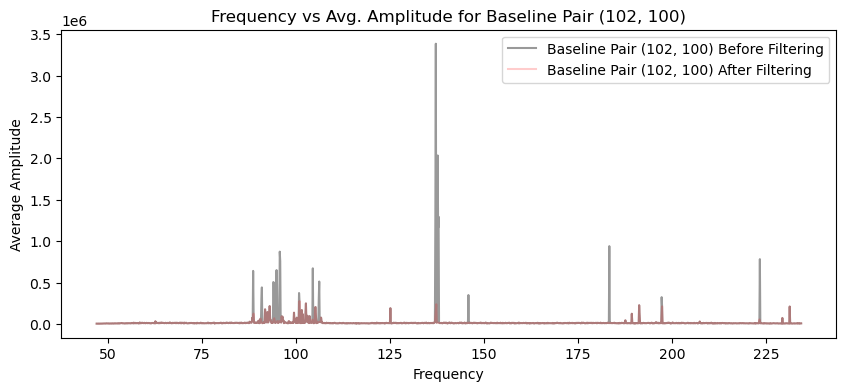

freqs shape: (1536,)
freqs_filtered shape: (1505,)
amplitudes_filtered shape: (20, 1505)
Threshold for baseline: [-0.28007403 -0.29091551 -0.27046119 ... -0.24297042 -0.28359772
 -0.24409145]


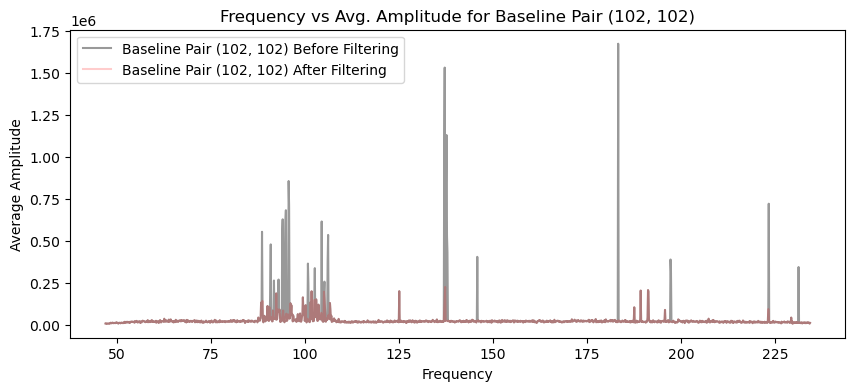

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.1667536  -0.15878682 -0.16226452 ... -0.14157158 -0.15443622
 -0.14929529]


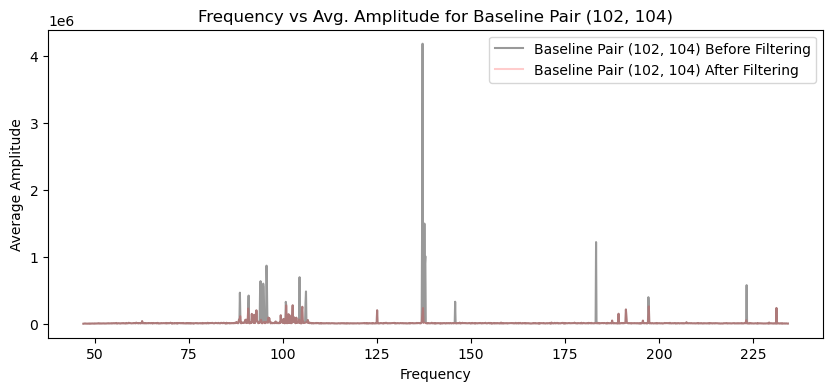

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1782032  -0.18319723 -0.16959844 ... -0.17568739 -0.16489355
 -0.15835665]


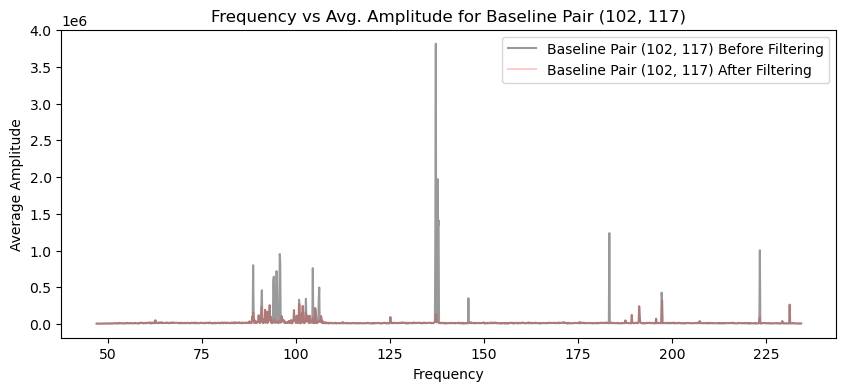

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18523822 -0.18143422 -0.18875588 ... -0.17674153 -0.18162021
 -0.17990189]


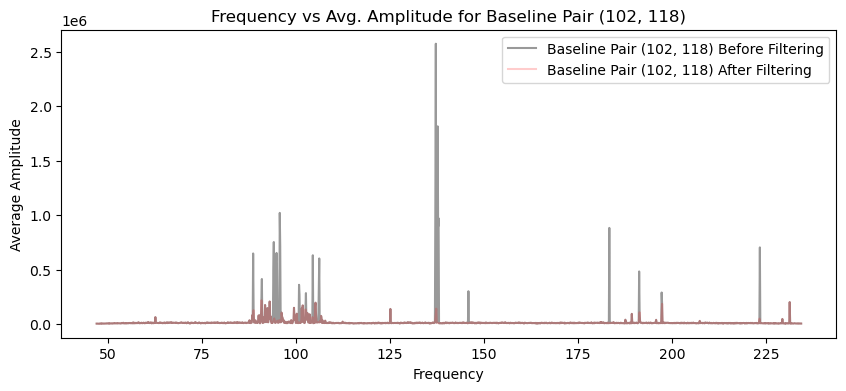

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18849926 -0.18223609 -0.17688785 ... -0.16591571 -0.16270946
 -0.17219673]


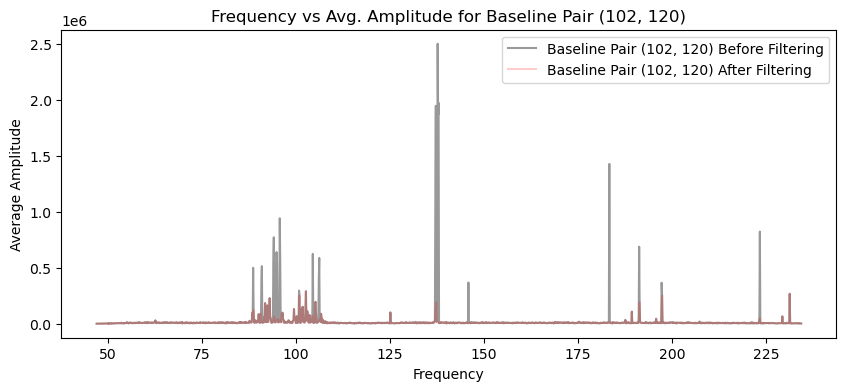

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18731342 -0.18129964 -0.19037489 ... -0.1751437  -0.17147963
 -0.17329568]


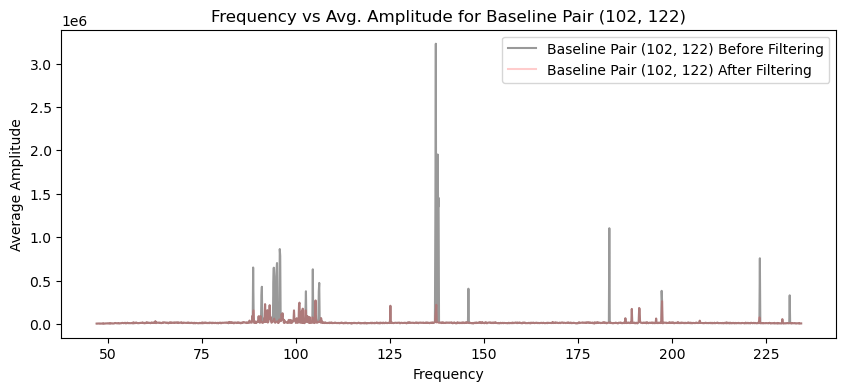

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18206419 -0.17809159 -0.19094796 ... -0.15977444 -0.18062087
 -0.17060351]


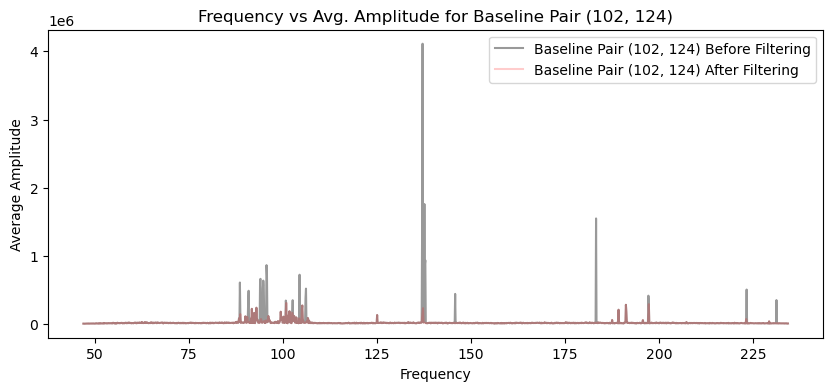

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.19793948 -0.18498981 -0.19768092 ... -0.1756886  -0.13766492
 -0.16994536]


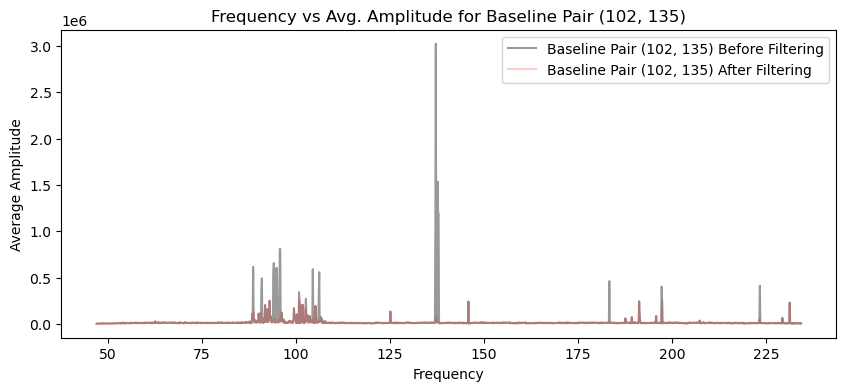

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.19895268 -0.2007523  -0.19852355 ... -0.17361748 -0.18146686
 -0.15907853]


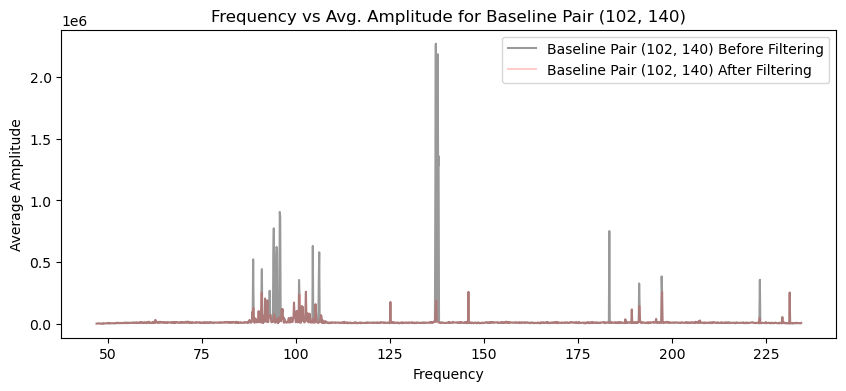

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.20934563 -0.19235203 -0.20785893 ... -0.18138518 -0.16058177
 -0.19450678]


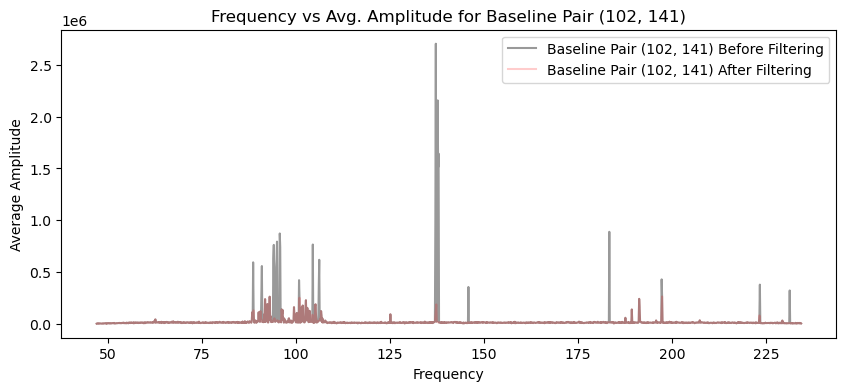

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.14159763 -0.14046551 -0.16969439 ... -0.11662124 -0.06360962
 -0.10373356]


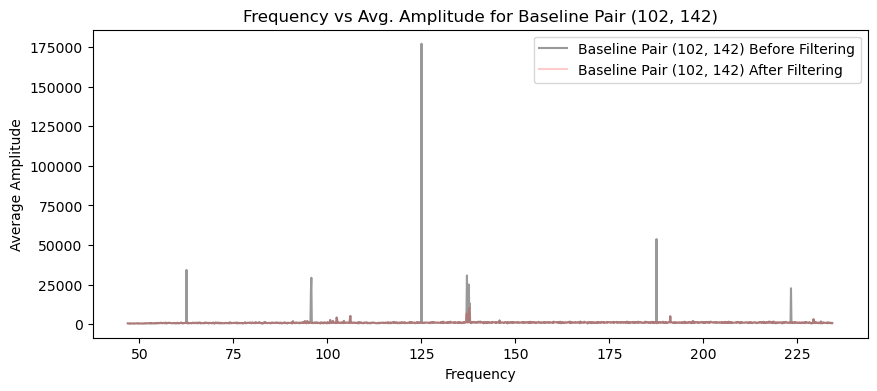

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.20516338 -0.20904564 -0.21124632 ... -0.207662   -0.21341327
 -0.20158406]


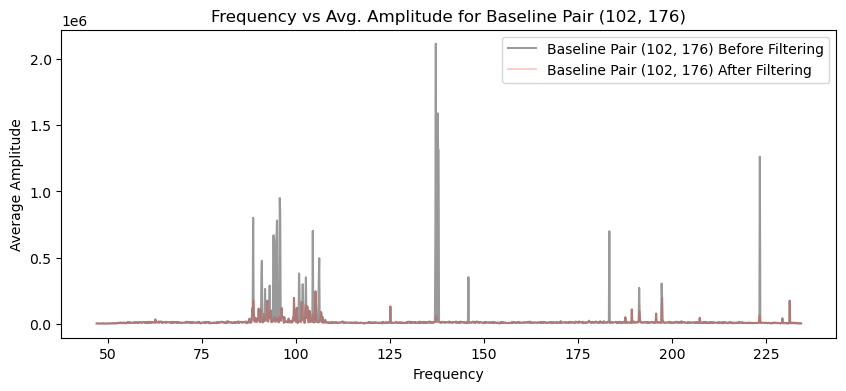

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15033552 -0.156355   -0.16252146 ... -0.15538697 -0.1552609
 -0.1419944 ]


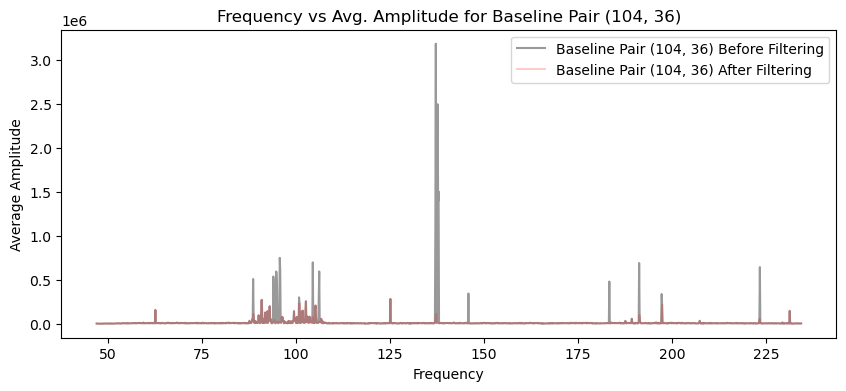

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15271338 -0.14767311 -0.16109092 ... -0.14913971 -0.1360767
 -0.14465872]


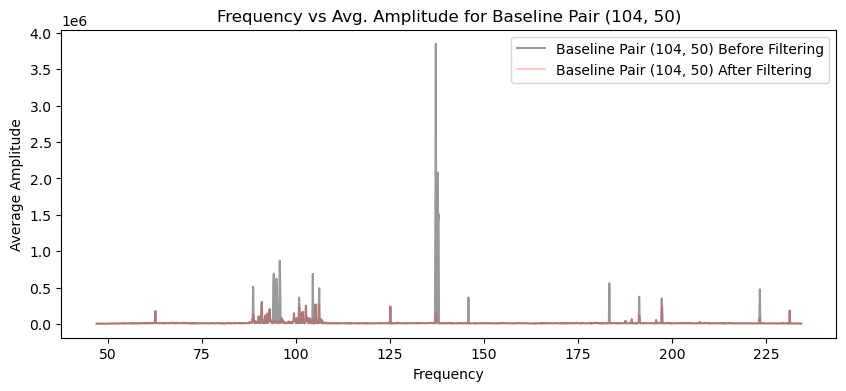

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16550532 -0.1639075  -0.1637104  ... -0.13971986 -0.15766076
 -0.14748109]


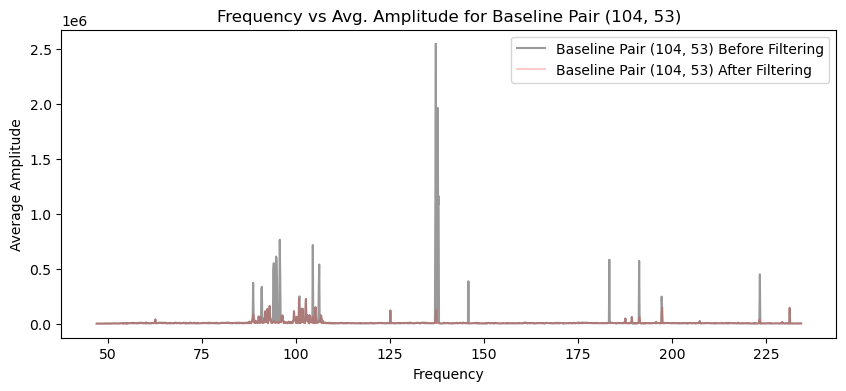

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.17215012 -0.17513196 -0.1757072  ... -0.14567932 -0.16155558
 -0.15491021]


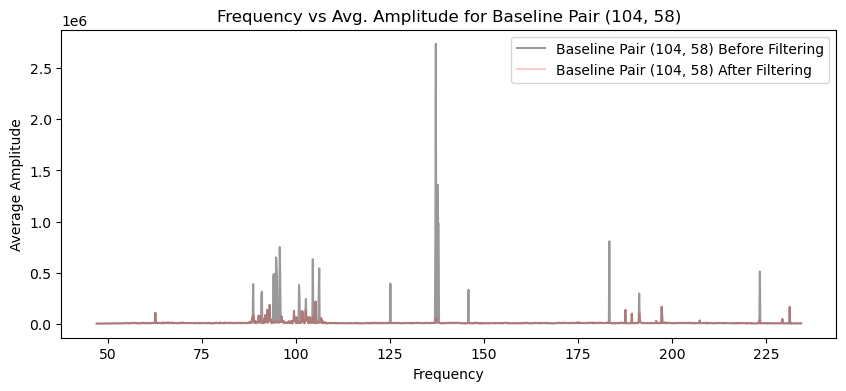

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19558592 -0.20198362 -0.19825022 ... -0.16837174 -0.17374257
 -0.16208992]


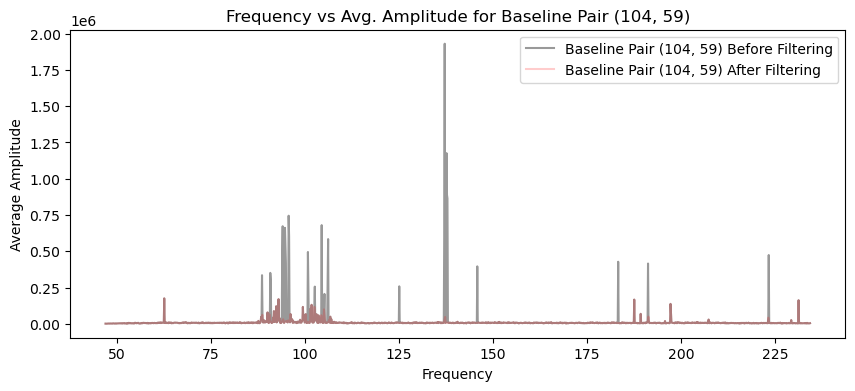

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.18762614 -0.21680524 -0.20982785 ... -0.07808176 -0.06170085
 -0.09186766]


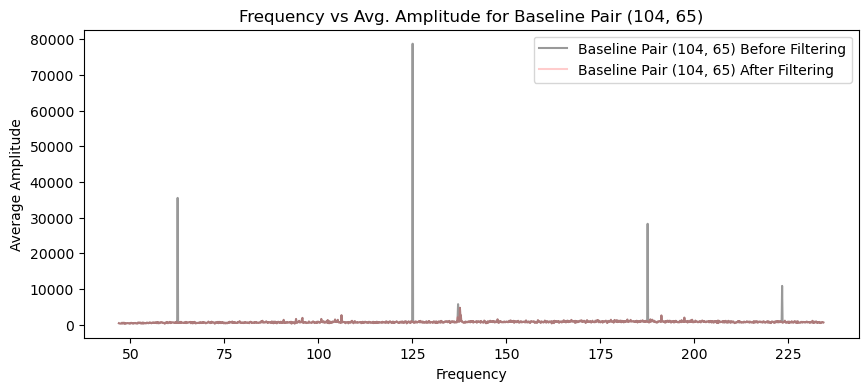

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.12673034 -0.12936615 -0.12476927 ... -0.11300566 -0.10301243
 -0.11204692]


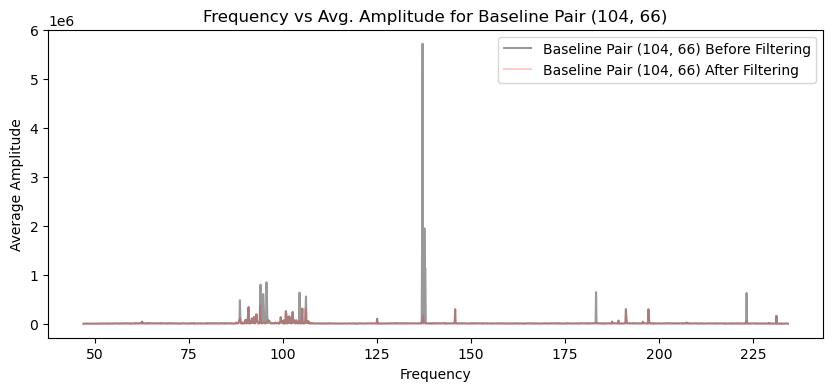

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.1448537  -0.14495726 -0.14141086 ... -0.12478474 -0.12638696
 -0.12493426]


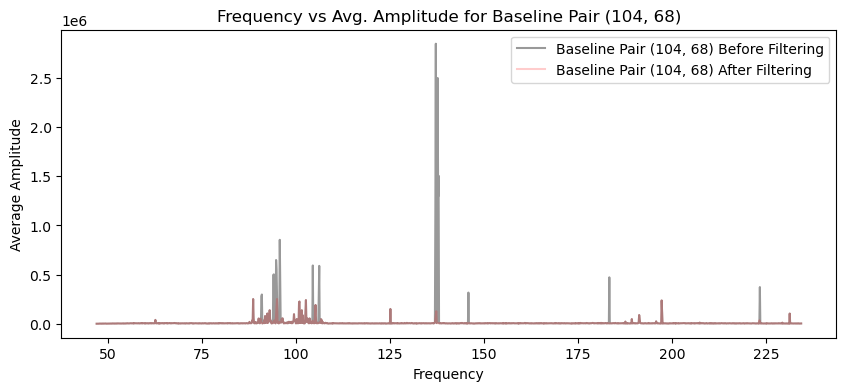

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.11663907 -0.11509891 -0.11562272 ... -0.1069735  -0.10287418
 -0.10564788]


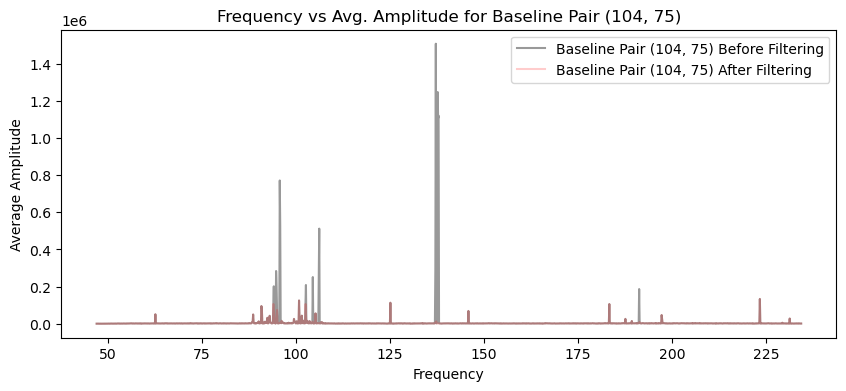

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.11555383 -0.11386243 -0.10770709 ... -0.10297092 -0.09908474
 -0.10843372]


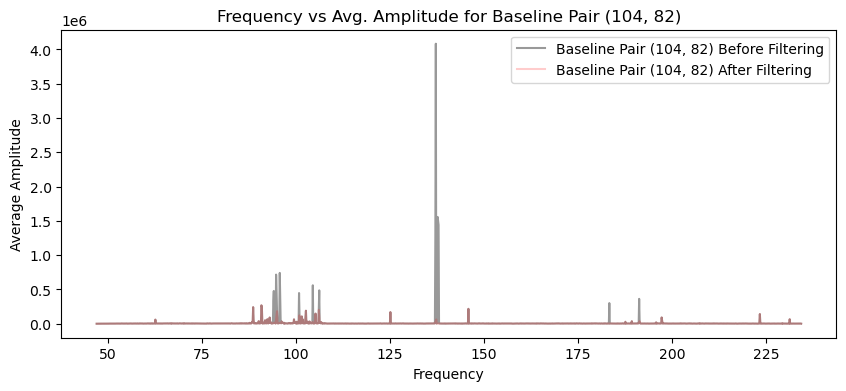

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.14816716 -0.14886611 -0.14640942 ... -0.12388461 -0.11603917
 -0.12372694]


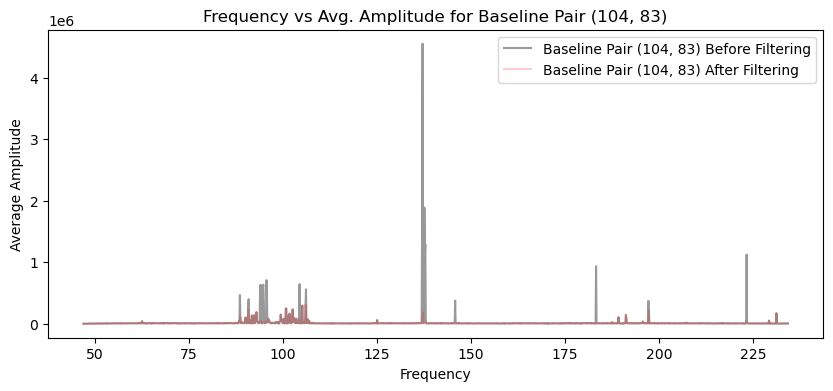

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.23186183 -0.23792015 -0.2256031  ... -0.15386451 -0.22364726
 -0.13389653]


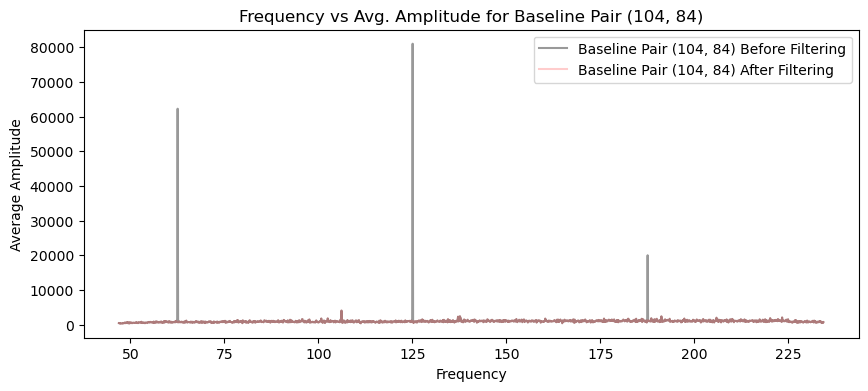

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.17324204 -0.18269408 -0.17635268 ... -0.17178926 -0.15698399
 -0.15696209]


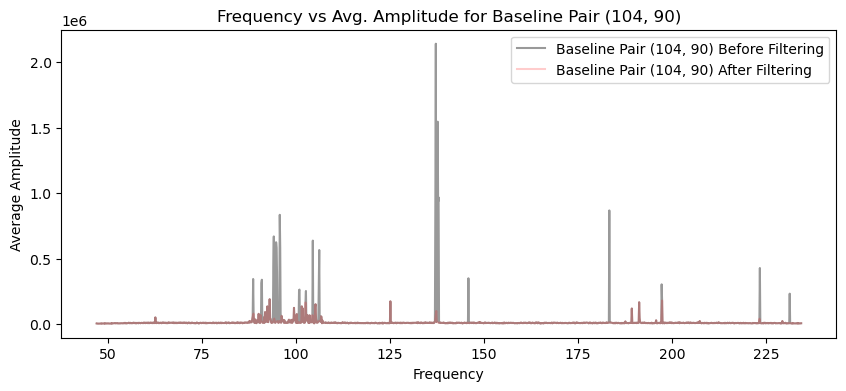

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18206472 -0.17622971 -0.16847022 ... -0.16746062 -0.1456106
 -0.16345169]


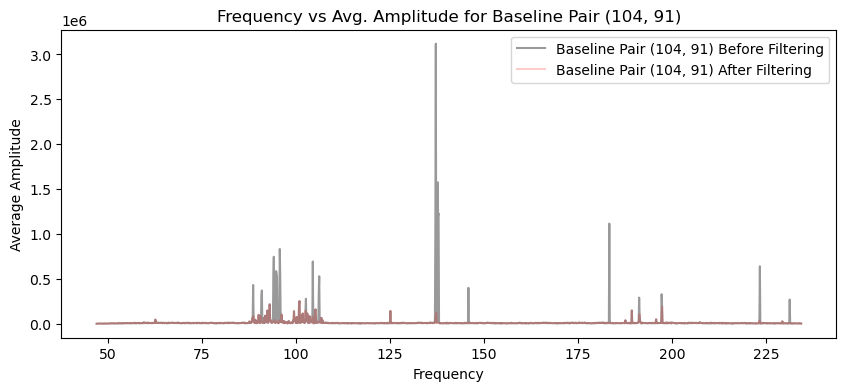

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.13191018 -0.1355736  -0.12665307 ... -0.08575827 -0.07152105
  0.04249626]


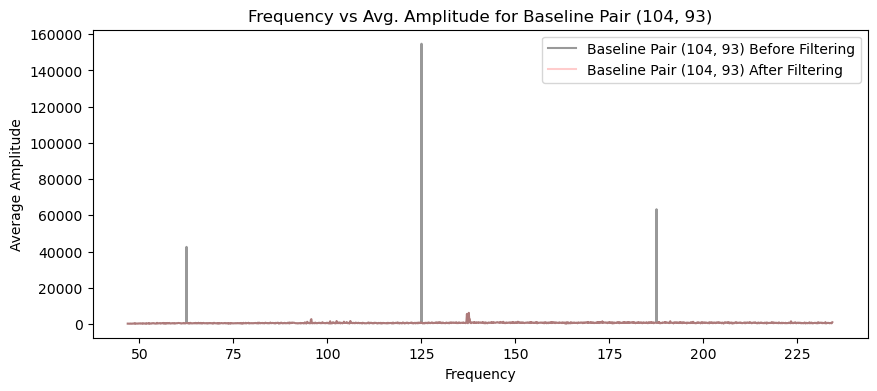

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15415293 -0.15489831 -0.15297816 ... -0.14396388 -0.13751738
 -0.13117015]


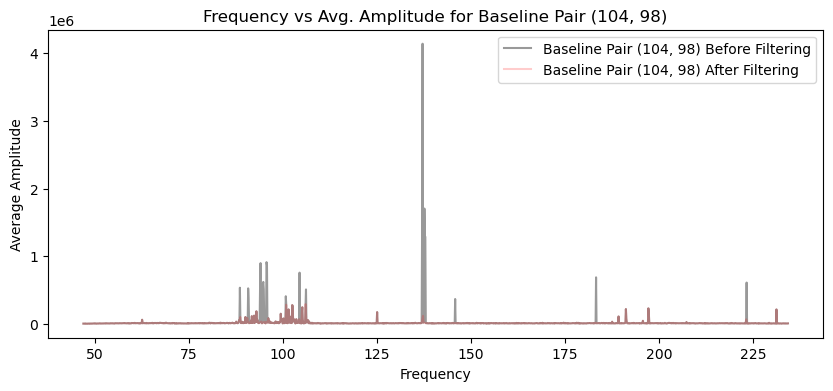

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.12411897 -0.11980642 -0.1192635  ... -0.10972427 -0.10761538
 -0.11567779]


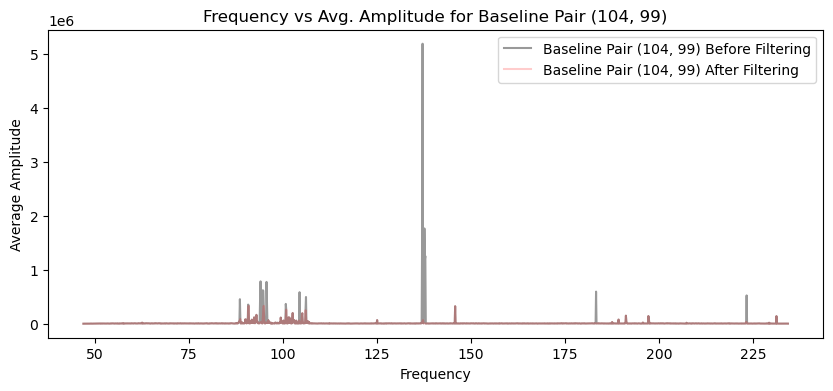

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15792699 -0.15795774 -0.16541751 ... -0.16520628 -0.15769564
 -0.15158385]


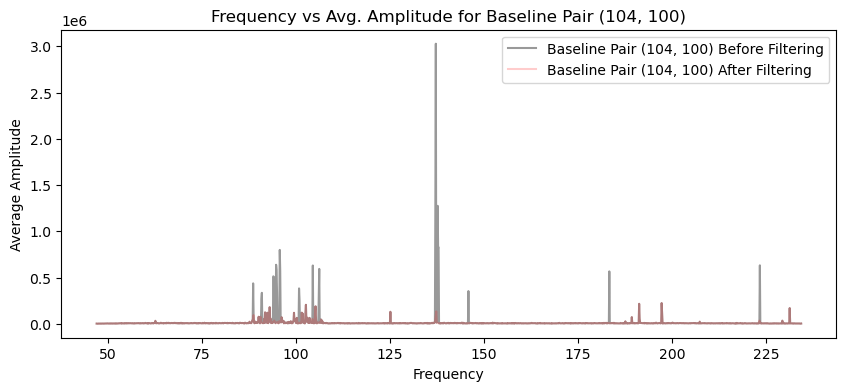

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19350407 -0.19179085 -0.19030249 ... -0.18297184 -0.17549163
 -0.19657114]


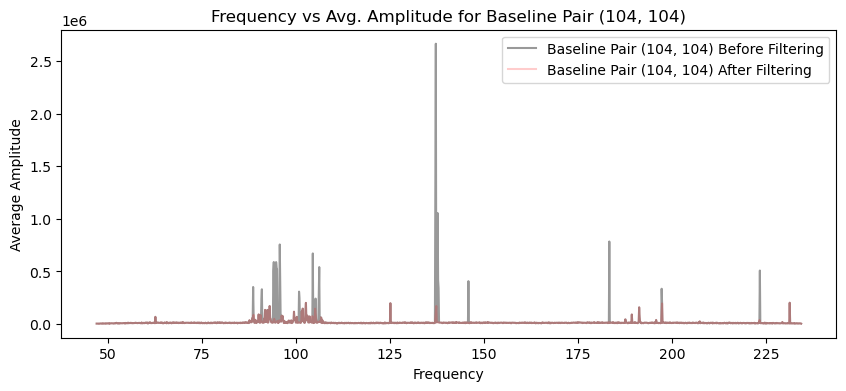

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15507502 -0.14815136 -0.15345606 ... -0.12999674 -0.13698864
 -0.12983558]


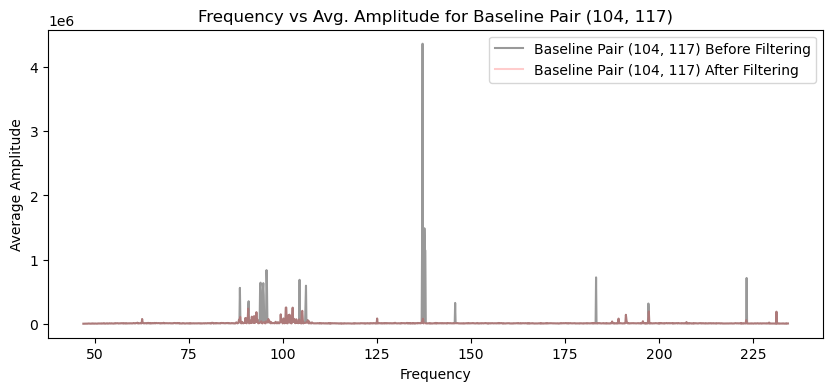

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15382044 -0.14307273 -0.14508399 ... -0.12346371 -0.13623
 -0.13590166]


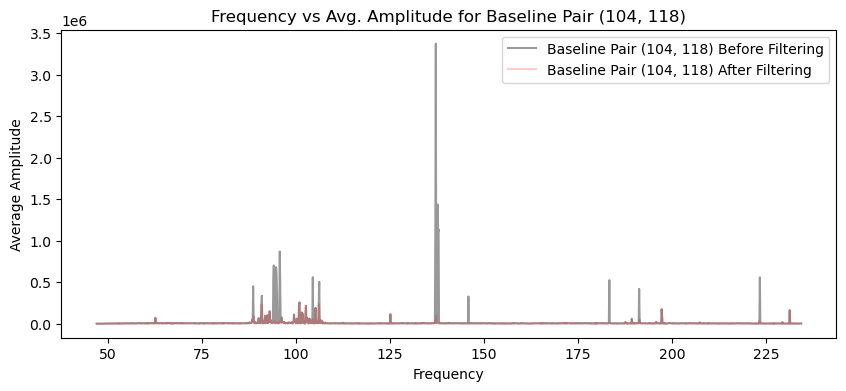

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17005839 -0.16467395 -0.17358613 ... -0.15778752 -0.15131628
 -0.17292458]


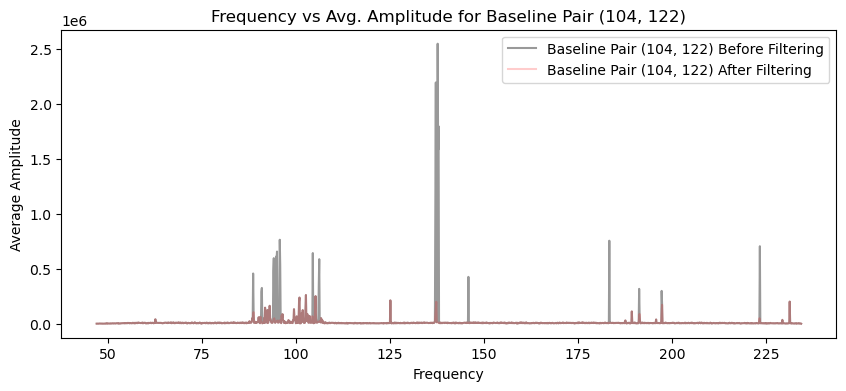

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15788249 -0.16086389 -0.16229999 ... -0.13528603 -0.14821089
 -0.12972673]


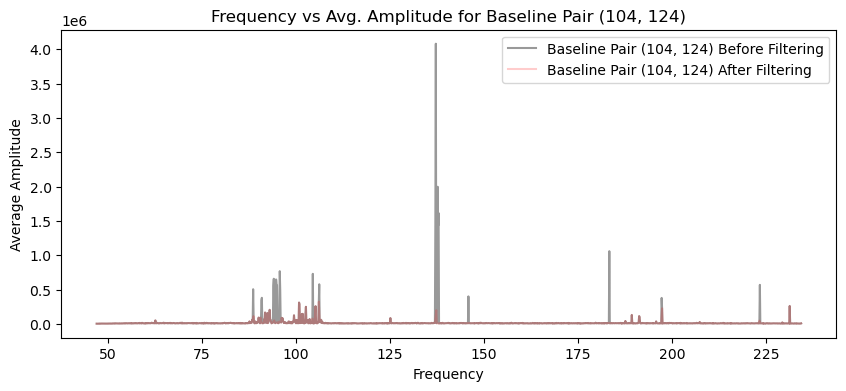

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17843865 -0.17002055 -0.17864544 ... -0.13714942 -0.16174267
 -0.14994363]


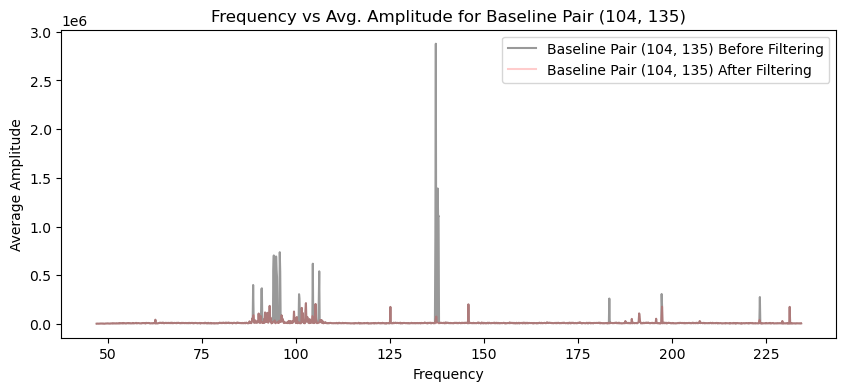

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1721779  -0.1582455  -0.16853929 ... -0.13411432 -0.13592499
 -0.14445959]


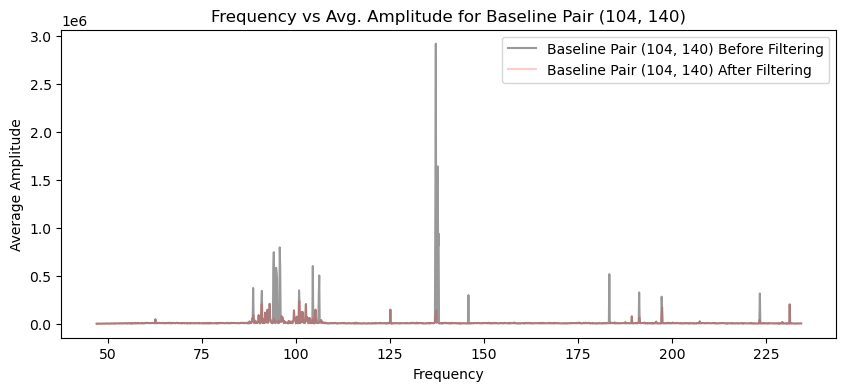

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.15206497 -0.14158622 -0.13872824 ... -0.13048983 -0.13205946
 -0.13628874]


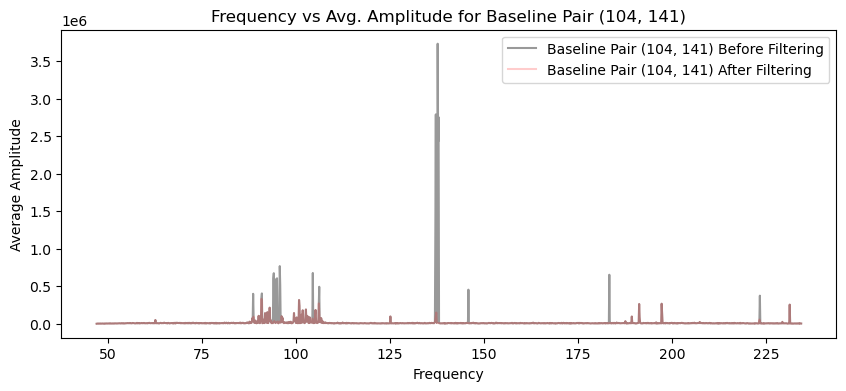

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.12838595 -0.12795502 -0.12778337 ... -0.02422124 -0.07621032
 -0.06802911]


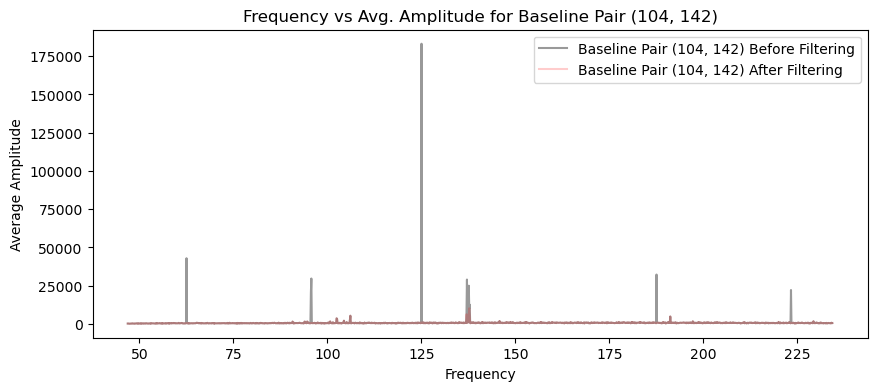

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.21397685 -0.20865237 -0.21529633 ... -0.17907685 -0.17014637
 -0.16985416]


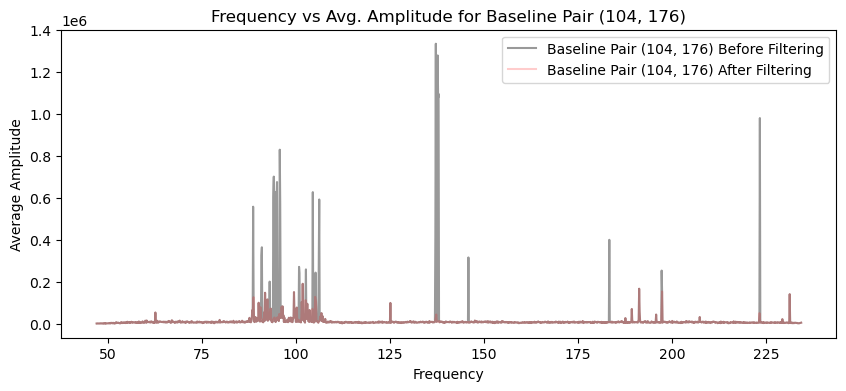

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.19031207 -0.18748441 -0.19650323 ... -0.17147497 -0.15608549
 -0.15512054]


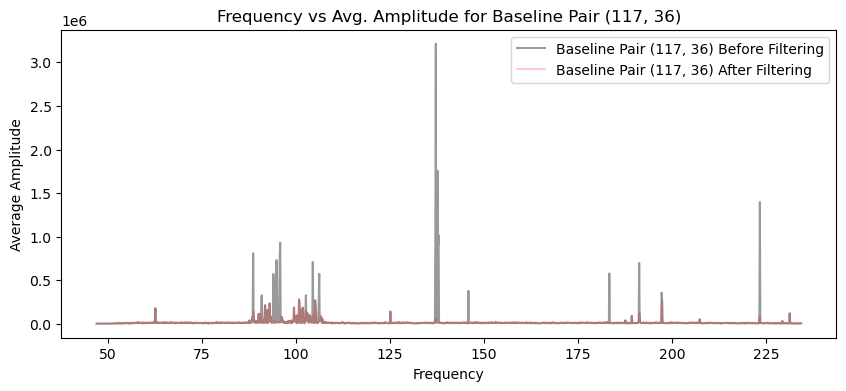

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.17491042 -0.1783051  -0.16897608 ... -0.15360771 -0.15877156
 -0.13810595]


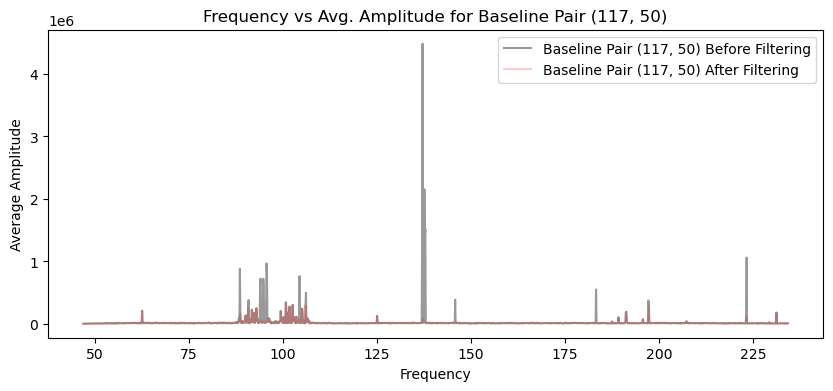

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.18431701 -0.18264497 -0.18300427 ... -0.14899486 -0.17785141
 -0.17698308]


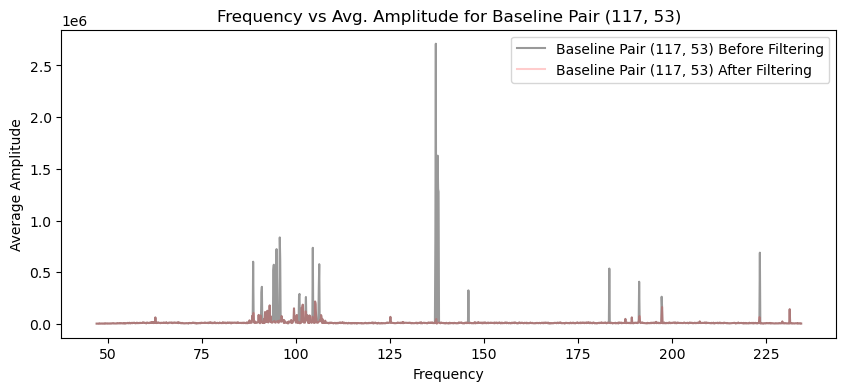

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.21157905 -0.21397712 -0.20414293 ... -0.1779264  -0.18162709
 -0.19438731]


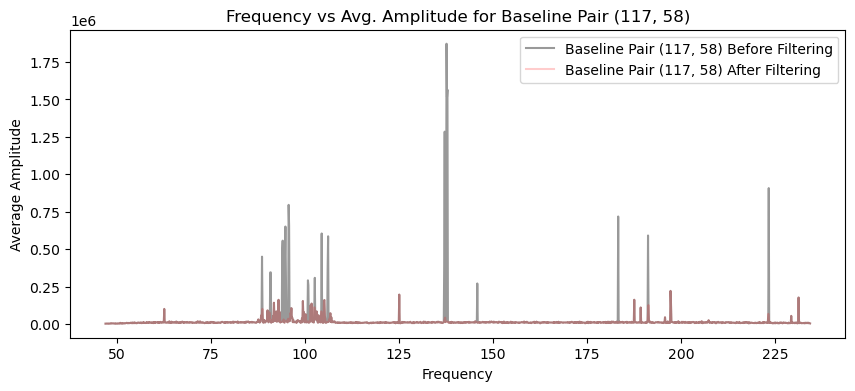

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.20403588 -0.2068152  -0.19901921 ... -0.16414325 -0.19742655
 -0.17294488]


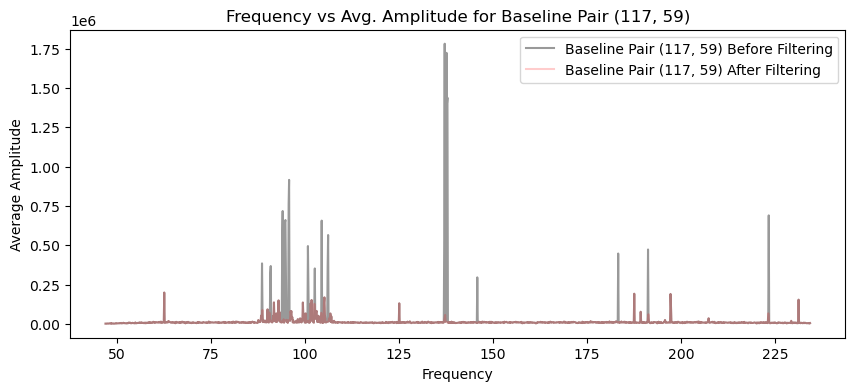

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.3588938  -0.32988132 -0.39865943 ... -0.17891355 -0.01186168
 -0.18500192]


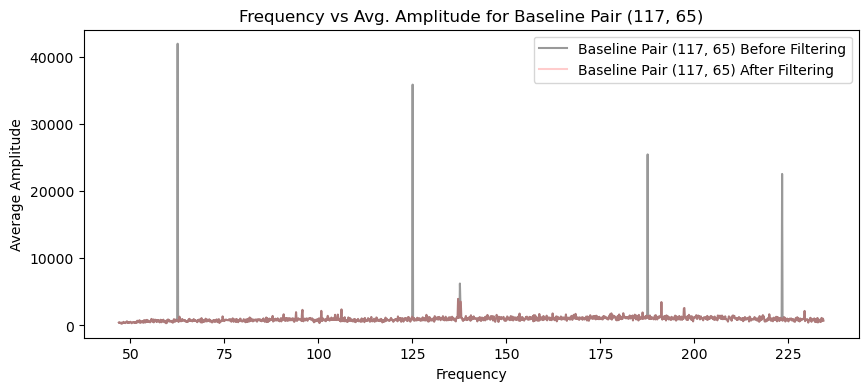

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17325746 -0.16112166 -0.16873125 ... -0.15691145 -0.14877062
 -0.16753726]


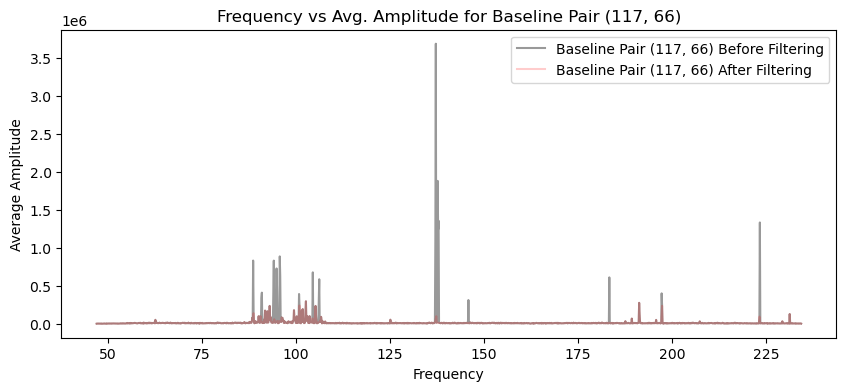

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14837568 -0.14721946 -0.15453221 ... -0.13009157 -0.13757093
 -0.12786822]


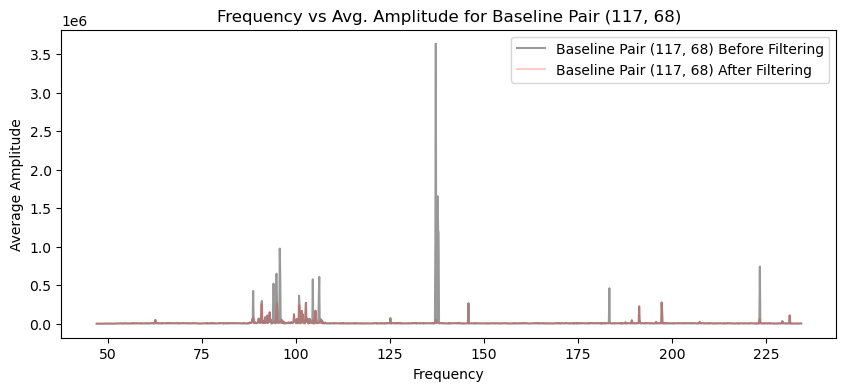

freqs shape: (1536,)
freqs_filtered shape: (1520,)
amplitudes_filtered shape: (20, 1520)
Threshold for baseline: [-0.12262909 -0.12248377 -0.11970364 ... -0.10882273 -0.10627022
 -0.10318342]


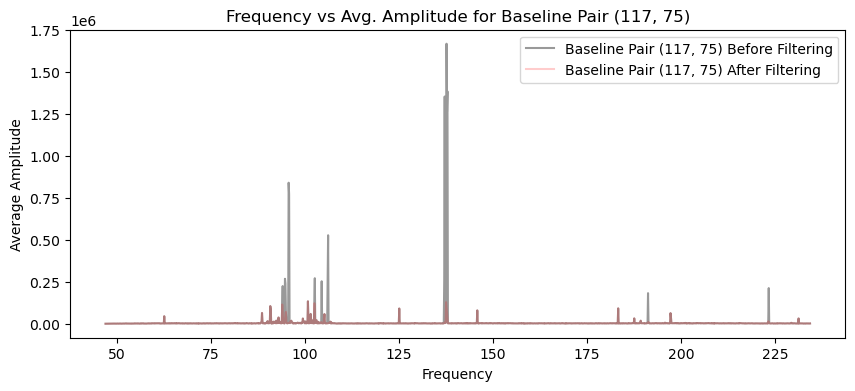

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.20530832 -0.21980813 -0.23616643 ... -0.09842426 -0.08291198
 -0.1980022 ]


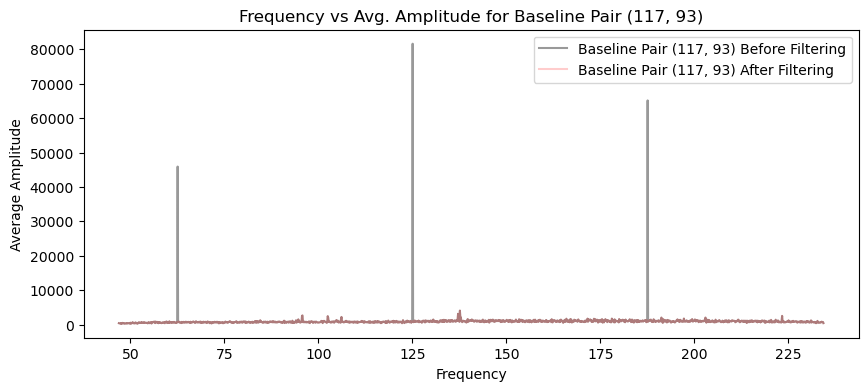

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.24837196 -0.22244822 -0.24773665 ... -0.19969972 -0.23131326
 -0.21920219]


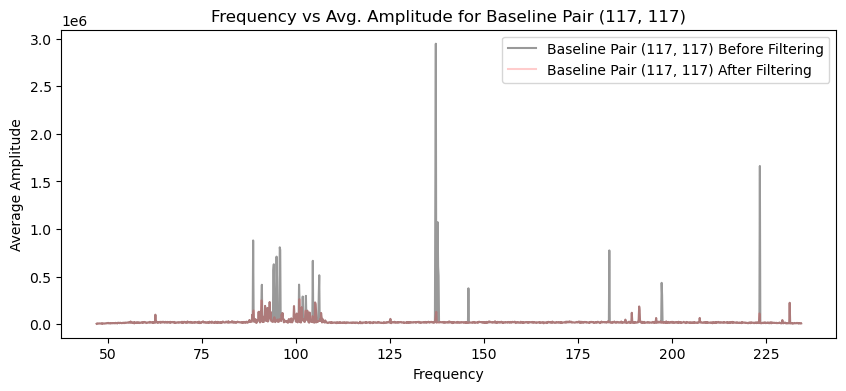

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15727973 -0.15447928 -0.15367927 ... -0.14239796 -0.13663325
 -0.13987167]


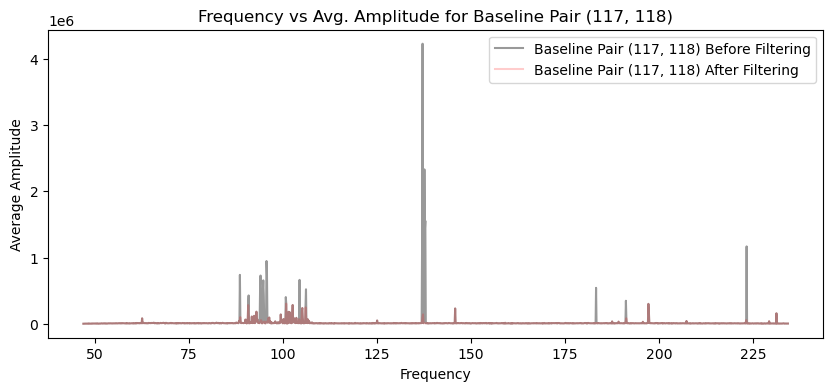

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16650795 -0.15991963 -0.17633241 ... -0.13062942 -0.14783429
 -0.14638349]


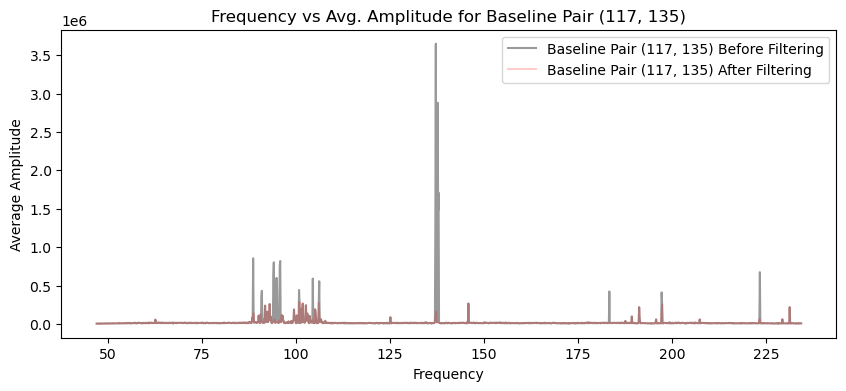

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17610884 -0.17828376 -0.1898343  ... -0.16243688 -0.15544378
 -0.1612682 ]


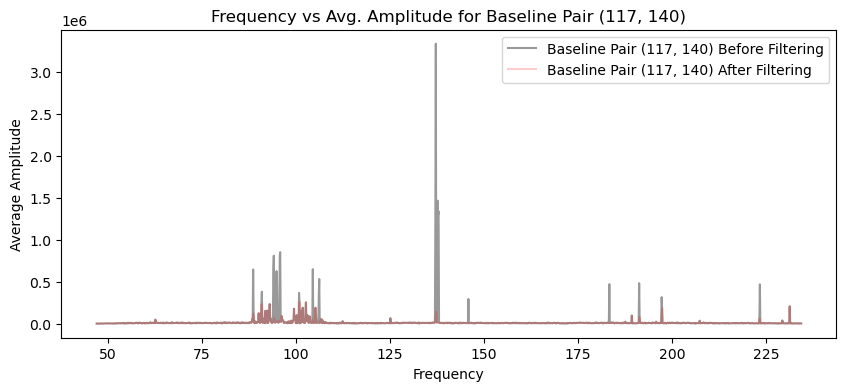

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.1858203  -0.18508953 -0.18836042 ... -0.17363035 -0.19094933
 -0.17763291]


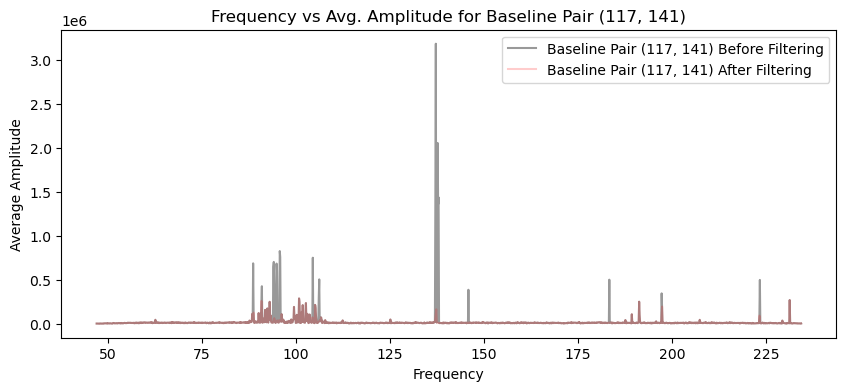

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.21856717 -0.24678814 -0.25522588 ... -0.15946419 -0.11706245
 -0.0288681 ]


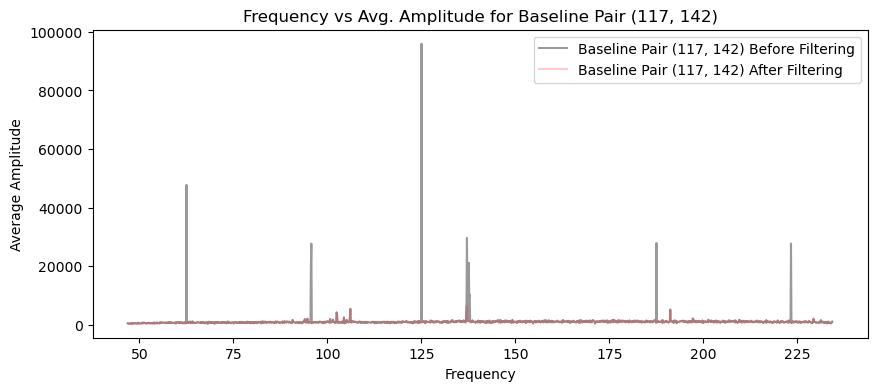

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.1711981  -0.16791469 -0.18332461 ... -0.16361972 -0.17268967
 -0.16288729]


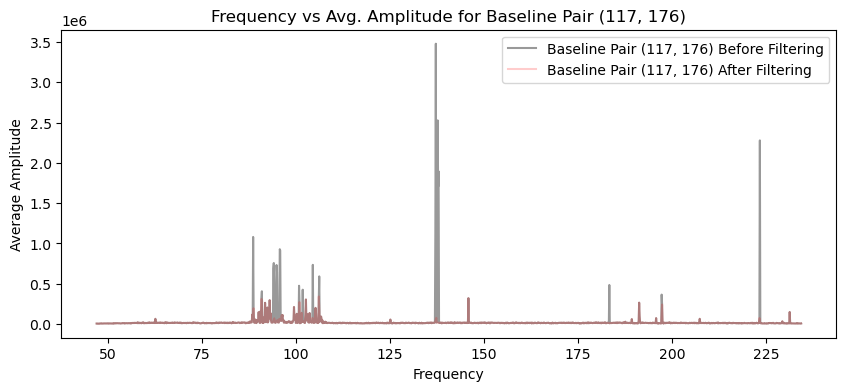

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.1384682  -0.13356382 -0.13768856 ... -0.12667863 -0.13508797
 -0.12779575]


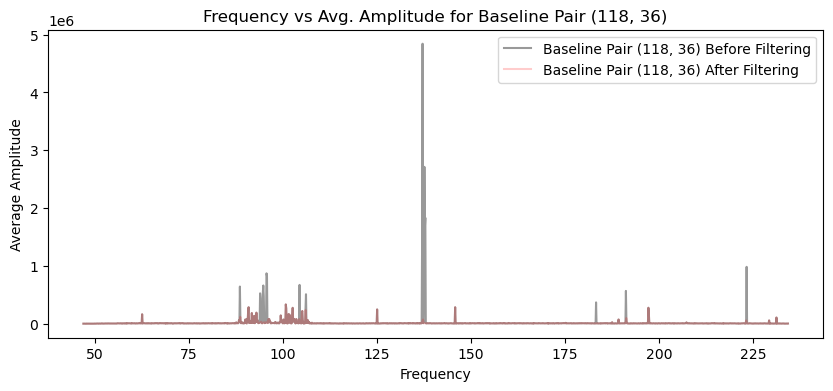

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15651073 -0.14754831 -0.16135172 ... -0.15188344 -0.13706624
 -0.13871074]


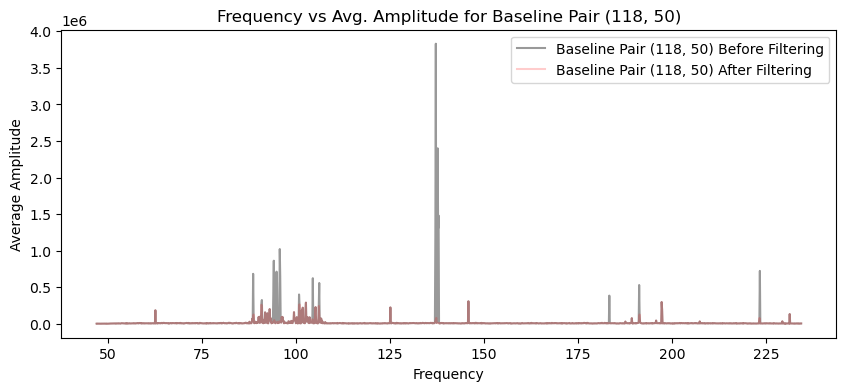

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.19439788 -0.19822823 -0.18027618 ... -0.16101134 -0.17489632
 -0.17826793]


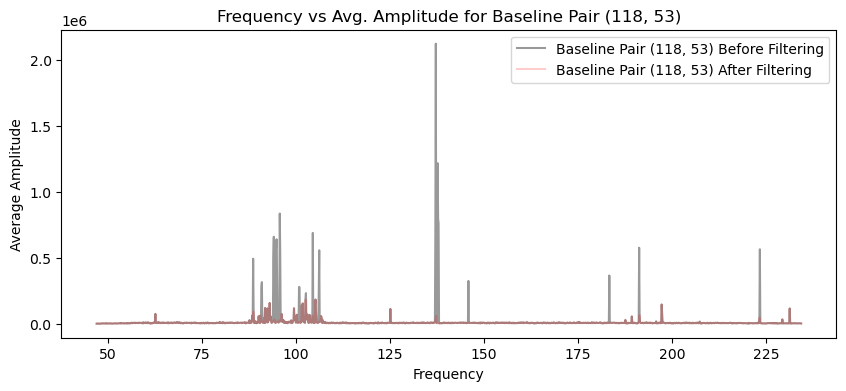

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19235621 -0.2150442  -0.21020937 ... -0.19566454 -0.17922238
 -0.19106748]


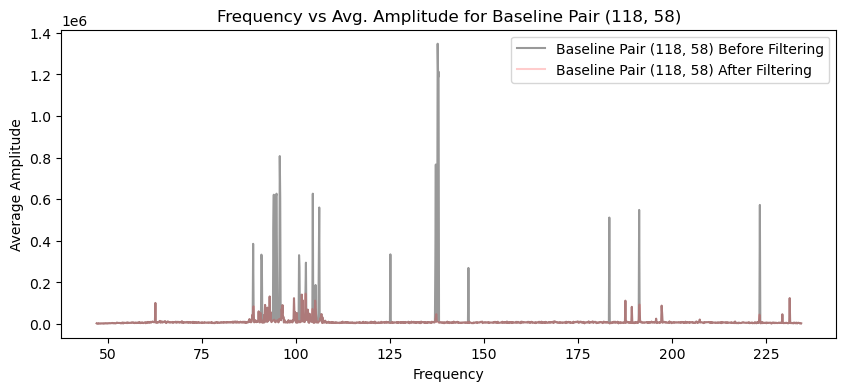

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19656243 -0.18769871 -0.19301595 ... -0.16377097 -0.18287394
 -0.17544045]


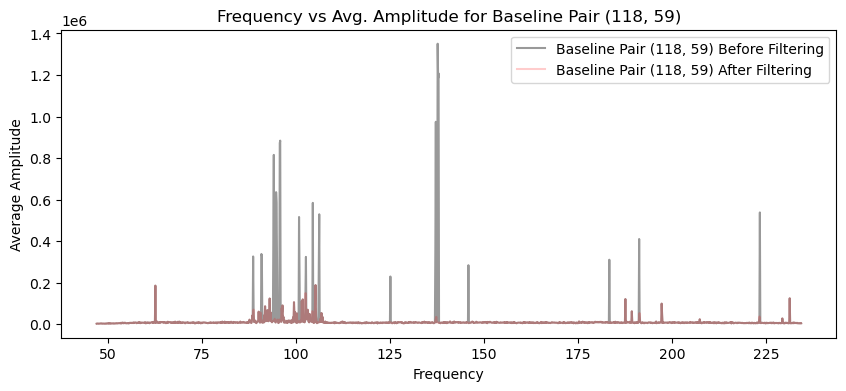

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.20826592 -0.2221405  -0.24313048 ... -0.1176767  -0.20854481
 -0.07123172]


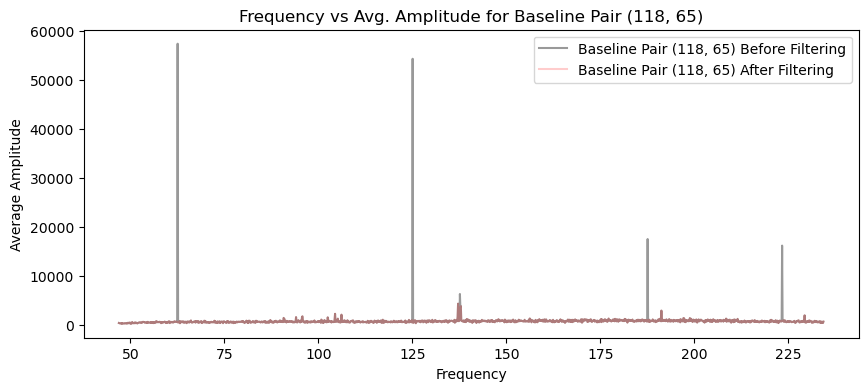

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.13462855 -0.13606491 -0.12864028 ... -0.1272657  -0.12851316
 -0.12324079]


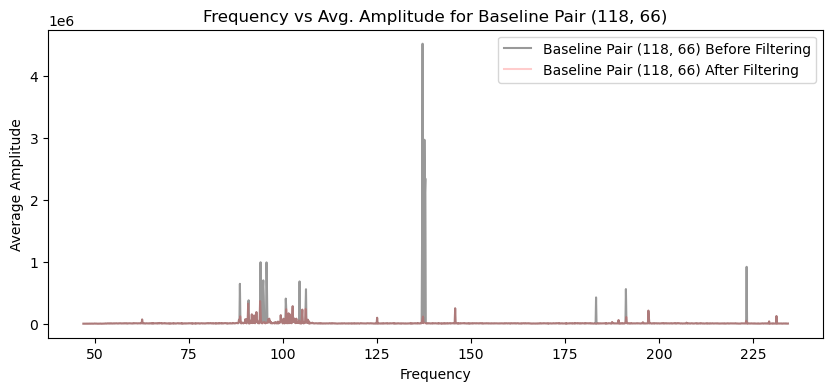

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.1556854  -0.15799304 -0.15570327 ... -0.12758026 -0.13292635
 -0.14958096]


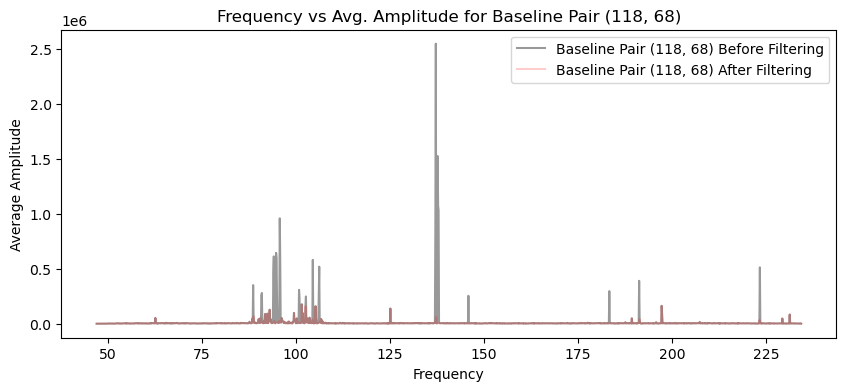

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.12131454 -0.12180324 -0.12221069 ... -0.10356307 -0.10704211
 -0.10884489]


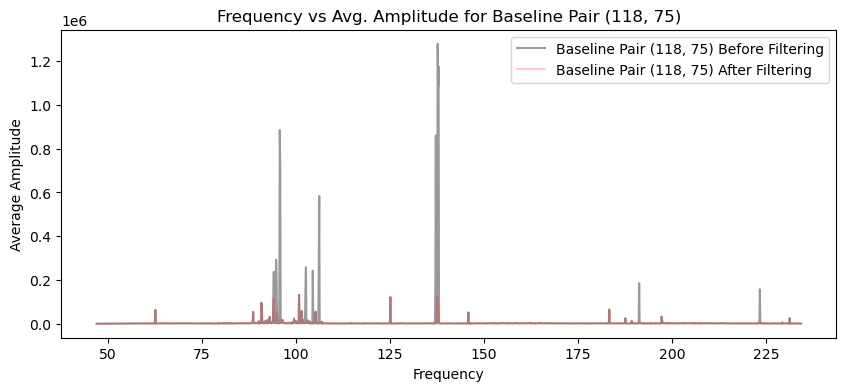

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.12853988 -0.14228994 -0.11650888 ... -0.03718063 -0.10914662
 -0.10418292]


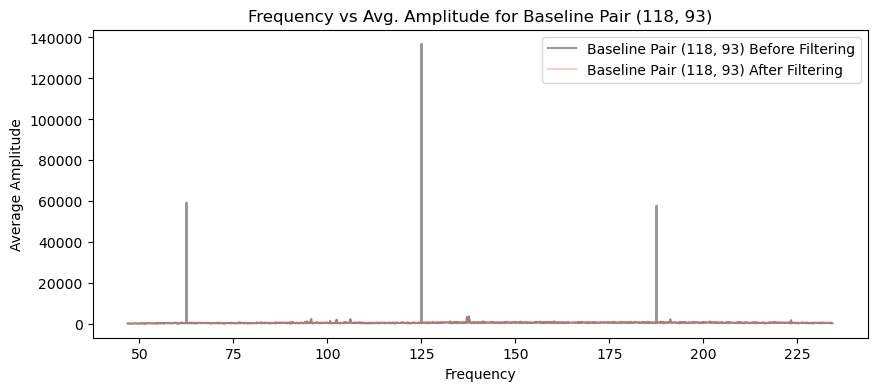

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.22140295 -0.21974591 -0.20782141 ... -0.19529191 -0.1738152
 -0.19109036]


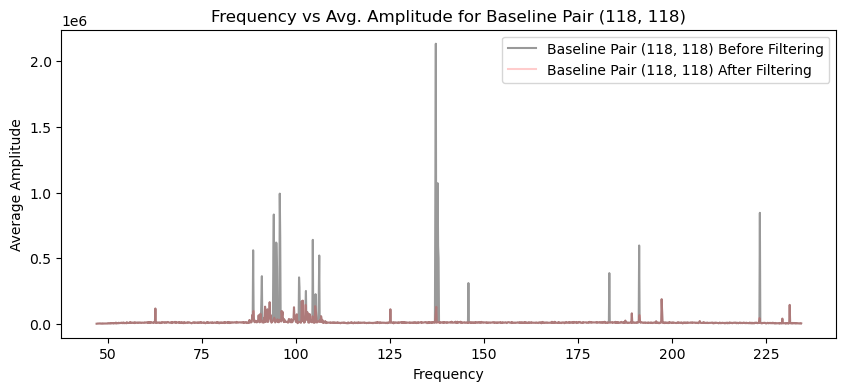

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.18012504 -0.17873482 -0.16841217 ... -0.15483845 -0.15403681
 -0.16197944]


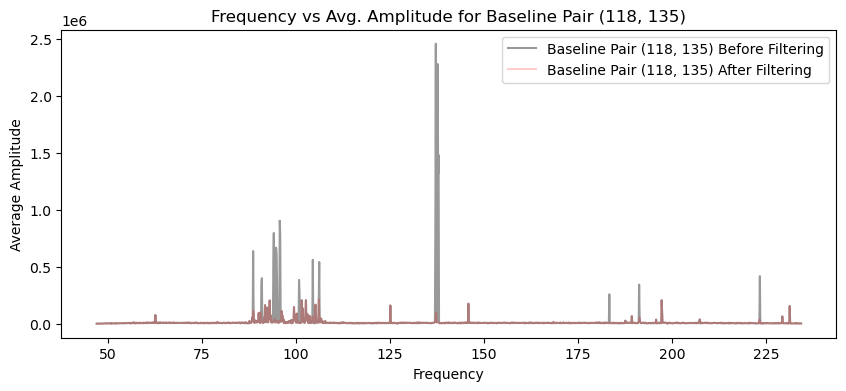

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.1594979  -0.16433832 -0.16118599 ... -0.1452062  -0.14785397
 -0.15719222]


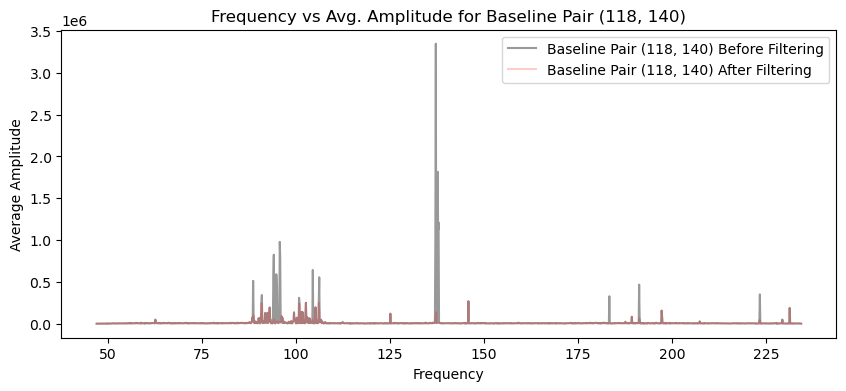

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.17256723 -0.1715364  -0.17446691 ... -0.16017333 -0.16639162
 -0.16767636]


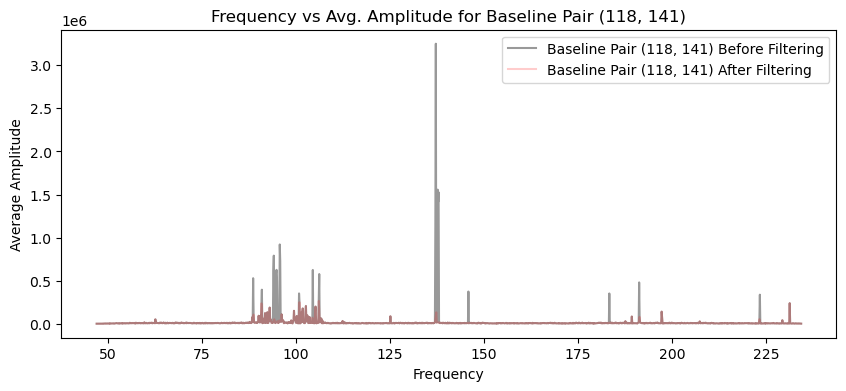

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.1385887  -0.13780291 -0.14229306 ... -0.05495192 -0.08222677
 -0.11178506]


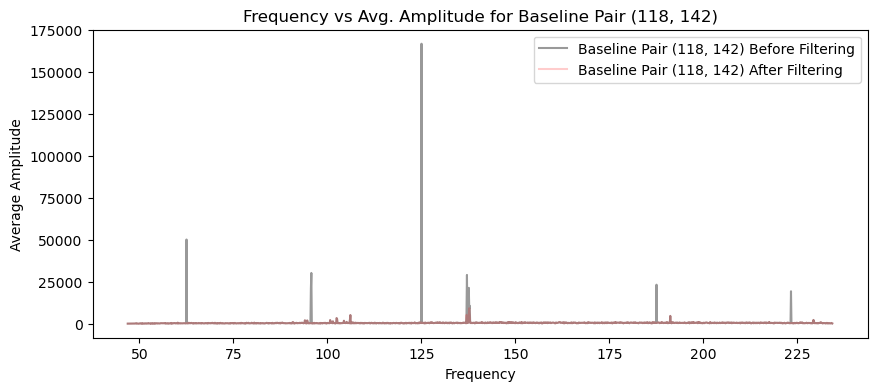

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.16144486 -0.15673737 -0.15633143 ... -0.14423658 -0.15301714
 -0.14327115]


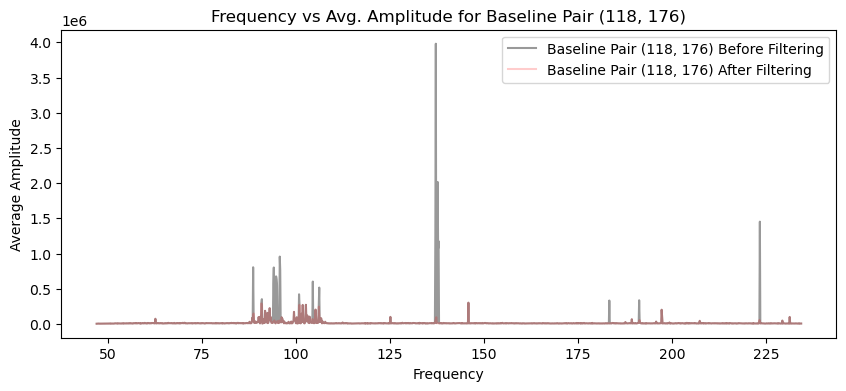

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.14894531 -0.14909814 -0.1445701  ... -0.13385116 -0.12652878
 -0.13229912]


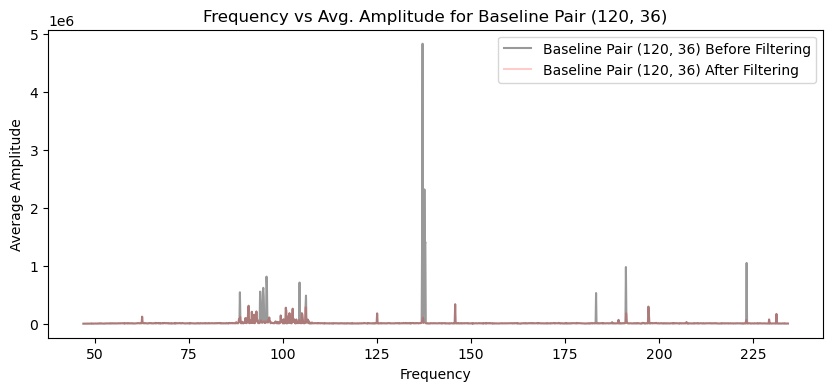

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17594913 -0.16560033 -0.17120844 ... -0.15128697 -0.13194724
 -0.14075199]


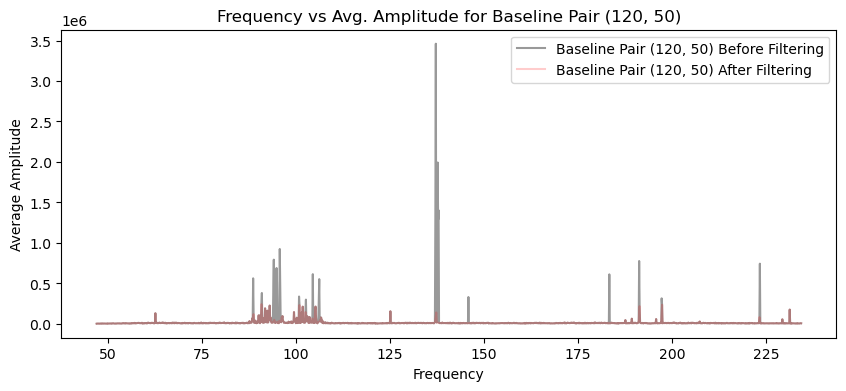

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15667079 -0.15477714 -0.15689829 ... -0.13874082 -0.13005244
 -0.13671356]


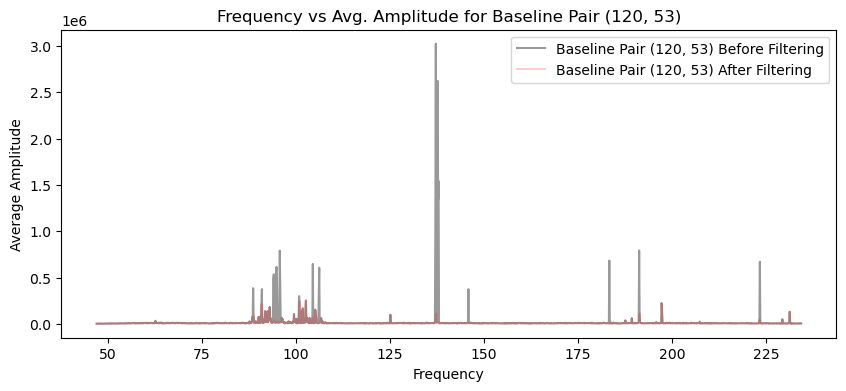

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.20291947 -0.19439104 -0.19926644 ... -0.17442049 -0.1802153
 -0.16468799]


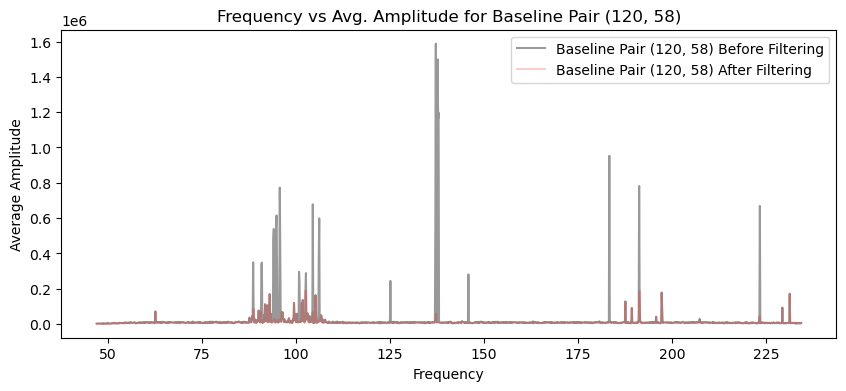

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18783689 -0.19159072 -0.1828245  ... -0.16129153 -0.15780503
 -0.16437629]


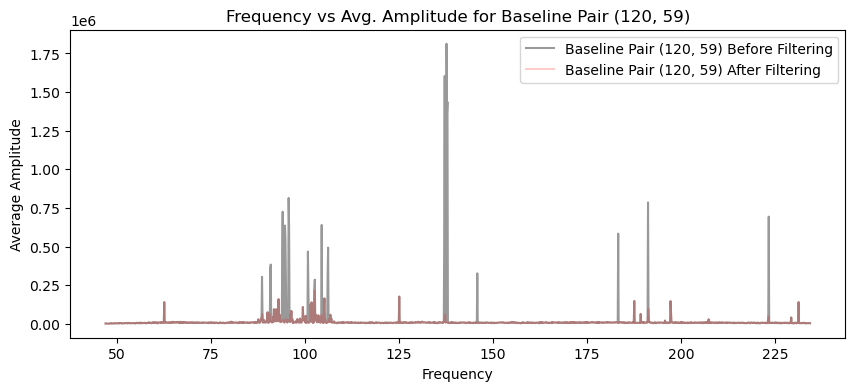

freqs shape: (1536,)
freqs_filtered shape: (1530,)
amplitudes_filtered shape: (20, 1530)
Threshold for baseline: [-0.34250186 -0.33062292 -0.27523738 ... -0.28098556 -0.20809333
 -0.10389462]


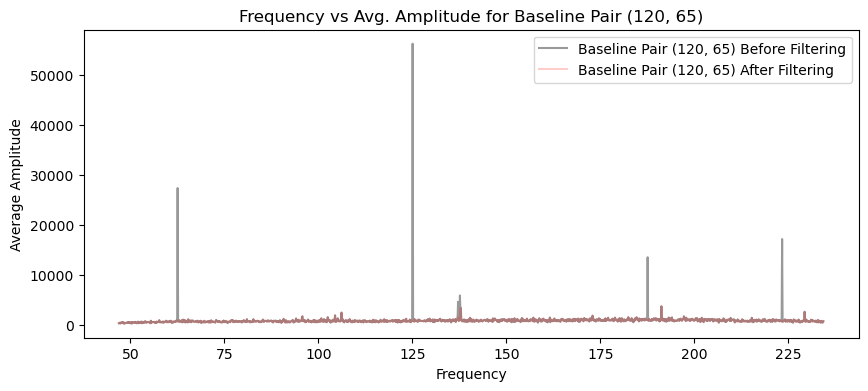

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15170911 -0.15638185 -0.1501811  ... -0.12528789 -0.13651245
 -0.1386311 ]


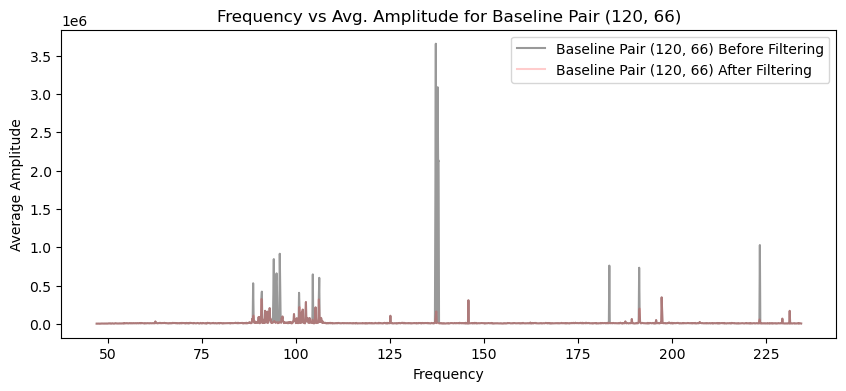

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.13756484 -0.13983107 -0.13321676 ... -0.13072838 -0.13058506
 -0.12756322]


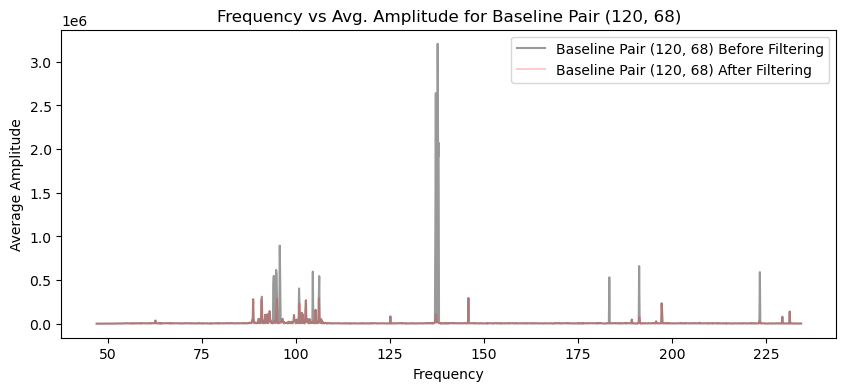

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.12340206 -0.12422733 -0.12619554 ... -0.10982568 -0.11504458
 -0.10772695]


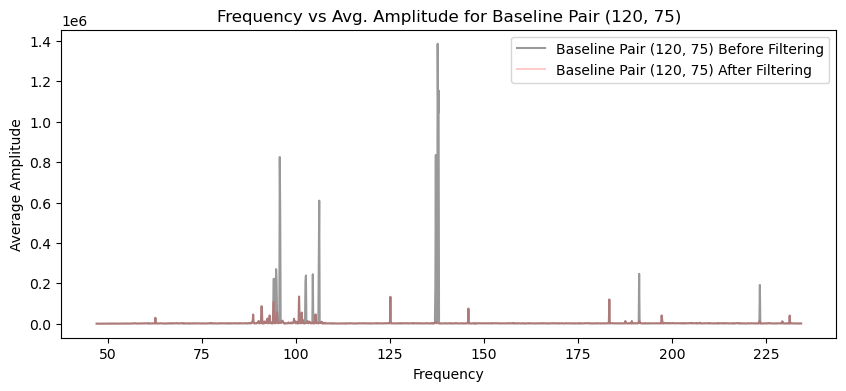

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.11599444 -0.11931502 -0.11453403 ... -0.10801638 -0.11452649
 -0.10431099]


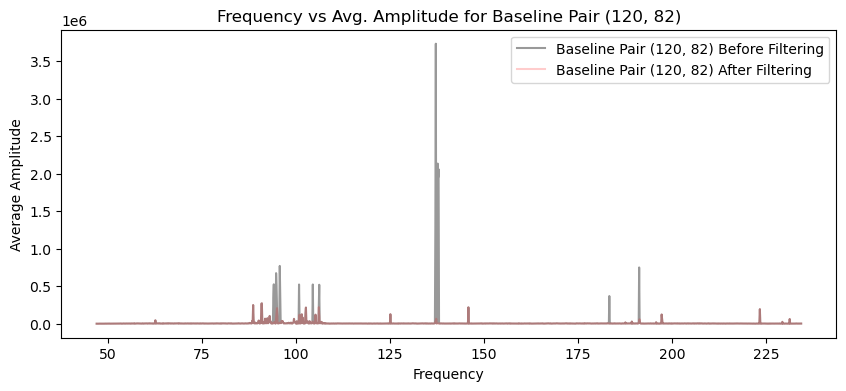

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15921318 -0.16589244 -0.1552732  ... -0.14846343 -0.13634989
 -0.16009263]


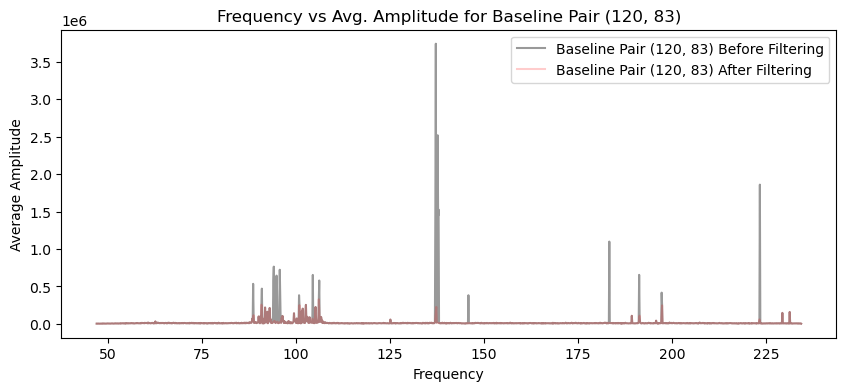

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.41562833 -0.37875583 -0.30184858 ... -0.022091    0.1753904
 -0.20457027]


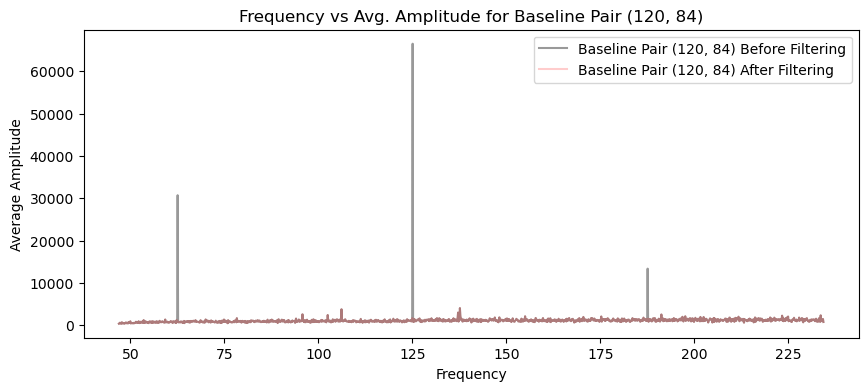

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.18145708 -0.16821928 -0.18056324 ... -0.14361041 -0.12832208
 -0.1622861 ]


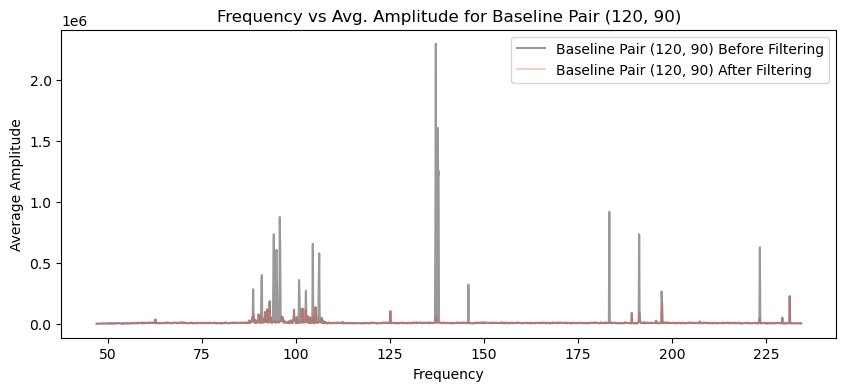

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.18659589 -0.19511135 -0.18920444 ... -0.18329232 -0.16114143
 -0.15532088]


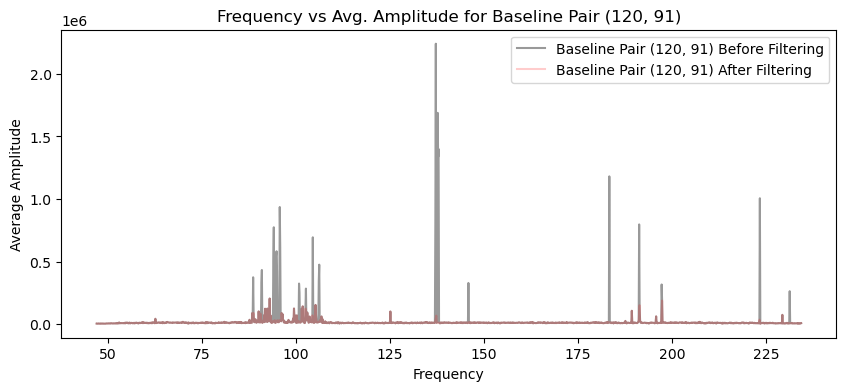

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.17795568 -0.20313926 -0.16268621 ... -0.11529952 -0.06242894
 -0.16362355]


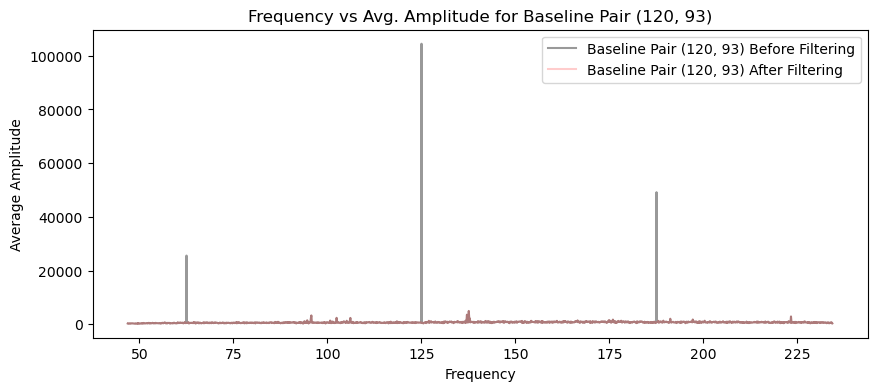

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.16776231 -0.16880074 -0.17315038 ... -0.16152603 -0.15198616
 -0.15449878]


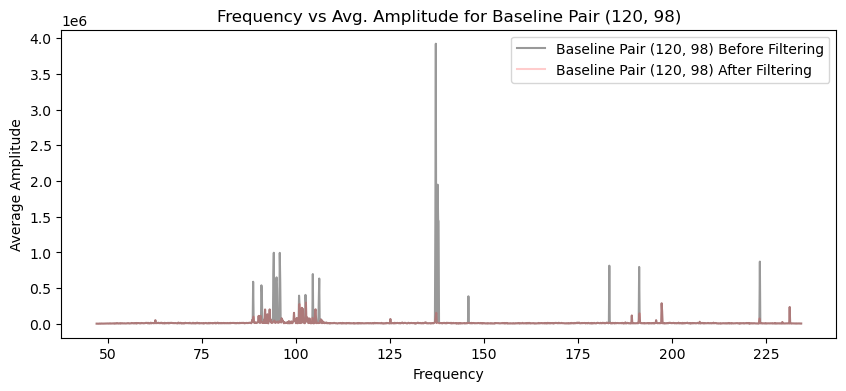

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.13981059 -0.14300577 -0.14338245 ... -0.11988152 -0.13353491
 -0.14083228]


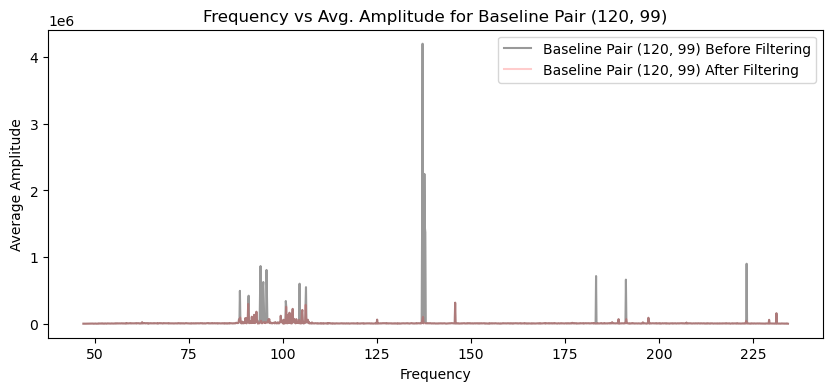

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16468656 -0.15745892 -0.15363845 ... -0.14472857 -0.15053871
 -0.14463859]


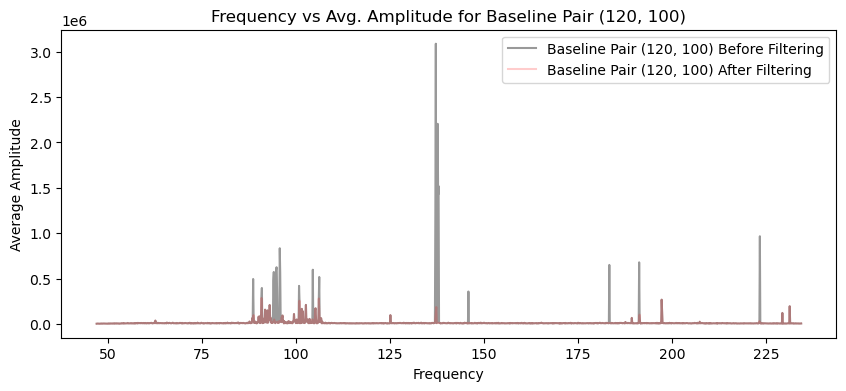

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.15713514 -0.15694864 -0.16380566 ... -0.15343177 -0.15101124
 -0.15102777]


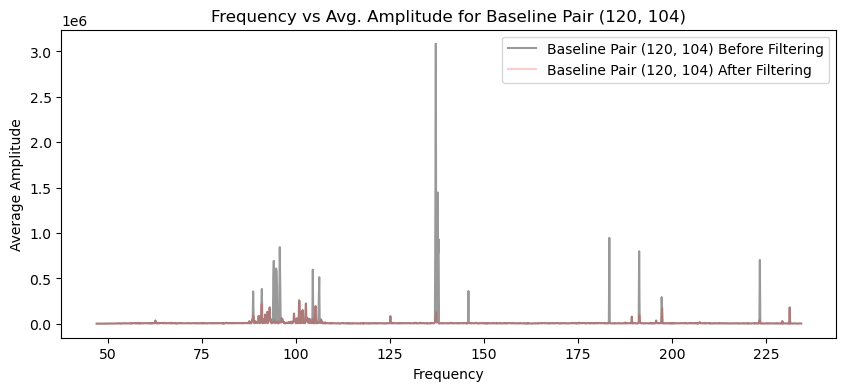

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17227599 -0.16298885 -0.16931861 ... -0.16562544 -0.15575315
 -0.16042493]


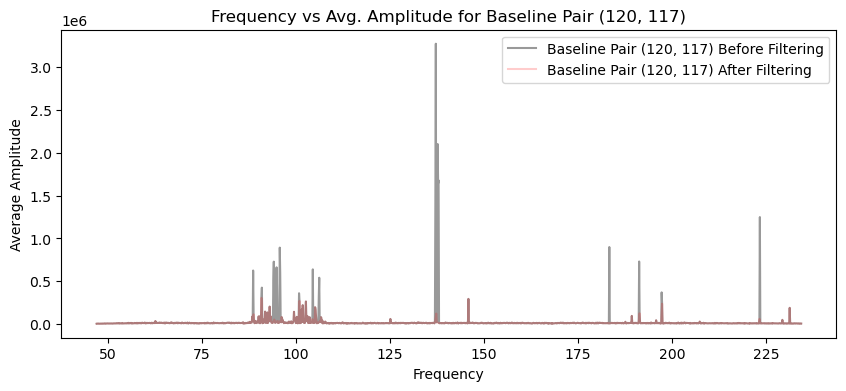

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14743657 -0.15118449 -0.14704157 ... -0.14262675 -0.14198151
 -0.13926967]


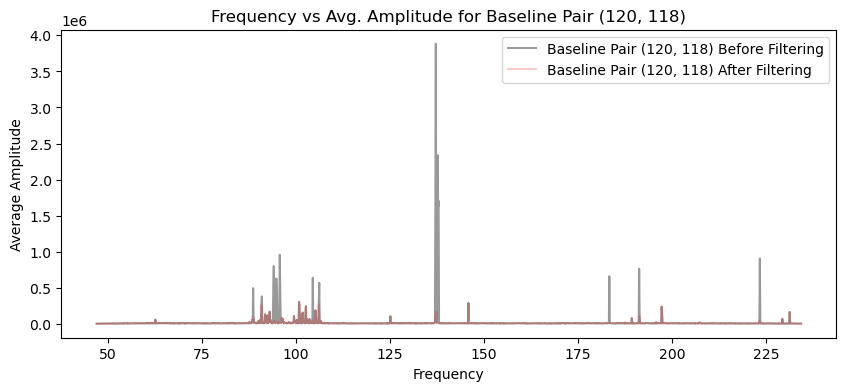

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.22082692 -0.21525305 -0.19802338 ... -0.19054295 -0.19977481
 -0.2082527 ]


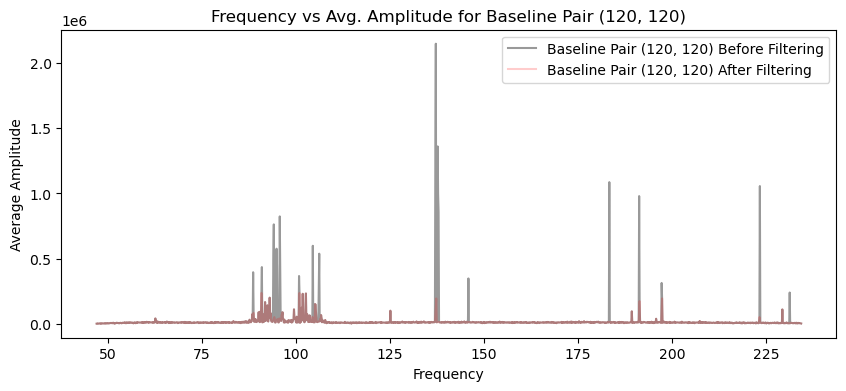

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.17792361 -0.18262278 -0.18617619 ... -0.17264264 -0.16523108
 -0.16519006]


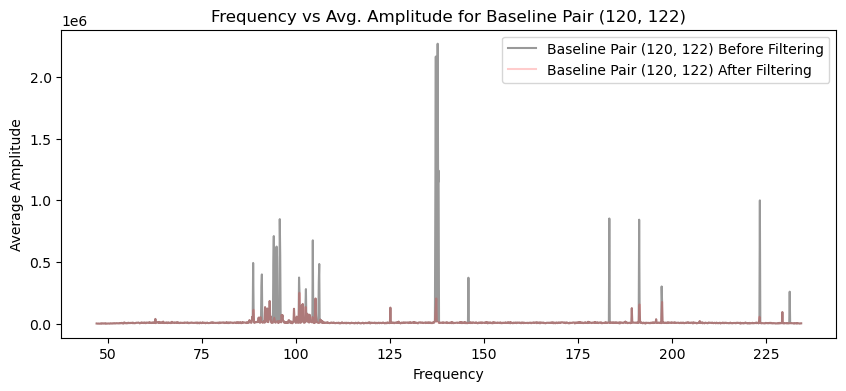

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.20111652 -0.19405549 -0.2024437  ... -0.18813741 -0.18028617
 -0.15691202]


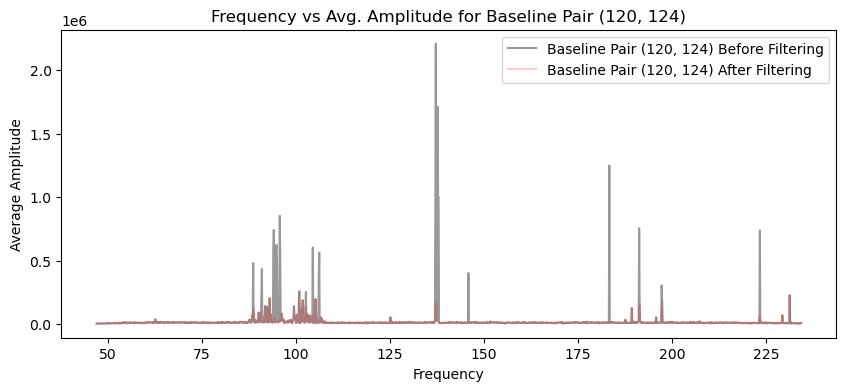

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.16702115 -0.14585293 -0.15499779 ... -0.15075515 -0.14555342
 -0.12891976]


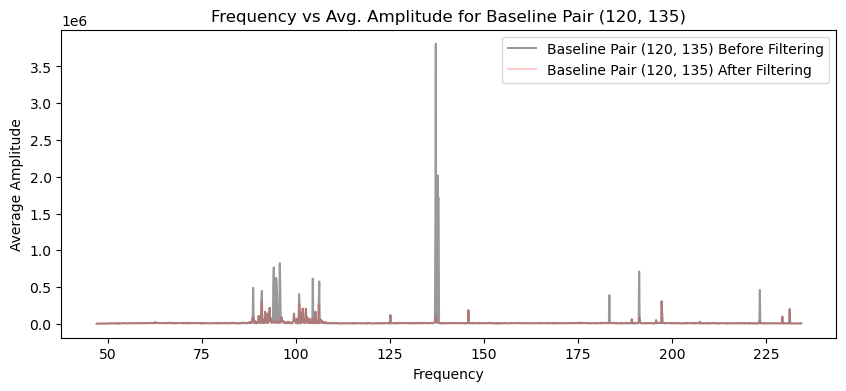

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.12702055 -0.12666804 -0.12423563 ... -0.10602622 -0.11172046
 -0.1117847 ]


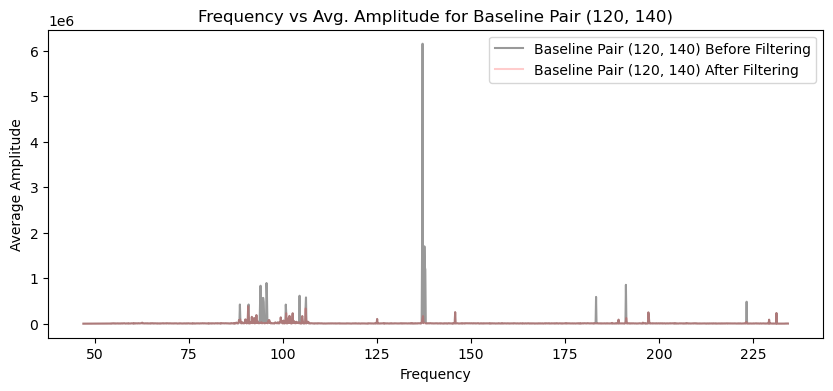

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15679609 -0.16059655 -0.16153254 ... -0.13988192 -0.14283917
 -0.14463876]


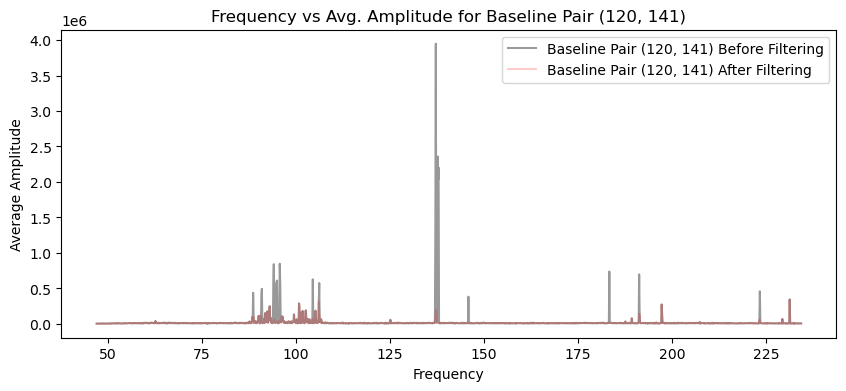

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.16990941 -0.18059324 -0.19069284 ... -0.09631433 -0.12483568
 -0.03315219]


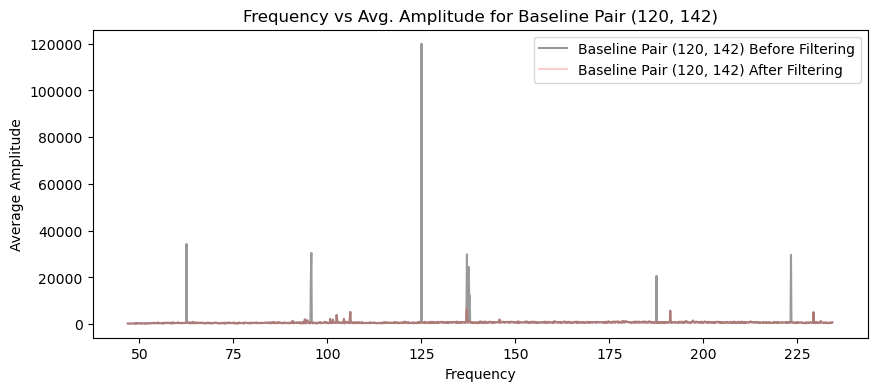

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.1737087  -0.17542769 -0.17665308 ... -0.16113724 -0.15939105
 -0.15788656]


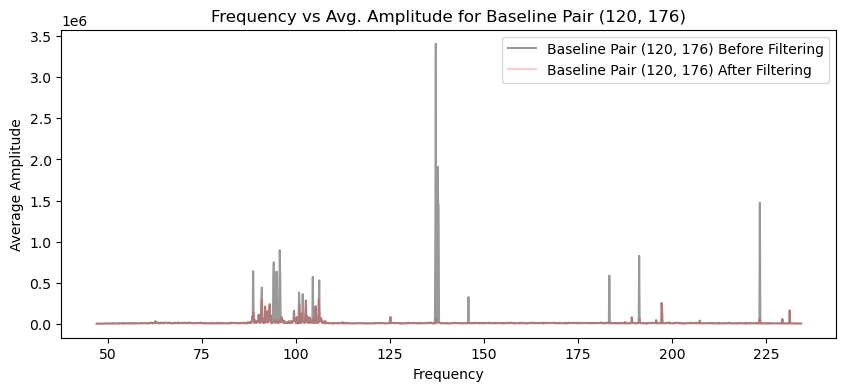

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.15764073 -0.15982487 -0.15935462 ... -0.12424236 -0.13457329
 -0.13228576]


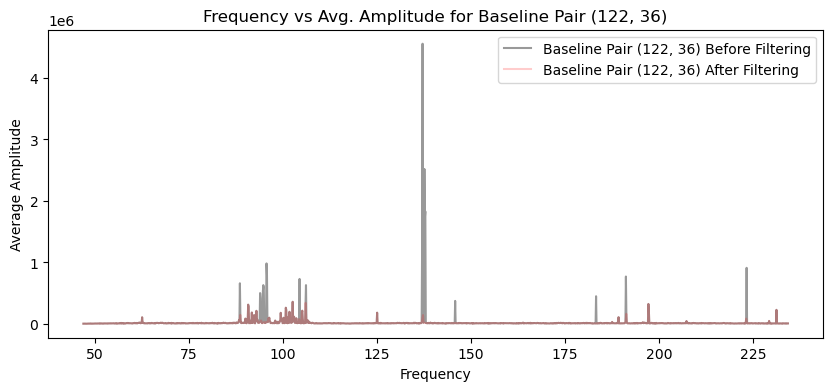

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.17014871 -0.16205183 -0.17049525 ... -0.14735887 -0.13735269
 -0.13953723]


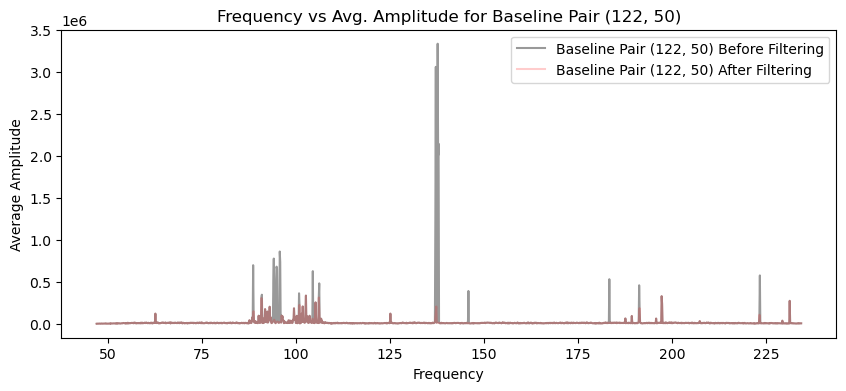

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1728612  -0.178733   -0.17856568 ... -0.15791824 -0.14568472
 -0.15520421]


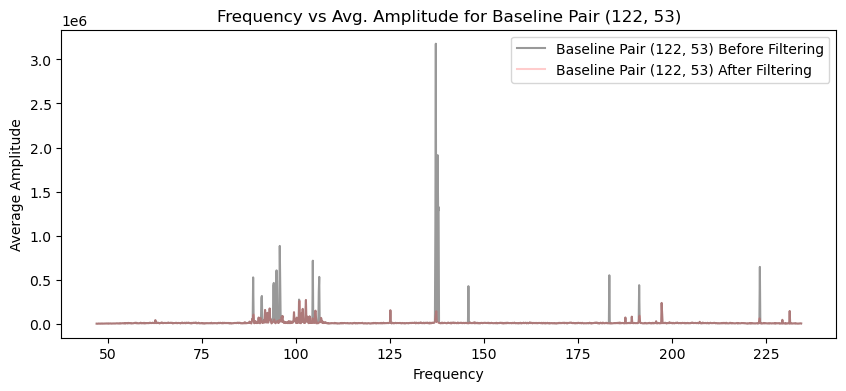

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.21458634 -0.20448945 -0.23418385 ... -0.18847073 -0.20652925
 -0.15289706]


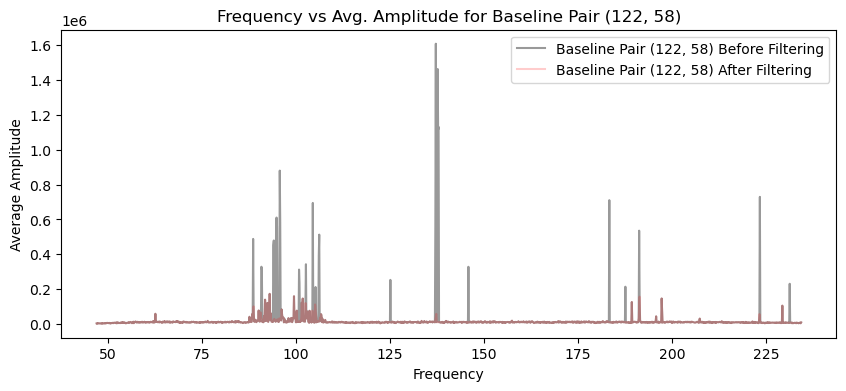

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.2111874  -0.19722374 -0.21194392 ... -0.18434679 -0.15935725
 -0.19103606]


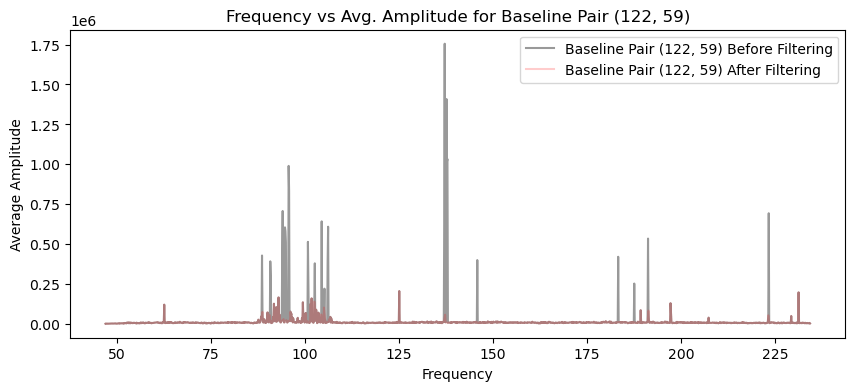

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.17491979 -0.16994415 -0.18294179 ... -0.16940917 -0.10234534
 -0.1181389 ]


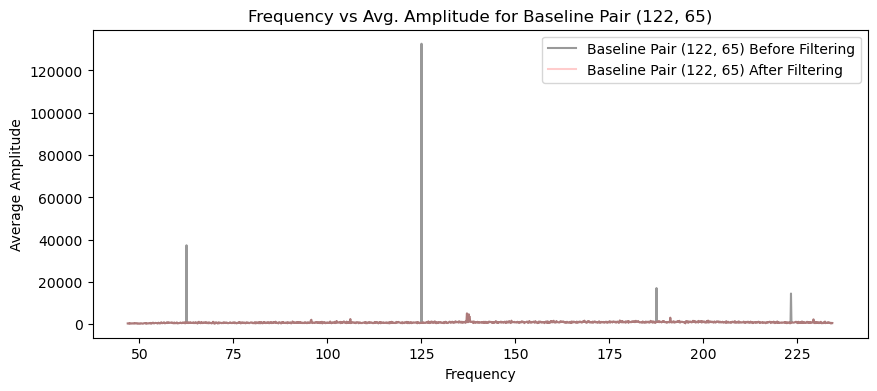

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.1658241  -0.16425399 -0.16131664 ... -0.13270212 -0.14730092
 -0.1501773 ]


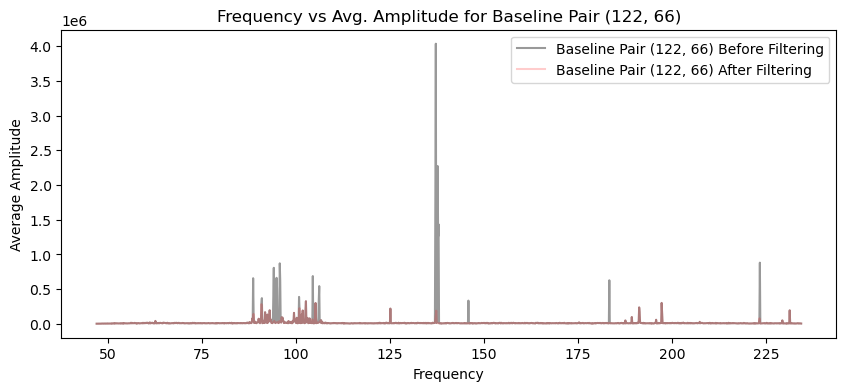

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.15317615 -0.1502276  -0.14815021 ... -0.13115853 -0.12436371
 -0.1363908 ]


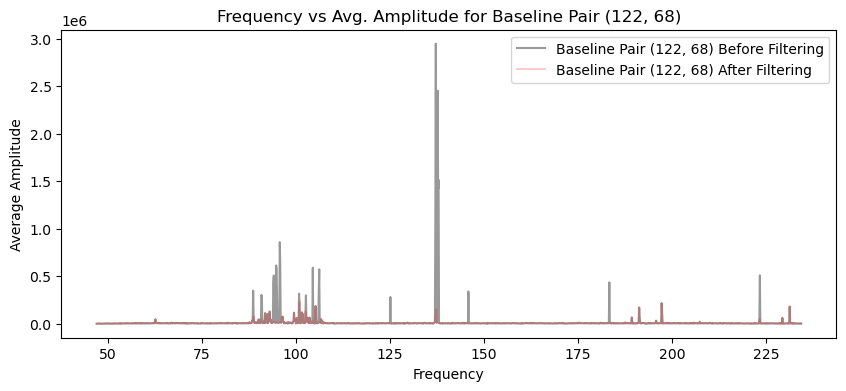

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.13033102 -0.12897176 -0.12818979 ... -0.1034107  -0.11676022
 -0.11389934]


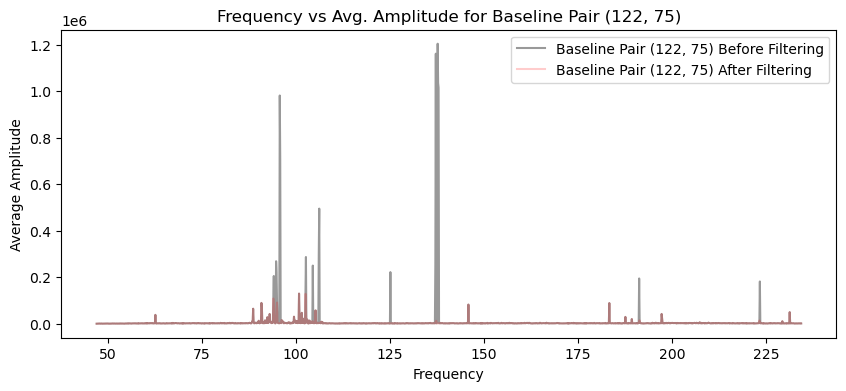

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.12089131 -0.12236459 -0.11199158 ... -0.11038534 -0.1091515
 -0.11297481]


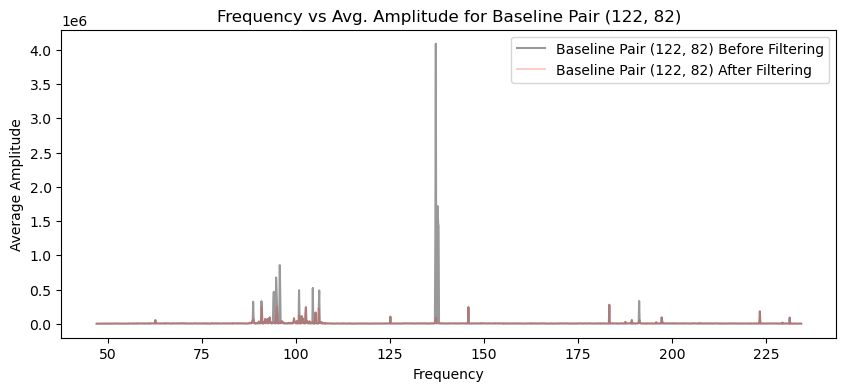

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15689015 -0.16416642 -0.16819234 ... -0.1356088  -0.15144718
 -0.14589038]


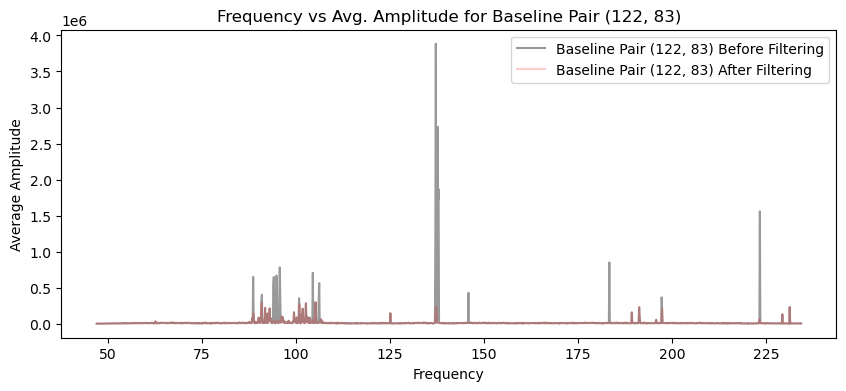

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.21032498 -0.20529197 -0.17786255 ... -0.00949186 -0.06432192
 -0.1460943 ]


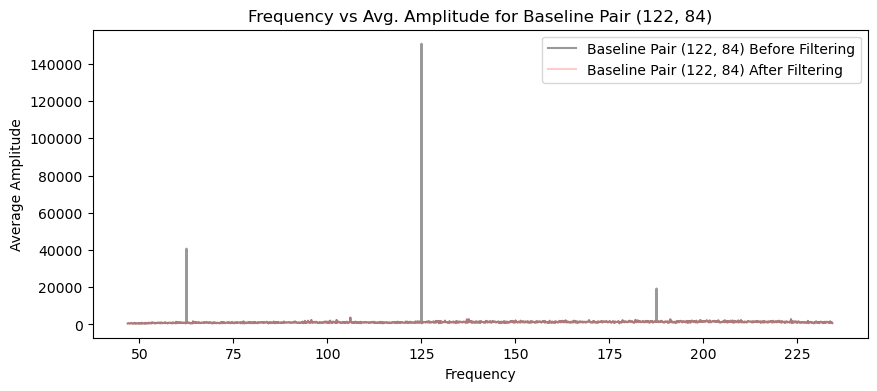

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.20859286 -0.20343402 -0.19776167 ... -0.18961978 -0.19918765
 -0.17997934]


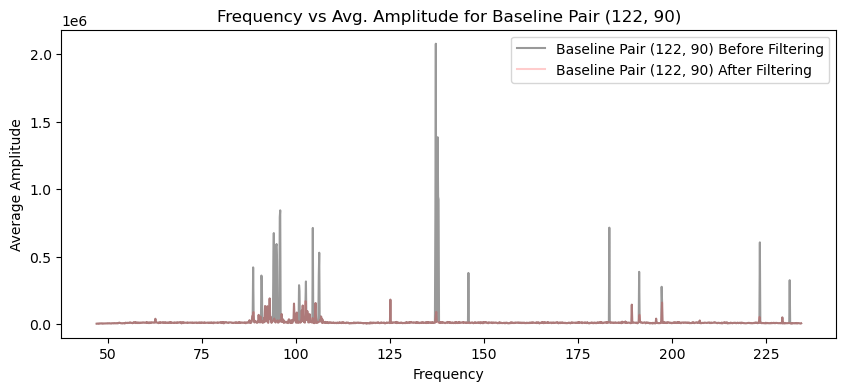

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.19609449 -0.19428898 -0.19811583 ... -0.1560147  -0.15683433
 -0.18288602]


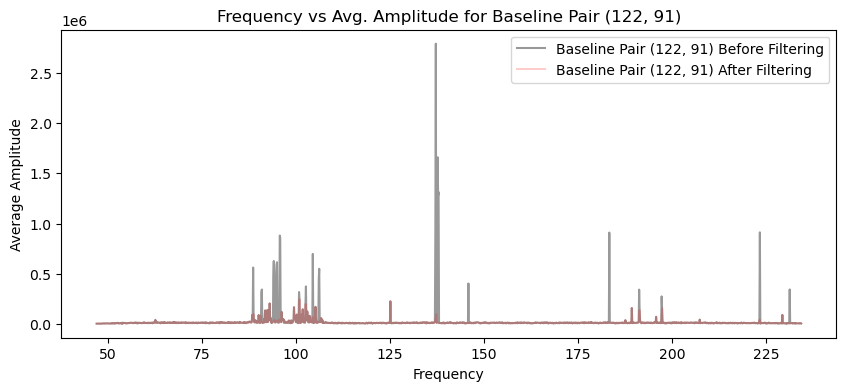

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.1587501  -0.13471364 -0.15460892 ... -0.09711778 -0.09510866
 -0.09010072]


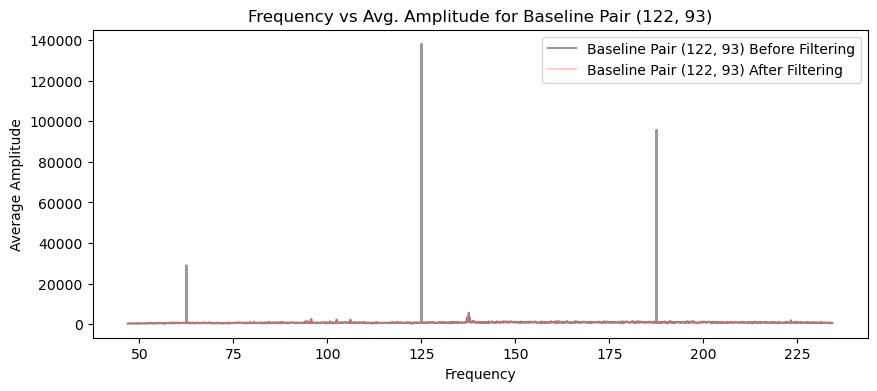

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.16069184 -0.15890345 -0.16283493 ... -0.15081339 -0.15947927
 -0.14632368]


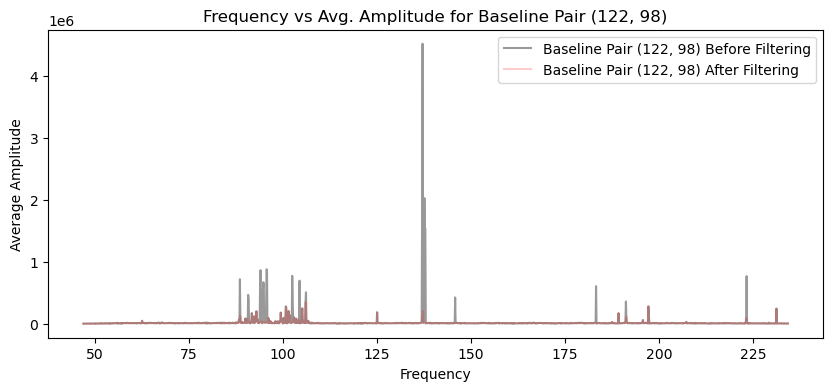

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.13933497 -0.14292367 -0.13880915 ... -0.13990759 -0.14112945
 -0.13205443]


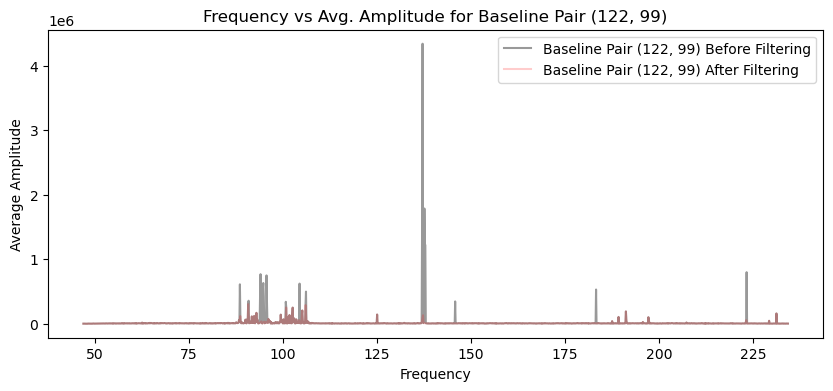

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.15780227 -0.16393333 -0.15687394 ... -0.13771726 -0.14754756
 -0.13455795]


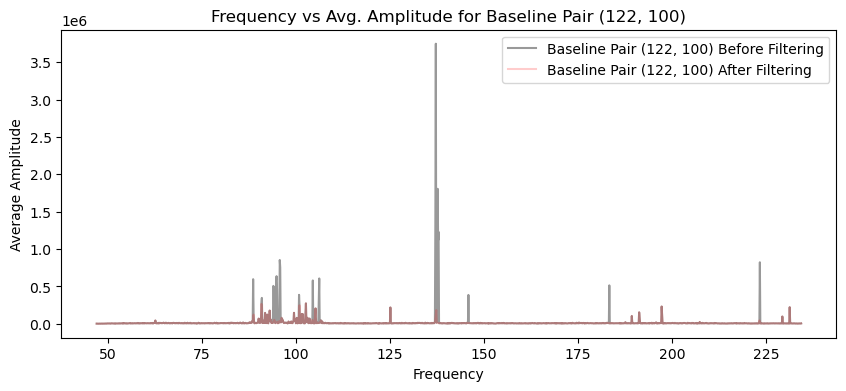

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.1749367  -0.16143381 -0.15685518 ... -0.16006068 -0.14471374
 -0.1665801 ]


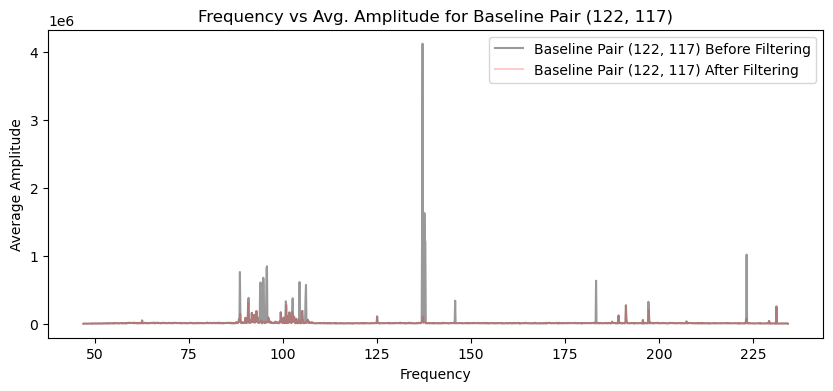

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.16820877 -0.16734835 -0.16886861 ... -0.15589116 -0.15509567
 -0.15330662]


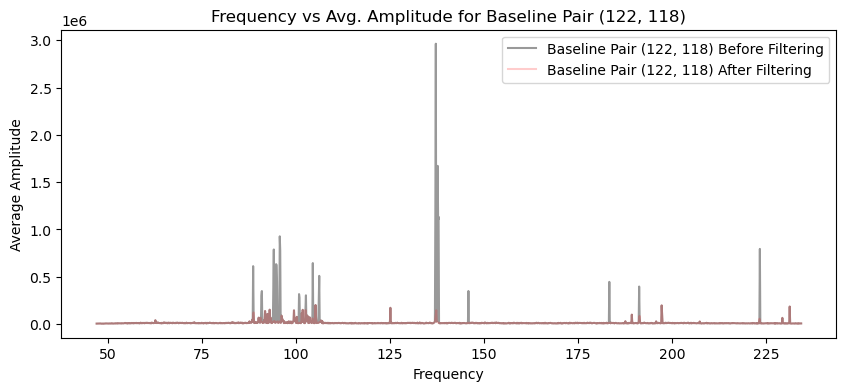

freqs shape: (1536,)
freqs_filtered shape: (1504,)
amplitudes_filtered shape: (20, 1504)
Threshold for baseline: [-0.28387495 -0.27486211 -0.2834042  ... -0.14689313 -0.16134785
 -0.19227423]


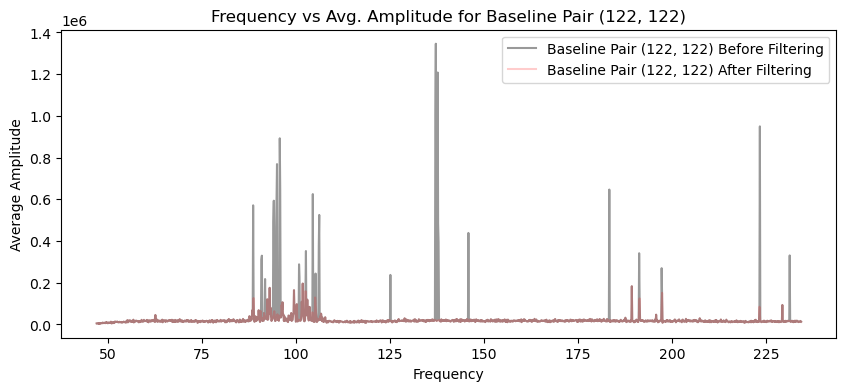

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17739149 -0.18467351 -0.19059057 ... -0.16795866 -0.16577271
 -0.16560398]


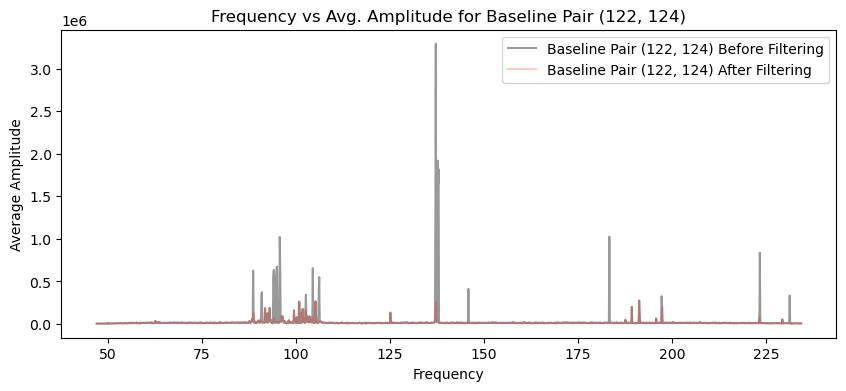

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.17447246 -0.1828393  -0.18467478 ... -0.15852134 -0.16121254
 -0.1566895 ]


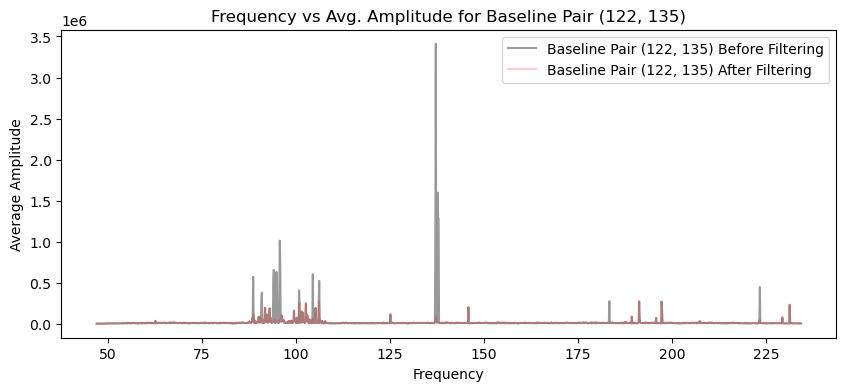

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.1894317  -0.19256769 -0.19062332 ... -0.17839635 -0.17857371
 -0.17440937]


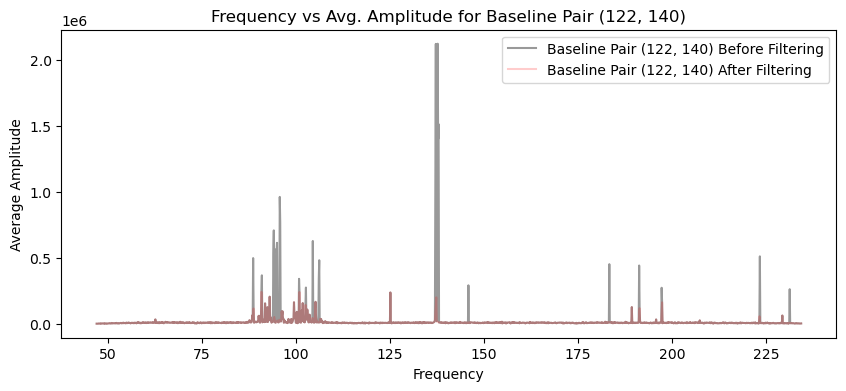

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.19673165 -0.20951646 -0.19270267 ... -0.18448215 -0.14778326
 -0.18458337]


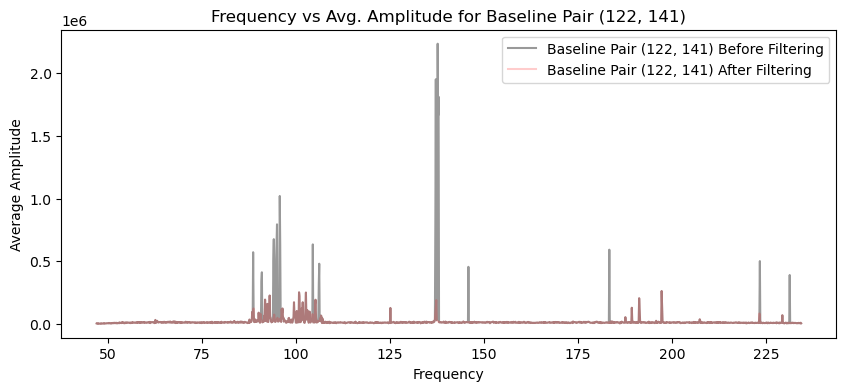

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.14750422 -0.15348282 -0.12294621 ... -0.07134535 -0.07947128
 -0.12068839]


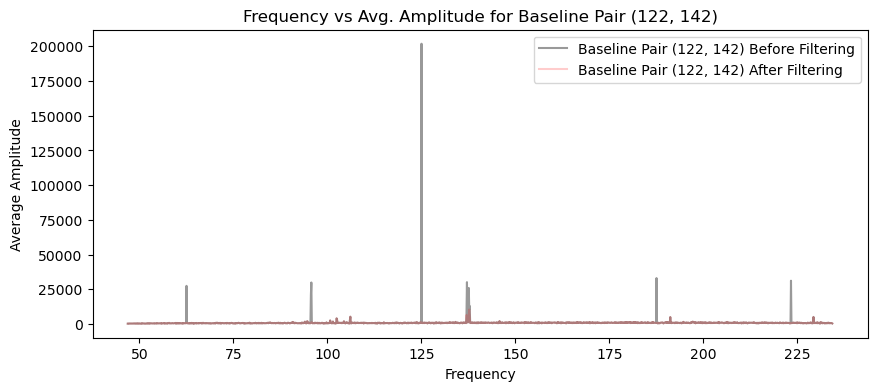

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.1900698  -0.19118087 -0.19973429 ... -0.169571   -0.18067524
 -0.17185435]


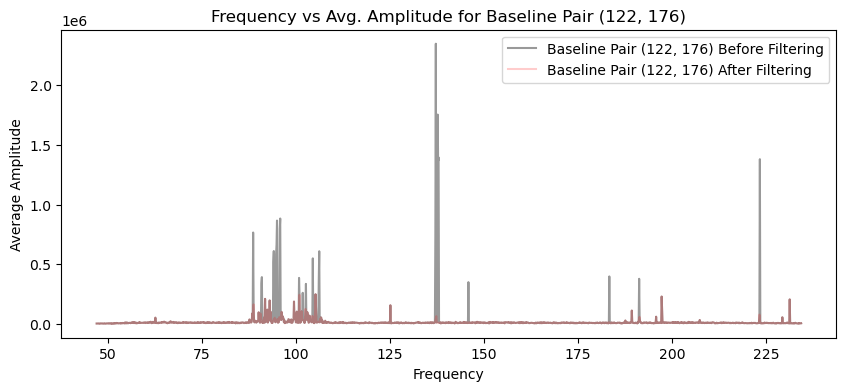

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17875944 -0.17944002 -0.17903085 ... -0.168808   -0.16055126
 -0.15741441]


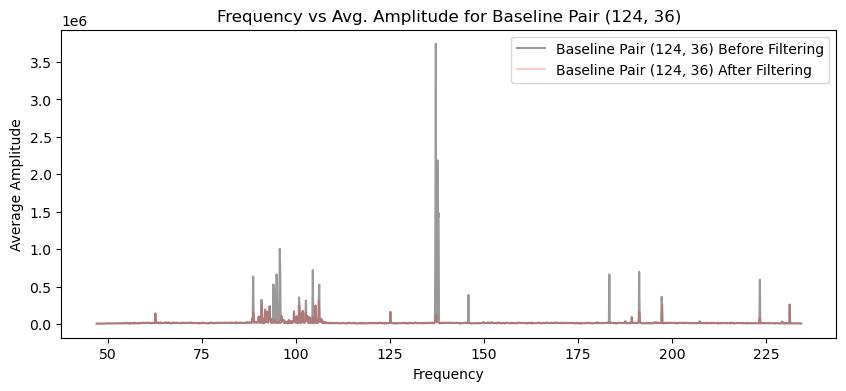

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.1924081  -0.20263071 -0.20753646 ... -0.15214404 -0.1688045
 -0.18285787]


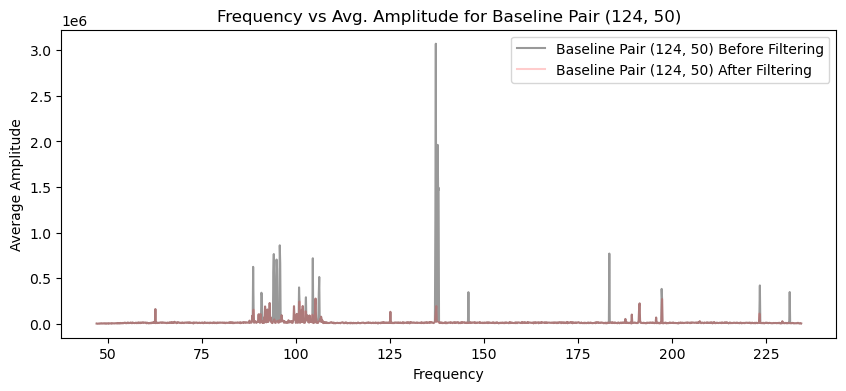

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.17882682 -0.17823708 -0.17195561 ... -0.15544218 -0.16949048
 -0.15733333]


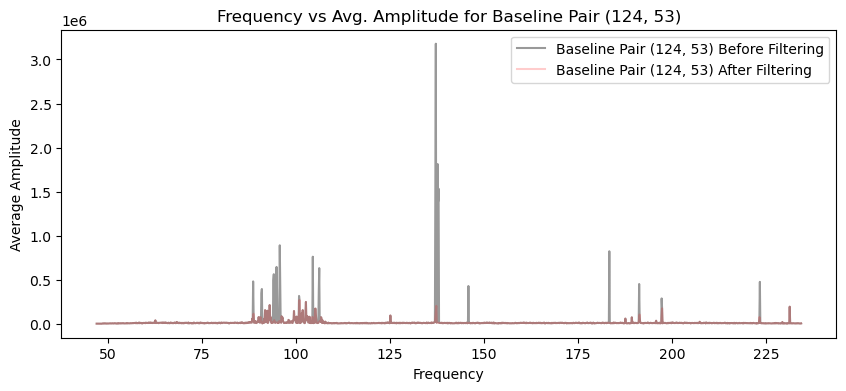

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.18436476 -0.18355557 -0.18781068 ... -0.16520505 -0.16009064
 -0.1660928 ]


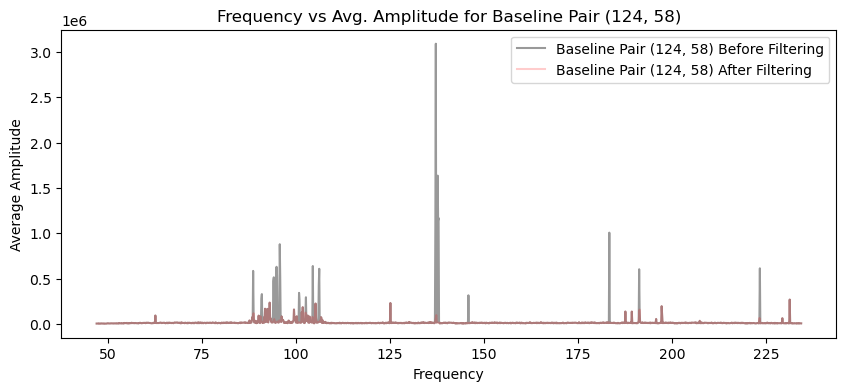

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.19939266 -0.20924015 -0.20660213 ... -0.18148514 -0.20104331
 -0.17283917]


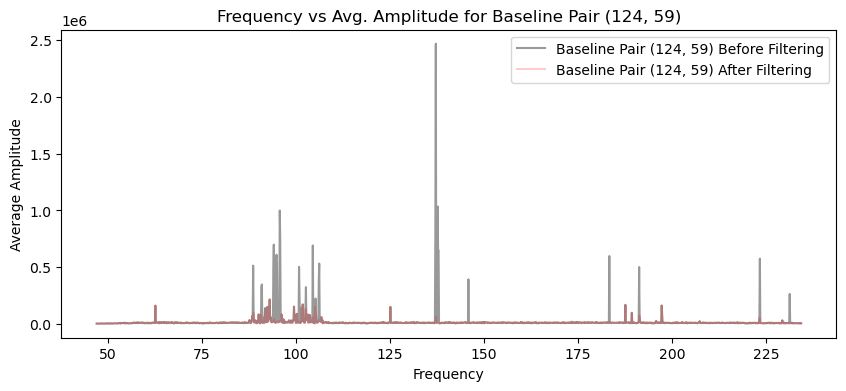

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.33155186 -0.32218455 -0.33955388 ... -0.29771878 -0.1762018
 -0.0831684 ]


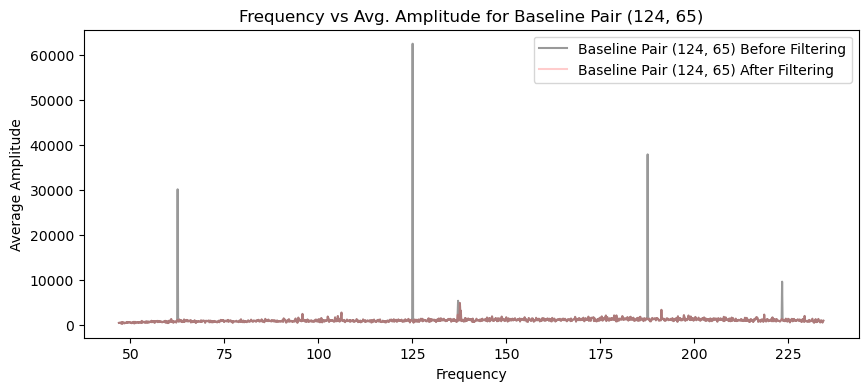

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.1437421  -0.14523415 -0.13948061 ... -0.13809734 -0.12000049
 -0.12941986]


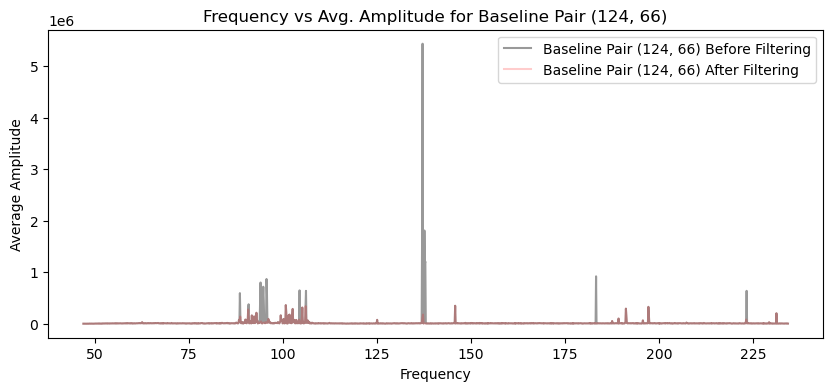

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14018763 -0.14749319 -0.14934819 ... -0.1326991  -0.13180639
 -0.13586779]


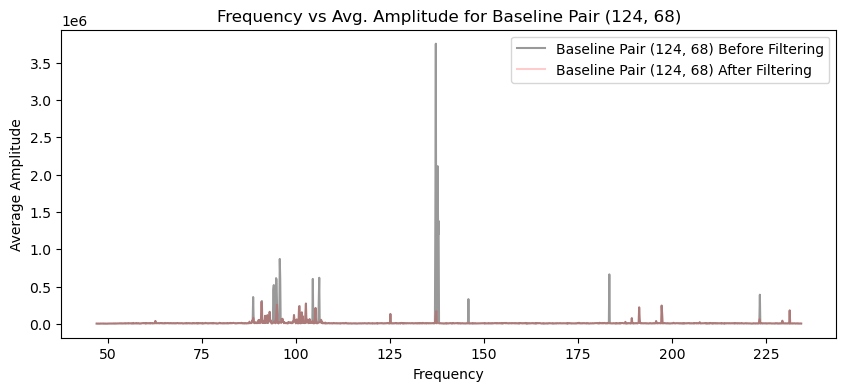

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.13082189 -0.12640828 -0.13116728 ... -0.1007379  -0.11218288
 -0.09951999]


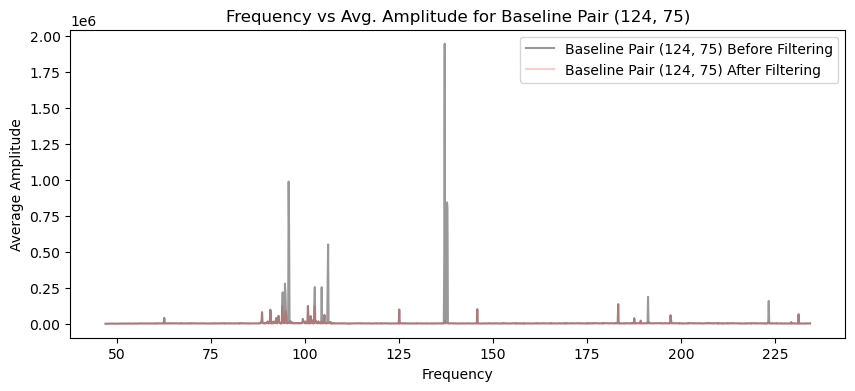

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.12059141 -0.11110155 -0.12003482 ... -0.1015235  -0.11313218
 -0.11369193]


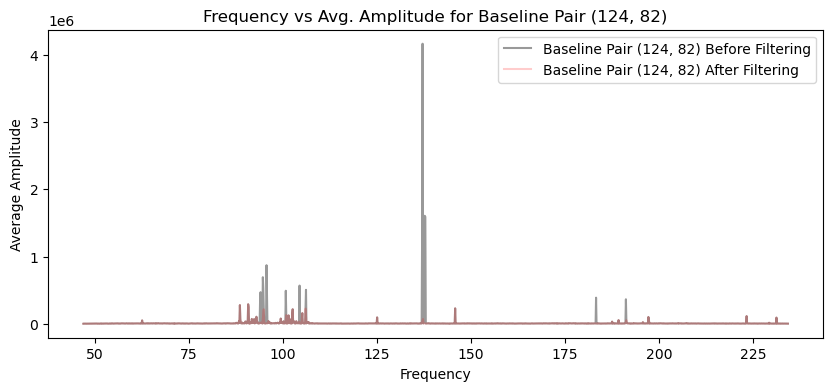

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.15240674 -0.1659218  -0.16909669 ... -0.14588347 -0.14358018
 -0.15852236]


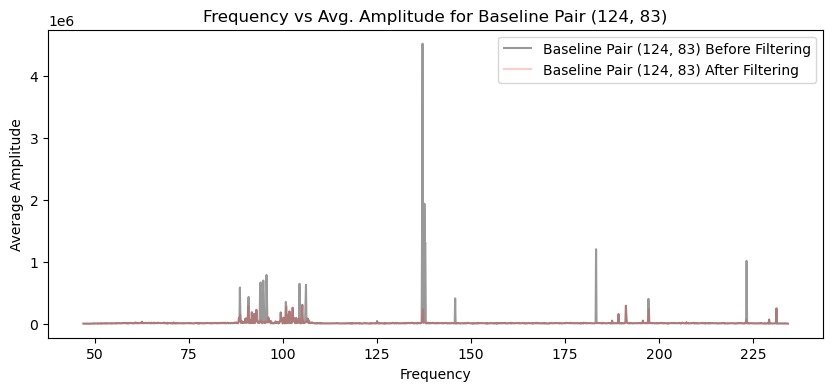

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.18606689 -0.20146015 -0.14588293 ... -0.11448134 -0.08719156
 -0.07121379]


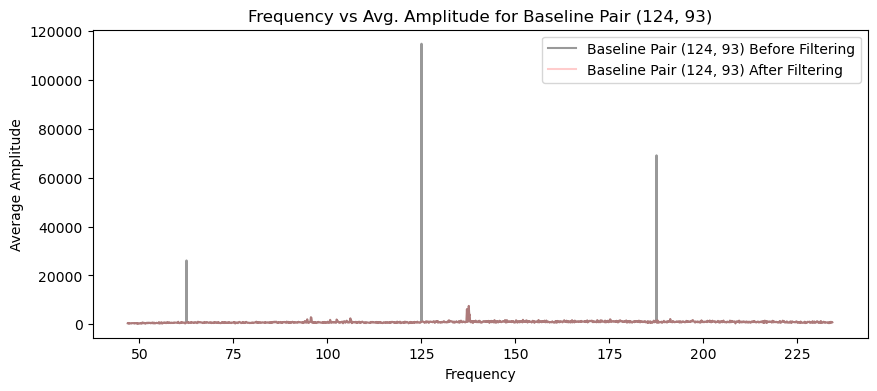

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.16915903 -0.17553089 -0.16276983 ... -0.13023138 -0.14381003
 -0.13113811]


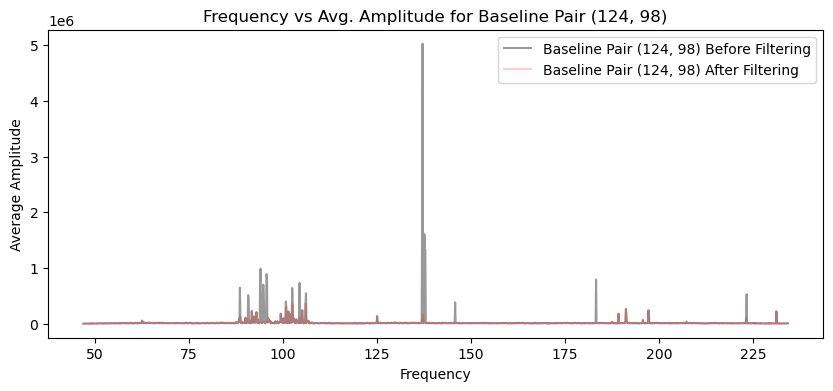

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.13123923 -0.12961468 -0.12861944 ... -0.11698056 -0.12147382
 -0.11515615]


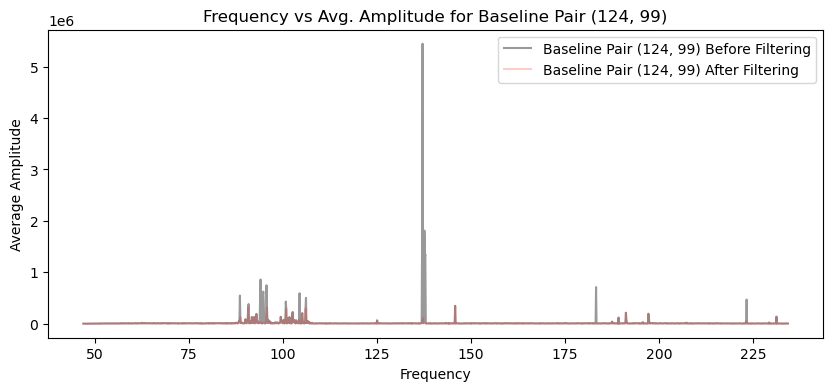

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17615354 -0.160929   -0.16509149 ... -0.15592466 -0.15543932
 -0.1516749 ]


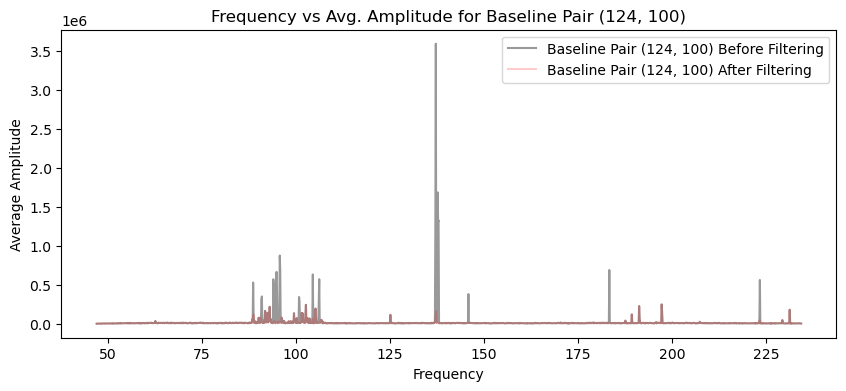

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.16855863 -0.16569656 -0.17266706 ... -0.15719931 -0.17017891
 -0.1503414 ]


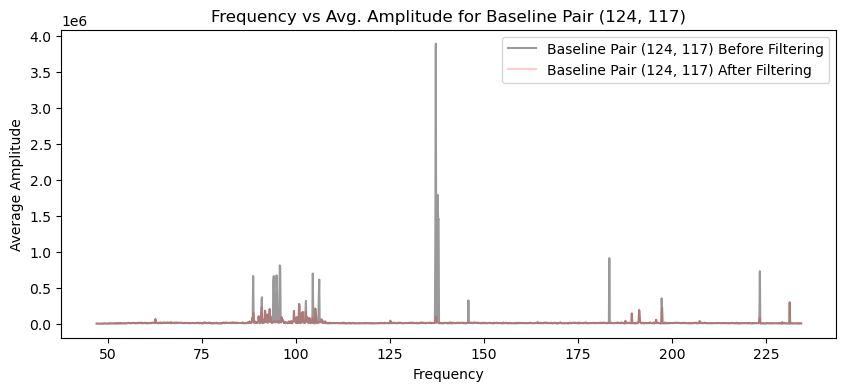

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.17668255 -0.17129349 -0.17306491 ... -0.15649139 -0.16559589
 -0.15040489]


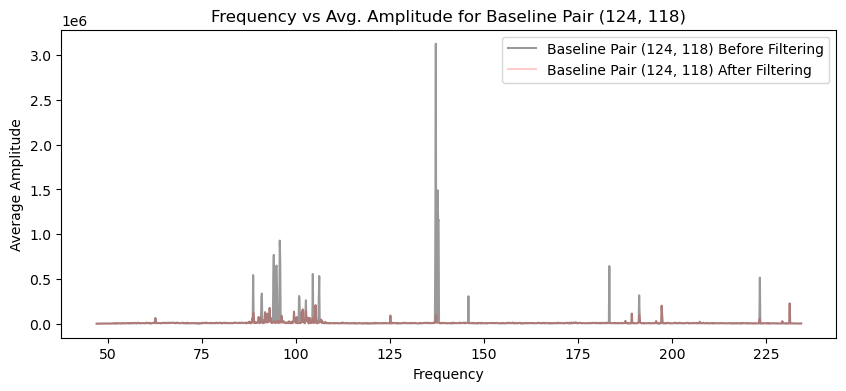

freqs shape: (1536,)
freqs_filtered shape: (1504,)
amplitudes_filtered shape: (20, 1504)
Threshold for baseline: [-0.28904335 -0.27577354 -0.27821927 ... -0.24389172 -0.1852666
 -0.23239485]


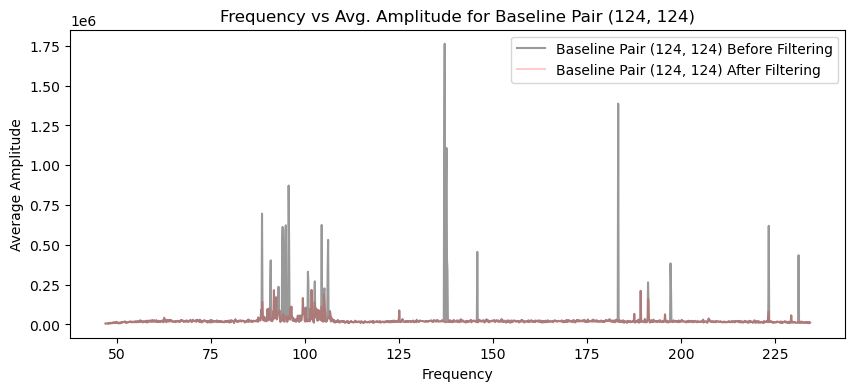

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18384823 -0.17801343 -0.18411461 ... -0.15032547 -0.15342064
 -0.14964682]


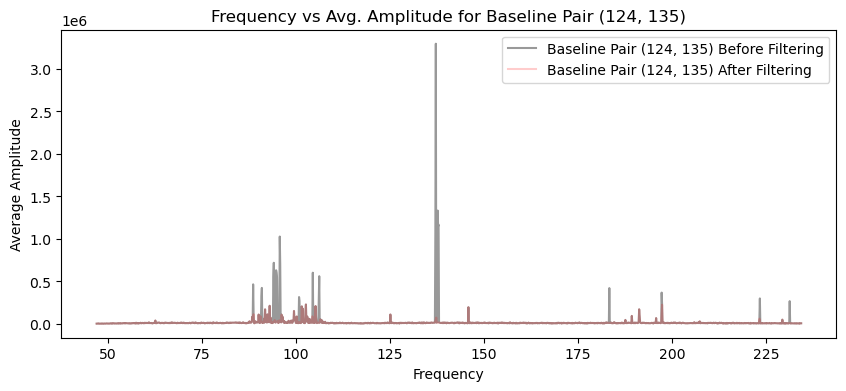

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18478276 -0.18459656 -0.18420436 ... -0.17094847 -0.15896839
 -0.17517096]


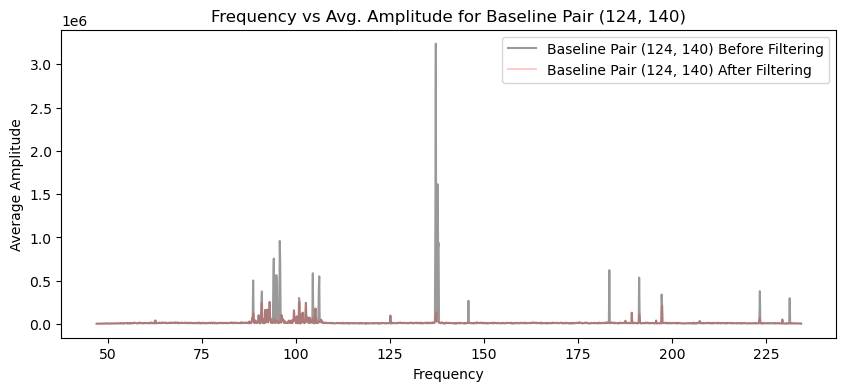

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.18914155 -0.19192321 -0.18628905 ... -0.1471646  -0.16779632
 -0.15347594]


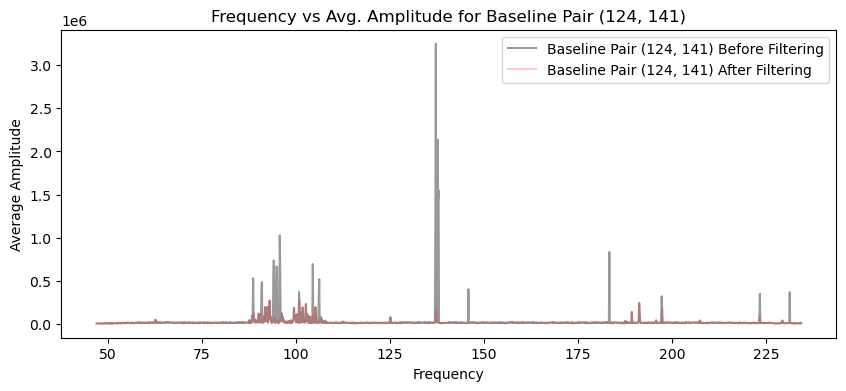

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.19910835 -0.22346079 -0.2039987  ... -0.15723184 -0.10418246
 -0.14689636]


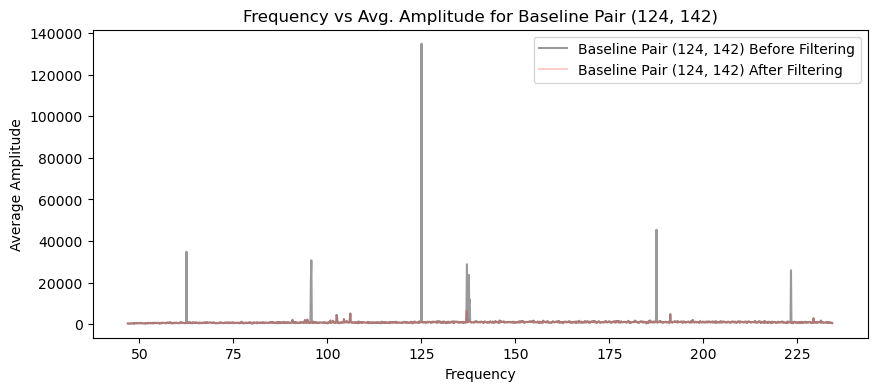

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.2095132  -0.21604011 -0.21077482 ... -0.17517003 -0.18476172
 -0.20542357]


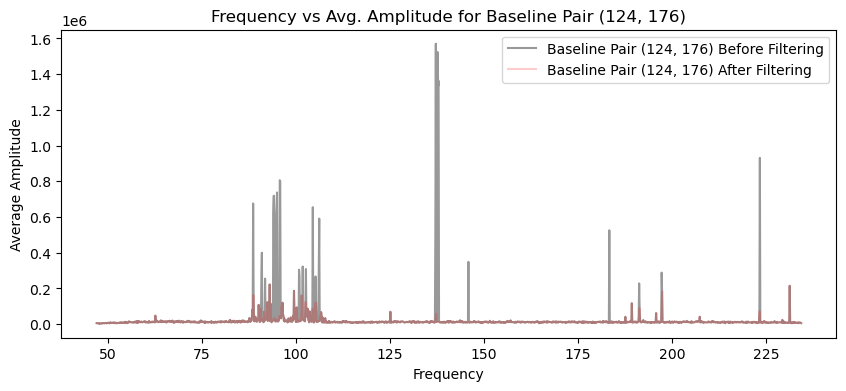

freqs shape: (1536,)
freqs_filtered shape: (1505,)
amplitudes_filtered shape: (20, 1505)
Threshold for baseline: [-0.23565179 -0.2227411  -0.23444512 ... -0.17963578 -0.19244519
 -0.19229364]


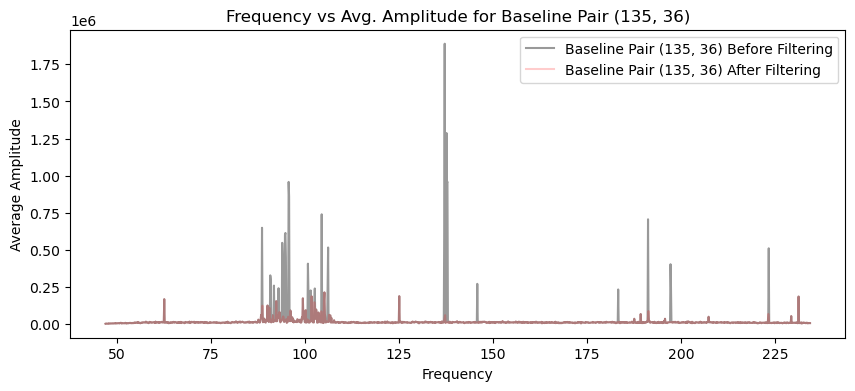

freqs shape: (1536,)
freqs_filtered shape: (1504,)
amplitudes_filtered shape: (20, 1504)
Threshold for baseline: [-0.23250411 -0.23488568 -0.22559614 ... -0.20720553 -0.20355024
 -0.17655382]


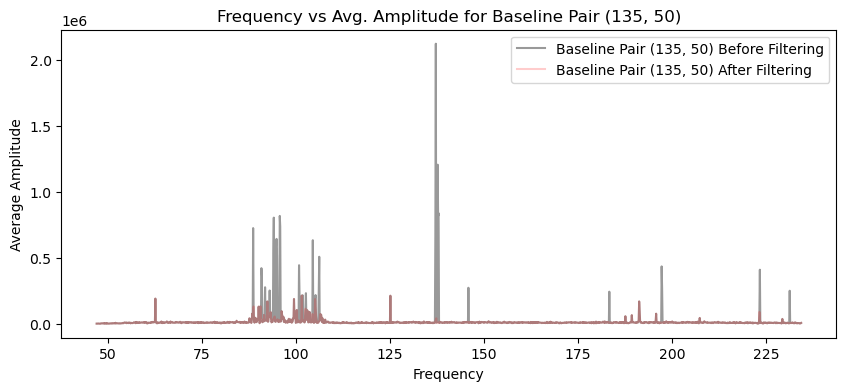

freqs shape: (1536,)
freqs_filtered shape: (1511,)
amplitudes_filtered shape: (20, 1511)
Threshold for baseline: [-0.20553967 -0.19729144 -0.19528659 ... -0.17478117 -0.16801541
 -0.18441131]


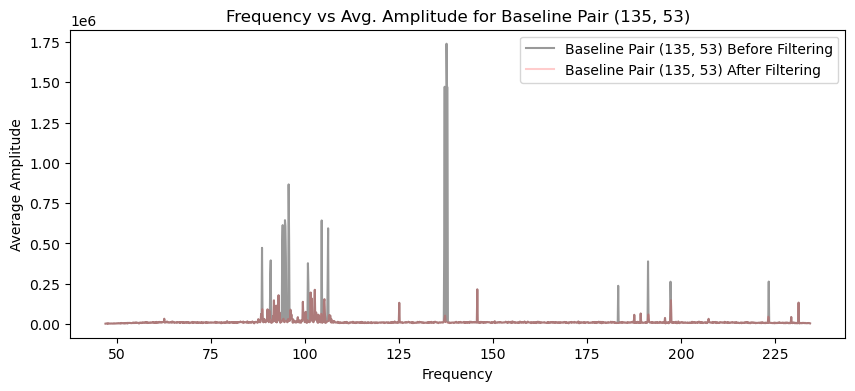

freqs shape: (1536,)
freqs_filtered shape: (1532,)
amplitudes_filtered shape: (20, 1532)
Threshold for baseline: [-0.24861268 -0.22258561 -0.23399962 ... -0.06186879 -0.08057172
 -0.04881269]


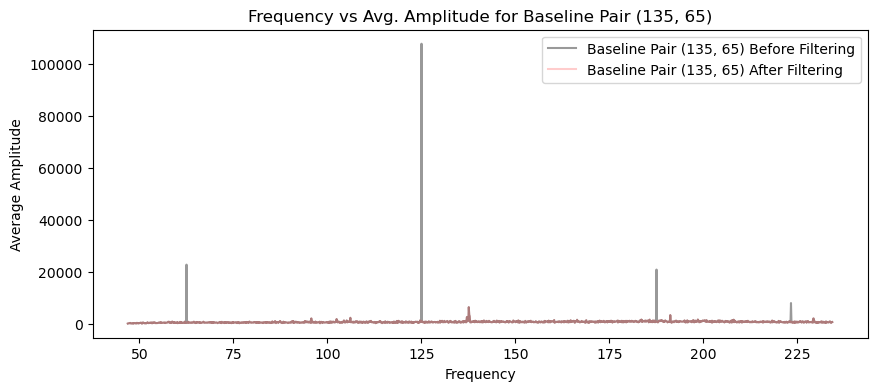

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.17817777 -0.1854769  -0.18423414 ... -0.14796252 -0.15906283
 -0.14354905]


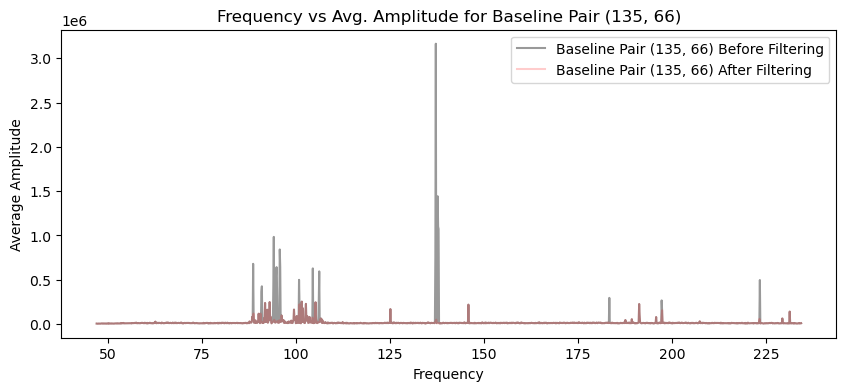

freqs shape: (1536,)
freqs_filtered shape: (1512,)
amplitudes_filtered shape: (20, 1512)
Threshold for baseline: [-0.17125804 -0.16930045 -0.16591116 ... -0.16385693 -0.14562876
 -0.14984744]


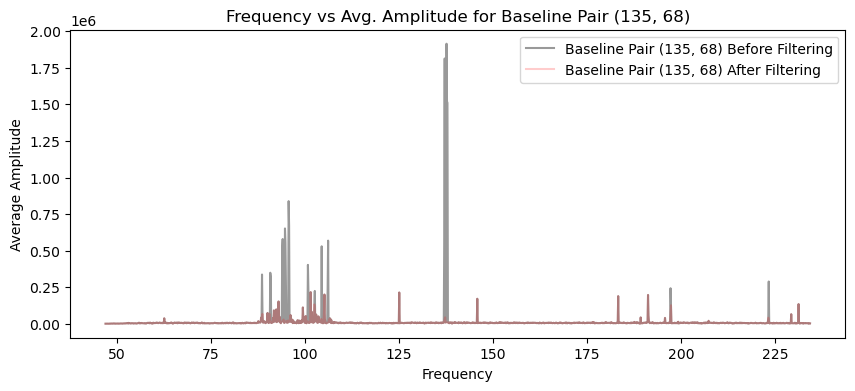

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.15642961 -0.15959311 -0.12734157 ... -0.03795461  0.00444277
 -0.06033987]


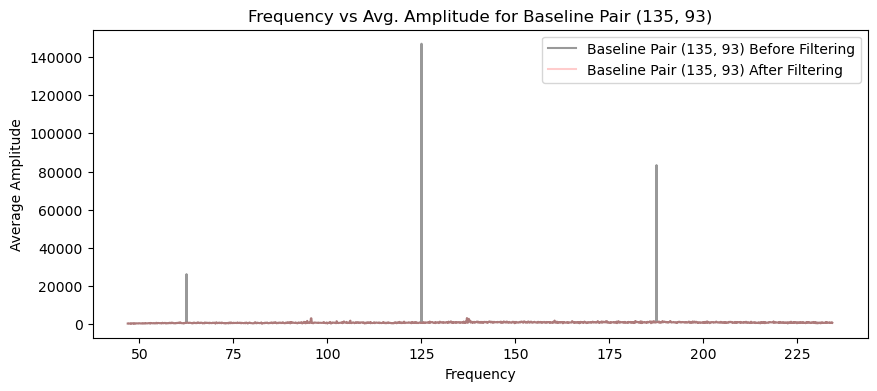

freqs shape: (1536,)
freqs_filtered shape: (1502,)
amplitudes_filtered shape: (20, 1502)
Threshold for baseline: [-0.30737433 -0.28677792 -0.29337682 ... -0.25560684 -0.27104117
 -0.23768163]


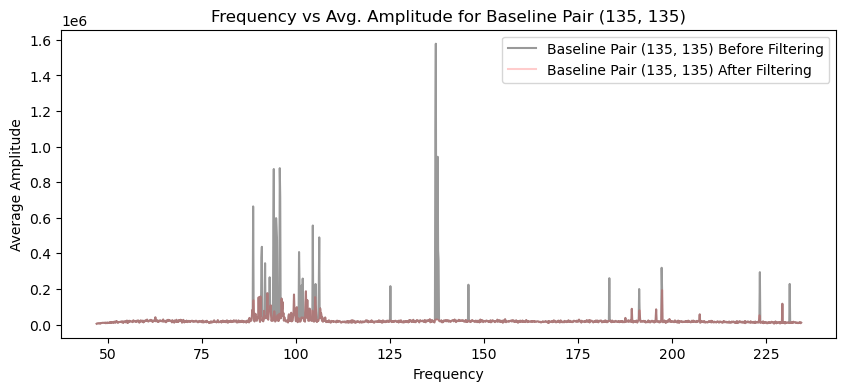

freqs shape: (1536,)
freqs_filtered shape: (1517,)
amplitudes_filtered shape: (20, 1517)
Threshold for baseline: [-0.15740784 -0.16628392 -0.15197438 ... -0.12944512 -0.14052897
 -0.13808624]


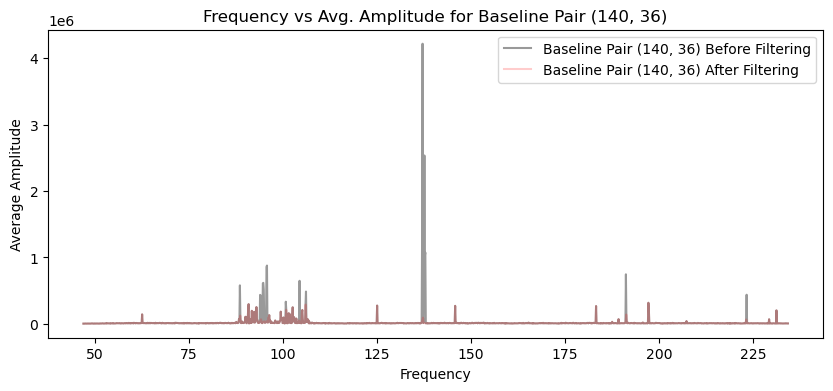

freqs shape: (1536,)
freqs_filtered shape: (1513,)
amplitudes_filtered shape: (20, 1513)
Threshold for baseline: [-0.18180942 -0.18637961 -0.17634907 ... -0.15681015 -0.15420346
 -0.16206484]


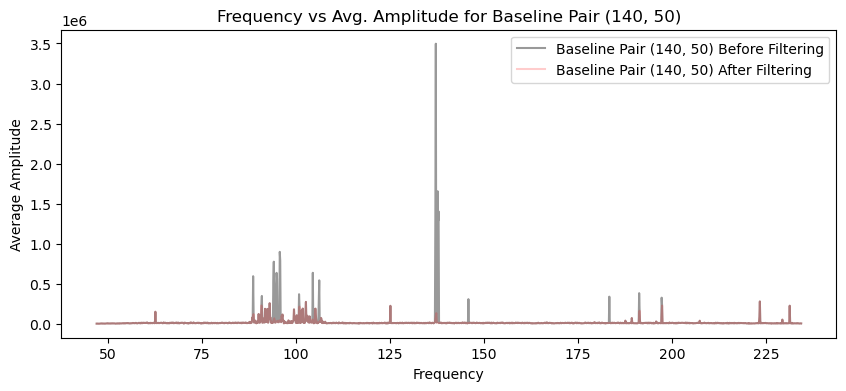

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.1483133  -0.15144252 -0.14199569 ... -0.13078944 -0.12280387
 -0.13164678]


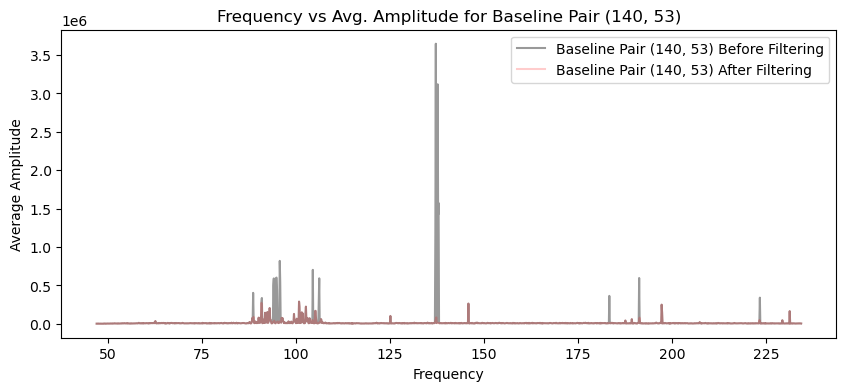

freqs shape: (1536,)
freqs_filtered shape: (1530,)
amplitudes_filtered shape: (20, 1530)
Threshold for baseline: [-0.36181982 -0.39477156 -0.29677733 ... -0.13970069 -0.25402005
 -0.03189812]


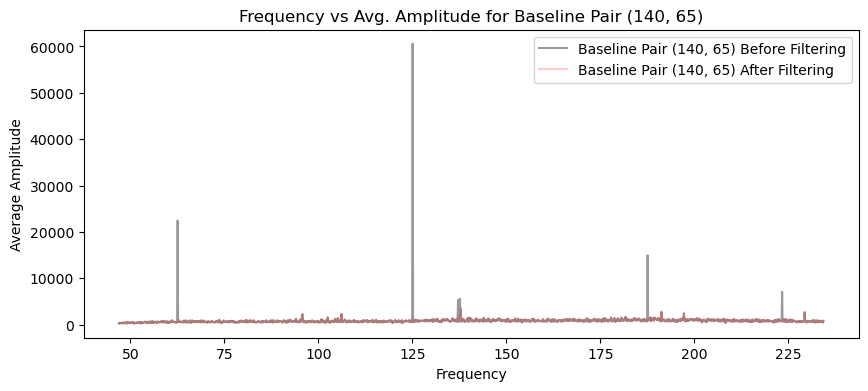

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.14730548 -0.15175899 -0.15370223 ... -0.1428179  -0.1524268
 -0.13777679]


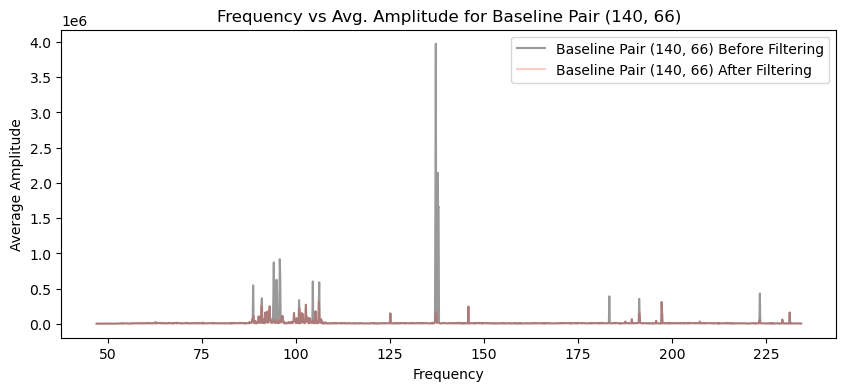

freqs shape: (1536,)
freqs_filtered shape: (1519,)
amplitudes_filtered shape: (20, 1519)
Threshold for baseline: [-0.13456947 -0.1360046  -0.13683356 ... -0.13205488 -0.12162664
 -0.1281303 ]


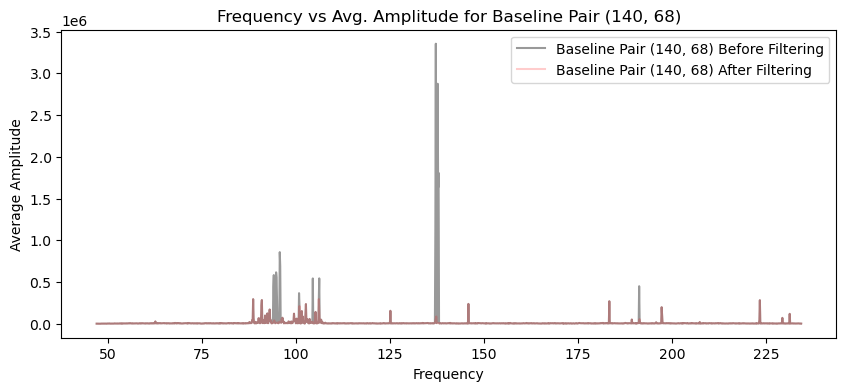

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.1562393  -0.14103199 -0.1526176  ... -0.01669673 -0.0757681
 -0.07053426]


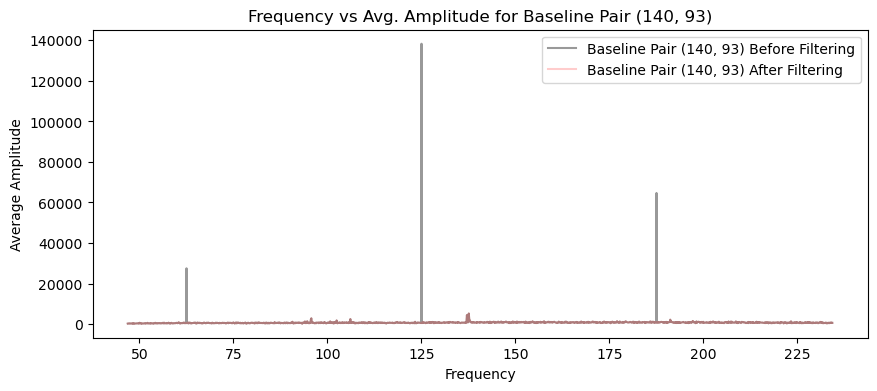

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.16015946 -0.15553284 -0.1689807  ... -0.15114266 -0.1425655
 -0.14880771]


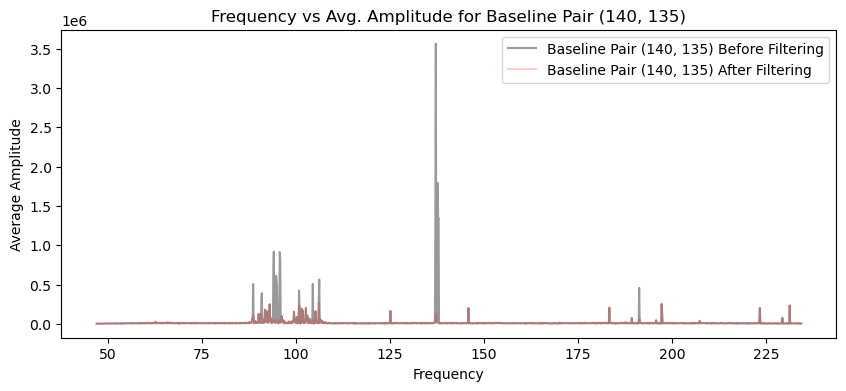

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.26237476 -0.26616902 -0.25499332 ... -0.22987753 -0.23032882
 -0.222437  ]


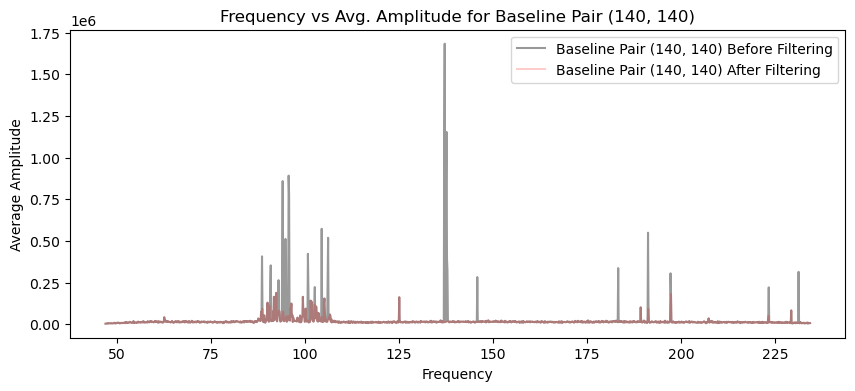

freqs shape: (1536,)
freqs_filtered shape: (1518,)
amplitudes_filtered shape: (20, 1518)
Threshold for baseline: [-0.13410427 -0.13735366 -0.13835936 ... -0.13342093 -0.1298129
 -0.11576072]


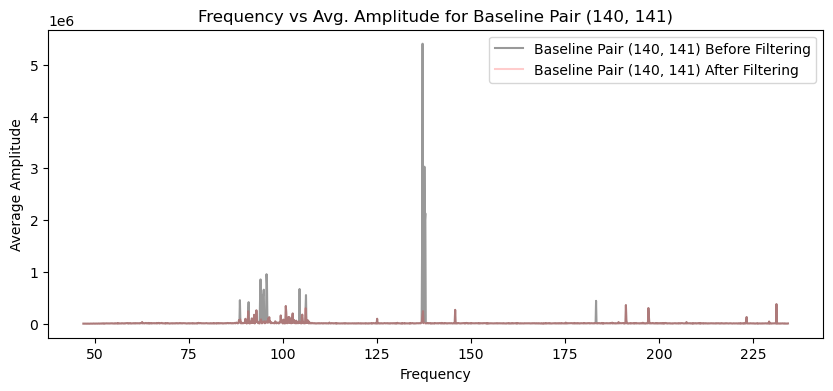

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.17768398 -0.16574229 -0.19014709 ... -0.02542745  0.00783095
 -0.06755716]


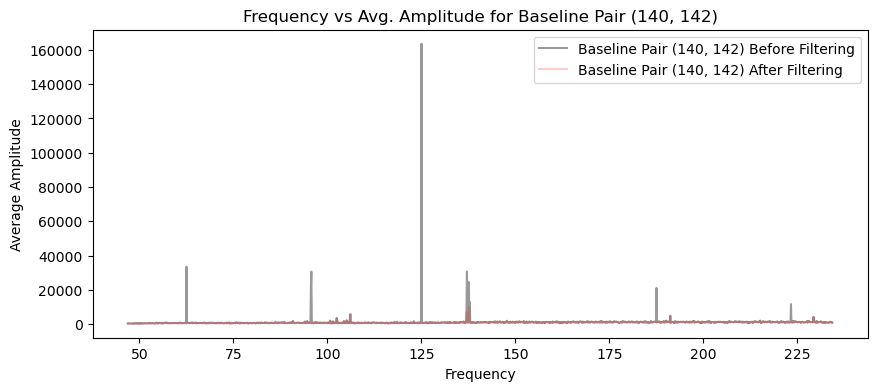

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.17737109 -0.17389846 -0.17665467 ... -0.13802525 -0.14741785
 -0.16147312]


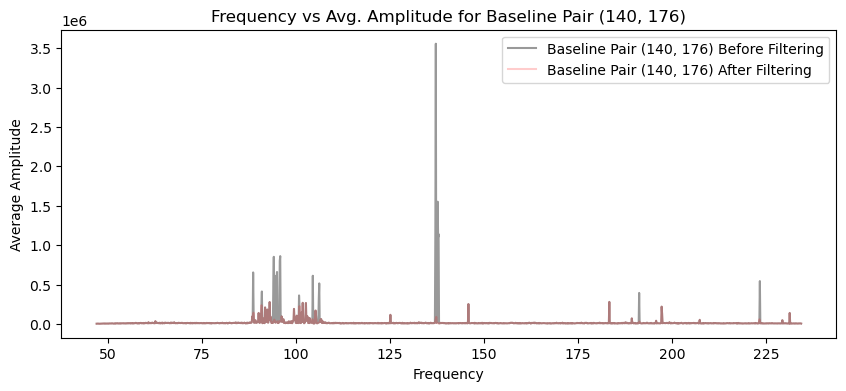

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.15709372 -0.16748751 -0.16231805 ... -0.12688175 -0.1211973
 -0.1273841 ]


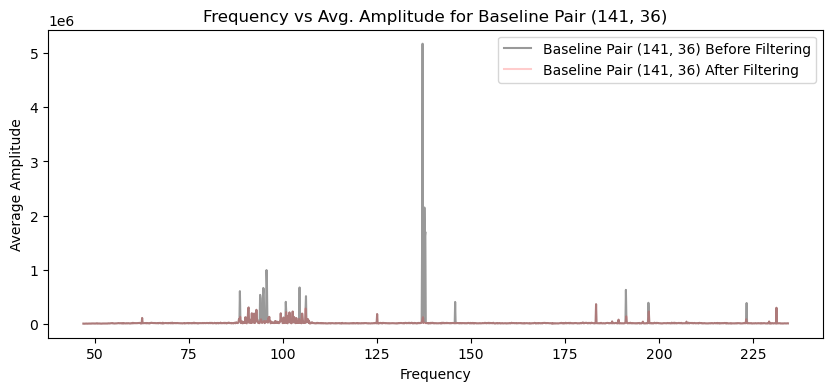

freqs shape: (1536,)
freqs_filtered shape: (1515,)
amplitudes_filtered shape: (20, 1515)
Threshold for baseline: [-0.16574662 -0.17684201 -0.17172606 ... -0.1394403  -0.13528684
 -0.1475485 ]


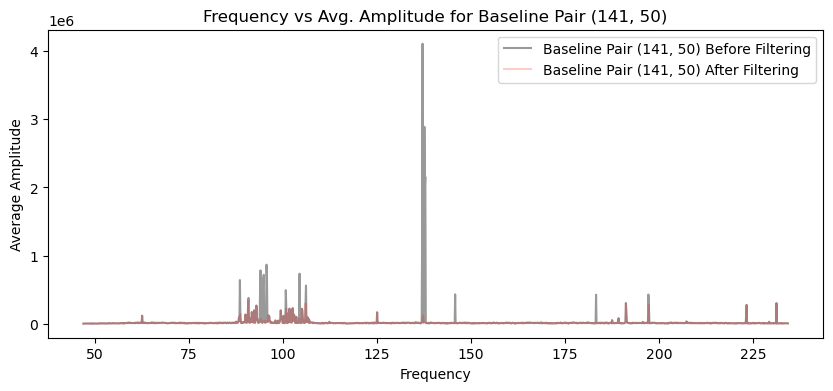

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.15928834 -0.14826797 -0.15116222 ... -0.13975626 -0.1337417
 -0.13905127]


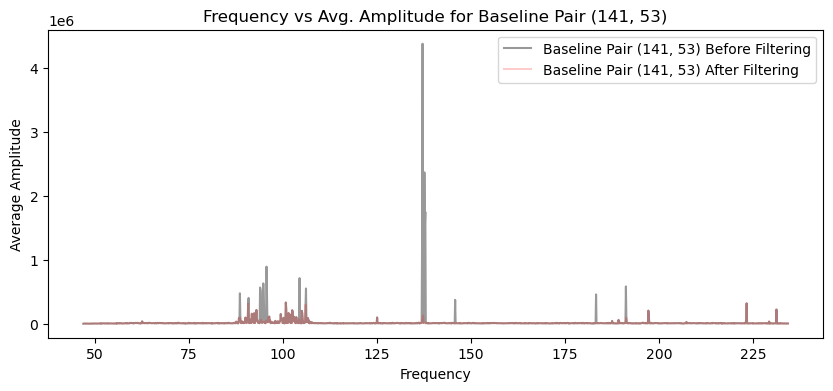

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.43017546 -0.37829261 -0.38054519 ... -0.14701913 -0.26188101
 -0.20048453]


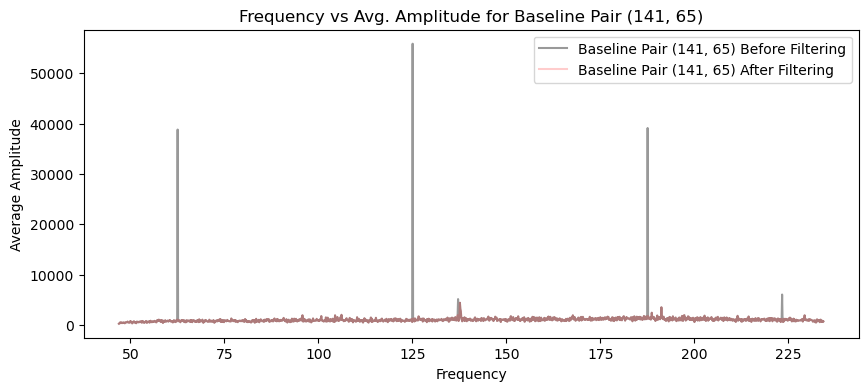

freqs shape: (1536,)
freqs_filtered shape: (1514,)
amplitudes_filtered shape: (20, 1514)
Threshold for baseline: [-0.16177369 -0.16658913 -0.16905098 ... -0.14293108 -0.1431869
 -0.13998917]


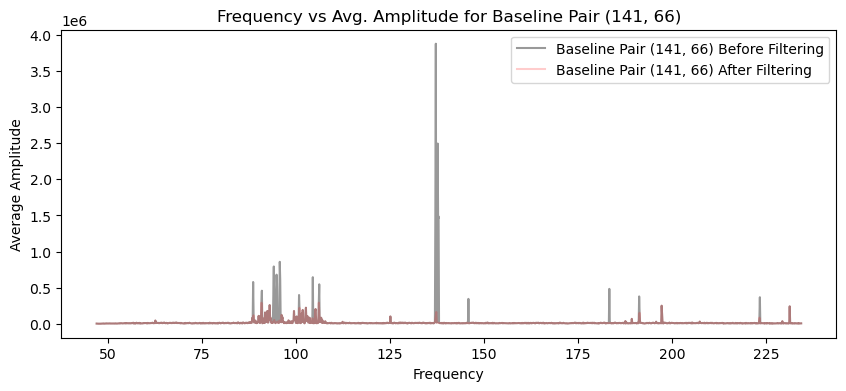

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.14421888 -0.15251977 -0.14254528 ... -0.13543599 -0.12752864
 -0.13011354]


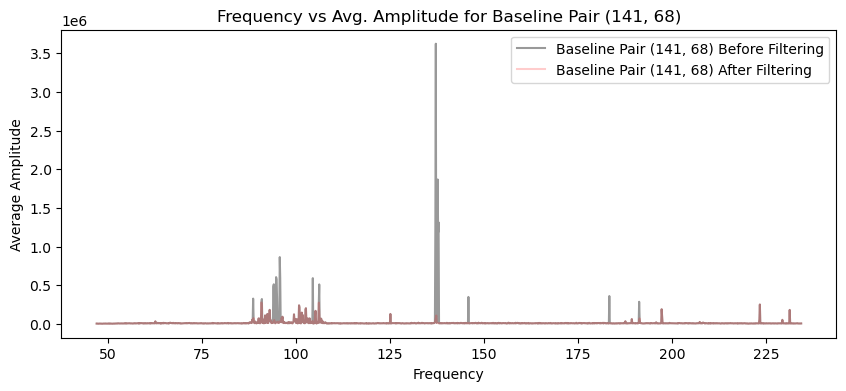

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.22662657 -0.16310123 -0.23594132 ... -0.01375524 -0.03077443
 -0.09089962]


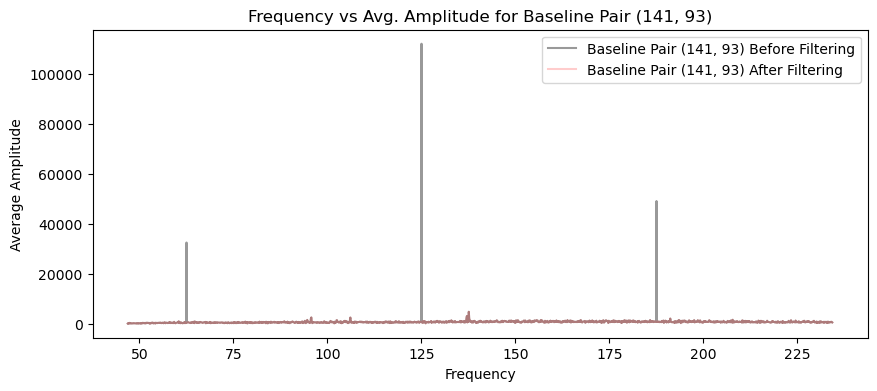

freqs shape: (1536,)
freqs_filtered shape: (1516,)
amplitudes_filtered shape: (20, 1516)
Threshold for baseline: [-0.1731892  -0.16708467 -0.17447951 ... -0.1569547  -0.13309655
 -0.16692944]


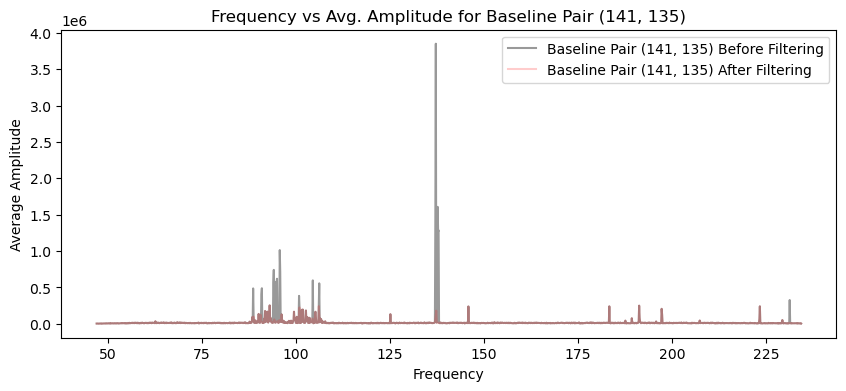

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.3476701  -0.33299593 -0.3477417  ... -0.30713843 -0.20190281
 -0.276403  ]


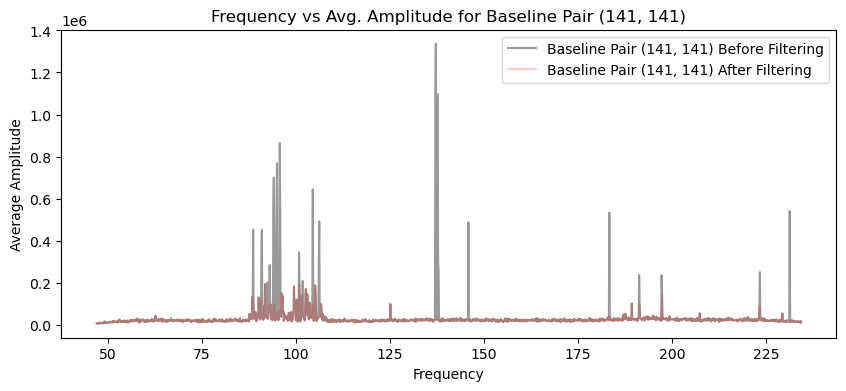

freqs shape: (1536,)
freqs_filtered shape: (1526,)
amplitudes_filtered shape: (20, 1526)
Threshold for baseline: [-0.26591475 -0.22289888 -0.23792086 ... -0.14229592  0.01841736
  0.03474382]


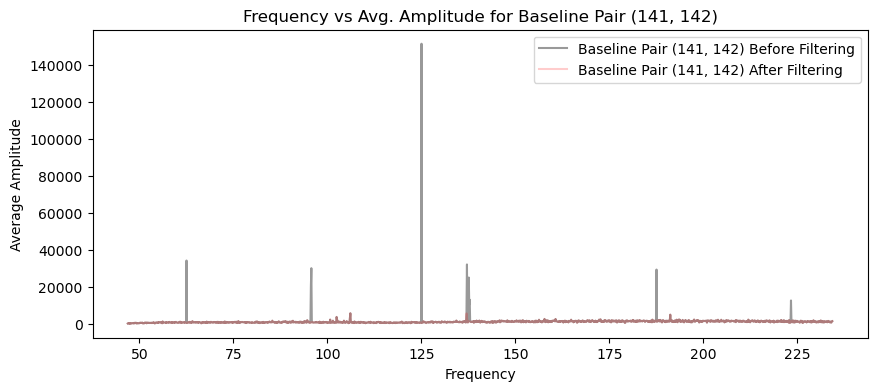

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.22230213 -0.20769677 -0.19900528 ... -0.17502642 -0.17688494
 -0.16956767]


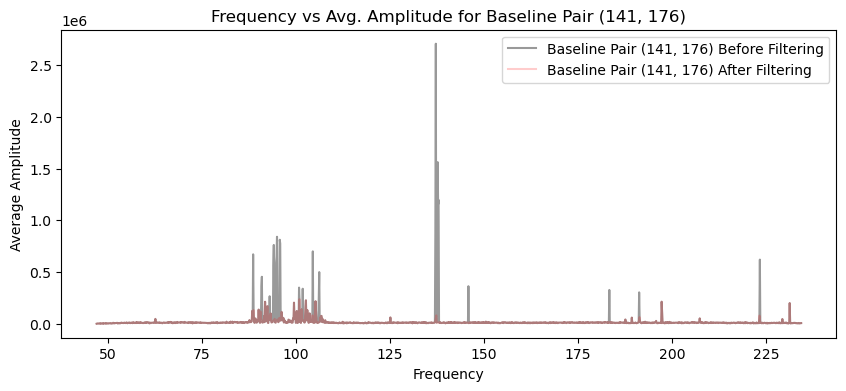

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.1238132  -0.13591752 -0.14441782 ... -0.09194995 -0.09837521
 -0.05414171]


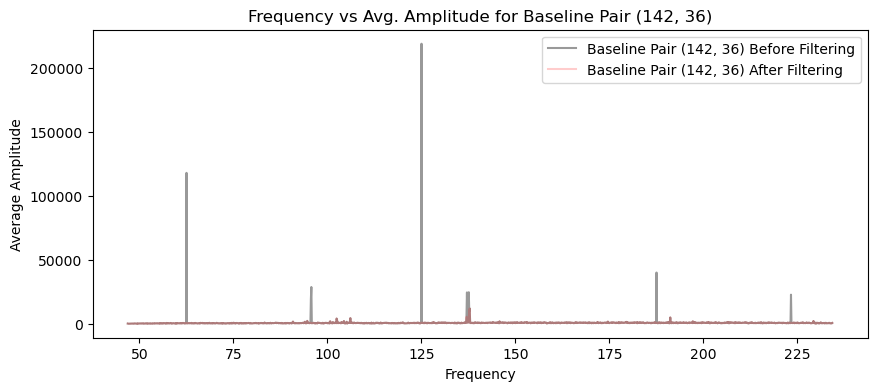

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.14890411 -0.11989218 -0.13756561 ... -0.07127626 -0.04693876
 -0.11799459]


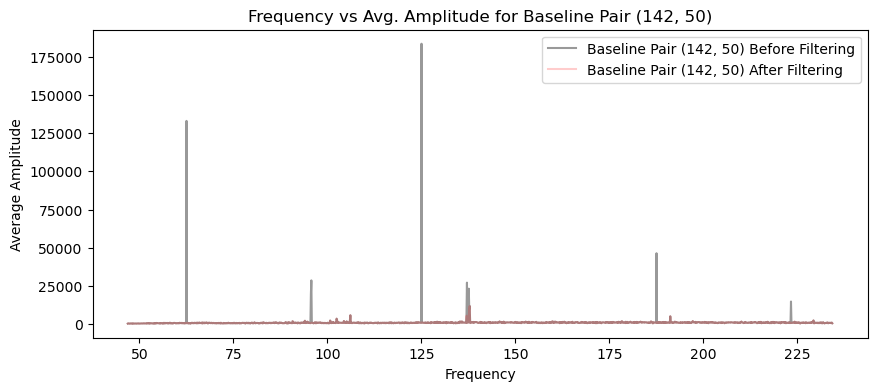

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.1429957  -0.14099199 -0.15008506 ... -0.09478989 -0.10406387
 -0.05853937]


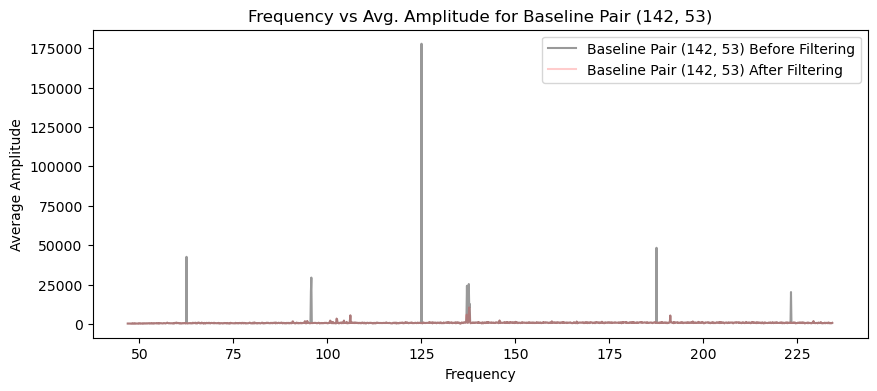

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.04877547 -0.05441194 -0.05157954 ... -0.02880051 -0.0336909
 -0.04240069]


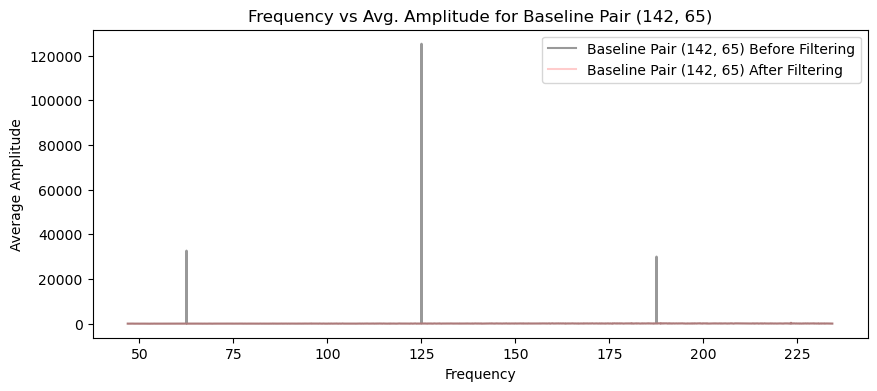

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.14156237 -0.15073689 -0.17867603 ... -0.07930396 -0.09017513
 -0.09287482]


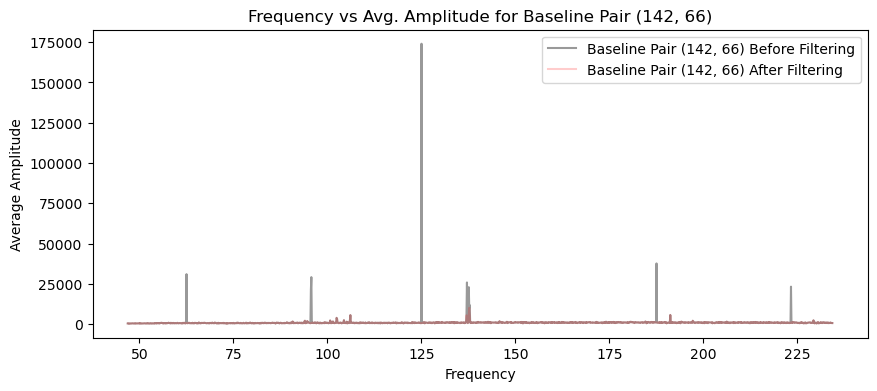

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.11946658 -0.10359325 -0.08403268 ... -0.08035483 -0.03335748
 -0.05153924]


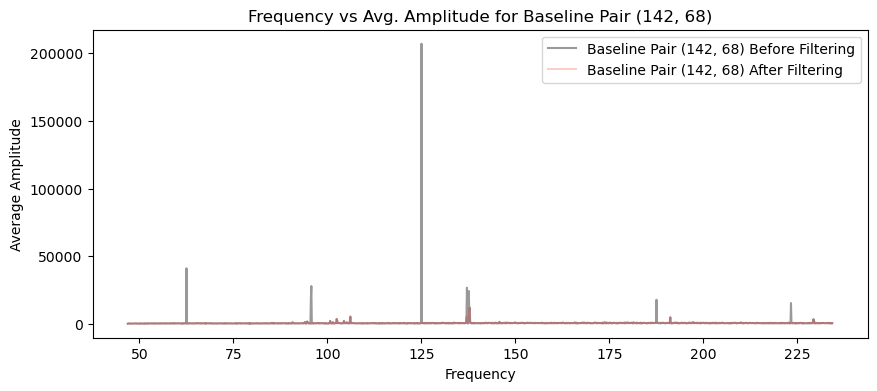

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.04718649 -0.04731248 -0.05138811 ... -0.03469535 -0.03274448
 -0.03529937]


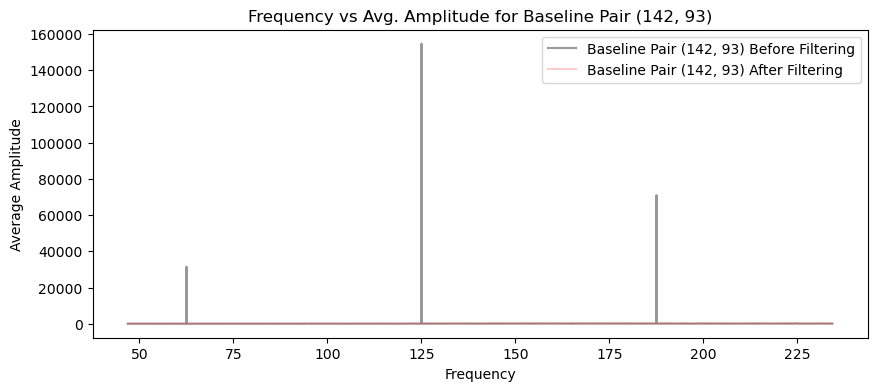

freqs shape: (1536,)
freqs_filtered shape: (1528,)
amplitudes_filtered shape: (20, 1528)
Threshold for baseline: [-0.12339461 -0.1760698  -0.15419294 ... -0.0759458  -0.13035876
 -0.07810021]


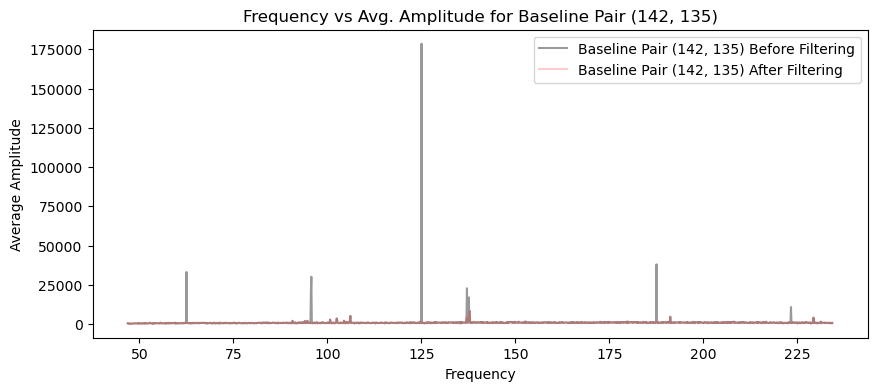

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.05966402 -0.05779371 -0.07016427 ... -0.01520364 -0.04118181
 -0.05029037]


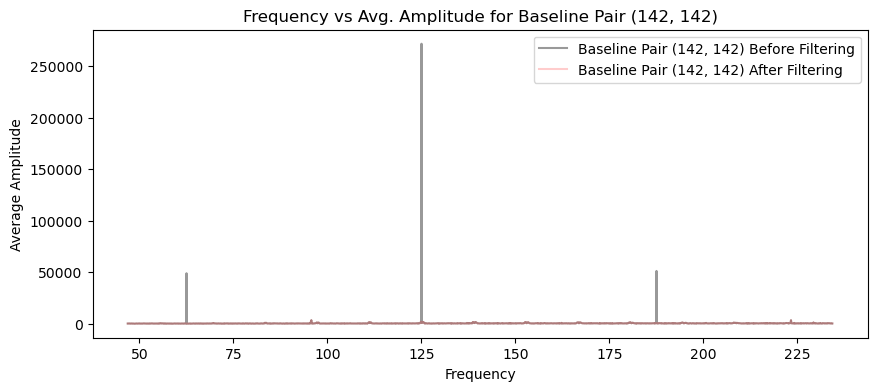

freqs shape: (1536,)
freqs_filtered shape: (1527,)
amplitudes_filtered shape: (20, 1527)
Threshold for baseline: [-0.2196066  -0.20117723 -0.20961887 ... -0.09925663 -0.11432599
 -0.13029078]


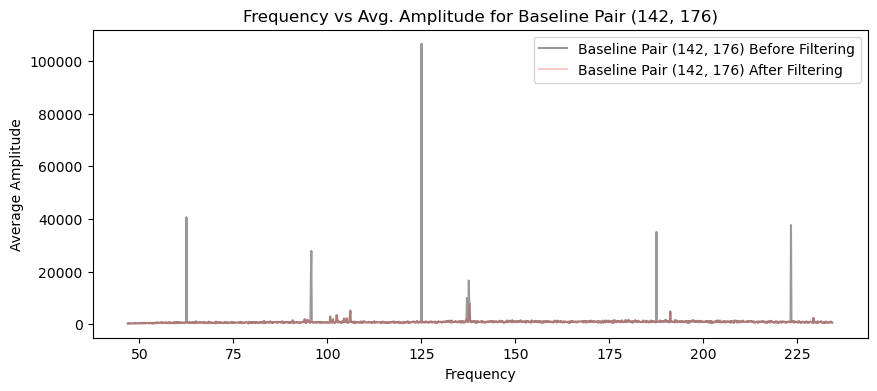

freqs shape: (1536,)
freqs_filtered shape: (1504,)
amplitudes_filtered shape: (20, 1504)
Threshold for baseline: [-0.23674435 -0.24213328 -0.23718477 ... -0.19099339 -0.20154981
 -0.18107273]


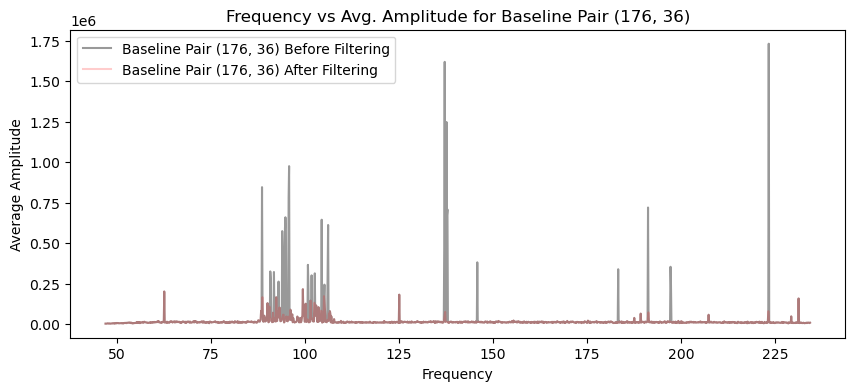

freqs shape: (1536,)
freqs_filtered shape: (1502,)
amplitudes_filtered shape: (20, 1502)
Threshold for baseline: [-0.24251006 -0.23778211 -0.2553096  ... -0.21165086 -0.19819175
 -0.18531255]


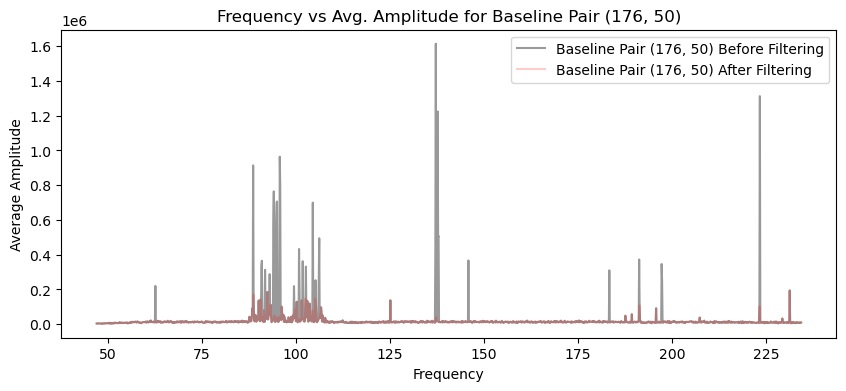

freqs shape: (1536,)
freqs_filtered shape: (1508,)
amplitudes_filtered shape: (20, 1508)
Threshold for baseline: [-0.22196651 -0.22450424 -0.21186839 ... -0.18035581 -0.17541776
 -0.18024311]


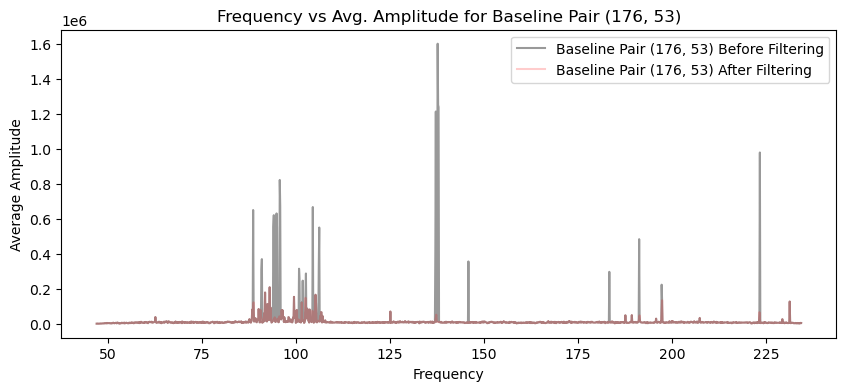

freqs shape: (1536,)
freqs_filtered shape: (1531,)
amplitudes_filtered shape: (20, 1531)
Threshold for baseline: [-0.35856635 -0.37008367 -0.28772123 ... -0.17727223 -0.30686691
 -0.16398374]


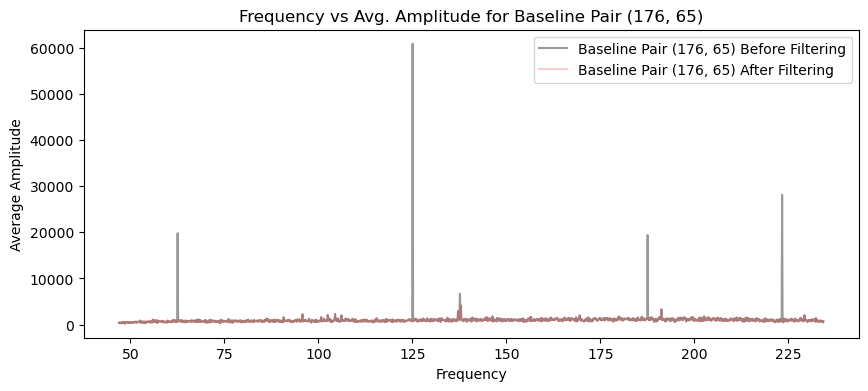

freqs shape: (1536,)
freqs_filtered shape: (1506,)
amplitudes_filtered shape: (20, 1506)
Threshold for baseline: [-0.2157367  -0.21242188 -0.21280663 ... -0.19058356 -0.19979163
 -0.17118171]


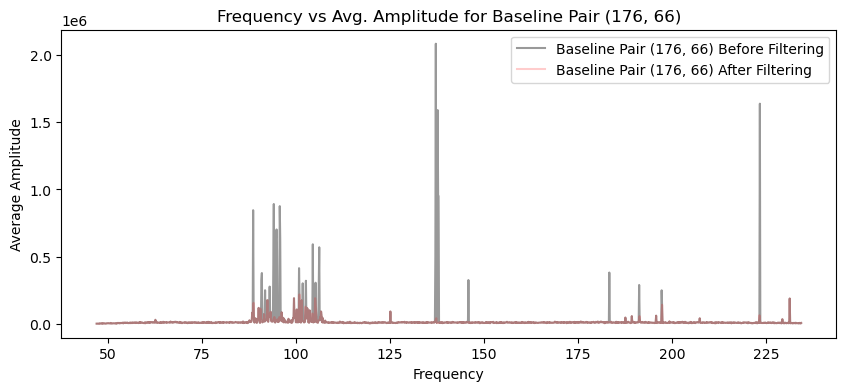

freqs shape: (1536,)
freqs_filtered shape: (1509,)
amplitudes_filtered shape: (20, 1509)
Threshold for baseline: [-0.1937156  -0.20115252 -0.20034904 ... -0.16720309 -0.16903655
 -0.17067137]


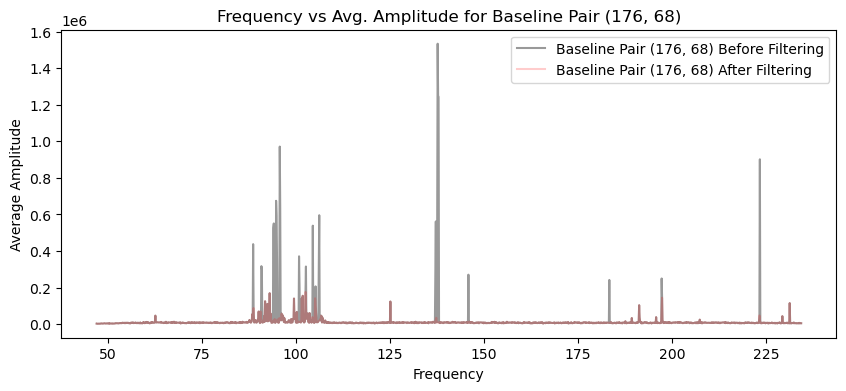

freqs shape: (1536,)
freqs_filtered shape: (1533,)
amplitudes_filtered shape: (20, 1533)
Threshold for baseline: [-0.18983165 -0.19308921 -0.17047411 ... -0.10971475 -0.10237362
 -0.11377755]


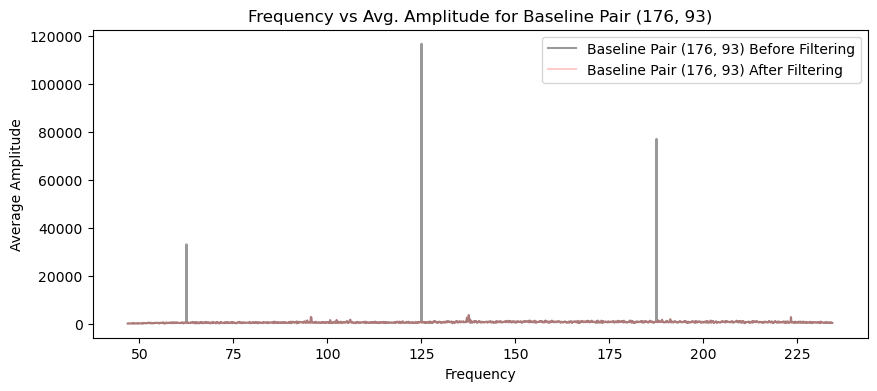

freqs shape: (1536,)
freqs_filtered shape: (1510,)
amplitudes_filtered shape: (20, 1510)
Threshold for baseline: [-0.21157047 -0.21973733 -0.19963965 ... -0.18710895 -0.17643032
 -0.18576837]


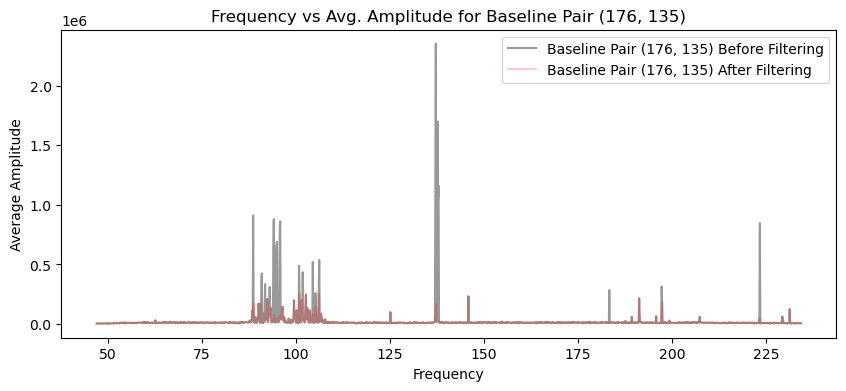

freqs shape: (1536,)
freqs_filtered shape: (1507,)
amplitudes_filtered shape: (20, 1507)
Threshold for baseline: [-0.26211246 -0.24354952 -0.24425651 ... -0.20943822 -0.20509365
 -0.20993043]


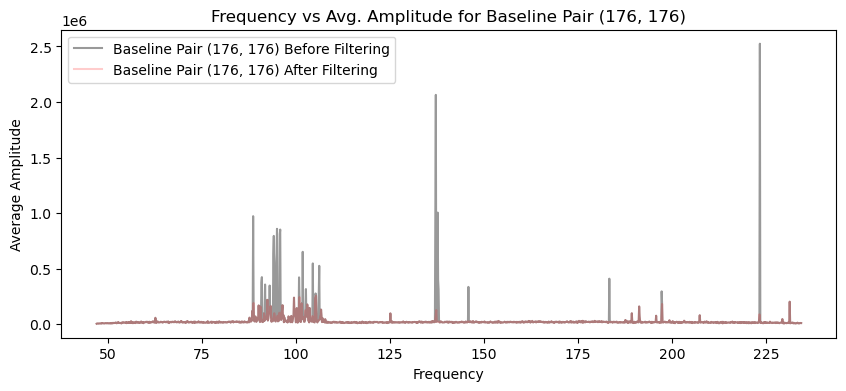

In [9]:
n = filter(uv)